# Model Build

In [1]:
# %history -g -f history.py

In [2]:

# import os
# import math
# import numpy as np
# import glob
# from typing import Any
import tensorflow as tf
# import tensorflow.keras as k
# import matplotlib.pyplot as plt
# import metrics
# from pandas import DataFrame, crosstab
# from metrics import plot_confusion
# from IPython.display import Image
# from tensorflow.keras import models
# from keras.utils import plot_model
# from tqdm.notebook import trange
# from tensorflow.keras.layers import Dense, Input, Layer, InputSpec, Dropout
# from tensorflow.keras.models import Model
# from tensorflow.keras.optimizers import SGD
# from tensorflow.keras.initializers import VarianceScaling
# from tensorflow.keras.callbacks import EarlyStopping
# from sklearn.cluster import KMeans
# from sklearn.metrics import (
#             f1_score, accuracy_score, precision_score, recall_score, classification_report)
# from data import load_data
# from wordcloud import WordCloud
# from timer import timer
from grid_search import grid_search
from deep_latent import DeepLatentCluster
# import umap

In [3]:
tf.get_logger().setLevel('ERROR')

In [4]:
from collections import defaultdict

def summarise_scores(scores: list[dict]) -> None:
    """
    summarise the scores.
    """
    groups = defaultdict(list)
    results = {}
    for s in scores:
        groups[s['run_name']].append(s)
        results[s['run_name']] = {
                            'cluster_f1':0.0,
                            'f1': 0.0,
                            'precision': 0.0,
                            'recall': 0.0,
                            'n': 0}
    # add up each group
    for group, scores in groups.items():
        for score in scores:
            results[group]['cluster_f1'] += score['cluster_f1']
            results[group]['f1'] += score['f1']
            results[group]['precision'] += score['precision']
            results[group]['recall'] += score['recall']
            results[group]['n'] += 1
    # average each group
    for group, scores in groups.items():
        results[group]['cluster_f1'] /= len(scores)
        results[group]['f1'] /= len(scores)
        results[group]['precision'] /= len(scores)
        results[group]['recall'] /= len(scores)


    # print results
    print(
        f"{'Run Name':<40} {'Runs':<10} {'F1 avg':<12} {'F1 Cluster':<12} "
        f"{'F1 Global':<12} {'Precision':<12} {'Recall':<12}")
    for run, s in results.items():
        print(
            f"{run:<40} {s['n']:<10}  {(s['f1']+s['cluster_f1'])/2:<12.4f} "
            f"{s['cluster_f1']:<12.4f} {s['f1']:<12.4f}"
            f"{s['precision']:<12.4f} {s['recall']:<12.4f}")

## Grid Search Utils

In [5]:
def do_run(cfg, idx, n_runs, sample_size) -> dict:
    run_name = (f"test-")
    

    # append all cfg to run_name
    for k, v in cfg.items():
        run_name += f"{k}={v}-"

    print('-'*50)
    print(f"{idx}/{n_runs}: {run_name}")
    print('-'*50)
    print(cfg)
    dc = DeepLatentCluster(
        run_name,
        {
            **cfg,
        
        })
    dc.make_model()
    dc.train_model(verbose=0)
    score = dc.evaluate_model(
        run_name,
        sample_size=sample_size,
        verbose=0)
    score['run_name'] = run_name
    return score
    
from collections import defaultdict

def summarise_scores(scores: list[dict]) -> None:
    """
    summarise the scores.
    """
    groups = defaultdict(list)
    results = {}
    for s in scores:
        groups[s['run_name']].append(s)
        results[s['run_name']] = {
                            'cluster_f1':0.0,
                            'f1': 0.0,
                            'precision': 0.0,
                            'recall': 0.0,
                            'n': 0}
    # add up each group
    for group, scores in groups.items():
        for score in scores:
            results[group]['cluster_f1'] += score['cluster F1']
            results[group]['f1'] += score['f1']
            results[group]['precision'] += score['precision']
            results[group]['recall'] += score['recall']
            results[group]['n'] += 1
    # average each group
    for group, scores in groups.items():
        results[group]['cluster_f1'] /= len(scores)
        results[group]['f1'] /= len(scores)
        results[group]['precision'] /= len(scores)
        results[group]['recall'] /= len(scores)


    # print results
    print(
        f"{'Run Name':<40} {'Runs':<10} {'F1 avg':<12} {'F1 Cluster':<12} "
        f"{'F1 Global':<12} {'Precision':<12} {'Recall':<12}")
    for run, s in results.items():
        print(
            f"{run:<40} {s['n']:<10}  {(s['f1']+s['cluster_f1'])/2:<12.4f} "
            f"{s['cluster_f1']:<12.4f} {s['f1']:<12.4f}"
            f"{s['precision']:<12.4f} {s['recall']:<12.4f}")

In [6]:
stop

NameError: name 'stop' is not defined

# Eval

## Base model

Autoencoder
Latent Model
Layer latent_0: 2000 activation=None
Layer latent_1: 500 activation=None
Layer latent_2: 500 activation=None
Layer latent_out: 2000 activation=sigmoid
model compiled
Load Data
Loading ./data/conll_spacy_0.pkl
LOADED {1: 'UNKNOWN', 4: 'ORG', 2: 'PERSON', 12: 'DATE', 5: 'GPE', 6: 'LOC', 16: 'QUANTITY', 14: 'PERCENT', 8: 'EVENT', 15: 'MONEY', 3: 'NORP', 17: 'ORDINAL', 19: 'FAC', 13: 'TIME', 18: 'CARDINAL', 7: 'PRODUCT', 10: 'LANGUAGE', 9: 'WORK_OF_ART', 11: 'LAW'}
Loaded file: 9153 samples
Data balance:
[[   2 2080]
 [   3  142]
 [   4 1950]
 [   5 2664]
 [   6  114]
 [  12 1659]
 [  13  143]
 [  14  151]
 [  15  111]
 [  16  139]]
Balancing data
Post Oversampling
x: (26640, 768), y: (26640,)
{0: 'PERSON', 1: 'NORP', 2: 'ORG', 3: 'GPE', 4: 'LOC', 5: 'DATE', 6: 'TIME', 7: 'PERCENT', 8: 'MONEY', 9: 'QUANTITY'}
Data Loaded
Data Loaded
Training autoencoder
Epoch 1/300
105/105 [==============================] - 1s 5ms/step - loss: 0.0997
Epoch 2/300
105/105 [==========

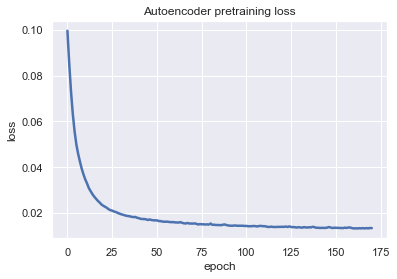

Iter:0 -> loss:0
Iter:140 -> loss:0.01871095411479473
Iter:280 -> loss:0.015731457620859146


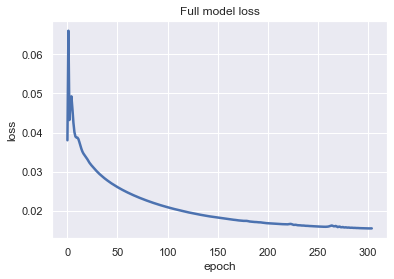

Training Done


In [ ]:
tf.get_logger().setLevel('ERROR')

dc = None
dc = DeepLatentCluster(
        'test-latent-all',
        {
            'train_size':0,
            'reconstr_weight':1.0,
            'latent_weight':1e-5,
            "cluster": None
            "noise_factor": 0.0,
        })
dc.make_model()
dc.train_model()

# Latent Head

## OPTICS

Autoencoder
Latent Model
model compiled
Loading AE weights from ./results/test-latent-all\ae_weights.h5
Loading model weights from ./results/test-latent-all\lat_model_final.h5
Using [z] head for predictions
Load Data 
Loading ./data/conll_spacy_n0_r0_test.pkl
LOADED {1: 'UNKNOWN', 2: 'PERSON', 4: 'ORG', 5: 'GPE', 11: 'DATE', 12: 'TIME', 8: 'EVENT', 16: 'ORDINAL', 3: 'NORP', 14: 'MONEY', 15: 'QUANTITY', 18: 'FAC', 6: 'LOC', 7: 'PRODUCT', 10: 'LAW', 9: 'WORK_OF_ART', 17: 'CARDINAL', 13: 'PERCENT'}
Loaded file: 12479 samples
Data balance:
[[    1 10305]
 [    2   404]
 [    3    24]
 [    4   439]
 [    5   668]
 [    6    44]
 [    7    14]
 [    8    24]
 [    9     5]
 [   10     2]
 [   11   380]
 [   12    31]
 [   13    38]
 [   14    30]
 [   15    29]
 [   16     1]
 [   17    15]
 [   18    26]]
Balancing data
Post Oversampling
x: (185490, 768), y: (185490,)
{0: 'UNKNOWN', 1: 'PERSON', 2: 'NORP', 3: 'ORG', 4: 'GPE', 5: 'LOC', 6: 'PRODUCT', 7: 'EVENT', 8: 'WORK_OF_ART', 9: 'LAW', 

  0%|          | 0/8 [00:00<?, ?it/s]

Clustering 2000 points using OPTICS
Visualising
UMAP(metric='manhattan', verbose=True)
Mon Sep  5 23:12:58 2022 Construct fuzzy simplicial set
Mon Sep  5 23:13:01 2022 Finding Nearest Neighbors
Mon Sep  5 23:13:02 2022 Finished Nearest Neighbor Search
Mon Sep  5 23:13:03 2022 Construct embedding


Epochs completed:   0%|            0/500 [00:00]

Mon Sep  5 23:13:06 2022 Finished embedding


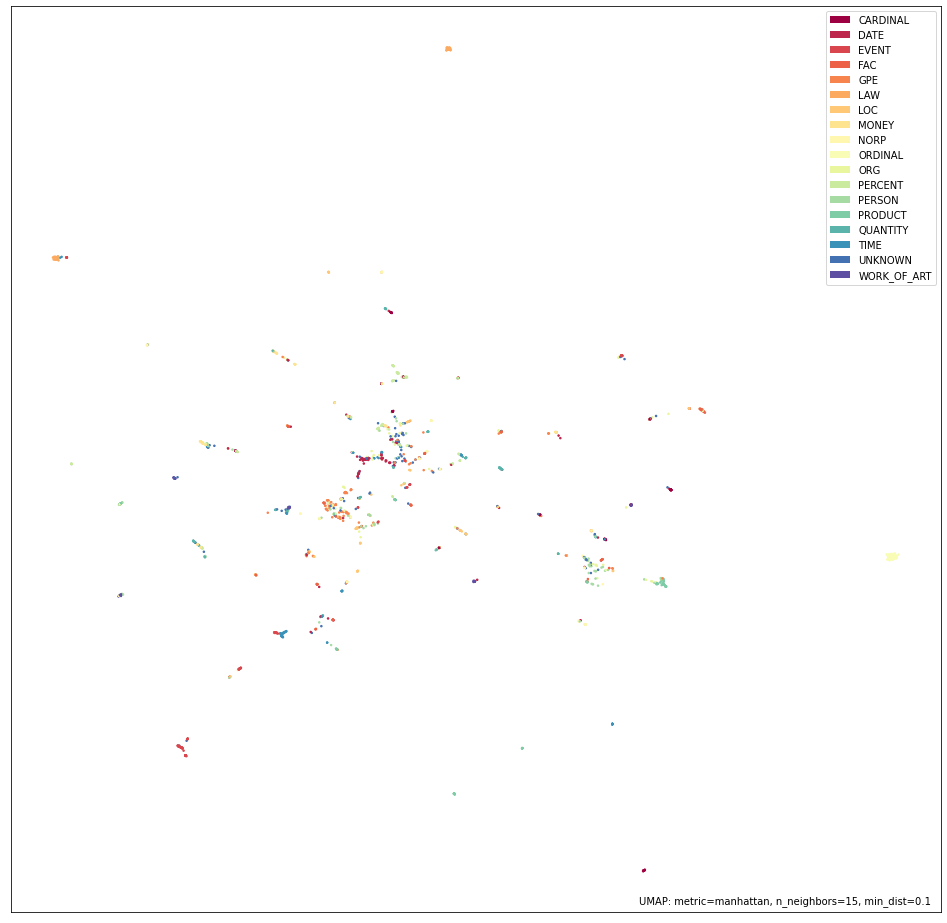

CLUSTERS
#PRODUCT:24 size:11 prec:1.0000 rec:1.0000 f1:1.0000
#GPE:1 size:5 prec:1.0000 rec:0.0526 f1:0.1000
#FAC:32 size:9 prec:1.0000 rec:0.2903 f1:0.4500
#UNK-GPE-3:3 size:5 prec:1.0000 rec:0.0526 f1:0.1000
#UNK-GPE-4:4 size:10 prec:1.0000 rec:0.1000 f1:0.1818
#QUANTITY:5 size:6 prec:1.0000 rec:0.0984 f1:0.1791
#MONEY:7 size:12 prec:1.0000 rec:0.2727 f1:0.4286
#UNK-MONEY-7:6 size:11 prec:1.0000 rec:0.1795 f1:0.3043
#UNK-MONEY-8:8 size:5 prec:1.0000 rec:0.1351 f1:0.2381
#UNK-QUANTITY-9:9 size:9 prec:1.0000 rec:0.1406 f1:0.2466
#DATE:10 size:15 prec:1.0000 rec:0.1474 f1:0.2569
#UNK-MONEY-11:11 size:9 prec:1.0000 rec:0.2195 f1:0.3600
#UNK-MONEY-12:12 size:7 prec:1.0000 rec:0.1795 f1:0.3043
#TIME:13 size:5 prec:1.0000 rec:0.1042 f1:0.1887
#PERCENT:14 size:7 prec:1.0000 rec:0.1228 f1:0.2188
#LAW:134 size:47 prec:1.0000 rec:1.0000 f1:1.0000
#EVENT:16 size:6 prec:1.0000 rec:0.2857 f1:0.4444
#WORK_OF_ART:59 size:23 prec:1.0000 rec:1.0000 f1:1.0000
#UNK-QUANTITY-18:18 size:7 prec:1.0000 rec:

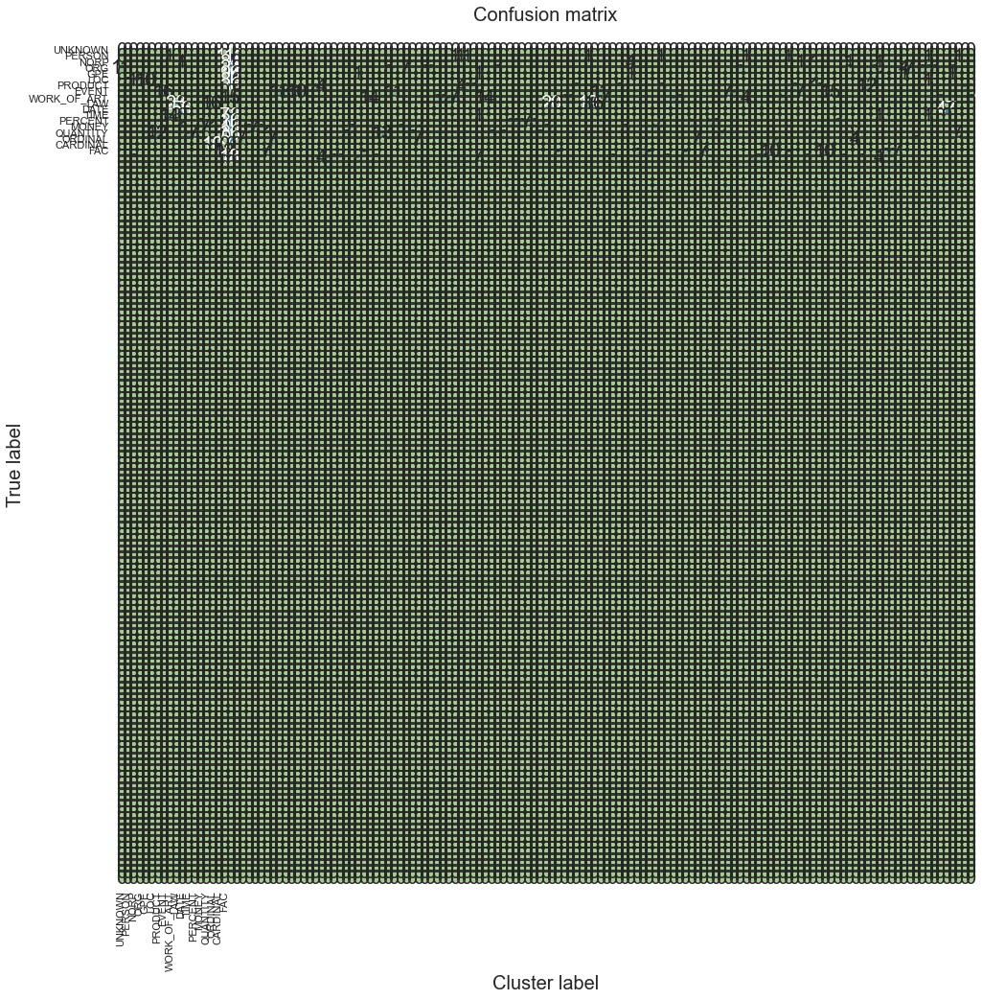

F1 score (macro) = 0.6886
Accuracy = 0.6790
Precision = 0.8979
Recall = 0.6602
... wrote results to c:\Users\Will\Projects\MSc\project\src\results\test-latent-all-OPTICS\index.html
Finished 'evaluate_model' in 187.772 secs


In [ ]:
#%%time

dc = None
dc = DeepLatentCluster(
    'test-latent-all-OPTICS',
    {
        'train_size':0,
        'reconstr_weight':1.0,
        'latent_weight':1e-5,
        "cluster": "OPTICS"
    })

dc.evaluate_model('test-latent-all', sample_size=2000)

In [ ]:
dc.evaluate_model('test-latent-all', sample_size=2000)

## Agglomerative Clustering

Autoencoder
Latent Model
model compiled
Loading AE weights from ./results/test-latent-all\ae_weights.h5
Loading model weights from ./results/test-latent-all\lat_model_final.h5
Using [z] head for predictions
Load Data 
Test Data Loaded (185490, 768)
Predicting...16 batches of 256 x 768


  0%|          | 0/16 [00:00<?, ?it/s]

Clustering 4000 points using agg
Visualising
UMAP(metric='manhattan', verbose=True)
Thu Sep  1 15:43:50 2022 Construct fuzzy simplicial set
Thu Sep  1 15:44:00 2022 Finding Nearest Neighbors
Thu Sep  1 15:44:01 2022 Finished Nearest Neighbor Search
Thu Sep  1 15:44:02 2022 Construct embedding


Epochs completed:   0%|            0/500 [00:00]

Thu Sep  1 15:44:08 2022 Finished embedding


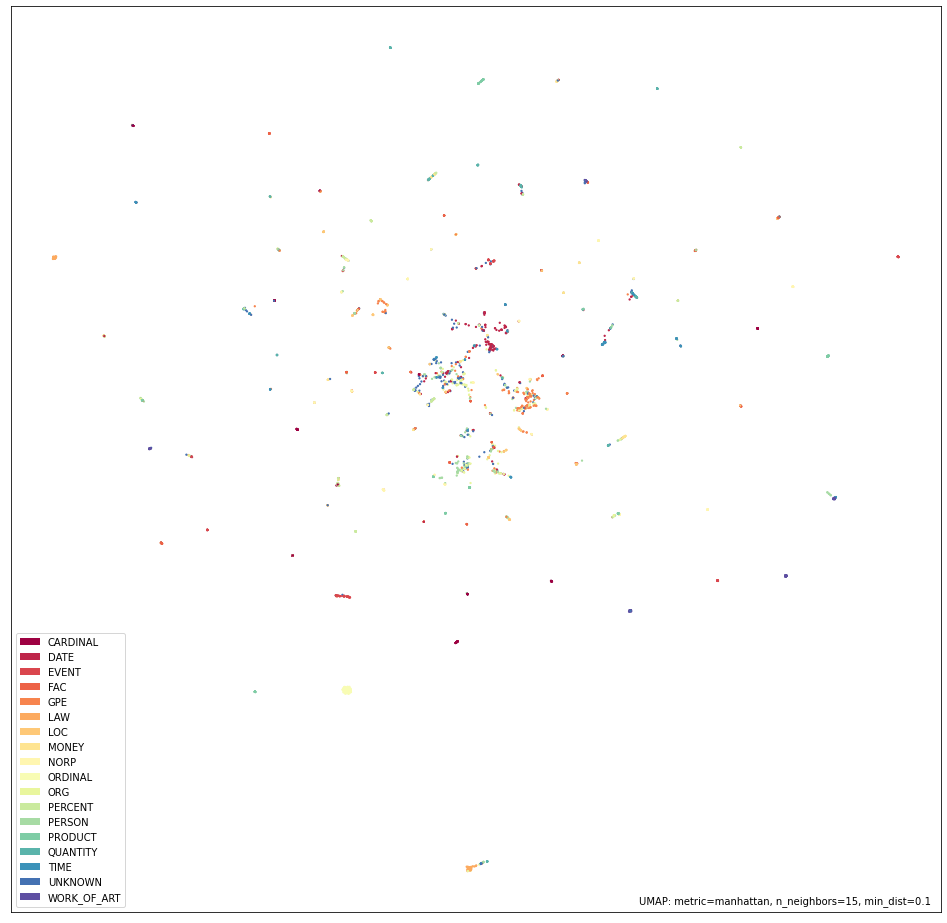

CLUSTERS
#EVENT:0 size:342 prec:1.0000 rec:0.6471 f1:0.7857
#NORP:12 size:21 prec:1.0000 rec:0.1257 f1:0.2234
#PERCENT:8 size:252 prec:1.0000 rec:0.4360 f1:0.6073
#LOC:3 size:125 prec:1.0000 rec:0.1287 f1:0.2281
#TIME:4 size:210 prec:1.0000 rec:0.3030 f1:0.4651
#CARDINAL:5 size:23 prec:1.0000 rec:0.1008 f1:0.1831
#MONEY:10 size:314 prec:1.0000 rec:0.5890 f1:0.7413
#UNK-CARDINAL-7:7 size:103 prec:1.0000 rec:0.1773 f1:0.3012
#UNK-PERCENT-8:2 size:285 prec:1.0000 rec:0.3742 f1:0.5446
#FAC:9 size:162 prec:1.0000 rec:0.2044 f1:0.3395
#UNK-MONEY-10:6 size:172 prec:1.0000 rec:0.3853 f1:0.5563
#WORK_OF_ART:11 size:101 prec:1.0000 rec:0.1696 f1:0.2901
#UNK-NORP-12:1 size:320 prec:1.0000 rec:0.3048 f1:0.4672
#PRODUCT:13 size:40 prec:1.0000 rec:0.4598 f1:0.6299
#UNK-PRODUCT-14:14 size:209 prec:1.0000 rec:0.6357 f1:0.7773
#ORDINAL:15 size:222 prec:1.0000 rec:1.0000 f1:1.0000
#UNK-NORP-16:16 size:30 prec:1.0000 rec:0.0875 f1:0.1609
#GPE:17 size:292 prec:1.0000 rec:0.4802 f1:0.6488
#UNK-CARDINAL-18:

In [ ]:
%%time

tf.get_logger().setLevel('ERROR')

dc = None
dc = DeepLatentCluster(
    'test-latent-all-agg',
    {
        'train_size':10000,
        'reconstr_weight':1.0,
        'latent_weight':1e-5,
        "cluster": "agg"
    })
# dc.make_model()
# dc.train_model()
dc.evaluate_model('test-latent-all', sample_size=4000)

## K-means

Autoencoder
Latent Model
model compiled
Loading AE weights from ./results/test-latent-all\ae_weights.h5
Loading model weights from ./results/test-latent-all\lat_model_final.h5
Using [z] head for predictions
Load Data 
Test Data Loaded (185490, 768)
Predicting...16 batches of 256 x 768


  0%|          | 0/16 [00:00<?, ?it/s]

Clustering 4000 points using Kmeans
Initialization complete
Iteration 0, inertia 1839.0250244140625.
Iteration 1, inertia 1415.8192138671875.
Iteration 2, inertia 1373.72265625.
Iteration 3, inertia 1363.353759765625.
Iteration 4, inertia 1358.4888916015625.
Iteration 5, inertia 1355.5079345703125.
Iteration 6, inertia 1353.782958984375.
Iteration 7, inertia 1352.50341796875.
Iteration 8, inertia 1350.2373046875.
Iteration 9, inertia 1348.6141357421875.
Iteration 10, inertia 1346.5179443359375.
Iteration 11, inertia 1346.278564453125.
Iteration 12, inertia 1346.1708984375.
Iteration 13, inertia 1345.4415283203125.
Iteration 14, inertia 1344.7567138671875.
Iteration 15, inertia 1344.706787109375.
Iteration 16, inertia 1344.6885986328125.
Iteration 17, inertia 1344.6710205078125.
Iteration 18, inertia 1344.639404296875.
Iteration 19, inertia 1344.629150390625.
Iteration 20, inertia 1344.607177734375.
Iteration 21, inertia 1344.59521484375.
Iteration 22, inertia 1344.585205078125.
Iterati

Epochs completed:   0%|            0/500 [00:00]

Thu Sep  1 15:45:09 2022 Finished embedding


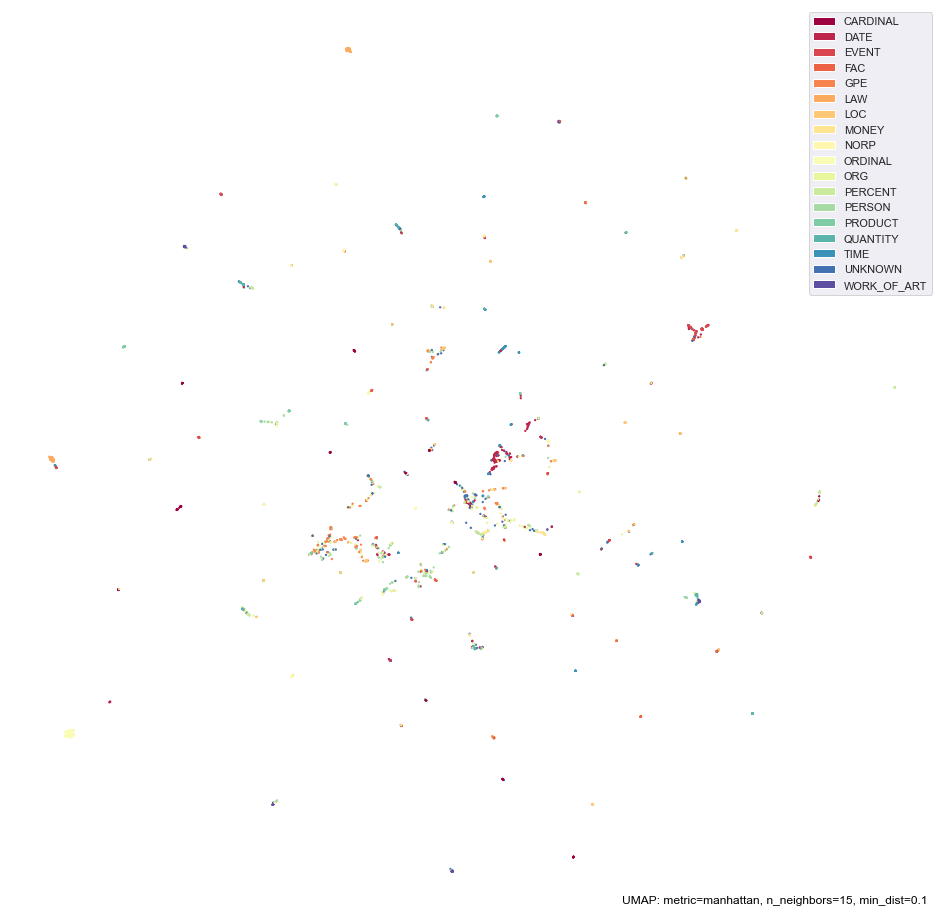

CLUSTERS
#NORP:12 size:11 prec:1.0000 rec:0.0797 f1:0.1477
#ORDINAL:1 size:220 prec:1.0000 rec:1.0000 f1:1.0000
#GPE:2 size:353 prec:1.0000 rec:0.3113 f1:0.4748
#QUANTITY:3 size:74 prec:1.0000 rec:0.2985 f1:0.4598
#LAW:14 size:123 prec:1.0000 rec:1.0000 f1:1.0000
#WORK_OF_ART:7 size:174 prec:1.0000 rec:0.5097 f1:0.6752
#UNK-QUANTITY-6:6 size:341 prec:1.0000 rec:0.5437 f1:0.7044
#UNK-WORK_OF_ART-7:5 size:131 prec:1.0000 rec:0.3821 f1:0.5529
#PERCENT:8 size:310 prec:1.0000 rec:0.6854 f1:0.8134
#CARDINAL:9 size:154 prec:1.0000 rec:0.3741 f1:0.5445
#TIME:10 size:176 prec:1.0000 rec:0.3714 f1:0.5417
#UNK-CARDINAL-11:11 size:227 prec:1.0000 rec:0.3741 f1:0.5445
#UNK-NORP-12:0 size:190 prec:1.0000 rec:0.1962 f1:0.3280
#PRODUCT:13 size:57 prec:1.0000 rec:0.4902 f1:0.6579
#UNK-LAW-14:4 size:282 prec:1.0000 rec:1.0000 f1:1.0000
#LOC:15 size:168 prec:1.0000 rec:0.3175 f1:0.4820
#DATE:16 size:184 prec:1.0000 rec:0.3624 f1:0.5321
#EVENT:17 size:119 prec:1.0000 rec:0.4820 f1:0.6505
#UNK-PRODUCT-18:1

In [ ]:
%%time

dc = None
dc = DeepLatentCluster(
    'test-latent-all-Kmeans',
    {
        'train_size':0,
        'reconstr_weight':1.0,
        'latent_weight':1e-5,
        "cluster": "Kmeans"
    })
# dc.make_model()
# dc.train_model()
dc.evaluate_model('test-latent-all', sample_size=4000)

## GMM

Autoencoder
Latent Model
model compiled
Loading AE weights from ./results/test-latent-all\ae_weights.h5
Loading model weights from ./results/test-latent-all\lat_model_final.h5
Using [z] head for predictions
Load Data 
Test Data Loaded (185490, 768)
Predicting...16 batches of 256 x 768


  0%|          | 0/16 [00:00<?, ?it/s]

Clustering 4000 points using GMM
Initialization 0
  Iteration 10
Initialization converged: True
Visualising
UMAP(metric='manhattan', verbose=True)
Thu Sep  1 15:47:49 2022 Construct fuzzy simplicial set
Thu Sep  1 15:47:59 2022 Finding Nearest Neighbors
Thu Sep  1 15:47:59 2022 Finished Nearest Neighbor Search
Thu Sep  1 15:47:59 2022 Construct embedding


Epochs completed:   0%|            0/500 [00:00]

Thu Sep  1 15:48:05 2022 Finished embedding


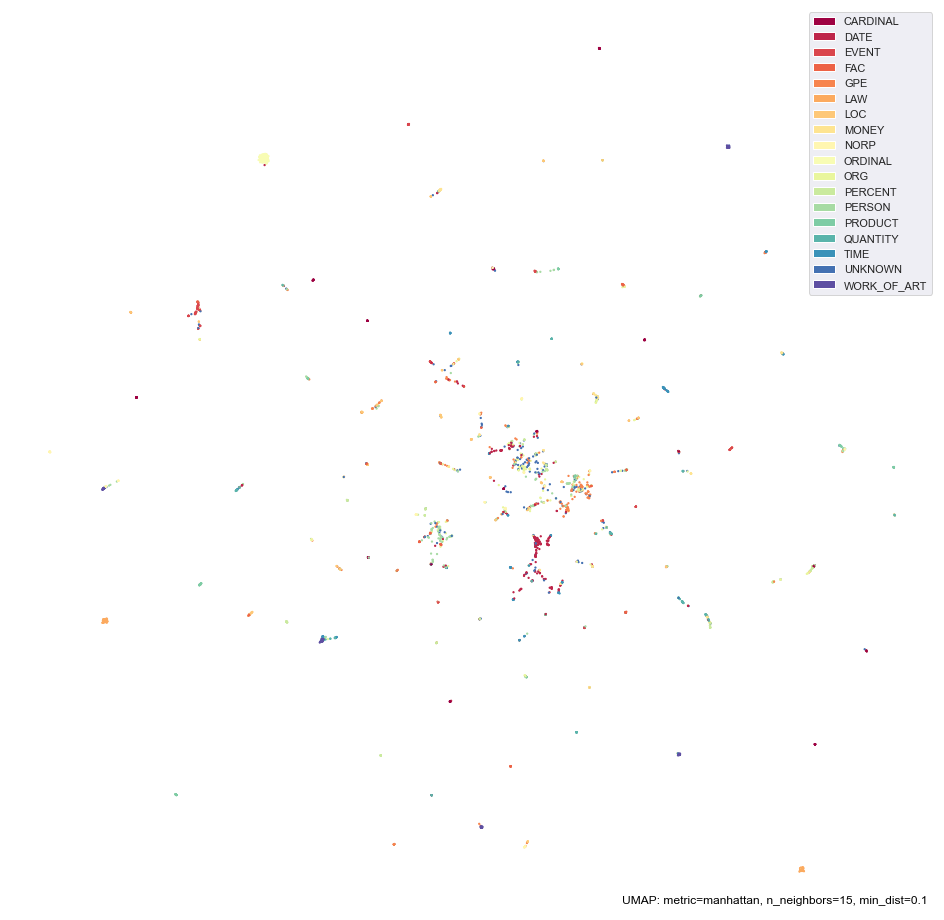

CLUSTERS
#QUANTITY:0 size:207 prec:1.0000 rec:0.4135 f1:0.5850
#LOC:2 size:160 prec:1.0000 rec:0.3660 f1:0.5359
#UNK-LOC-2:1 size:101 prec:1.0000 rec:0.1917 f1:0.3217
#MONEY:3 size:101 prec:1.0000 rec:0.2113 f1:0.3488
#UNK-LOC-4:4 size:190 prec:1.0000 rec:0.3822 f1:0.5530
#ORDINAL:5 size:244 prec:1.0000 rec:1.0000 f1:1.0000
#WORK_OF_ART:6 size:97 prec:1.0000 rec:0.3333 f1:0.5000
#CARDINAL:15 size:163 prec:1.0000 rec:0.4133 f1:0.5848
#UNK-UNKNOWN-8:8 size:198 prec:0.1919 rec:1.0000 f1:0.3220
#UNK-WORK_OF_ART-9:9 size:194 prec:1.0000 rec:0.4951 f1:0.6623
#LAW:10 size:125 prec:1.0000 rec:1.0000 f1:1.0000
#PRODUCT:11 size:29 prec:1.0000 rec:0.3000 f1:0.4615
#NORP:12 size:18 prec:1.0000 rec:0.0814 f1:0.1506
#TIME:13 size:175 prec:1.0000 rec:0.3507 f1:0.5193
#UNK-PRODUCT-14:14 size:182 prec:1.0000 rec:0.5227 f1:0.6866
#UNK-CARDINAL-15:7 size:158 prec:1.0000 rec:0.2484 f1:0.3979
#FAC:16 size:193 prec:1.0000 rec:0.1912 f1:0.3210
#UNK-LAW-17:17 size:204 prec:1.0000 rec:1.0000 f1:1.0000
#PERCENT

In [ ]:
%%time

dc = None
dc = DeepLatentCluster(
    'test-latent-all-GMM',
    {
        'train_size':0,
        'reconstr_weight':1.0,
        'latent_weight':1e-5,
        "cluster": "GMM"
    })
# dc.make_model()
# dc.train_model()
dc.evaluate_model('test-latent-all', sample_size=4000)

# Encoder Head

Autoencoder
Latent Model
model compiled
Loading AE weights from ./results/test-latent-all\ae_weights.h5
Loading model weights from ./results/test-latent-all\lat_model_final.h5
Using [enc] head for predictions
Load Data 
Test Data Loaded (185490, 768)
Predicting...12 batches of 256 x 768


  0%|          | 0/12 [00:00<?, ?it/s]

Clustering 3000 points using OPTICS
Visualising
UMAP(metric='manhattan', verbose=True)
Thu Sep  1 15:51:35 2022 Construct fuzzy simplicial set
Thu Sep  1 15:51:37 2022 Finding Nearest Neighbors
Thu Sep  1 15:51:37 2022 Finished Nearest Neighbor Search
Thu Sep  1 15:51:37 2022 Construct embedding


Epochs completed:   0%|            0/500 [00:00]

Thu Sep  1 15:51:42 2022 Finished embedding


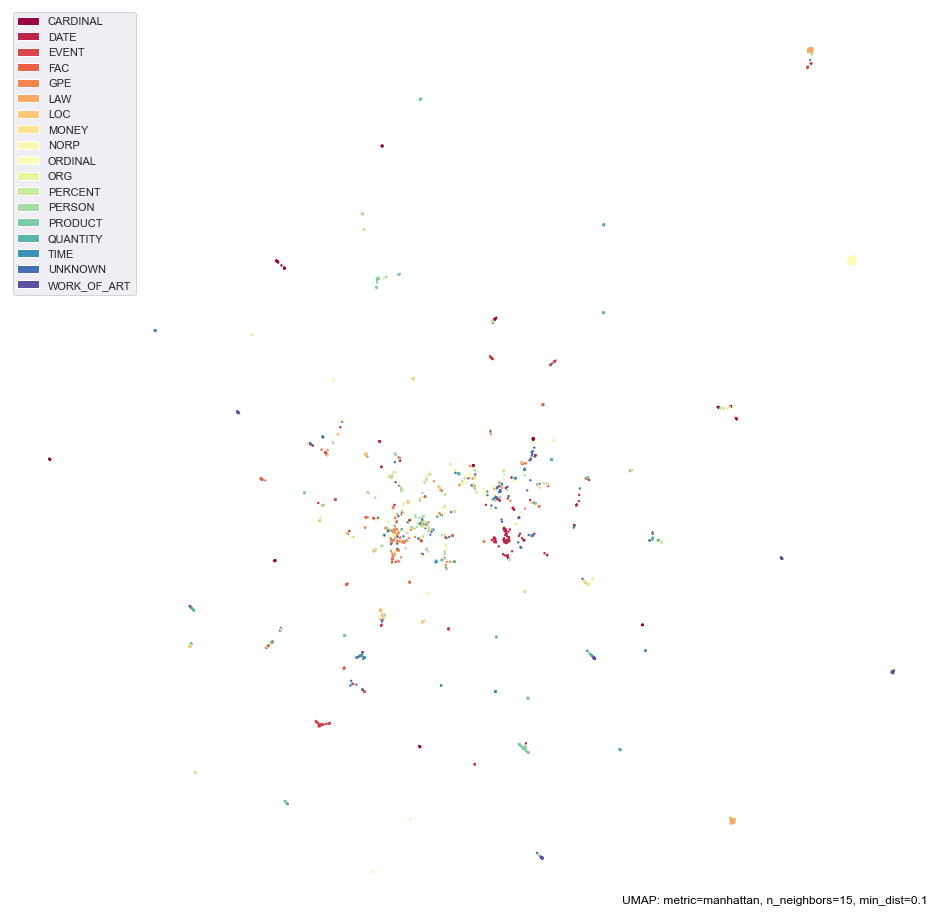

CLUSTERS
#TIME:0 size:6 prec:1.0000 rec:0.1765 f1:0.3000
#ORG:1 size:5 prec:1.0000 rec:0.0296 f1:0.0575
#QUANTITY:3 size:7 prec:1.0000 rec:0.2800 f1:0.4375
#UNK-QUANTITY-3:2 size:8 prec:1.0000 rec:0.2800 f1:0.4375
#MONEY:4 size:7 prec:1.0000 rec:0.1842 f1:0.3111
#UNK-MONEY-5:5 size:12 prec:1.0000 rec:0.2619 f1:0.4151
#UNK-MONEY-6:6 size:7 prec:1.0000 rec:0.1842 f1:0.3111
#UNK-QUANTITY-7:7 size:6 prec:1.0000 rec:0.2500 f1:0.4000
#UNK-MONEY-8:8 size:5 prec:1.0000 rec:0.1389 f1:0.2439
#UNK-QUANTITY-9:9 size:6 prec:1.0000 rec:0.2174 f1:0.3571
#UNK-QUANTITY-10:10 size:8 prec:1.0000 rec:0.3077 f1:0.4706
#UNK-QUANTITY-11:11 size:7 prec:1.0000 rec:0.2800 f1:0.4375
#UNK-QUANTITY-12:12 size:6 prec:1.0000 rec:0.2500 f1:0.4000
#UNK-MONEY-13:13 size:7 prec:1.0000 rec:0.1842 f1:0.3111
#UNK-MONEY-14:14 size:9 prec:1.0000 rec:0.2250 f1:0.3673
#UNK-QUANTITY-15:15 size:13 prec:1.0000 rec:0.4194 f1:0.5909
#WORK_OF_ART:16 size:33 prec:1.0000 rec:1.0000 f1:1.0000
#PERCENT:17 size:5 prec:1.0000 rec:0.1087 f

In [ ]:
%%time
#min cluster size

dc = None
dc = DeepLatentCluster(
    'test-latent-all-OPTICS-Enc-2',
    {
        'train_size':0,
        'reconstr_weight':1.0,
        'latent_weight':1e-5,
        "cluster": "OPTICS"
    })

dc.evaluate_model('test-latent-all', head="enc", sample_size=3000)

## Optics-Encoder

In [ ]:
%%time

dc = None
dc = DeepLatentCluster(
    'test-latent-all-OPTICS-Enc',
    {
        'train_size':0,
        'reconstr_weight':1.0,
        'latent_weight':1e-5,
        "cluster": "OPTICS"
    })

dc.evaluate_model('test-latent-all', head="enc", sample_size=3000, verbose=0)


F1 by Known Clusters: 0.3664
F1 score (macro) = 0.7463
Accuracy = 0.7440
Precision = 0.8982
Recall = 0.7440
... wrote results  <a href="c:\Users\Will\Projects\MSc\project\src\results\test-latent-all-OPTICS-Enc\index.html">c:\Users\Will\Projects\MSc\project\src\results\test-latent-all-OPTICS-Enc\index.html</a>
Finished 'evaluate_model' in 243.125 secs
CPU times: total: 59min 31s
Wall time: 4min 3s


## Agglomerative-Encoder

In [ ]:
%%time

dc = None
dc = DeepLatentCluster(
    'test-latent-all-agg-enc',
    {
        'train_size':0,
        'reconstr_weight':1.0,
        'latent_weight':1e-5,
        "cluster": "agg"
    })
# dc.make_model()
# dc.train_model()
dc.evaluate_model('test-latent-all', head='enc',  sample_size=4000, verbose=0)


F1 by Known Clusters: 0.1845
F1 score (macro) = 0.5695
Accuracy = 0.5175
Precision = 0.8387
Recall = 0.5150
... wrote results  <a href="c:\Users\Will\Projects\MSc\project\src\results\test-latent-all-agg-enc\index.html">c:\Users\Will\Projects\MSc\project\src\results\test-latent-all-agg-enc\index.html</a>
Finished 'evaluate_model' in 31.461 secs
CPU times: total: 1min 46s
Wall time: 31.5 s


## KMeans-Encoder

In [ ]:
%%time

dc = None
dc = DeepLatentCluster(
    'test-latent-all-Kmeans-Enc',
    {
        'train_size':0,
        'reconstr_weight':1.0,
        'latent_weight':1e-5,
        "cluster": "Kmeans"
    })

dc.evaluate_model('test-latent-all', head="enc", sample_size=4000, verbose=0)


F1 by Known Clusters: 0.2408
F1 score (macro) = 0.5193
Accuracy = 0.4617
Precision = 0.8381
Recall = 0.4648
... wrote results  <a href="c:\Users\Will\Projects\MSc\project\src\results\test-latent-all-Kmeans-Enc\index.html">c:\Users\Will\Projects\MSc\project\src\results\test-latent-all-Kmeans-Enc\index.html</a>
Finished 'evaluate_model' in 33.836 secs
CPU times: total: 2min 21s
Wall time: 33.8 s


## GMM-Encoder

In [ ]:
%%time

dc = None
dc = DeepLatentCluster(
    'test-latent-all-GMM-Enc',
    {
        'train_size':0,
        'reconstr_weight':1.0,
        'latent_weight':1e-5,
        "cluster": "GMM"
    })

dc.evaluate_model('test-latent-all', head="enc", sample_size=4000, verbose=0)


F1 by Known Clusters: 0.2066
F1 score (macro) = 0.5971
Accuracy = 0.5282
Precision = 0.8943
Recall = 0.5303
... wrote results  <a href="c:\Users\Will\Projects\MSc\project\src\results\test-latent-all-GMM-Enc\index.html">c:\Users\Will\Projects\MSc\project\src\results\test-latent-all-GMM-Enc\index.html</a>
Finished 'evaluate_model' in 34.057 secs
CPU times: total: 2min 1s
Wall time: 34.1 s


# Decoder Head


## Optics-AE

In [ ]:
%%time

dc = None
dc = DeepLatentCluster(
    'test-latent-all-OPTICS-AE',
    {
        'train_size':0,
        'reconstr_weight':1.0,
        'latent_weight':1e-5,
        "cluster": "OPTICS"
    })

dc.evaluate_model('test-latent-all', head="ae", sample_size=3000, verbose=0)


F1 by Known Clusters: 0.3438
F1 score (macro) = 0.7530
Accuracy = 0.7370
Precision = 0.9542
Recall = 0.7368
... wrote results  <a href="c:\Users\Will\Projects\MSc\project\src\results\test-latent-all-OPTICS-AE\index.html">c:\Users\Will\Projects\MSc\project\src\results\test-latent-all-OPTICS-AE\index.html</a>
Finished 'evaluate_model' in 247.134 secs
CPU times: total: 1h 5min 14s
Wall time: 4min 7s


## GMM-AE

In [ ]:
%%time

dc = None
dc = DeepLatentCluster(
    'test-latent-all-GMM-AE2',
    {
        'train_size':0,
        'reconstr_weight':1.0,
        'latent_weight':1e-5,
        "cluster": "GMM"
    })

dc.evaluate_model('test-latent-all', head="ae", sample_size=4000, verbose=0)


F1 by Known Clusters: 0.4028
F1 score (macro) = 0.5491
Accuracy = 0.4950
Precision = 0.8938
Recall = 0.4948
... wrote results  <a href="c:\Users\Will\Projects\MSc\project\src\results\test-latent-all-GMM-AE2\index.html">c:\Users\Will\Projects\MSc\project\src\results\test-latent-all-GMM-AE2\index.html</a>
Finished 'evaluate_model' in 39.645 secs
CPU times: total: 2min 34s
Wall time: 39.6 s


In [ ]:
%%time

dc = None
dc = DeepLatentCluster(
    'test-latent-all-GMM-AE',
    {
        'train_size':0,
        'reconstr_weight':1.0,
        'latent_weight':1e-5,
        "cluster": "GMM"
    })

dc.evaluate_model('test-latent-all', head="ae", sample_size=4000, verbose=0)


F1 by Known Clusters: 0.2943
F1 score (macro) = 0.5404
Accuracy = 0.4650
Precision = 0.8936
Recall = 0.4739
... wrote results  <a href="c:\Users\Will\Projects\MSc\project\src\results\test-latent-all-GMM-AE\index.html">c:\Users\Will\Projects\MSc\project\src\results\test-latent-all-GMM-AE\index.html</a>
Finished 'evaluate_model' in 40.688 secs
CPU times: total: 2min 30s
Wall time: 40.7 s


## Kmeans-AE

In [ ]:
%%time

dc = None
dc = DeepLatentCluster(
    'test-latent-all-Kmeans-AE',
    {
        'train_size':0,
        'reconstr_weight':1.0,
        'latent_weight':1e-5,
        "cluster": "Kmeans"
    })

dc.evaluate_model('test-latent-all', head="ae", sample_size=4000, verbose=0)


F1 by Known Clusters: 0.3031
F1 score (macro) = 0.5619
Accuracy = 0.5060
Precision = 0.7830
Recall = 0.5057
... wrote results  <a href="c:\Users\Will\Projects\MSc\project\src\results\test-latent-all-Kmeans-AE\index.html">c:\Users\Will\Projects\MSc\project\src\results\test-latent-all-Kmeans-AE\index.html</a>
Finished 'evaluate_model' in 35.418 secs
CPU times: total: 2min 31s
Wall time: 35.4 s


In [ ]:
stop

NameError: name 'stop' is not defined

In [ ]:
%history -f history.py

# Benchmarks


F1 by Known Clusters: 0.1881


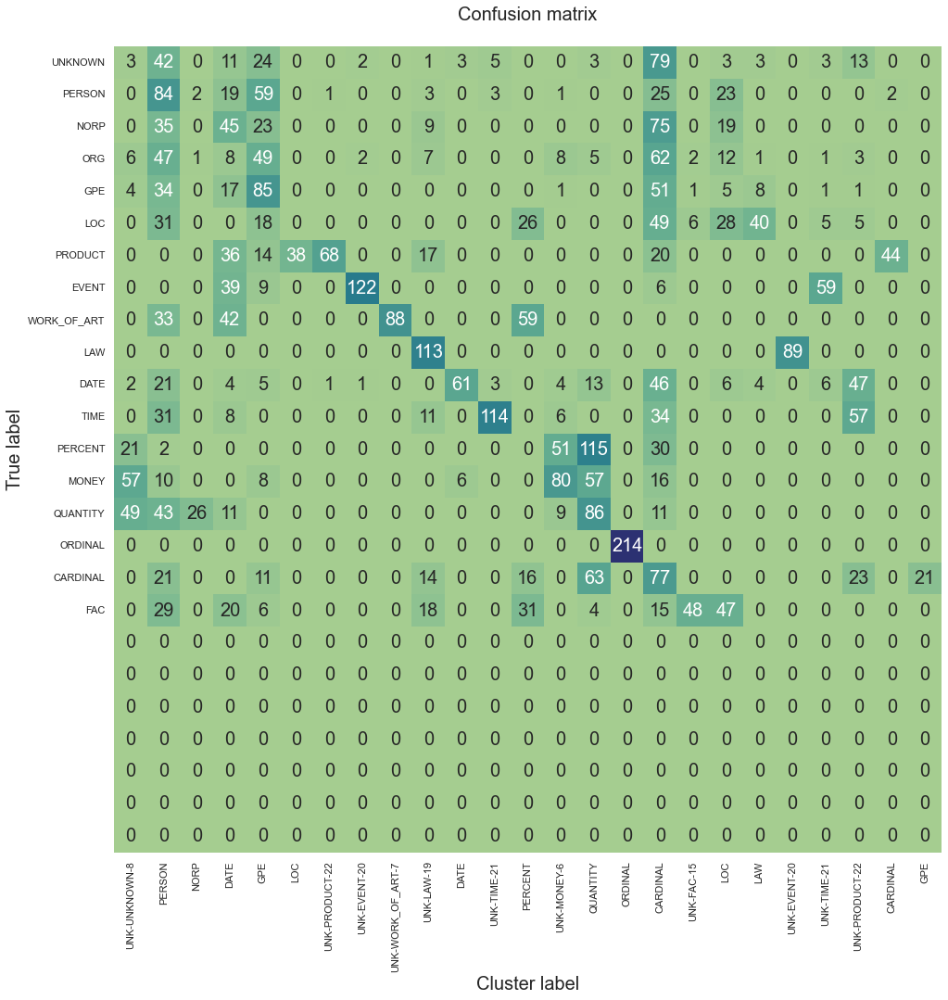

F1 score (macro) = 0.5569
Accuracy = 0.4923
Precision = 0.8938
Recall = 0.4963
New clusters =      2
... wrote results to c:\Users\Will\Projects\MSc\project\src\results\benchmark-10k-with-rearrange\index.html
CPU times: total: 2min 7s
Wall time: 34.5 s


In [ ]:
%%time
# benchmark with cluster rearrangement

dc = None
dc = DeepLatentCluster(
    'benchmark-10k-with-rearrange',
    {
        'train_size':0,
        "cluster": "Kmeans"
    })
# dc.make_model()
# dc.train_model()
dc.benchmark_model(sample_size=4000, verbose=0)

In [ ]:
dc.visualise_umap(dc.x_sample, dc.y_sample, to_dir=False)

array(['EVENT', 'GPE', 'LOC', ..., 'FAC', 'FAC', 'GPE'], dtype='<U11')


F1 by Known Clusters: 0.0000


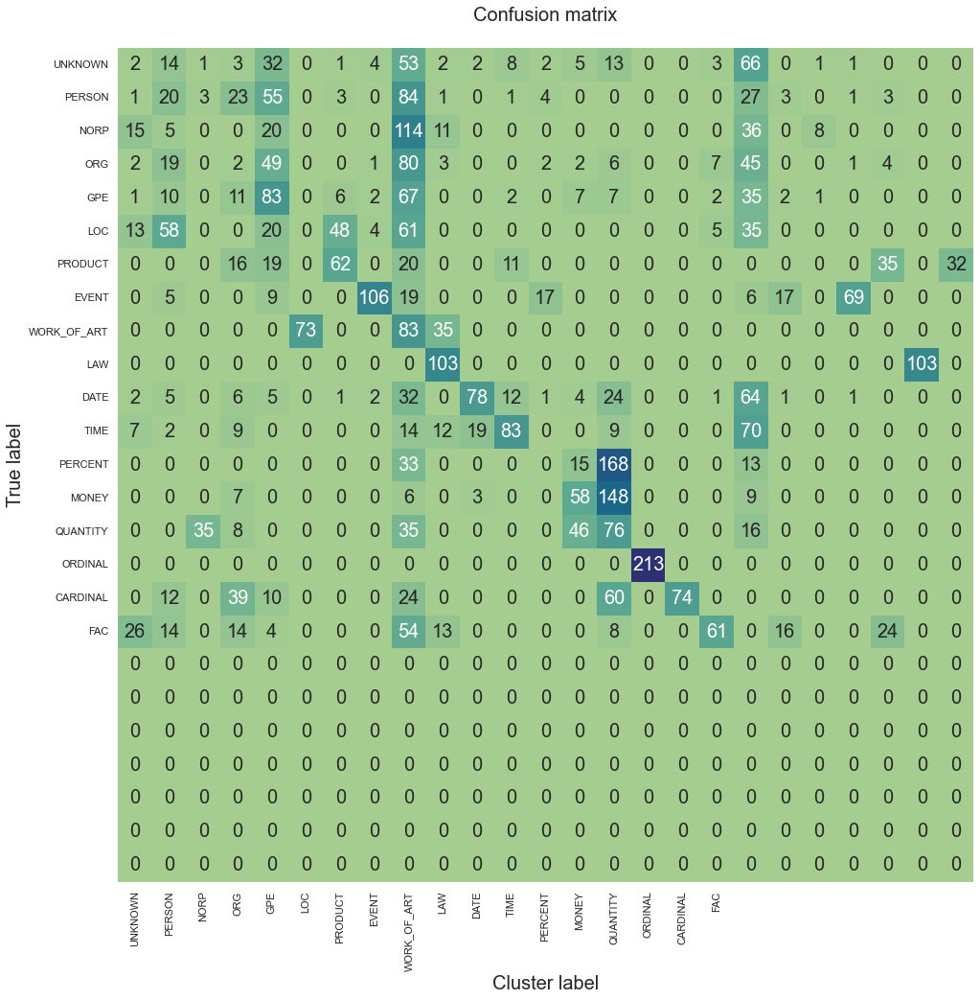

F1 score (macro) = 0.5629
Accuracy = 0.4995
Precision = 0.8387
Recall = 0.5056
... wrote results to c:\Users\Will\Projects\MSc\project\src\results\benchmark-10k-no-rearrange\index.html
CPU times: total: 2min 22s
Wall time: 35.4 s


{'f1': 0.5628952904470155,
 'acc': 0.4995,
 'precision': 0.8386756960120391,
 'recall': 0.5055828568035355,
 'cluster F1': False}

In [ ]:
%%time
# benchmark without cluster rearrangement

dc = None
dc = DeepLatentCluster(
    'benchmark-10k-no-rearrange',
    {
        'train_size':0,
        'reconstr_weight':1.0,
        'latent_weight':1e-5,
        "cluster": "Kmeans"
    })
# dc.make_model()
# dc.train_model()
dc.random_benchmark(sample_size=4000, verbose=0)

In [ ]:
%%time

dc = None
dc = DeepLatentCluster(
    'test-latent-10k-Benchmark',
    {
        'train_size':0,
        'reconstr_weight':1.0,
        'latent_weight':1e-5,
        "cluster": "OPTICS"
    })
# dc.make_model()
# dc.train_model()
dc.benchmark_model(sample_size=2000, verbose=0)


F1 by Known Clusters: 0.2451
F1 score (macro) = 0.6726
Accuracy = 0.6505
Precision = 0.8971
Recall = 0.6433
... wrote results to c:\Users\Will\Projects\MSc\project\src\results\test-latent-10k-Benchmark\index.html
CPU times: total: 32min 1s
Wall time: 2min 41s


In [ ]:
stop

In [ ]:
tf.get_logger().setLevel('ERROR')

dc = DeepLatentCluster(
    'test-latent-all-10ent',
    {
        'entity_count': 10,
        'train_size':0,
        'reconstr_weight':1.0, 'latent_weight':1e-5
    })
dc.make_model()
# dc.train_model()

Autoencoder
Latent Model
Layer latent_0: 2000 activation=None
Layer latent_1: 500 activation=None
Layer latent_2: 500 activation=None
Layer latent_out: 2000 activation=sigmoid
model compiled


In [ ]:
dc.evaluate_model(10000, sample_size=1000)

Load Data
Loading ./data/conll_spacy_10000_test.pkl
LOADED {1: 'UNKNOWN', 2: 'PERSON', 4: 'ORG', 5: 'GPE', 11: 'DATE', 12: 'TIME', 8: 'EVENT', 16: 'ORDINAL', 3: 'NORP', 14: 'MONEY', 15: 'QUANTITY', 18: 'FAC', 6: 'LOC', 7: 'PRODUCT', 10: 'LAW', 9: 'WORK_OF_ART', 17: 'CARDINAL', 13: 'PERCENT'}
Loaded file: 12479 samples
Data balance:
[[    1 10305]
 [    2   404]
 [    3    24]
 [    4   439]
 [    5   668]
 [    6    44]
 [    7    14]
 [    8    24]
 [    9     5]
 [   10     2]
 [   11   380]
 [   12    31]
 [   13    38]
 [   14    30]
 [   15    29]
 [   16     1]
 [   17    15]
 [   18    26]]
Balancing data
Post Oversampling
x: (185490, 768), y: (185490,)
{0: 'UNKNOWN', 1: 'PERSON', 2: 'NORP', 3: 'ORG', 4: 'GPE', 5: 'LOC', 6: 'PRODUCT', 7: 'EVENT', 8: 'WORK_OF_ART', 9: 'LAW', 10: 'DATE', 11: 'TIME', 12: 'PERCENT', 13: 'MONEY', 14: 'QUANTITY', 15: 'ORDINAL', 16: 'CARDINAL', 17: 'FAC'}
Test Data Loaded
Autoencoder
Latent Model
Layer latent_0: 2000 activation=None
Layer latent_1: 500

  0%|          | 0/724 [00:00<?, ?it/s]

Clustering 1000 points
Initialization 0
Initialization converged: True	 time lapse 19.37085s	 ll 11881.56552
Visualising
UMAP(metric='manhattan', verbose=True)
Sat Aug 27 10:53:04 2022 Construct fuzzy simplicial set
Sat Aug 27 10:53:05 2022 Finding Nearest Neighbors
Sat Aug 27 10:53:07 2022 Finished Nearest Neighbor Search
Sat Aug 27 10:53:09 2022 Construct embedding


Epochs completed:   0%|            0/500 [00:00]

Sat Aug 27 10:53:11 2022 Finished embedding
CLUSTERS


# Hypertuning

In [ ]:
# optimal eps https://iopscience.iop.org/article/10.1088/1755-1315/31/1/012012/pdf

from sklearn.neighbors import NearestNeighbors

def optimal_eps(X, n_neighbors=10):
    neigh = NearestNeighbors(n_neighbors=2)
    nbrs = neigh.fit(X)
    distances, indices = nbrs.kneighbors(X)
    distances = np.sort(distances, axis=0)
    distances = distances[:,1]
    plt.plot(distances)

In [ ]:
def hypertune_density_clustering():
    """
    hypertune the density clustering algorithms.
    """
    eps_vals = [30000.0, 40000.0, 50000.0]
    x, y, mapping, strings = load_data(
                                    1000,
                                    oversample=True,
                                    get_text=True)
    print(f"Optimal epsilon: {optimal_eps(x)}")
    for eps in eps_vals:
        # predict cluster labels
        print(f"Predicting...for epsilon={eps}")
        y_pred, _ = do_clustering('DBSCAN', 25, x, params={'eps':eps})
        print(f"ACC: {cluster_score(y, y_pred, 25)}")
        # confusion matrix
        cm_width = max(8, len(np.unique(y_pred)) * 2)
        cm_width = min(16, cm_width)
        plot_confusion(y, y_pred, mapping, size=cm_width, save_dir=None, details=False)

In [ ]:
hypertune_density_clustering()

# Train with noise

Autoencoder
Latent Model
model compiled
Load Data
Loading ./data/conll_spacy_0.pkl
LOADED {1: 'UNKNOWN', 4: 'ORG', 2: 'PERSON', 12: 'DATE', 5: 'GPE', 6: 'LOC', 16: 'QUANTITY', 14: 'PERCENT', 8: 'EVENT', 15: 'MONEY', 3: 'NORP', 17: 'ORDINAL', 19: 'FAC', 13: 'TIME', 18: 'CARDINAL', 7: 'PRODUCT', 10: 'LANGUAGE', 9: 'WORK_OF_ART', 11: 'LAW'}
Loaded file: 9153 samples
Data balance:
[[   2 2080]
 [   3  142]
 [   4 1950]
 [   5 2664]
 [   6  114]
 [  12 1659]
 [  13  143]
 [  14  151]
 [  15  111]
 [  16  139]]
Balancing data
Post Oversampling
x: (26640, 768), y: (26640,)
{0: 'PERSON', 1: 'NORP', 2: 'ORG', 3: 'GPE', 4: 'LOC', 5: 'DATE', 6: 'TIME', 7: 'PERCENT', 8: 'MONEY', 9: 'QUANTITY'}
Data Loaded
Data Loaded
Training autoencoder
Epoch 1/1000
105/105 [==============================] - 1s 4ms/step - loss: 0.0924
Epoch 2/1000
105/105 [==============================] - 0s 2ms/step - loss: 0.0770
Epoch 3/1000
105/105 [==============================] - 0s 2ms/step - loss: 0.0635
Epoch 4/1000
10

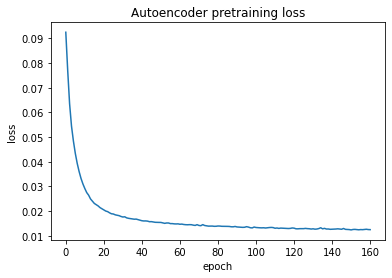

Iter:0 -> loss:0
Iter:140 -> loss:0.278009831905365
Iter:280 -> loss:0.2712785005569458
Iter:420 -> loss:0.2684745490550995
Iter:560 -> loss:0.26624009013175964
Iter:700 -> loss:0.2647261321544647
Iter:840 -> loss:0.2643788456916809
Iter:980 -> loss:0.2628762125968933
Iter:1120 -> loss:0.26055970788002014
Iter:1260 -> loss:0.25919196009635925
Iter:1400 -> loss:0.25956857204437256
Iter:1540 -> loss:0.25874316692352295
Iter:1680 -> loss:0.257563054561615
Iter:1820 -> loss:0.25634926557540894
Iter:1960 -> loss:0.25867974758148193
Iter:2100 -> loss:0.2588096261024475
Iter:2240 -> loss:0.2559618055820465
Iter:2380 -> loss:0.25514480471611023
Iter:2520 -> loss:0.25673210620880127
Iter:2660 -> loss:0.25658857822418213
Iter:2800 -> loss:0.25567519664764404
Iter:2940 -> loss:0.2567903995513916
Iter:3080 -> loss:0.25481992959976196
Iter:3220 -> loss:0.2557295858860016
Iter:3360 -> loss:0.2556922733783722
Iter:3500 -> loss:0.2565091550350189
Iter:3640 -> loss:0.255708783864975
Iter:3780 -> loss:0

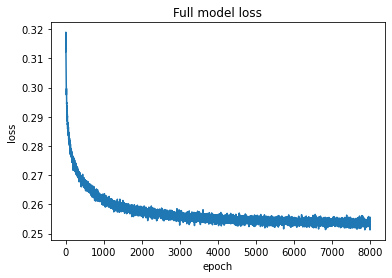

Training Done


In [ ]:
tf.get_logger().setLevel('ERROR')

dc = None
dc = DeepLatentCluster(
        'test-latent-noise',
        {
            'train_size':0,
            'reconstr_weight':1.0,
            'latent_weight':1e-5,
            "cluster": None,
            "noise_factor": 0.5,
        })
dc.make_model()
dc.train_model(verbose=0)

# Evaluate all 

## different entity counts in training

## No noise

In [ ]:
for entity_count in [0, 5, 10, 15]:
    run_name = f'test-latent-no-noise-{entity_count}-ents'
    print('-'*50)
    print(f"{run_name}")
    print('-'*50)

    dc = None
    dc = DeepLatentCluster(
        run_name,
        {
            'train_size':0,
            'reconstr_weight':1.0,
            'latent_weight':1e-5,
            "cluster": 'Kmeans',
            "entity_count": entity_count,
        })
    dc.make_model()
    # dc.train_model(verbose=0)
    dc.evaluate_model(
            run_name,
            head='z',
            sample_size=4000,
            verbose=0)

--------------------------------------------------
test-latent-no-noise-0-ents
--------------------------------------------------
Autoencoder
Latent Model
model compiled

F1 by Known Clusters: 0.3051
F1 score (macro) = 0.4944
Accuracy = 0.4587
Precision = 0.7829
Recall = 0.4543
... wrote results  <a href="c:\Users\Will\Projects\MSc\project\src\results\test-latent-no-noise-0-ents\index.html">c:\Users\Will\Projects\MSc\project\src\results\test-latent-no-noise-0-ents\index.html</a>
Finished 'evaluate_model' in 42.866 secs
--------------------------------------------------
test-latent-no-noise-5-ents
--------------------------------------------------
Autoencoder
Latent Model
model compiled

F1 by Known Clusters: 0.2722
F1 score (macro) = 0.5432
Accuracy = 0.4943
Precision = 0.8392
Recall = 0.4903
... wrote results  <a href="c:\Users\Will\Projects\MSc\project\src\results\test-latent-no-noise-5-ents\index.html">c:\Users\Will\Projects\MSc\project\src\results\test-latent-no-noise-5-ents\index.

## with noise

In [ ]:
for entity_count in [0, 5, 10, 15]:
    run_name = f'test-latent-noise-{entity_count}-ents'
    print('-'*50)
    print(f"{run_name}")
    print('-'*50)

    dc = None
    dc = DeepLatentCluster(
        run_name,
        {
            'train_size':0,
            'reconstr_weight':1.0,
            'latent_weight':1e-5,
            "cluster": 'Kmeans',
            "entity_count": entity_count,
            "noise_factor": 0.5,
        })
    dc.make_model()
    # dc.train_model(verbose=0)
    dc.evaluate_model(
            run_name,
            head='z',
            sample_size=4000,
            verbose=0)

--------------------------------------------------
test-latent-noise-0-ents
--------------------------------------------------
Autoencoder
Latent Model
model compiled

F1 by Known Clusters: 0.2405
F1 score (macro) = 0.5152
Accuracy = 0.4475
Precision = 0.8383
Recall = 0.4500
... wrote results  <a href="c:\Users\Will\Projects\MSc\project\src\results\test-latent-noise-0-ents\index.html">c:\Users\Will\Projects\MSc\project\src\results\test-latent-noise-0-ents\index.html</a>
Finished 'evaluate_model' in 43.886 secs
--------------------------------------------------
test-latent-noise-5-ents
--------------------------------------------------
Autoencoder
Latent Model
model compiled

F1 by Known Clusters: 0.2957
F1 score (macro) = 0.5189
Accuracy = 0.4775
Precision = 0.7834
Recall = 0.4716
... wrote results  <a href="c:\Users\Will\Projects\MSc\project\src\results\test-latent-noise-5-ents\index.html">c:\Users\Will\Projects\MSc\project\src\results\test-latent-noise-5-ents\index.html</a>
Finished 

# Grid Search Clustering

## with noise

In [ ]:
heads = ["z", "ae", "enc"]
clusterers = {"Kmeans": 4000, "GMM": 4000, "OPTICS":3000, "agg":4000}
repeats = 3

scores = []

for head in heads:
    for clusterer in clusterers:
        run_name = f'test-latent-noise-15-ents-{head}-{clusterer}'
        print('-'*50)
        print(f"{run_name}")
        print('-'*50)
        
        for r in range(repeats):
            print(f"Run {r+1}")
            dc = None
            dc = DeepLatentCluster(
                run_name,
                {
                    'train_size':0,
                    'reconstr_weight':1.0,
                    'latent_weight':1e-5,
                    "cluster": clusterer,
                })
            
            score = dc.evaluate_model(
                                f'test-latent-noise-15-ents',
                                head=head,
                                sample_size=clusterers[clusterer],
                                verbose=0)

            score['run_name'] = run_name
            scores.append(score)
        


--------------------------------------------------
test-latent-noise-15-ents-z-Kmeans
--------------------------------------------------
Run 1

F1 by Known Clusters: 0.1713
F1 score (macro) = 0.5551
Accuracy = 0.4913
Precision = 0.9504
Recall = 0.4890
... wrote results to c:\Users\Will\Projects\MSc\project\src\results\test-latent-noise-15-ents-z-Kmeans\index.html
Finished 'evaluate_model' in 49.122 secs
Run 2

F1 by Known Clusters: 0.2161
F1 score (macro) = 0.5257
Accuracy = 0.4635
Precision = 0.8385
Recall = 0.4647
... wrote results to c:\Users\Will\Projects\MSc\project\src\results\test-latent-noise-15-ents-z-Kmeans\index.html
Finished 'evaluate_model' in 48.744 secs
Run 3

F1 by Known Clusters: 0.2238
F1 score (macro) = 0.4930
Accuracy = 0.4280
Precision = 0.8943
Recall = 0.4240
... wrote results to c:\Users\Will\Projects\MSc\project\src\results\test-latent-noise-15-ents-z-Kmeans\index.html
Finished 'evaluate_model' in 51.051 secs
--------------------------------------------------
te

In [ ]:
summarise_scores(scores)

Run Name                                 Runs       F1 avg       F1 Cluster   F1 Global    Precision    Recall      
test-latent-noise-15-ents-z-Kmeans       3           0.3642       0.2037       0.5246      0.8944       0.4592      
test-latent-noise-15-ents-z-GMM          3           0.3692       0.2087       0.5297      0.8203       0.4674      
test-latent-noise-15-ents-z-OPTICS       3           0.5507       0.3523       0.7491      0.9541       0.7440      
test-latent-noise-15-ents-z-agg          3           0.3866       0.2385       0.5346      0.8201       0.4789      
test-latent-noise-15-ents-ae-Kmeans      3           0.3775       0.2333       0.5217      0.8385       0.4601      
test-latent-noise-15-ents-ae-GMM         3           0.3861       0.2634       0.5088      0.8384       0.4508      
test-latent-noise-15-ents-ae-OPTICS      3           0.5410       0.3363       0.7457      0.9541       0.7376      
test-latent-noise-15-ents-ae-agg         3           0.4024     

## Evaluate all without noise

In [ ]:
heads = ["z", "ae", "enc"]
clusterers = {"Kmeans": 4000, "GMM": 4000, "OPTICS":3000, "agg":4000}

runs = 3
scores = []
for head in heads:
    for clusterer in clusterers:
        for r in range(runs):
            print(f"Run {r+1}")
            run_name = f'test-latent-noise-15-ents-{head}-{clusterer}'
            
            print('-'*50)
            print(f"{run_name}")
            print('-'*50)
            
            dc = None
            dc = DeepLatentCluster(
                run_name,
                {
                    'train_size':0,
                    'reconstr_weight':1.0,
                    'latent_weight':1e-5,
                    "cluster": clusterer,
                })
            
            score = dc.evaluate_model(
                        f'test-latent-noise-15-ents',
                        head=head,
                        sample_size=clusterers[clusterer],
                        verbose=0)
            score['run_name'] = run_name
            scores.append(score)

Run 1
--------------------------------------------------
test-latent-noise-15-ents-z-Kmeans
--------------------------------------------------

F1 by Known Clusters: 0.2360
F1 score (macro) = 0.5123
Accuracy = 0.4497
Precision = 0.8383
Recall = 0.4523
... wrote results to c:\Users\Will\Projects\MSc\project\src\results\test-latent-noise-15-ents-z-Kmeans\index.html
Finished 'evaluate_model' in 48.158 secs
Run 2
--------------------------------------------------
test-latent-noise-15-ents-z-Kmeans
--------------------------------------------------

F1 by Known Clusters: 0.2523
F1 score (macro) = 0.5446
Accuracy = 0.4705
Precision = 0.8944
Recall = 0.4745
... wrote results to c:\Users\Will\Projects\MSc\project\src\results\test-latent-noise-15-ents-z-Kmeans\index.html
Finished 'evaluate_model' in 48.682 secs
Run 3
--------------------------------------------------
test-latent-noise-15-ents-z-Kmeans
--------------------------------------------------

F1 by Known Clusters: 0.2512
F1 score (mac

In [ ]:
summarise_scores(scores)


Run Name                                 Runs       F1 avg       F1 Cluster   F1 Global    Precision    Recall      
test-latent-noise-15-ents-z-Kmeans       3           0.3847       0.2465       0.5230      0.8385       0.4611      
test-latent-noise-15-ents-z-GMM          3           0.3804       0.2418       0.5191      0.8014       0.4611      
test-latent-noise-15-ents-z-OPTICS       3           0.5453       0.3506       0.7401      0.9353       0.7334      
test-latent-noise-15-ents-z-agg          3           0.3795       0.2283       0.5308      0.8570       0.4721      
test-latent-noise-15-ents-ae-Kmeans      3           0.4185       0.3375       0.4996      0.8200       0.4470      
test-latent-noise-15-ents-ae-GMM         3           0.4168       0.3432       0.4905      0.8013       0.4361      
test-latent-noise-15-ents-ae-OPTICS      3           0.5590       0.3746       0.7434      0.9550       0.7378      
test-latent-noise-15-ents-ae-agg         3           0.4217     

# Radius BMs

In [ ]:
# assert False, "One time run"
for radius in [8, 10]:
    load_data(0, oversample=False, radius=radius, verbose=0)

Creating data


  0%|          | 0/3 [00:00<?, ?it/s]

Reading lines


100%|██████████| 14041/14041 [00:00<00:00, 163989.00it/s]


Loading ./data\conll_n0_train
Embedding sentences radius 8


14041it [00:52, 266.50it/s]


Finished 'get_training_data_spacy' in 58.018 secs
SAVED ./data/conll_spacy_n0_r8.pkl
Creating data


  0%|          | 0/3 [00:00<?, ?it/s]

Reading lines


100%|██████████| 14041/14041 [00:00<00:00, 161392.77it/s]


Loading ./data\conll_n0_train
Embedding sentences radius 10


14041it [00:53, 263.91it/s]


Finished 'get_training_data_spacy' in 57.841 secs
SAVED ./data/conll_spacy_n0_r10.pkl


: 

## AE-head different radii

--------------------------------------------------
test-latent-noise-15-ae-r0-Kmeans
--------------------------------------------------
Autoencoder
Latent Model
model compiled
Epoch 178: early stopping


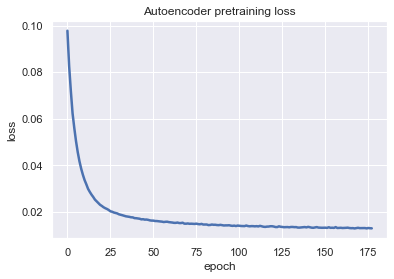

  0%|          | 0/8000 [00:00<?, ?it/s]

Stop traing for tolerance threshold reached
Iter: 1075 loss=0.014260295778512955


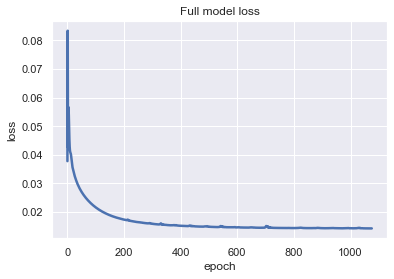

Training Done

F1 by Known Clusters: 0.3066


<Figure size 432x288 with 0 Axes>

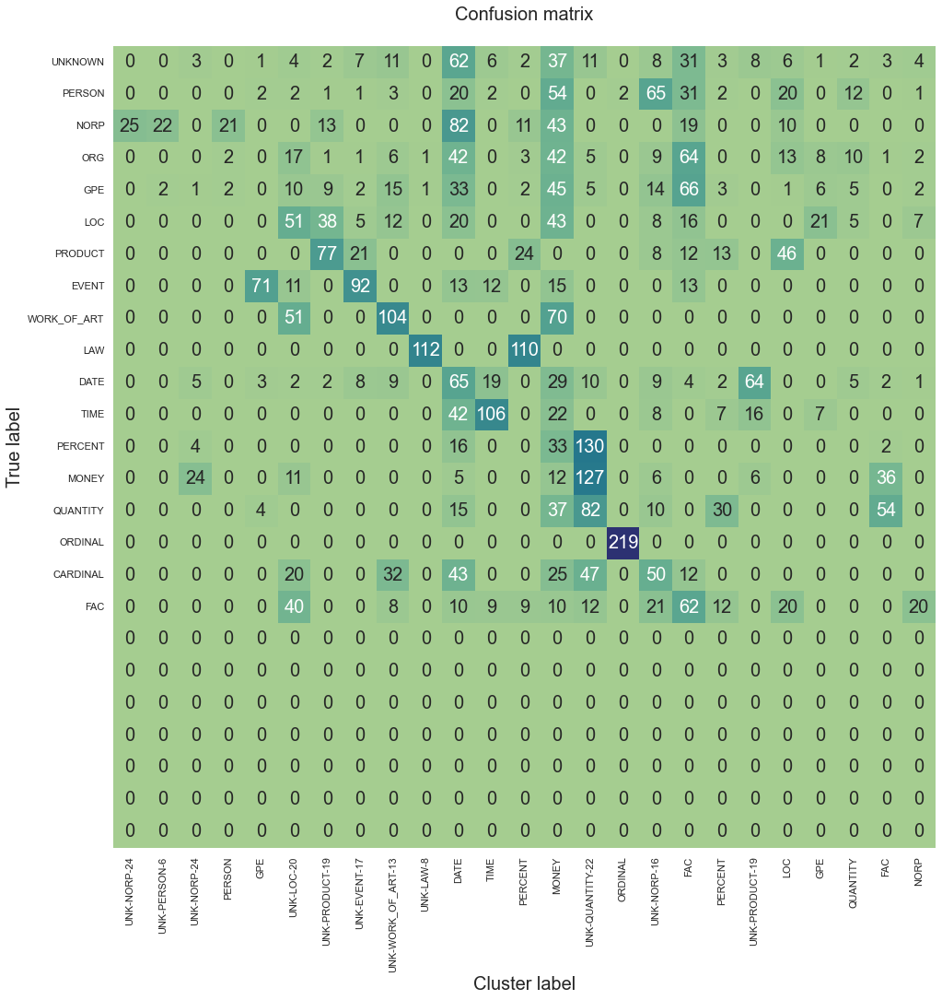

F1 score (macro) = 0.5365
Accuracy = 0.4765
Precision = 0.8384
Recall = 0.4841
New clusters =      3
... wrote results to c:\Users\Will\Projects\MSc\project\src\results\test-latent-noise-15-ae-r0-Kmeans\index.html
Finished 'evaluate_model' in 37.837 secs
--------------------------------------------------
test-latent-noise-15-ae-r0-Kmeans
--------------------------------------------------
Autoencoder
Latent Model
model compiled
Epoch 153: early stopping


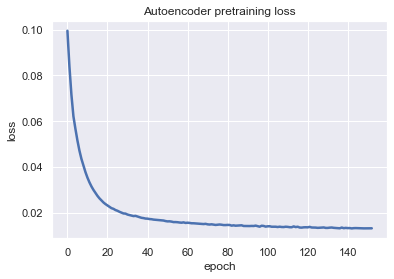

  0%|          | 0/8000 [00:00<?, ?it/s]

Stop traing for tolerance threshold reached
Iter: 605 loss=0.014402310363948345


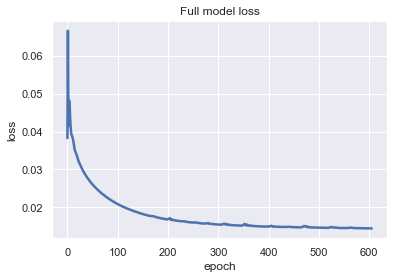

Training Done

F1 by Known Clusters: 0.1867


<Figure size 432x288 with 0 Axes>

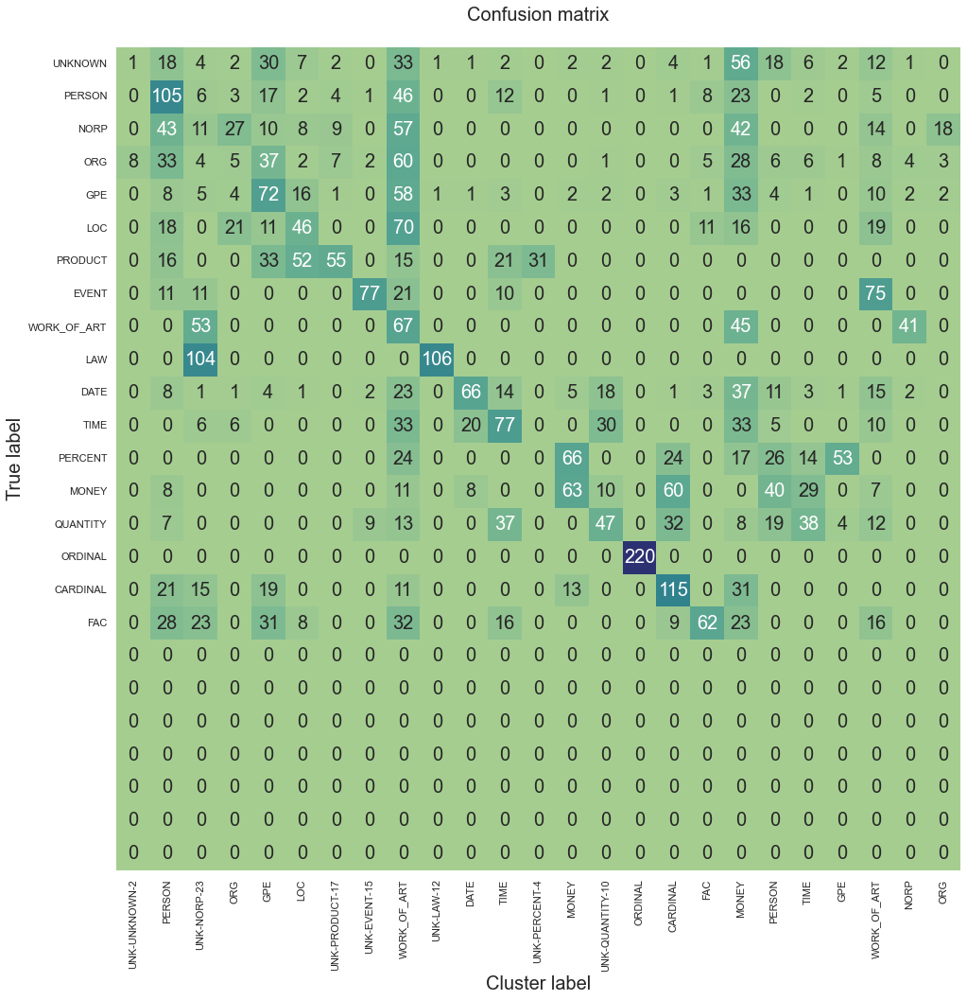

F1 score (macro) = 0.5377
Accuracy = 0.4575
Precision = 0.9492
Recall = 0.4648
New clusters =      4
... wrote results to c:\Users\Will\Projects\MSc\project\src\results\test-latent-noise-15-ae-r0-Kmeans\index.html
Finished 'evaluate_model' in 36.547 secs
--------------------------------------------------
test-latent-noise-15-ae-r0-Kmeans
--------------------------------------------------
Autoencoder
Latent Model
model compiled
Epoch 103: early stopping


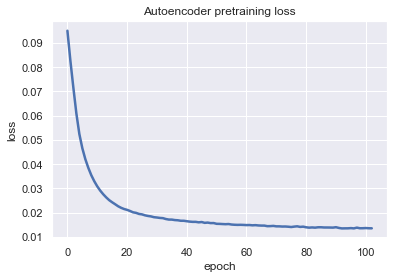

  0%|          | 0/8000 [00:00<?, ?it/s]

Stop traing for tolerance threshold reached
Iter: 955 loss=0.01410555001348257


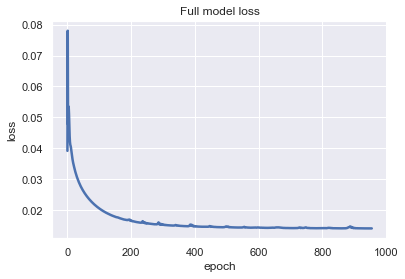

Training Done

F1 by Known Clusters: 0.2343


<Figure size 432x288 with 0 Axes>

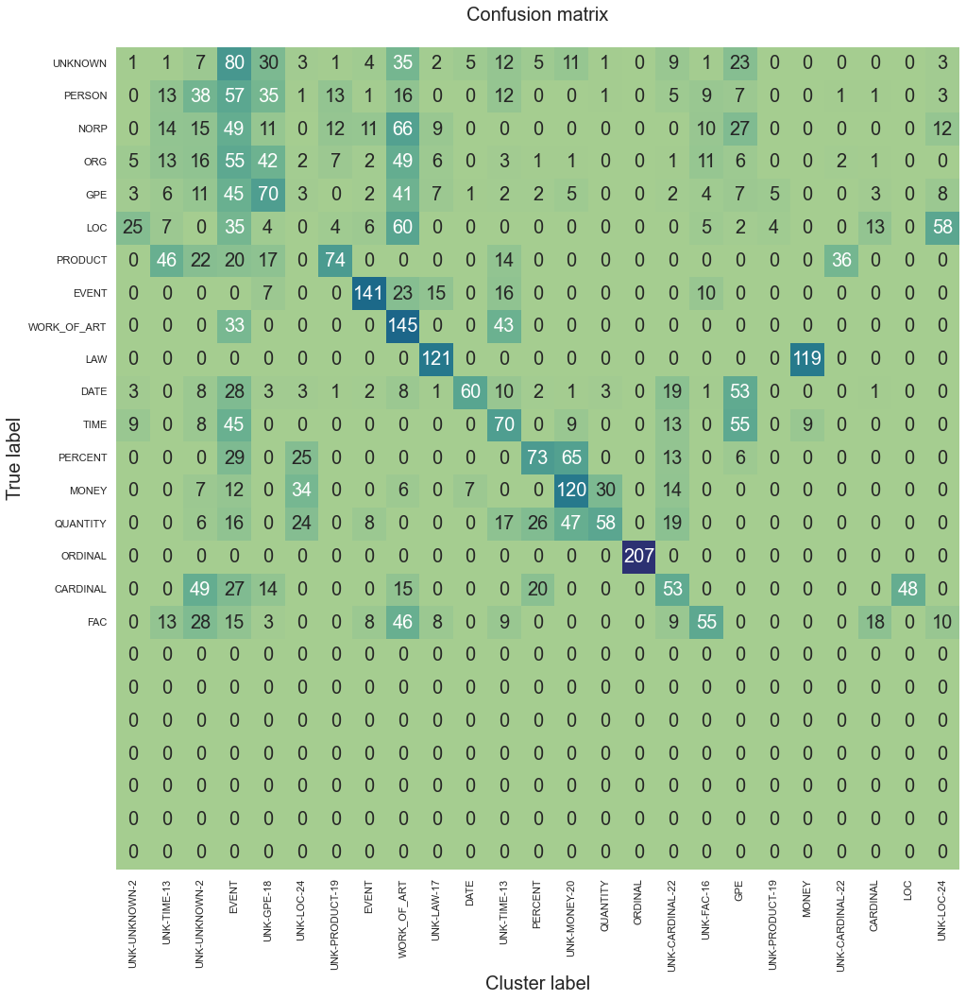

F1 score (macro) = 0.5462
Accuracy = 0.4935
Precision = 0.7835
Recall = 0.4910
New clusters =      3
... wrote results to c:\Users\Will\Projects\MSc\project\src\results\test-latent-noise-15-ae-r0-Kmeans\index.html
Finished 'evaluate_model' in 37.846 secs
--------------------------------------------------
test-latent-noise-15-ae-r2-Kmeans
--------------------------------------------------
Autoencoder
Latent Model
model compiled
Epoch 200: early stopping


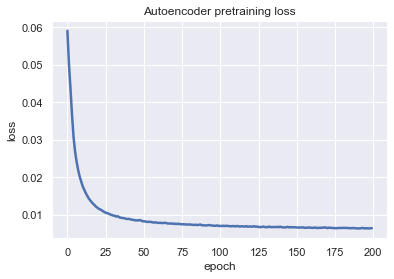

  0%|          | 0/8000 [00:00<?, ?it/s]

Stop traing for tolerance threshold reached
Iter: 578 loss=0.014526826329529285


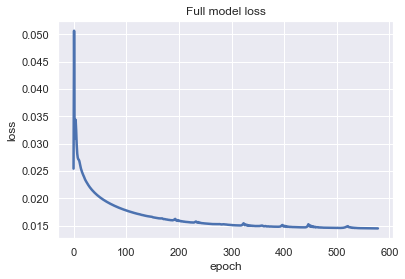

Training Done

F1 by Known Clusters: 0.2911


<Figure size 432x288 with 0 Axes>

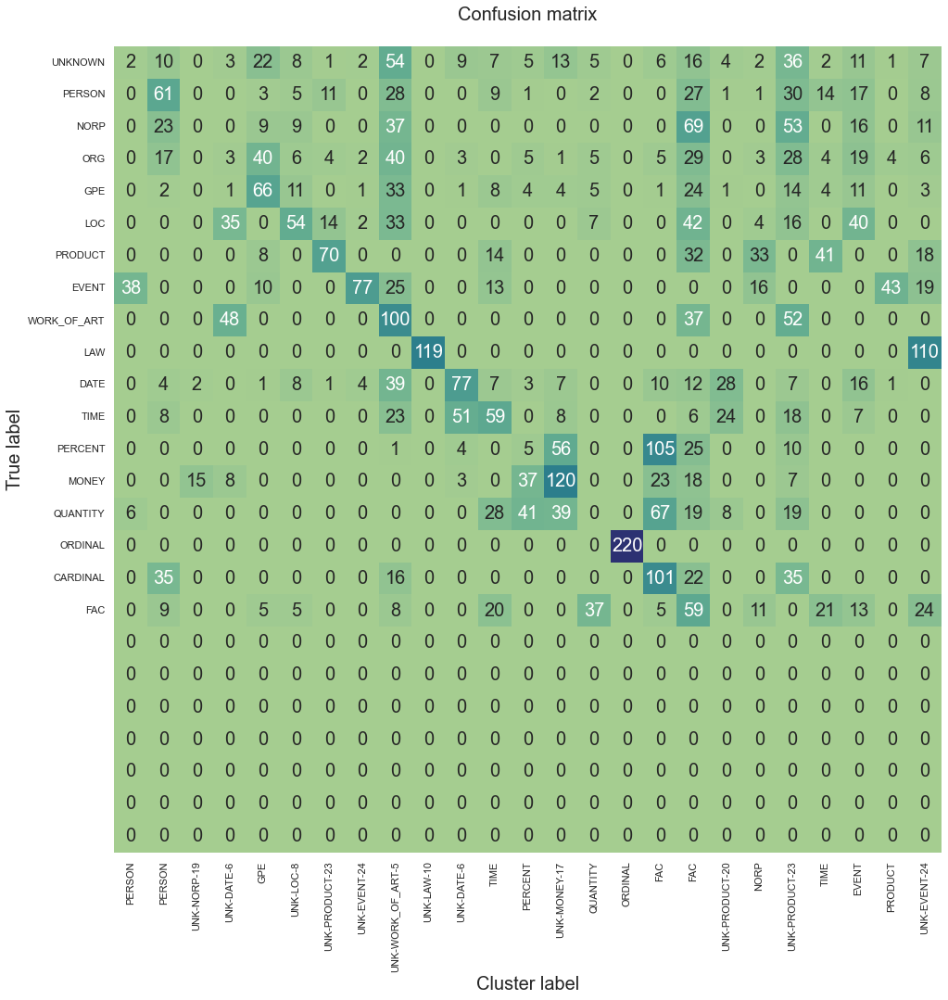

F1 score (macro) = 0.5460
Accuracy = 0.4875
Precision = 0.8388
Recall = 0.4823
New clusters =      3
... wrote results to c:\Users\Will\Projects\MSc\project\src\results\test-latent-noise-15-ae-r2-Kmeans\index.html
Finished 'evaluate_model' in 38.462 secs
--------------------------------------------------
test-latent-noise-15-ae-r2-Kmeans
--------------------------------------------------
Autoencoder
Latent Model
model compiled
Epoch 130: early stopping


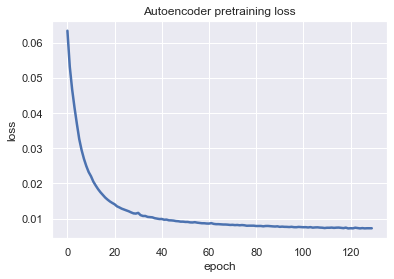

  0%|          | 0/8000 [00:00<?, ?it/s]

Stop traing for tolerance threshold reached
Iter: 731 loss=0.014379465021193027


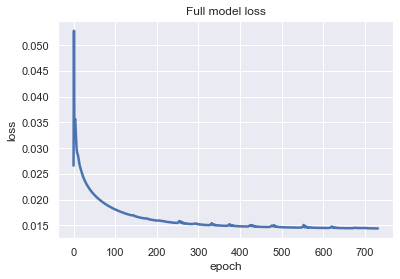

Training Done

F1 by Known Clusters: 0.2014


<Figure size 432x288 with 0 Axes>

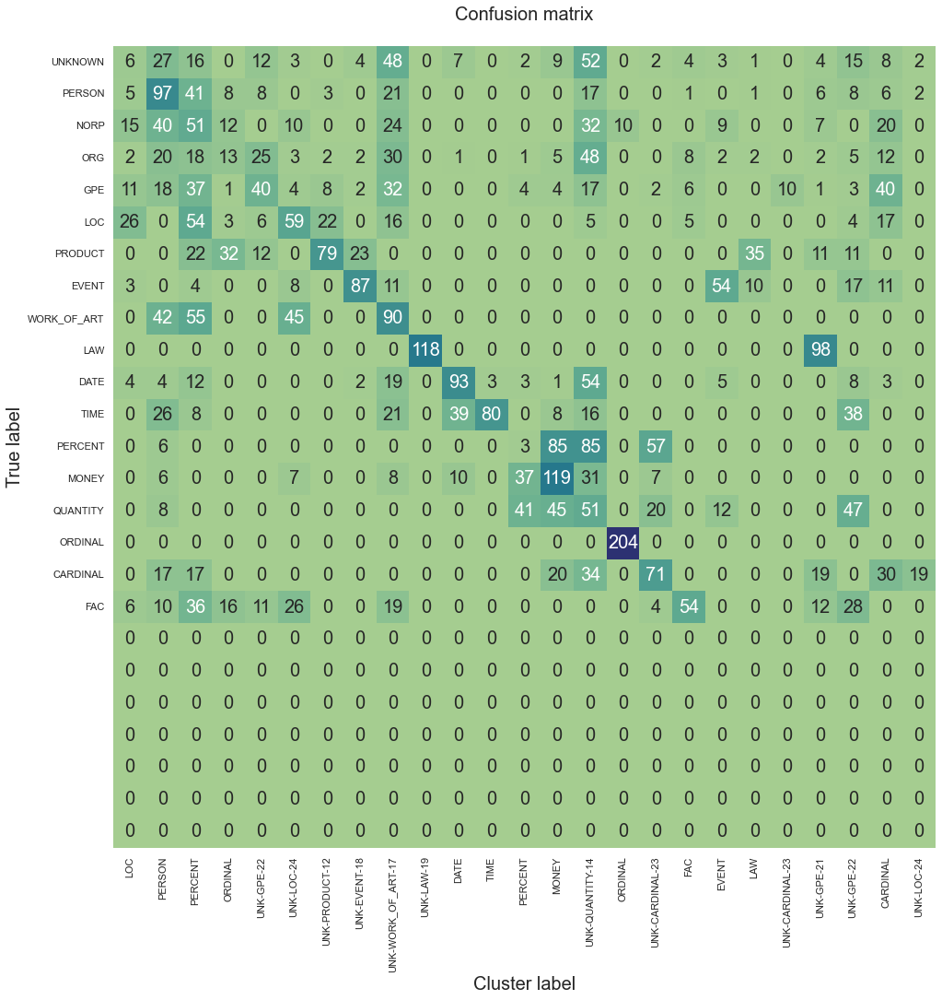

F1 score (macro) = 0.5626
Accuracy = 0.4895
Precision = 0.8388
Recall = 0.4924
New clusters =      5
... wrote results to c:\Users\Will\Projects\MSc\project\src\results\test-latent-noise-15-ae-r2-Kmeans\index.html
Finished 'evaluate_model' in 38.36 secs
--------------------------------------------------
test-latent-noise-15-ae-r2-Kmeans
--------------------------------------------------
Autoencoder
Latent Model
model compiled
Epoch 198: early stopping


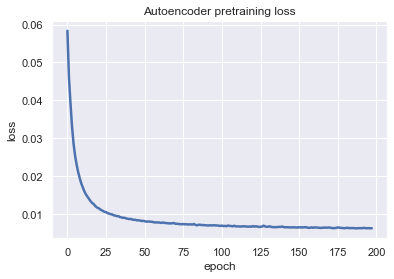

  0%|          | 0/8000 [00:00<?, ?it/s]

Stop traing for tolerance threshold reached
Iter: 540 loss=0.014523567631840706


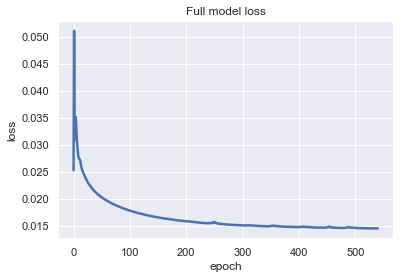

Training Done

F1 by Known Clusters: 0.1822


<Figure size 432x288 with 0 Axes>

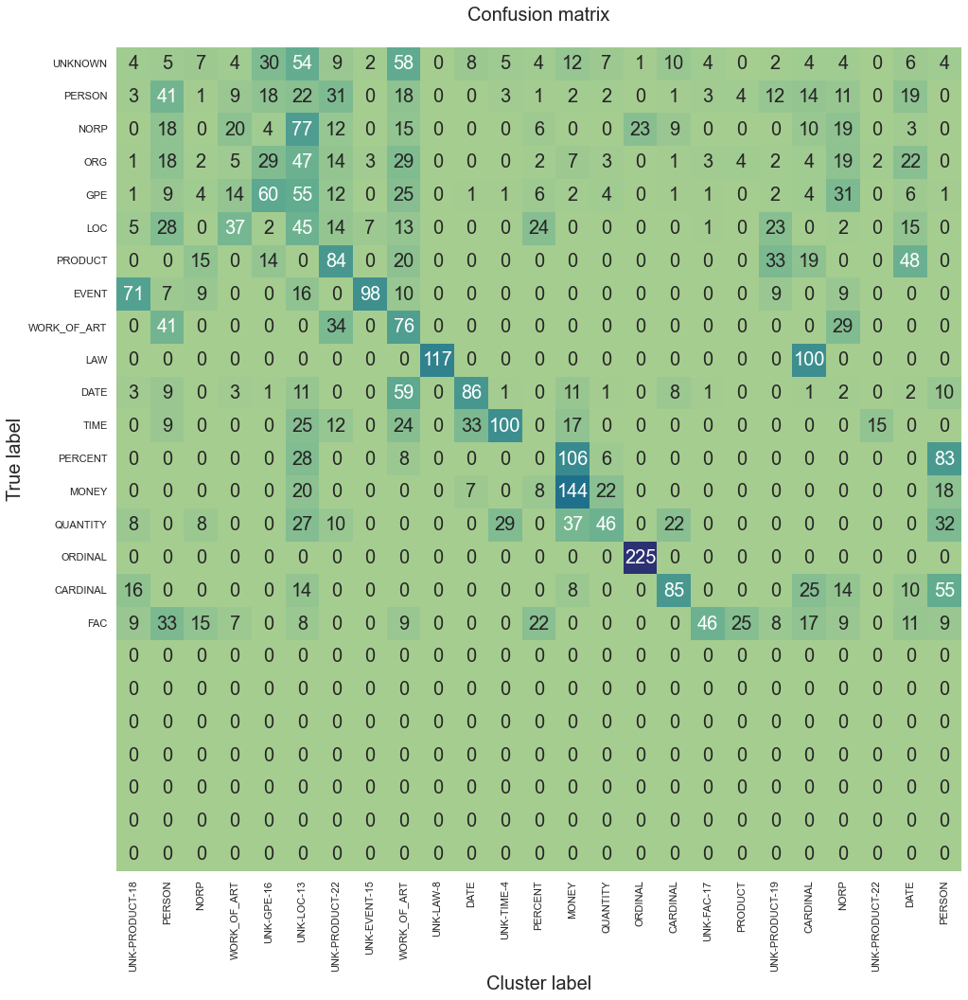

F1 score (macro) = 0.5709
Accuracy = 0.5028
Precision = 0.8950
Recall = 0.4975
New clusters =      6
... wrote results to c:\Users\Will\Projects\MSc\project\src\results\test-latent-noise-15-ae-r2-Kmeans\index.html
Finished 'evaluate_model' in 39.147 secs
--------------------------------------------------
test-latent-noise-15-ae-r4-Kmeans
--------------------------------------------------
Autoencoder
Latent Model
model compiled
Epoch 138: early stopping


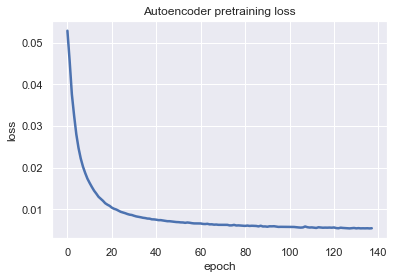

  0%|          | 0/8000 [00:00<?, ?it/s]

Stop traing for tolerance threshold reached
Iter: 570 loss=0.014513716101646423


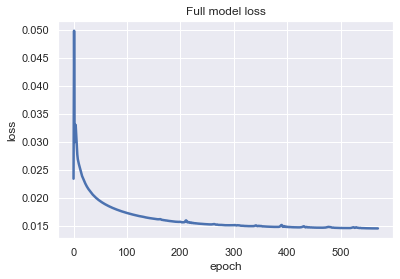

Training Done

F1 by Known Clusters: 0.2138


<Figure size 432x288 with 0 Axes>

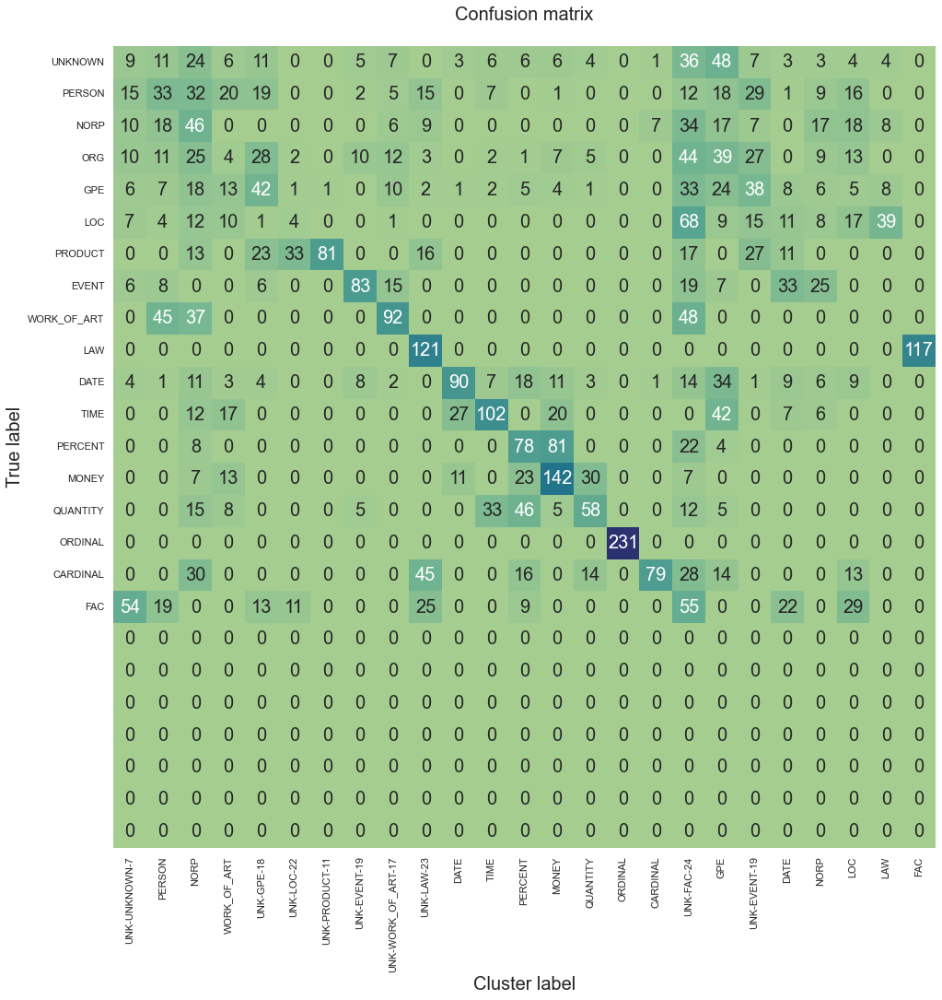

F1 score (macro) = 0.5635
Accuracy = 0.4875
Precision = 0.8939
Recall = 0.4907
New clusters =      6
... wrote results to c:\Users\Will\Projects\MSc\project\src\results\test-latent-noise-15-ae-r4-Kmeans\index.html
Finished 'evaluate_model' in 38.486 secs
--------------------------------------------------
test-latent-noise-15-ae-r4-Kmeans
--------------------------------------------------
Autoencoder
Latent Model
model compiled
Epoch 170: early stopping


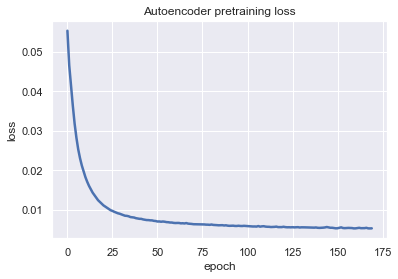

  0%|          | 0/8000 [00:00<?, ?it/s]

Stop traing for tolerance threshold reached
Iter: 639 loss=0.014485334046185017


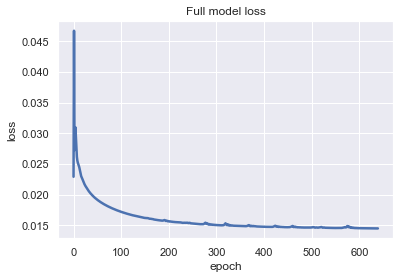

Training Done

F1 by Known Clusters: 0.3540


<Figure size 432x288 with 0 Axes>

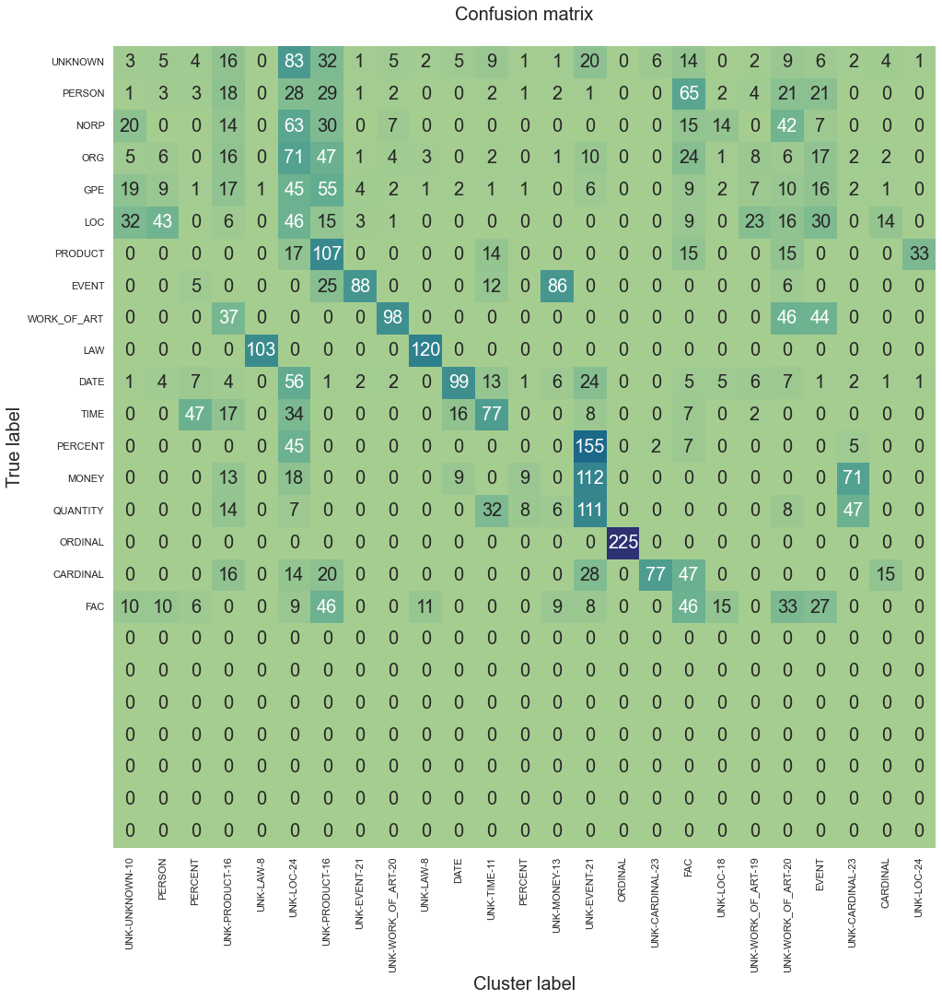

F1 score (macro) = 0.5188
Accuracy = 0.4865
Precision = 0.7278
Recall = 0.4869
New clusters =      2
... wrote results to c:\Users\Will\Projects\MSc\project\src\results\test-latent-noise-15-ae-r4-Kmeans\index.html
Finished 'evaluate_model' in 38.308 secs
--------------------------------------------------
test-latent-noise-15-ae-r4-Kmeans
--------------------------------------------------
Autoencoder
Latent Model
model compiled
Epoch 177: early stopping


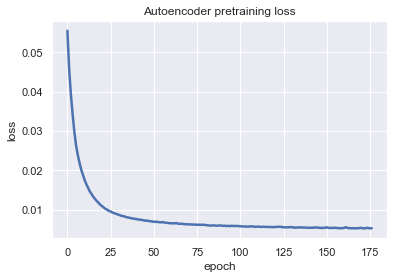

  0%|          | 0/8000 [00:00<?, ?it/s]

Stop traing for tolerance threshold reached
Iter: 618 loss=0.014506404288113117


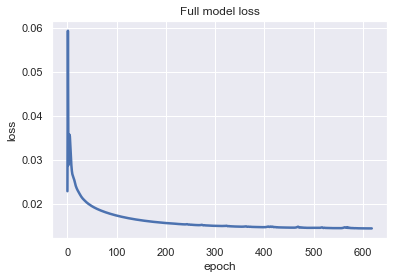

Training Done

F1 by Known Clusters: 0.2904


<Figure size 432x288 with 0 Axes>

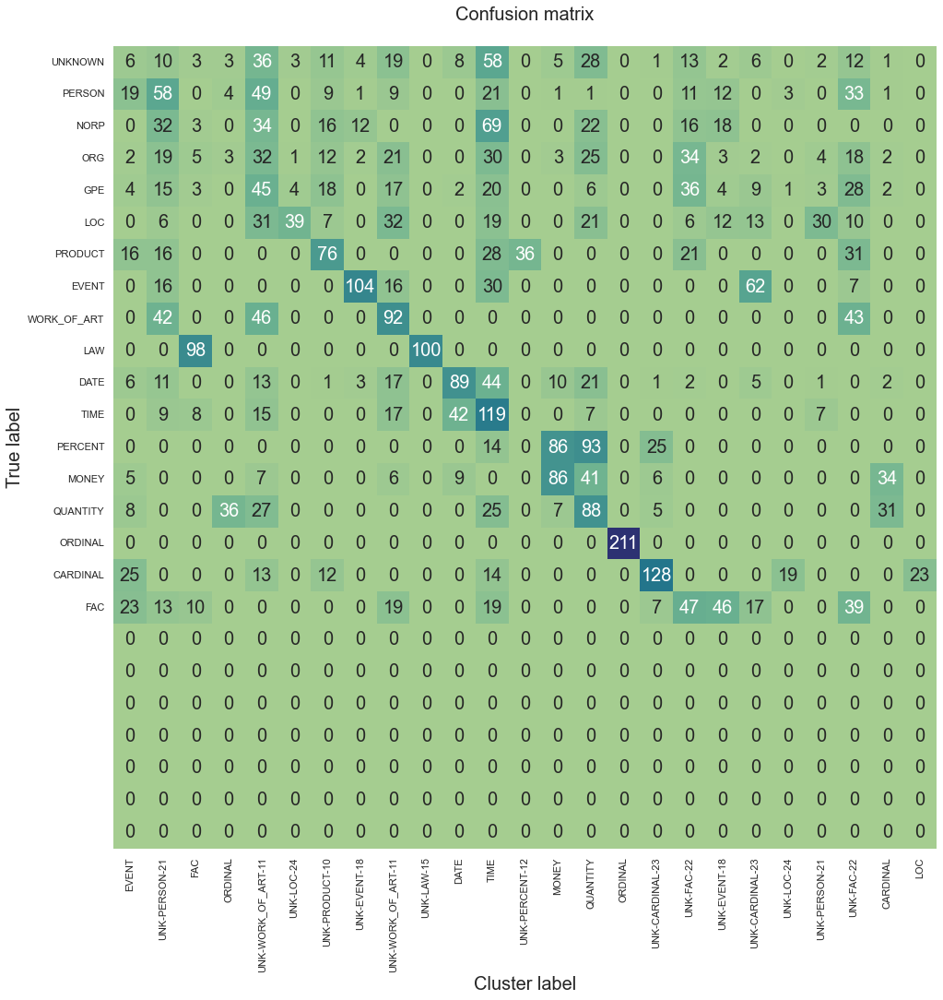

F1 score (macro) = 0.5408
Accuracy = 0.4935
Precision = 0.7835
Recall = 0.4933
New clusters =      3
... wrote results to c:\Users\Will\Projects\MSc\project\src\results\test-latent-noise-15-ae-r4-Kmeans\index.html
Finished 'evaluate_model' in 38.238 secs
--------------------------------------------------
test-latent-noise-15-ae-r6-Kmeans
--------------------------------------------------
Autoencoder
Latent Model
model compiled
Epoch 204: early stopping


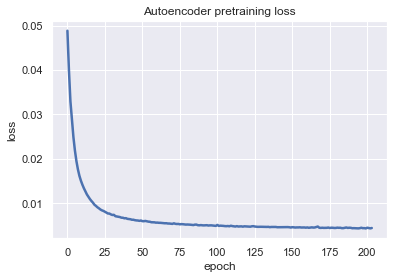

  0%|          | 0/8000 [00:00<?, ?it/s]

Stop traing for tolerance threshold reached
Iter: 578 loss=0.014494570903480053


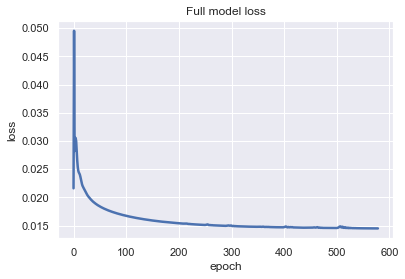

Training Done

F1 by Known Clusters: 0.2640


<Figure size 432x288 with 0 Axes>

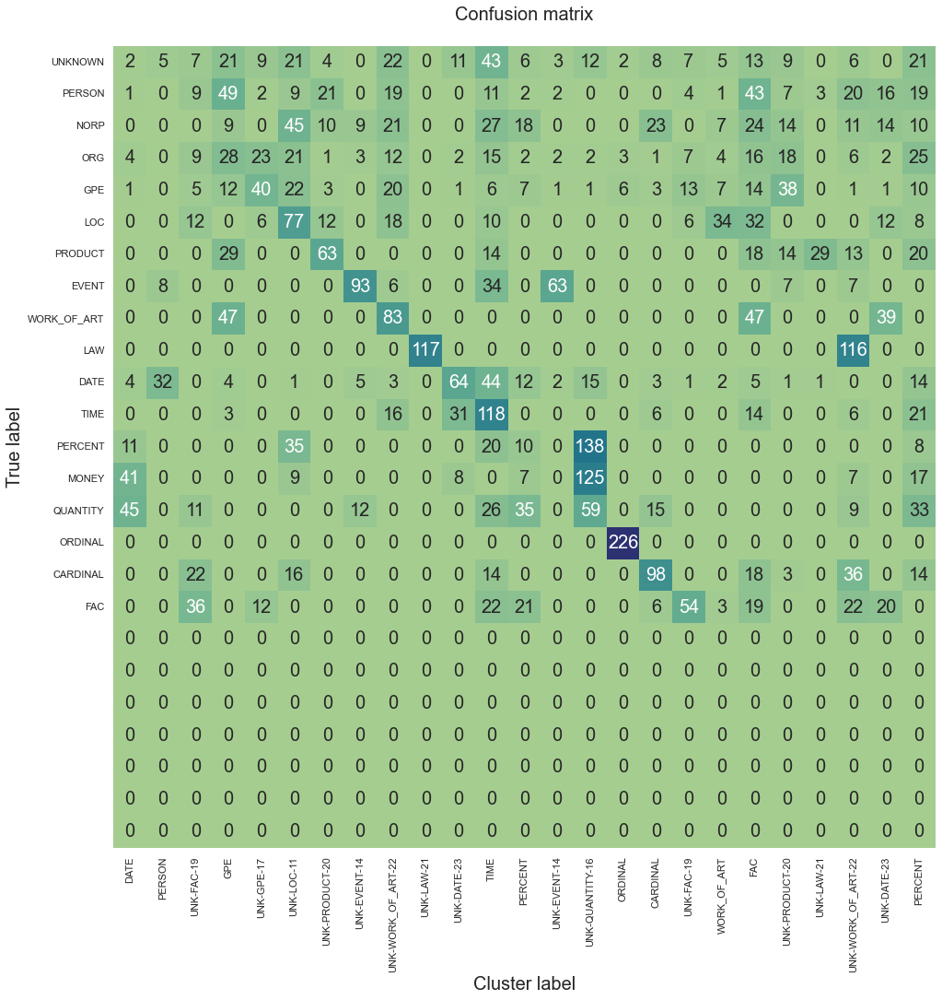

F1 score (macro) = 0.5557
Accuracy = 0.5010
Precision = 0.7837
Recall = 0.4981
New clusters =      6
... wrote results to c:\Users\Will\Projects\MSc\project\src\results\test-latent-noise-15-ae-r6-Kmeans\index.html
Finished 'evaluate_model' in 38.404 secs
--------------------------------------------------
test-latent-noise-15-ae-r6-Kmeans
--------------------------------------------------
Autoencoder
Latent Model
model compiled
Epoch 182: early stopping


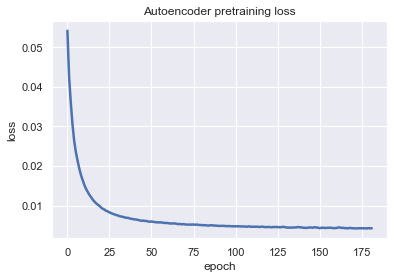

  0%|          | 0/8000 [00:00<?, ?it/s]

Stop traing for tolerance threshold reached
Iter: 499 loss=0.01449701189994812


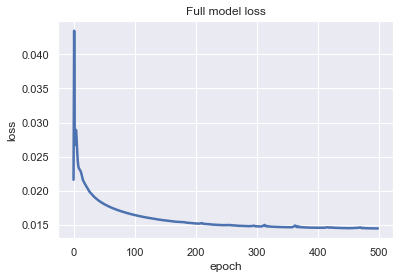

Training Done

F1 by Known Clusters: 0.2085


<Figure size 432x288 with 0 Axes>

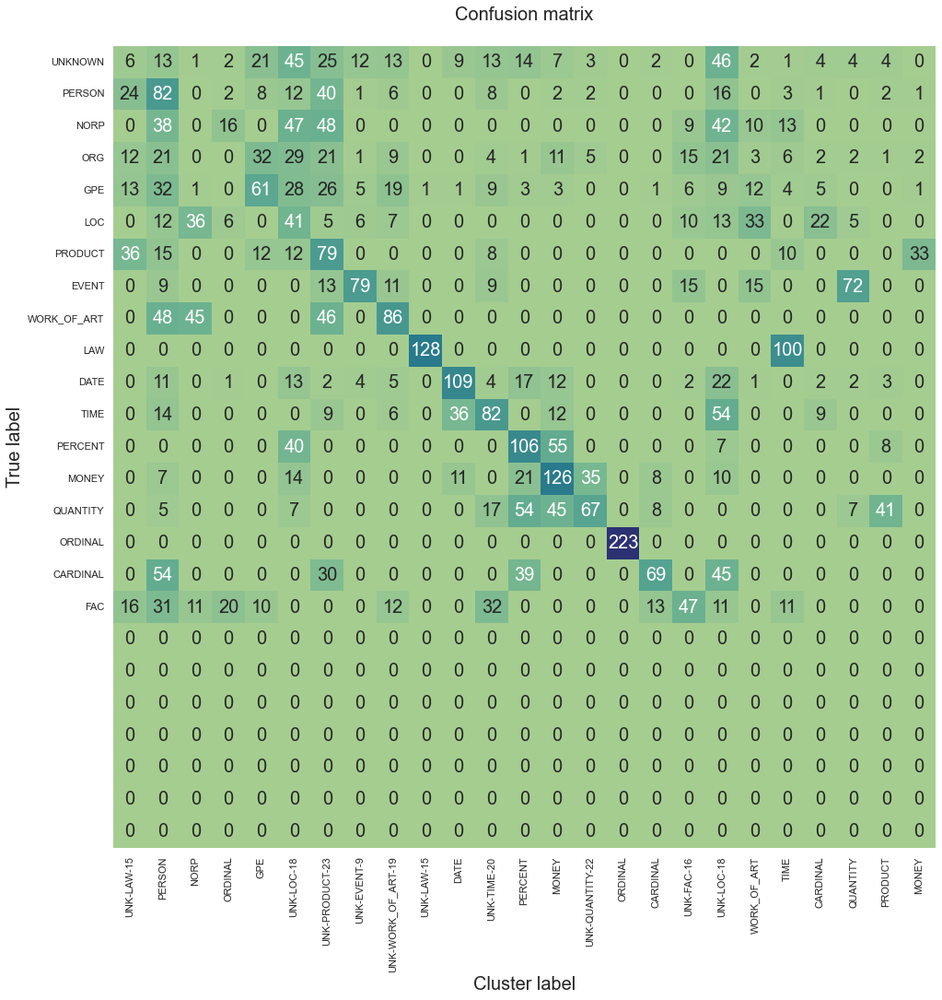

F1 score (macro) = 0.5931
Accuracy = 0.5235
Precision = 0.8953
Recall = 0.5176
New clusters =      4
... wrote results to c:\Users\Will\Projects\MSc\project\src\results\test-latent-noise-15-ae-r6-Kmeans\index.html
Finished 'evaluate_model' in 39.286 secs
--------------------------------------------------
test-latent-noise-15-ae-r6-Kmeans
--------------------------------------------------
Autoencoder
Latent Model
model compiled
Epoch 157: early stopping


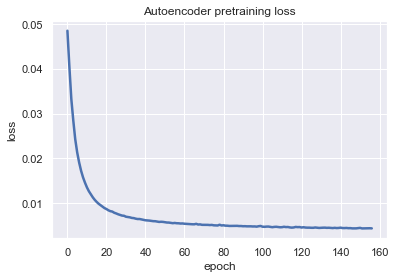

  0%|          | 0/8000 [00:00<?, ?it/s]

Stop traing for tolerance threshold reached
Iter: 533 loss=0.014493320137262344


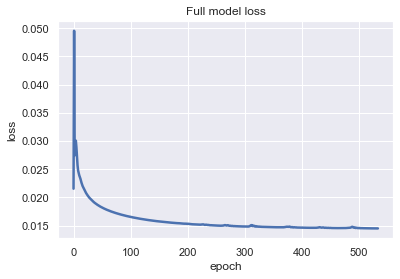

Training Done

F1 by Known Clusters: 0.3521


<Figure size 432x288 with 0 Axes>

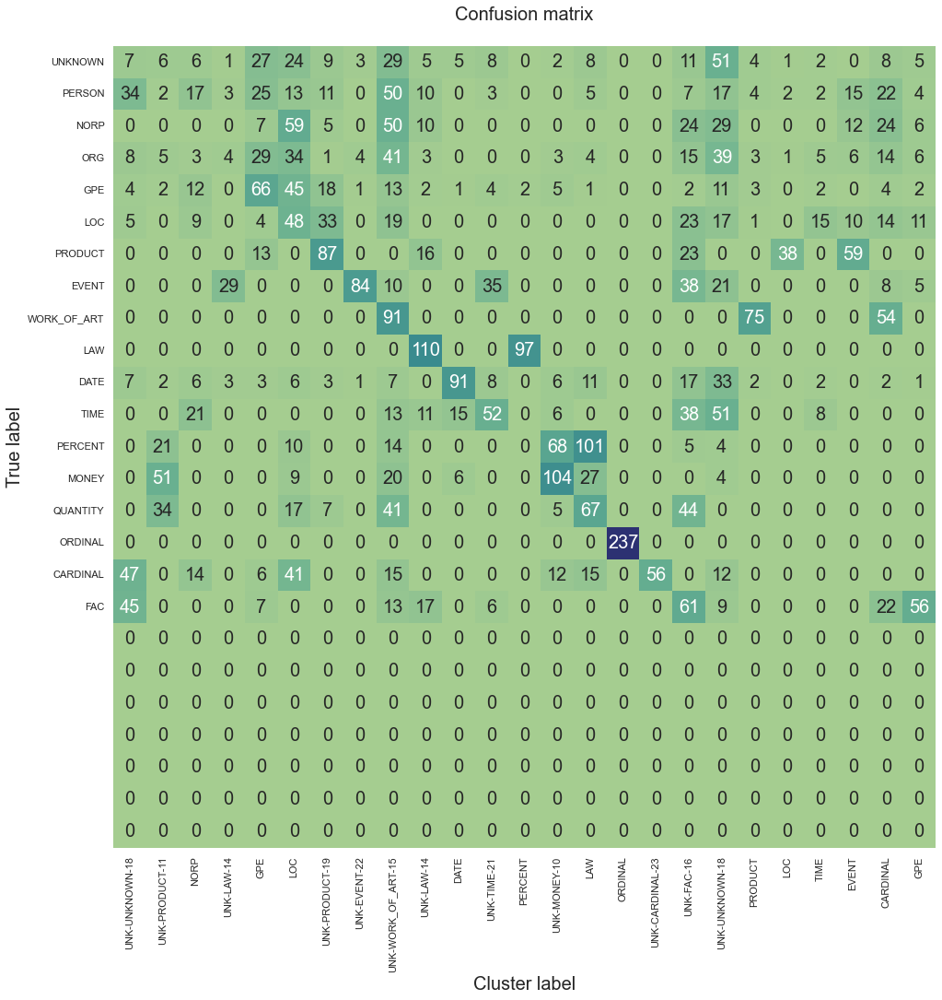

F1 score (macro) = 0.5345
Accuracy = 0.4908
Precision = 0.7832
Recall = 0.4904
New clusters =      3
... wrote results to c:\Users\Will\Projects\MSc\project\src\results\test-latent-noise-15-ae-r6-Kmeans\index.html
Finished 'evaluate_model' in 38.174 secs
--------------------------------------------------
test-latent-noise-15-ae-r8-Kmeans
--------------------------------------------------
Autoencoder
Latent Model
model compiled
Epoch 164: early stopping


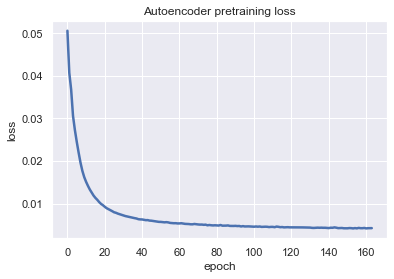

  0%|          | 0/8000 [00:00<?, ?it/s]

Stop traing for tolerance threshold reached
Iter: 444 loss=0.014573898166418076


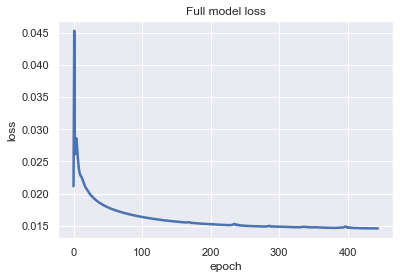

Training Done

F1 by Known Clusters: 0.2620


<Figure size 432x288 with 0 Axes>

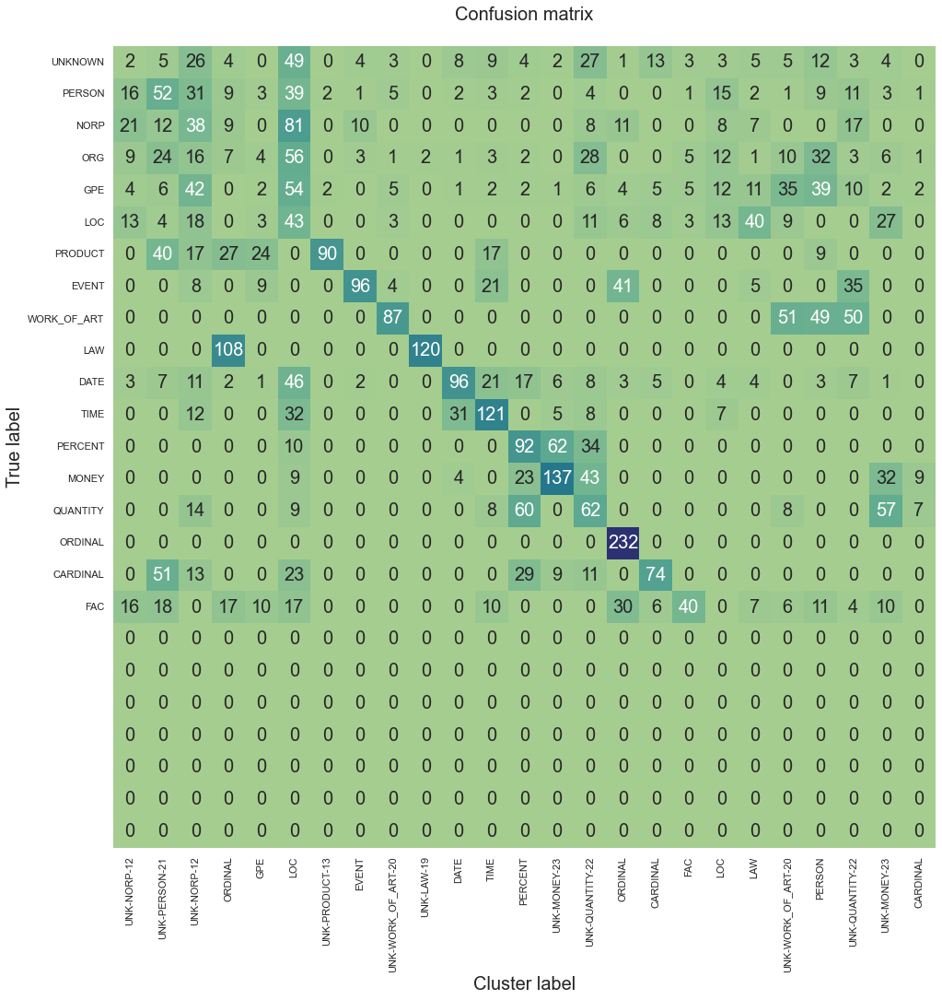

F1 score (macro) = 0.5753
Accuracy = 0.5095
Precision = 0.8938
Recall = 0.5083
New clusters =      5
... wrote results to c:\Users\Will\Projects\MSc\project\src\results\test-latent-noise-15-ae-r8-Kmeans\index.html
Finished 'evaluate_model' in 38.524 secs
--------------------------------------------------
test-latent-noise-15-ae-r8-Kmeans
--------------------------------------------------
Autoencoder
Latent Model
model compiled
Epoch 184: early stopping


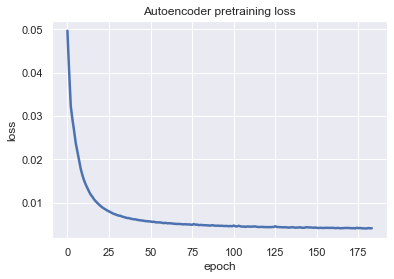

  0%|          | 0/8000 [00:00<?, ?it/s]

Stop traing for tolerance threshold reached
Iter: 634 loss=0.014442681334912777


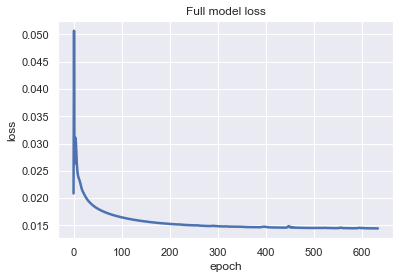

Training Done

F1 by Known Clusters: 0.2887


<Figure size 432x288 with 0 Axes>

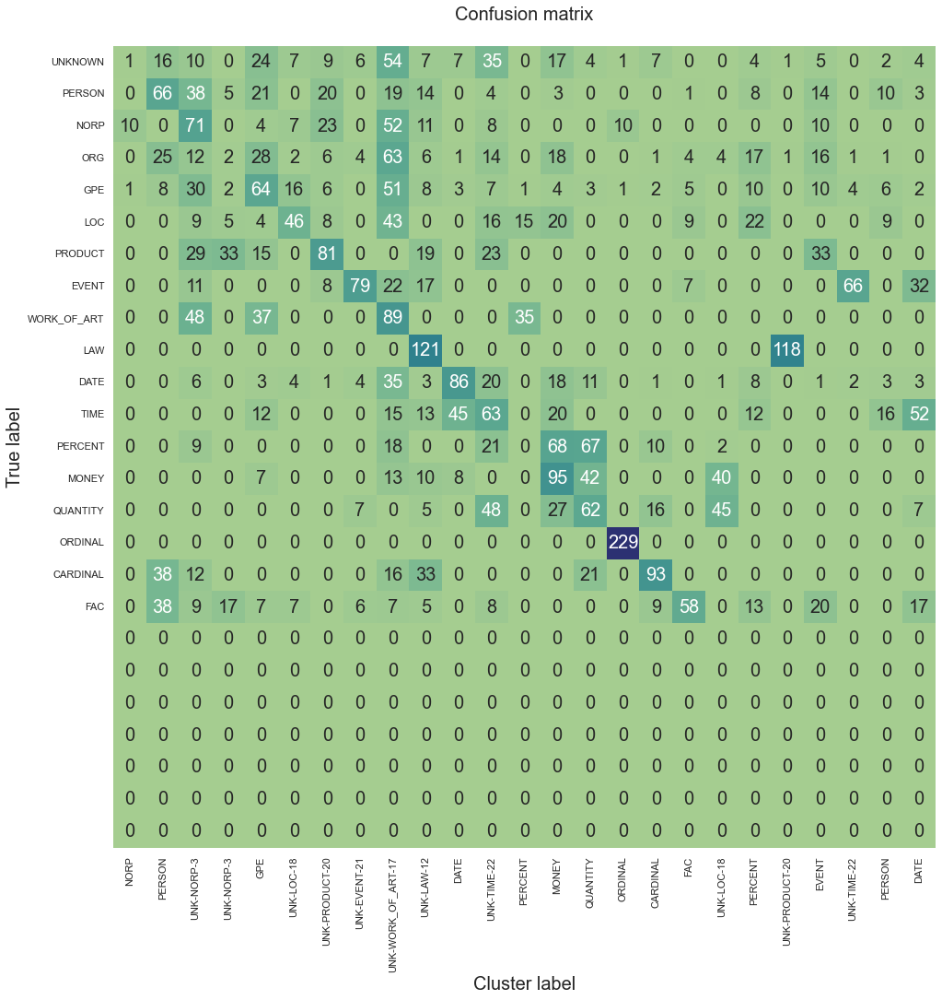

F1 score (macro) = 0.5632
Accuracy = 0.4898
Precision = 0.8943
Recall = 0.4850
New clusters =      4
... wrote results to c:\Users\Will\Projects\MSc\project\src\results\test-latent-noise-15-ae-r8-Kmeans\index.html
Finished 'evaluate_model' in 37.189 secs
--------------------------------------------------
test-latent-noise-15-ae-r8-Kmeans
--------------------------------------------------
Autoencoder
Latent Model
model compiled
Epoch 168: early stopping


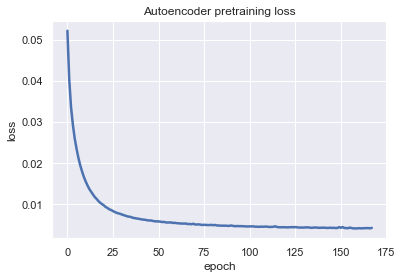

  0%|          | 0/8000 [00:00<?, ?it/s]

Stop traing for tolerance threshold reached
Iter: 446 loss=0.01453971117734909


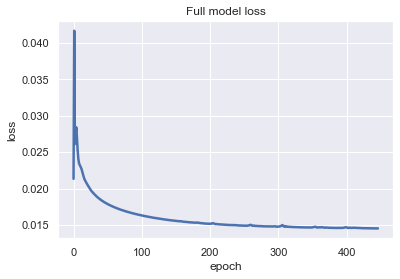

Training Done

F1 by Known Clusters: 0.2484


<Figure size 432x288 with 0 Axes>

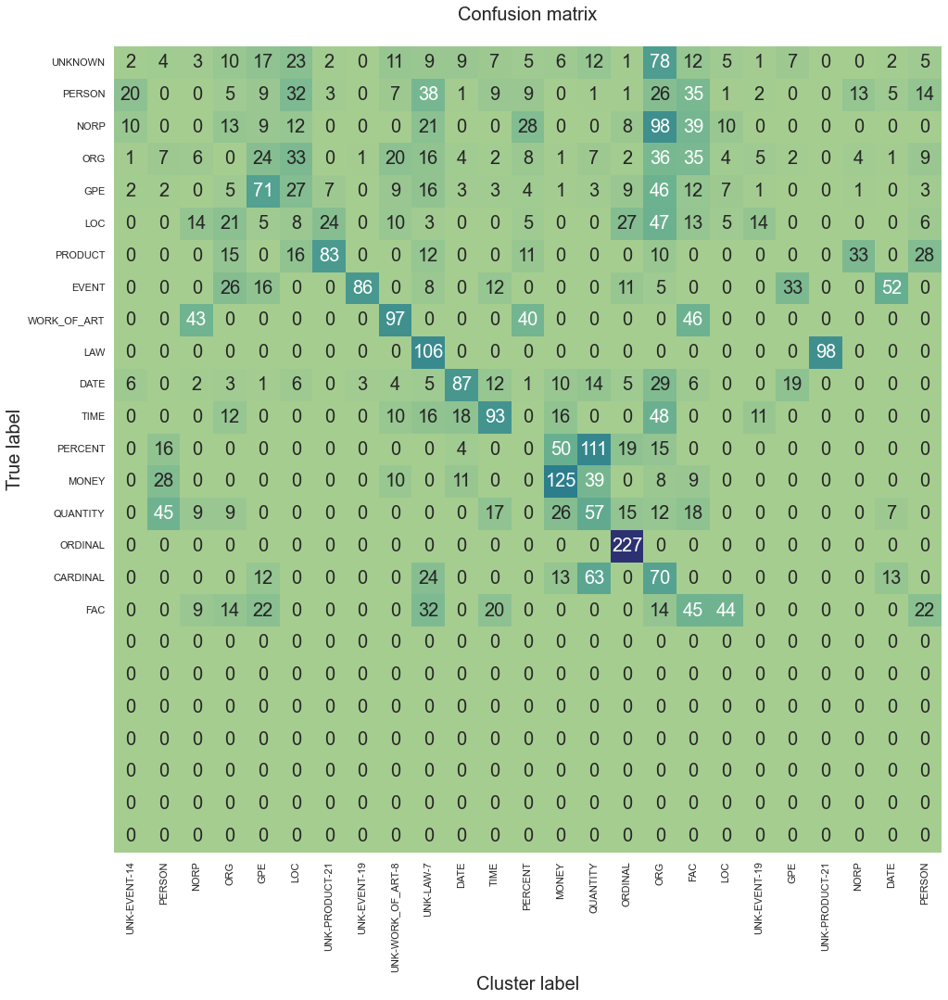

F1 score (macro) = 0.5385
Accuracy = 0.4925
Precision = 0.8946
Recall = 0.4876
New clusters =      3
... wrote results to c:\Users\Will\Projects\MSc\project\src\results\test-latent-noise-15-ae-r8-Kmeans\index.html
Finished 'evaluate_model' in 37.608 secs
--------------------------------------------------
test-latent-noise-15-ae-r10-Kmeans
--------------------------------------------------
Autoencoder
Latent Model
model compiled
Epoch 168: early stopping


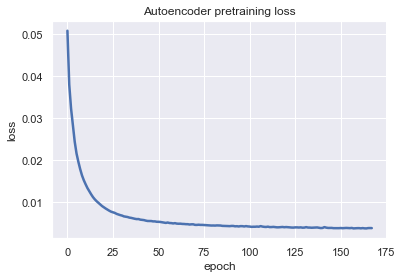

  0%|          | 0/8000 [00:00<?, ?it/s]

Stop traing for tolerance threshold reached
Iter: 627 loss=0.014405169524252415


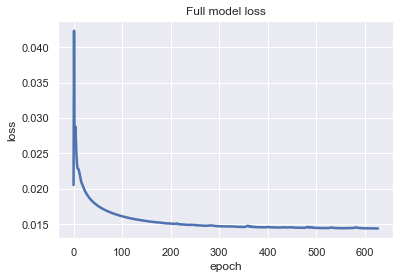

Training Done

F1 by Known Clusters: 0.2441


<Figure size 432x288 with 0 Axes>

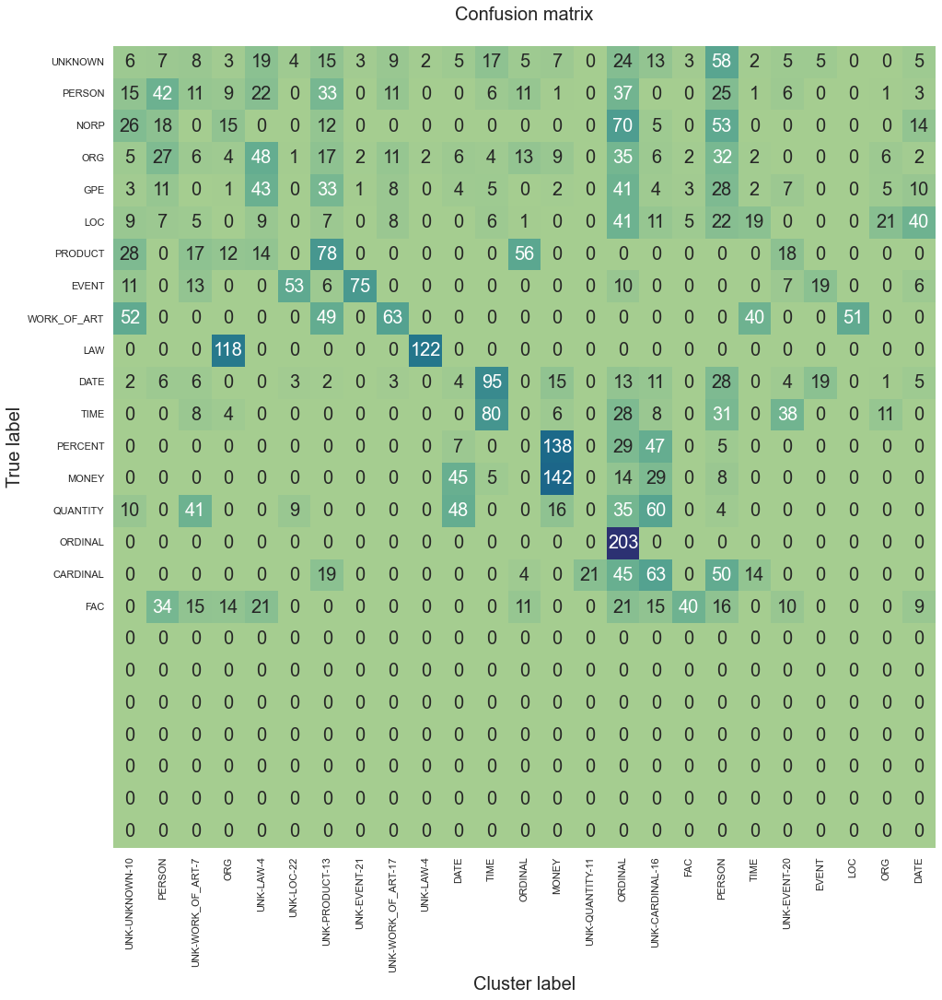

F1 score (macro) = 0.4917
Accuracy = 0.4485
Precision = 0.7829
Recall = 0.4441
New clusters =      3
... wrote results to c:\Users\Will\Projects\MSc\project\src\results\test-latent-noise-15-ae-r10-Kmeans\index.html
Finished 'evaluate_model' in 38.926 secs
--------------------------------------------------
test-latent-noise-15-ae-r10-Kmeans
--------------------------------------------------
Autoencoder
Latent Model
model compiled
Epoch 192: early stopping


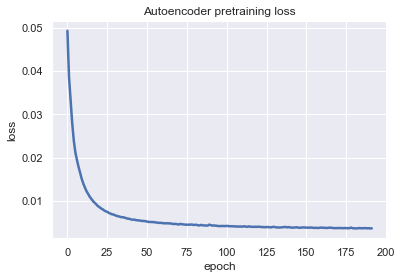

  0%|          | 0/8000 [00:00<?, ?it/s]

Stop traing for tolerance threshold reached
Iter: 560 loss=0.014434942975640297


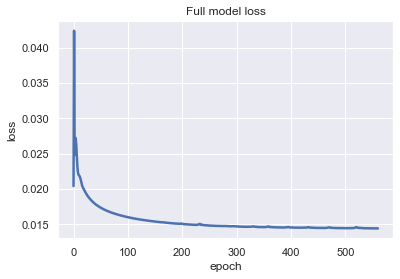

Training Done

F1 by Known Clusters: 0.2720


<Figure size 432x288 with 0 Axes>

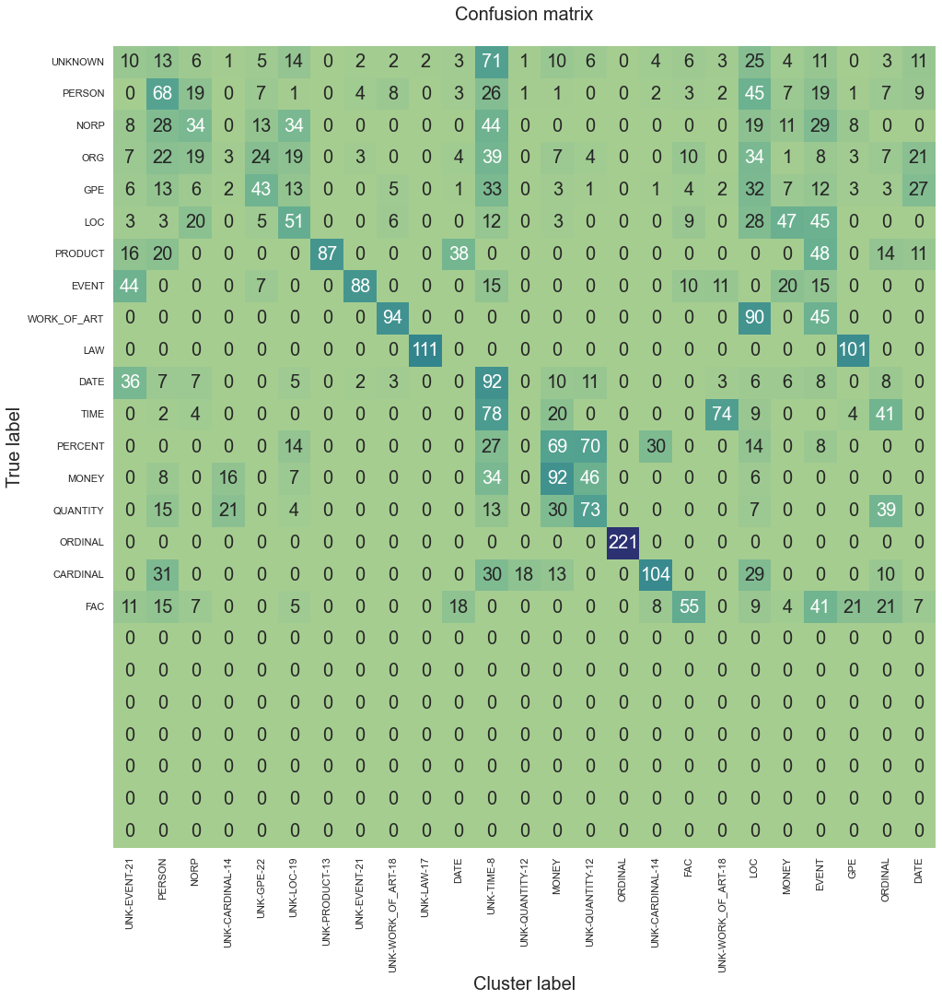

F1 score (macro) = 0.5606
Accuracy = 0.4938
Precision = 0.8386
Recall = 0.4987
New clusters =      6
... wrote results to c:\Users\Will\Projects\MSc\project\src\results\test-latent-noise-15-ae-r10-Kmeans\index.html
Finished 'evaluate_model' in 38.321 secs
--------------------------------------------------
test-latent-noise-15-ae-r10-Kmeans
--------------------------------------------------
Autoencoder
Latent Model
model compiled
Epoch 168: early stopping


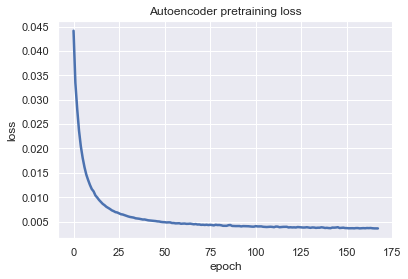

  0%|          | 0/8000 [00:00<?, ?it/s]

Stop traing for tolerance threshold reached
Iter: 445 loss=0.014467870816588402


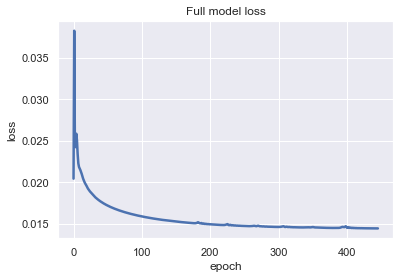

Training Done

F1 by Known Clusters: 0.2724


<Figure size 432x288 with 0 Axes>

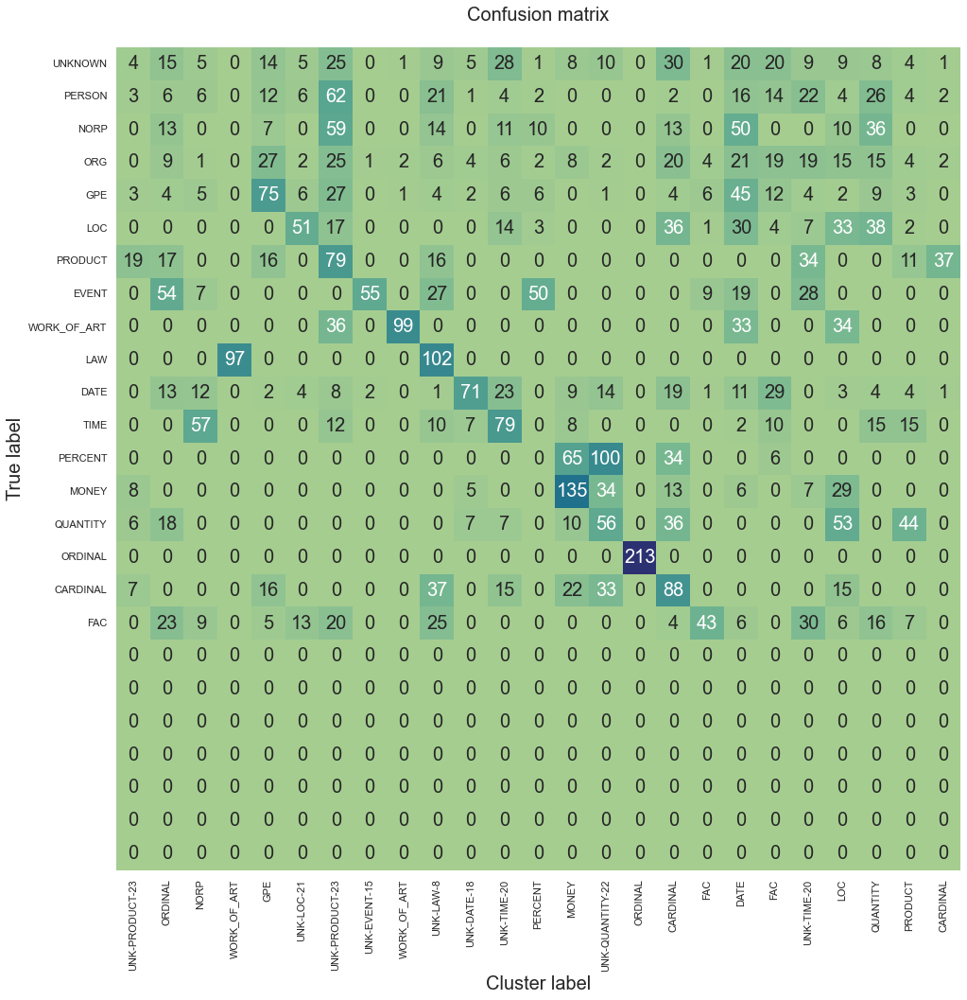

F1 score (macro) = 0.5623
Accuracy = 0.4960
Precision = 0.8391
Recall = 0.4955
New clusters =      3
... wrote results to c:\Users\Will\Projects\MSc\project\src\results\test-latent-noise-15-ae-r10-Kmeans\index.html
Finished 'evaluate_model' in 37.071 secs


In [ ]:
scores = []
num_runs = 3
for radius in [0,2,4,6, 8, 10]:
    for r in range(num_runs):
        run_name = f'test-latent-noise-15-ae-r{radius}-Kmeans'
        print('-'*50)
        print(f"{run_name}")
        print('-'*50)
        
        dc = None
        dc = DeepLatentCluster(
            run_name,
            {
                'train_size':0,
                'reconstr_weight':1.0,
                'latent_weight':1e-5,
                "cluster": "Kmeans",
                "radius": radius,
            })
        dc.make_model()
        dc.train_model(verbose=0)
        score = dc.evaluate_model(
                            run_name,
                            head="ae",
                            sample_size=4000,
                            verbose=0)
        score['run_name'] = run_name
        scores.append(score)
        


In [ ]:
summarise_scores(scores)

Run Name                                 Runs       F1 avg       F1 Cluster   F1 Global    Precision    Recall      
test-latent-noise-15-ents-r0-Kmeans      3           0.4120       0.2790       0.5450      0.8202       0.4905      
test-latent-noise-15-ents-r2-Kmeans      3           0.4202       0.2727       0.5678      0.8574       0.5032      
test-latent-noise-15-ents-r4-Kmeans      3           0.4093       0.2683       0.5503      0.8016       0.4932      
test-latent-noise-15-ents-r6-Kmeans      3           0.4033       0.2493       0.5574      0.8572       0.4953      
test-latent-noise-15-ents-r8-Kmeans      3           0.4158       0.2875       0.5440      0.8200       0.4889      
test-latent-noise-15-ents-r10-Kmeans     3           0.3529       0.1697       0.5360      0.8938       0.4713      


## Z-head different radii

In [ ]:
scores = []
num_runs = 3
for radius in [0,2,4,6, 8, 10]:
    for r in range(num_runs):
        run_name = f'test-latent-noise-15-ents-r{radius}-Kmeans'
        print('-'*50)
        print(f"{run_name}")
        print('-'*50)
        
        dc = None
        dc = DeepLatentCluster(
            run_name,
            {
                'train_size':0,
                'reconstr_weight':1.0,
                'latent_weight':1e-5,
                "cluster": "Kmeans",
                "radius": radius,
            })
        # dc.make_model()
        # dc.train_model(verbose=0)
        score = dc.evaluate_model(
                            run_name,
                            head="z",
                            sample_size=4000,
                            verbose=0)
        score['run_name'] = run_name
        scores.append(score)
        
summarise_scores(scores)

--------------------------------------------------
test-latent-noise-15-ents-r0-Kmeans
--------------------------------------------------

F1 by Known Clusters: 0.2025
F1 score (macro) = 0.5804
Accuracy = 0.5205
Precision = 0.8388
Recall = 0.5202
... wrote results to c:\Users\Will\Projects\MSc\project\src\results\test-latent-noise-15-ents-r0-Kmeans\index.html
Finished 'evaluate_model' in 43.277 secs
--------------------------------------------------
test-latent-noise-15-ents-r0-Kmeans
--------------------------------------------------

F1 by Known Clusters: 0.1858
F1 score (macro) = 0.5790
Accuracy = 0.5170
Precision = 0.8397
Recall = 0.5090
... wrote results to c:\Users\Will\Projects\MSc\project\src\results\test-latent-noise-15-ents-r0-Kmeans\index.html
Finished 'evaluate_model' in 43.542 secs
--------------------------------------------------
test-latent-noise-15-ents-r0-Kmeans
--------------------------------------------------

F1 by Known Clusters: 0.2989
F1 score (macro) = 0.5237


## Encoder head, different radii

--------------------------------------------------
test-latent-noise-15-ents-r0-Kmeans-enc
--------------------------------------------------
Autoencoder
Latent Model
model compiled
Epoch 136: early stopping


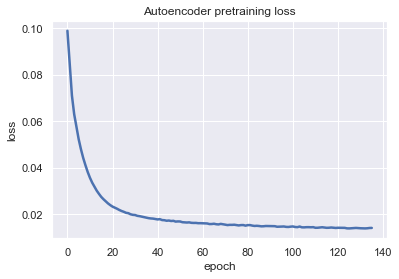

Stop traing for tolerance threshold reached
Iter: 813 loss=0.01431251224130392


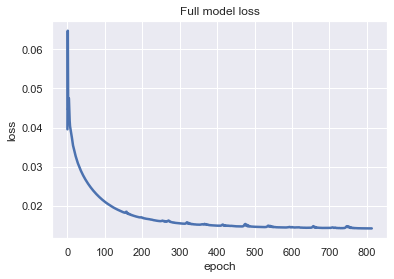

Training Done

F1 by Known Clusters: 0.3115
F1 score (macro) = 0.5629
Accuracy = 0.5210
Precision = 0.8394
Recall = 0.5165
... wrote results to c:\Users\Will\Projects\MSc\project\src\results\test-latent-noise-15-ents-r0-Kmeans-enc\index.html
Finished 'evaluate_model' in 32.208 secs
--------------------------------------------------
test-latent-noise-15-ents-r0-Kmeans-enc
--------------------------------------------------
Autoencoder
Latent Model
model compiled
Epoch 129: early stopping


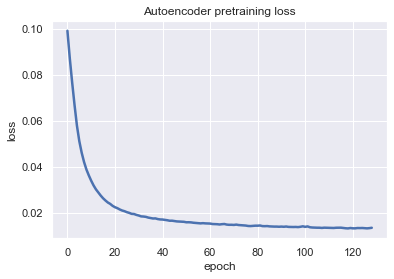

Stop traing for tolerance threshold reached
Iter: 640 loss=0.014387080445885658


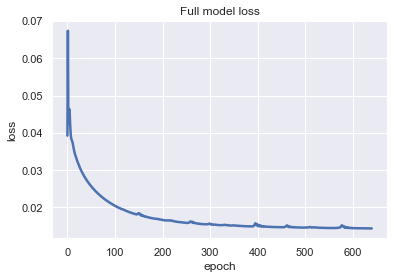

Training Done

F1 by Known Clusters: 0.3228
F1 score (macro) = 0.5475
Accuracy = 0.4950
Precision = 0.7837
Recall = 0.4950
... wrote results to c:\Users\Will\Projects\MSc\project\src\results\test-latent-noise-15-ents-r0-Kmeans-enc\index.html
Finished 'evaluate_model' in 32.545 secs
--------------------------------------------------
test-latent-noise-15-ents-r0-Kmeans-enc
--------------------------------------------------
Autoencoder
Latent Model
model compiled
Epoch 217: early stopping


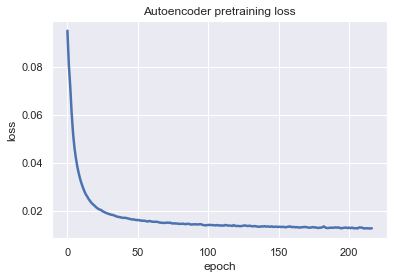

Stop traing for tolerance threshold reached
Iter: 705 loss=0.014457748271524906


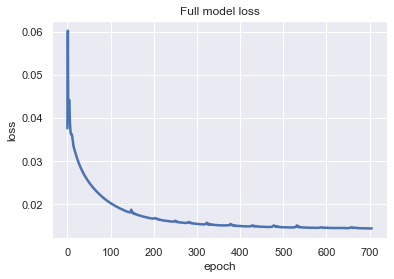

Training Done

F1 by Known Clusters: 0.2386
F1 score (macro) = 0.5650
Accuracy = 0.4995
Precision = 0.8383
Recall = 0.5029
... wrote results to c:\Users\Will\Projects\MSc\project\src\results\test-latent-noise-15-ents-r0-Kmeans-enc\index.html
Finished 'evaluate_model' in 31.594 secs
--------------------------------------------------
test-latent-noise-15-ents-r2-Kmeans-enc
--------------------------------------------------
Autoencoder
Latent Model
model compiled
Epoch 183: early stopping


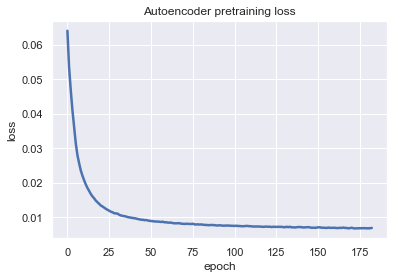

Stop traing for tolerance threshold reached
Iter: 572 loss=0.01454545371234417


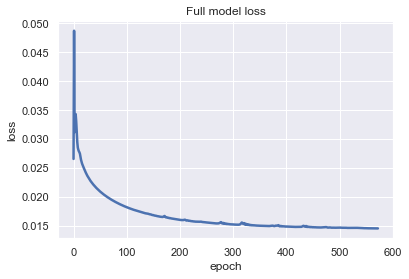

Training Done

F1 by Known Clusters: 0.1594
F1 score (macro) = 0.5978
Accuracy = 0.5262
Precision = 0.8946
Recall = 0.5279
... wrote results to c:\Users\Will\Projects\MSc\project\src\results\test-latent-noise-15-ents-r2-Kmeans-enc\index.html
Finished 'evaluate_model' in 32.48 secs
--------------------------------------------------
test-latent-noise-15-ents-r2-Kmeans-enc
--------------------------------------------------
Autoencoder
Latent Model
model compiled
Epoch 185: early stopping


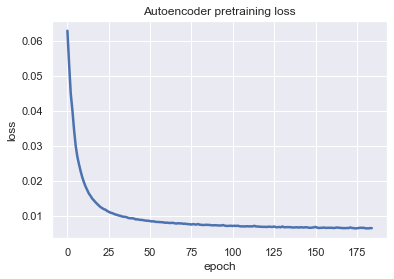

Stop traing for tolerance threshold reached
Iter: 758 loss=0.014459566213190556


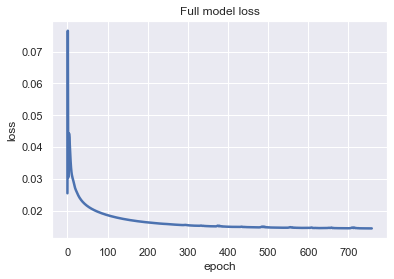

Training Done

F1 by Known Clusters: 0.2318
F1 score (macro) = 0.5456
Accuracy = 0.4803
Precision = 0.8939
Recall = 0.4810
... wrote results to c:\Users\Will\Projects\MSc\project\src\results\test-latent-noise-15-ents-r2-Kmeans-enc\index.html
Finished 'evaluate_model' in 31.687 secs
--------------------------------------------------
test-latent-noise-15-ents-r2-Kmeans-enc
--------------------------------------------------
Autoencoder
Latent Model
model compiled
Epoch 179: early stopping


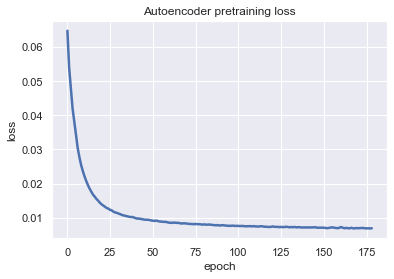

Stop traing for tolerance threshold reached
Iter: 733 loss=0.014412308111786842


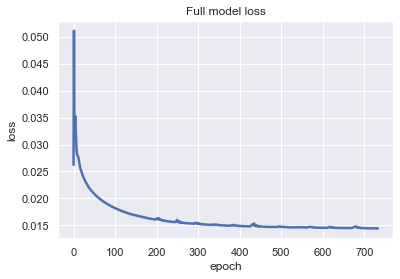

Training Done

F1 by Known Clusters: 0.2791
F1 score (macro) = 0.5587
Accuracy = 0.5182
Precision = 0.8389
Recall = 0.5065
... wrote results to c:\Users\Will\Projects\MSc\project\src\results\test-latent-noise-15-ents-r2-Kmeans-enc\index.html
Finished 'evaluate_model' in 33.976 secs
--------------------------------------------------
test-latent-noise-15-ents-r4-Kmeans-enc
--------------------------------------------------
Autoencoder
Latent Model
model compiled
Epoch 124: early stopping


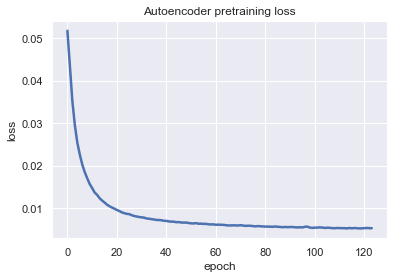

Stop traing for tolerance threshold reached
Iter: 601 loss=0.014418985694646835


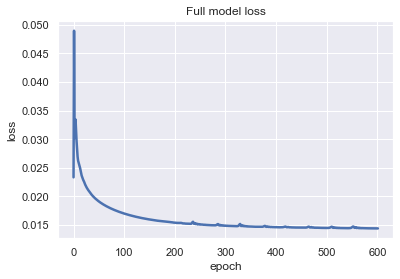

Training Done

F1 by Known Clusters: 0.3221
F1 score (macro) = 0.5334
Accuracy = 0.4828
Precision = 0.8392
Recall = 0.4875
... wrote results to c:\Users\Will\Projects\MSc\project\src\results\test-latent-noise-15-ents-r4-Kmeans-enc\index.html
Finished 'evaluate_model' in 34.067 secs
--------------------------------------------------
test-latent-noise-15-ents-r4-Kmeans-enc
--------------------------------------------------
Autoencoder
Latent Model
model compiled
Epoch 174: early stopping


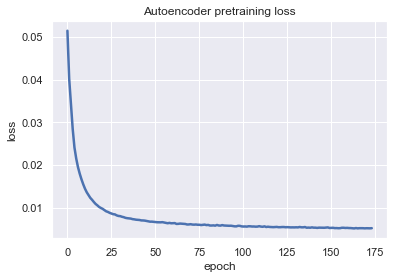

Stop traing for tolerance threshold reached
Iter: 458 loss=0.014602924697101116


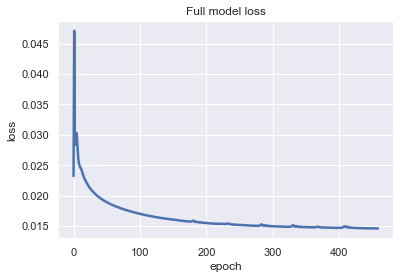

Training Done

F1 by Known Clusters: 0.2257
F1 score (macro) = 0.5270
Accuracy = 0.4770
Precision = 0.7835
Recall = 0.4728
... wrote results to c:\Users\Will\Projects\MSc\project\src\results\test-latent-noise-15-ents-r4-Kmeans-enc\index.html
Finished 'evaluate_model' in 32.666 secs
--------------------------------------------------
test-latent-noise-15-ents-r4-Kmeans-enc
--------------------------------------------------
Autoencoder
Latent Model
model compiled
Epoch 190: early stopping


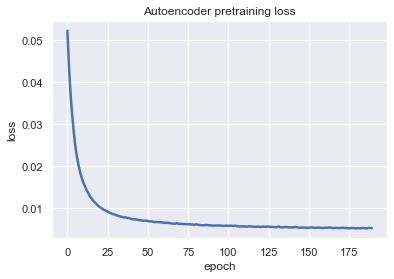

Stop traing for tolerance threshold reached
Iter: 529 loss=0.014530031941831112


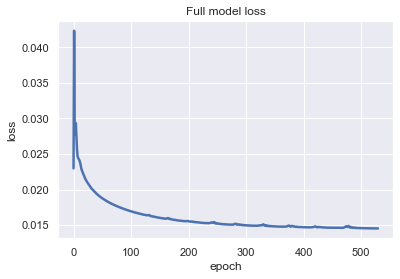

Training Done

F1 by Known Clusters: 0.3574
F1 score (macro) = 0.5095
Accuracy = 0.4755
Precision = 0.7273
Recall = 0.4746
... wrote results to c:\Users\Will\Projects\MSc\project\src\results\test-latent-noise-15-ents-r4-Kmeans-enc\index.html
Finished 'evaluate_model' in 30.565 secs
--------------------------------------------------
test-latent-noise-15-ents-r6-Kmeans-enc
--------------------------------------------------
Autoencoder
Latent Model
model compiled
Epoch 160: early stopping


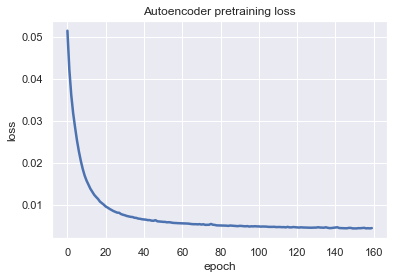

Stop traing for tolerance threshold reached
Iter: 430 loss=0.014571678824722767


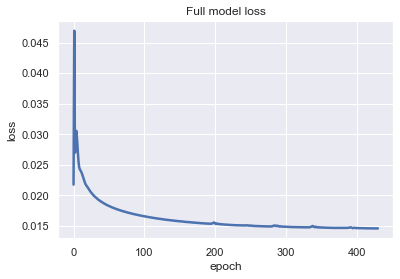

Training Done

F1 by Known Clusters: 0.3215
F1 score (macro) = 0.5497
Accuracy = 0.4930
Precision = 0.8390
Recall = 0.4974
... wrote results to c:\Users\Will\Projects\MSc\project\src\results\test-latent-noise-15-ents-r6-Kmeans-enc\index.html
Finished 'evaluate_model' in 32.431 secs
--------------------------------------------------
test-latent-noise-15-ents-r6-Kmeans-enc
--------------------------------------------------
Autoencoder
Latent Model
model compiled
Epoch 191: early stopping


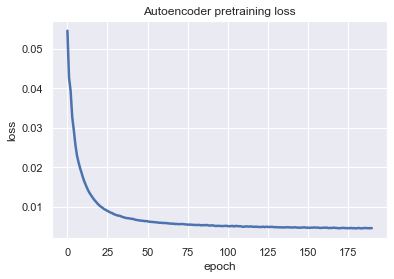

Stop traing for tolerance threshold reached
Iter: 654 loss=0.014452547766268253


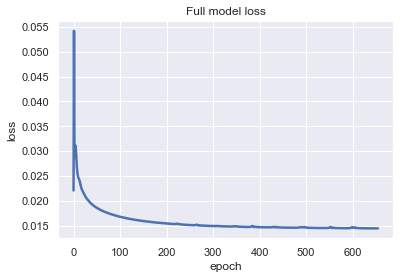

Training Done

F1 by Known Clusters: 0.3373
F1 score (macro) = 0.5553
Accuracy = 0.4953
Precision = 0.8383
Recall = 0.4986
... wrote results to c:\Users\Will\Projects\MSc\project\src\results\test-latent-noise-15-ents-r6-Kmeans-enc\index.html
Finished 'evaluate_model' in 31.435 secs
--------------------------------------------------
test-latent-noise-15-ents-r6-Kmeans-enc
--------------------------------------------------
Autoencoder
Latent Model
model compiled
Epoch 180: early stopping


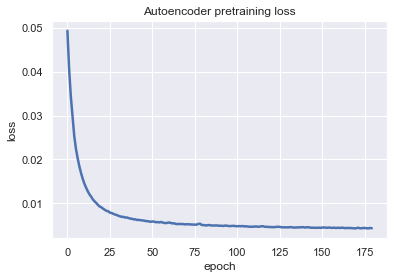

Stop traing for tolerance threshold reached
Iter: 584 loss=0.014449376612901688


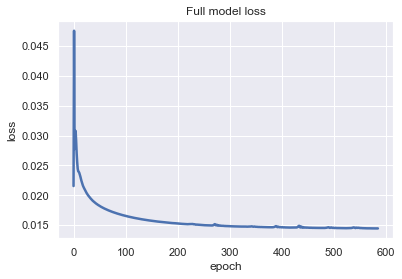

Training Done

F1 by Known Clusters: 0.2205
F1 score (macro) = 0.5524
Accuracy = 0.5025
Precision = 0.8387
Recall = 0.4989
... wrote results to c:\Users\Will\Projects\MSc\project\src\results\test-latent-noise-15-ents-r6-Kmeans-enc\index.html
Finished 'evaluate_model' in 31.479 secs
--------------------------------------------------
test-latent-noise-15-ents-r8-Kmeans-enc
--------------------------------------------------
Autoencoder
Latent Model
model compiled
Epoch 135: early stopping


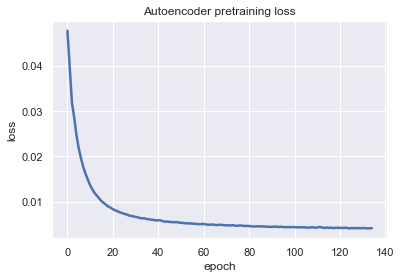

Stop traing for tolerance threshold reached
Iter: 550 loss=0.014415341429412365


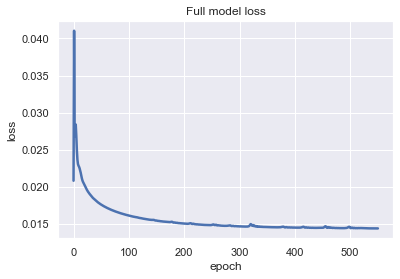

Training Done

F1 by Known Clusters: 0.2590
F1 score (macro) = 0.5640
Accuracy = 0.5245
Precision = 0.7833
Recall = 0.5218
... wrote results to c:\Users\Will\Projects\MSc\project\src\results\test-latent-noise-15-ents-r8-Kmeans-enc\index.html
Finished 'evaluate_model' in 32.349 secs
--------------------------------------------------
test-latent-noise-15-ents-r8-Kmeans-enc
--------------------------------------------------
Autoencoder
Latent Model
model compiled
Epoch 168: early stopping


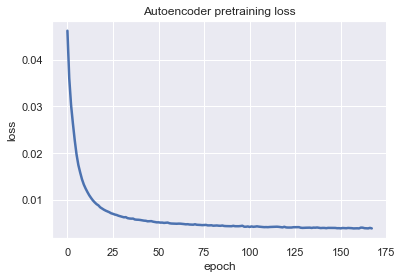

Stop traing for tolerance threshold reached
Iter: 477 loss=0.01448475569486618


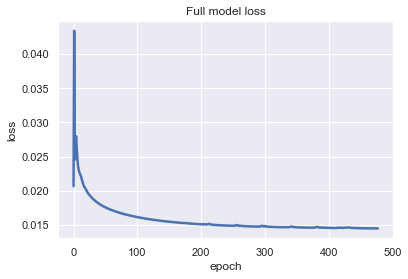

Training Done

F1 by Known Clusters: 0.3219
F1 score (macro) = 0.5610
Accuracy = 0.5198
Precision = 0.7839
Recall = 0.5166
... wrote results to c:\Users\Will\Projects\MSc\project\src\results\test-latent-noise-15-ents-r8-Kmeans-enc\index.html
Finished 'evaluate_model' in 32.397 secs
--------------------------------------------------
test-latent-noise-15-ents-r8-Kmeans-enc
--------------------------------------------------
Autoencoder
Latent Model
model compiled
Epoch 145: early stopping


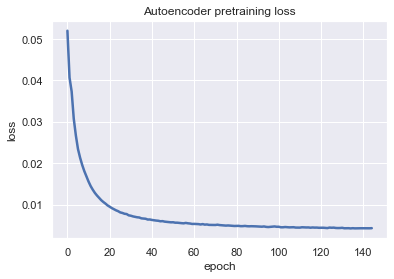

Stop traing for tolerance threshold reached
Iter: 690 loss=0.01440335437655449


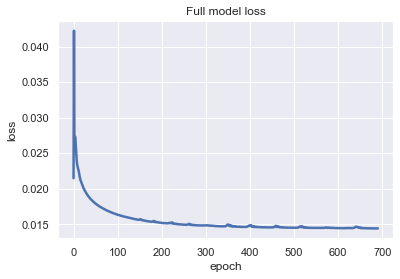

Training Done

F1 by Known Clusters: 0.2664
F1 score (macro) = 0.5574
Accuracy = 0.5092
Precision = 0.7832
Recall = 0.5093
... wrote results to c:\Users\Will\Projects\MSc\project\src\results\test-latent-noise-15-ents-r8-Kmeans-enc\index.html
Finished 'evaluate_model' in 33.212 secs
--------------------------------------------------
test-latent-noise-15-ents-r10-Kmeans-enc
--------------------------------------------------
Autoencoder
Latent Model
model compiled
Epoch 183: early stopping


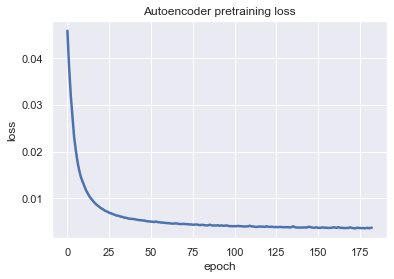

Stop traing for tolerance threshold reached
Iter: 508 loss=0.014423065818846226


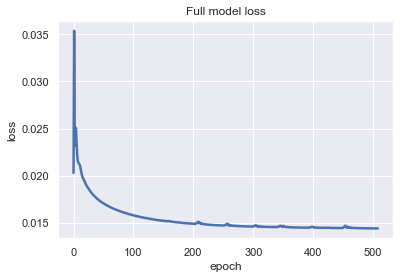

Training Done

F1 by Known Clusters: 0.1508
F1 score (macro) = 0.5453
Accuracy = 0.4738
Precision = 0.9500
Recall = 0.4766
... wrote results to c:\Users\Will\Projects\MSc\project\src\results\test-latent-noise-15-ents-r10-Kmeans-enc\index.html
Finished 'evaluate_model' in 31.934 secs
--------------------------------------------------
test-latent-noise-15-ents-r10-Kmeans-enc
--------------------------------------------------
Autoencoder
Latent Model
model compiled
Epoch 159: early stopping


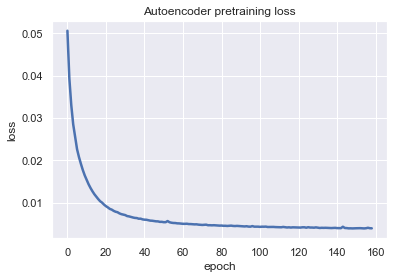

Stop traing for tolerance threshold reached
Iter: 467 loss=0.014565994963049889


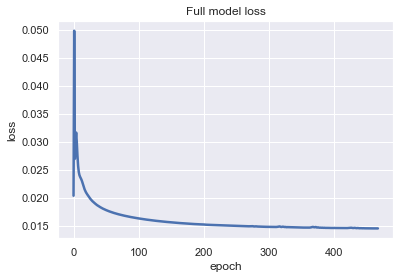

Training Done

F1 by Known Clusters: 0.2848
F1 score (macro) = 0.5430
Accuracy = 0.4825
Precision = 0.8390
Recall = 0.4870
... wrote results to c:\Users\Will\Projects\MSc\project\src\results\test-latent-noise-15-ents-r10-Kmeans-enc\index.html
Finished 'evaluate_model' in 32.713 secs
--------------------------------------------------
test-latent-noise-15-ents-r10-Kmeans-enc
--------------------------------------------------
Autoencoder
Latent Model
model compiled
Epoch 167: early stopping


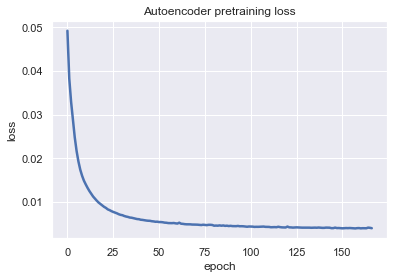

Stop traing for tolerance threshold reached
Iter: 496 loss=0.014528323896229267


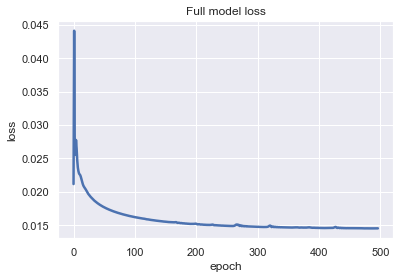

Training Done

F1 by Known Clusters: 0.2572
F1 score (macro) = 0.5401
Accuracy = 0.4843
Precision = 0.8390
Recall = 0.4811
... wrote results to c:\Users\Will\Projects\MSc\project\src\results\test-latent-noise-15-ents-r10-Kmeans-enc\index.html
Finished 'evaluate_model' in 32.407 secs


In [ ]:
scores = []
num_runs = 3
for radius in [0, 2, 4, 6, 8, 10]:
    for r in range(num_runs):
        run_name = f'test-latent-noise-15-ents-r{radius}-Kmeans-enc'
        print('-'*50)
        print(f"{run_name}")
        print('-'*50)
        
        dc = None
        dc = DeepLatentCluster(
            run_name,
            {
                'train_size':0,
                'reconstr_weight':1.0,
                'latent_weight':1e-5,
                "cluster": "Kmeans",
                "radius": radius,
            })
        dc.make_model()
        dc.train_model(verbose=0)
        score = dc.evaluate_model(
                            run_name,
                            head="enc",
                            sample_size=4000,
                            verbose=0)
        score['run_name'] = run_name
        scores.append(score)


In [ ]:
summarise_scores(scores)

Run Name                                 Runs       F1 avg       F1 Cluster   F1 Global    Precision    Recall      
test-latent-noise-15-ents-r0-Kmeans-enc  3           0.4247       0.2910       0.5585      0.8205       0.5048      
test-latent-noise-15-ents-r2-Kmeans-enc  3           0.3954       0.2234       0.5674      0.8758       0.5051      
test-latent-noise-15-ents-r4-Kmeans-enc  3           0.4125       0.3017       0.5233      0.7834       0.4783      
test-latent-noise-15-ents-r6-Kmeans-enc  3           0.4228       0.2931       0.5525      0.8387       0.4983      
test-latent-noise-15-ents-r8-Kmeans-enc  3           0.4216       0.2824       0.5608      0.7835       0.5159      
test-latent-noise-15-ents-r10-Kmeans-enc 3           0.3869       0.2309       0.5428      0.8760       0.4815      


## Data Balance

In [ ]:
dc = None
dc = DeepLatentCluster(
    'test-latent-all',
    {
        'train_size':0,
        'entity_count': 15,
    })
dc.make_data(oversample=True)

Load Data
Loading ./data/conll_spacy_n0_r0.pkl
LOADED {1: 'UNKNOWN', 4: 'ORG', 2: 'PERSON', 12: 'DATE', 5: 'GPE', 6: 'LOC', 16: 'QUANTITY', 14: 'PERCENT', 8: 'EVENT', 15: 'MONEY', 3: 'NORP', 17: 'ORDINAL', 19: 'FAC', 13: 'TIME', 18: 'CARDINAL', 7: 'PRODUCT', 10: 'LANGUAGE', 9: 'WORK_OF_ART', 11: 'LAW'}
Loaded file: 9418 samples
Data balance:
[[   2 2080]
 [   3  142]
 [   4 1950]
 [   5 2664]
 [   6  114]
 [   7   36]
 [   8   55]
 [   9   17]
 [  12 1659]
 [  13  143]
 [  14  151]
 [  15  111]
 [  16  139]
 [  18   62]
 [  19   95]]
Balancing data
Resampled balance:
[[   2 2664]
 [   3 2664]
 [   4 2664]
 [   5 2664]
 [   6 2664]
 [   7 2664]
 [   8 2664]
 [   9 2664]
 [  12 2664]
 [  13 2664]
 [  14 2664]
 [  15 2664]
 [  16 2664]
 [  18 2664]
 [  19 2664]]
Post Oversampling
x: (39960, 768), y: (39960,)
{0: 'PERSON', 1: 'NORP', 2: 'ORG', 3: 'GPE', 4: 'LOC', 5: 'PRODUCT', 6: 'EVENT', 7: 'WORK_OF_ART', 8: 'DATE', 9: 'TIME', 10: 'PERCENT', 11: 'MONEY', 12: 'QUANTITY', 13: 'CARDINAL', 14

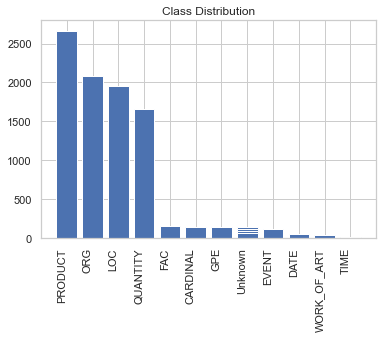

In [ ]:
from collections import defaultdict

cats = defaultdict(lambda: "Unknown",
{0: 'PERSON', 1: 'NORP', 2: 'ORG', 3: 'GPE', 4: 'LOC', 5: 'PRODUCT', 6: 'EVENT', 7: 'WORK_OF_ART',
        8: 'DATE', 9: 'TIME', 10: 'PERCENT', 11: 'MONEY', 12: 'QUANTITY', 13: 'CARDINAL', 14: 'FAC'})
pre = [[2, 2080],
       [3,  142],
       [4, 1950],
       [5, 2664],
       [6,  114],
       [7,   36],
       [8,   55],
       [9,   17],
       [12, 1659],
       [13,  143],
       [14,  151],
       [15,  111],
       [16,  139],
       [18,   62],
       [19,   95]]
sort_pre = sorted(pre, key=lambda x: -x[1])
# plot catplot
plt.xticks(rotation=90, ha='right')
plt.title("Class Distribution")
plt.bar([cats[x[0]] for x in sort_pre], [x[1] for x in sort_pre])
plt.show()


## Loss Weights

In [ ]:
scores = []
num_runs = 1
for i, l_weight in enumerate([1e-7, 1e-6, 1e-5, 1e-4, 1e-3, 1e-2, 1e-1, 1]):
    for j, r_weight in enumerate([0,0.25,0.5,0.75, 1.0]):
        for r in range(num_runs):
            run_name = f'test-latent-15-ents-lw{l_weight}-rw{r_weight}-Kmeans'
            print('-'*50)
            print(f"{(i)*8 + j}: {run_name}")
            print('-'*50)
            
            print({
                    'train_size':0,
                    'reconstr_weight':r_weight,
                    'latent_weight':l_weight,
                    "cluster": "Kmeans",
                    "radius": 6,
                })
            dc = None
            dc = DeepLatentCluster(
                run_name,
                {
                    'train_size':0,
                    'reconstr_weight':r_weight,
                    'latent_weight':l_weight,
                    "cluster": "Kmeans",
                    "radius": 6,
                })
            dc.make_model()
            dc.train_model(verbose=0)
            score = dc.evaluate_model(
                                run_name,
                                head="ae",
                                sample_size=2000,
                                verbose=0)
            score['run_name'] = run_name
            scores.append(score)
            
    summarise_scores(scores)

In [ ]:
#%history -g -f jm_trg.py

In [ ]:
from grid_search import grid_search

scores = []
num_runs = 1
config = {
    'train_size': [0],
    "radius": [6],
    'latent_weight': [0.4, 0.5, 1.0],
    'reconstr_weight': [0.8, 0.9, 1.0],
    'head': ['z'],
}


--------------------------------------------------
0/9: test-latent-15-ents-lw0.4-rw0.8-z-Kmeans
--------------------------------------------------
{'train_size': 0, 'radius': 6, 'latent_weight': 0.4, 'reconstr_weight': 0.8, 'head': 'z'}
ERROR: Invalid config key <module 'tensorflow.keras' from 'c:\\Users\\Will\\Anaconda3\\envs\\tf-27\\lib\\site-packages\\keras\\api\\_v2\\keras\\__init__.py'>

F1 by Known Clusters: 0.2850


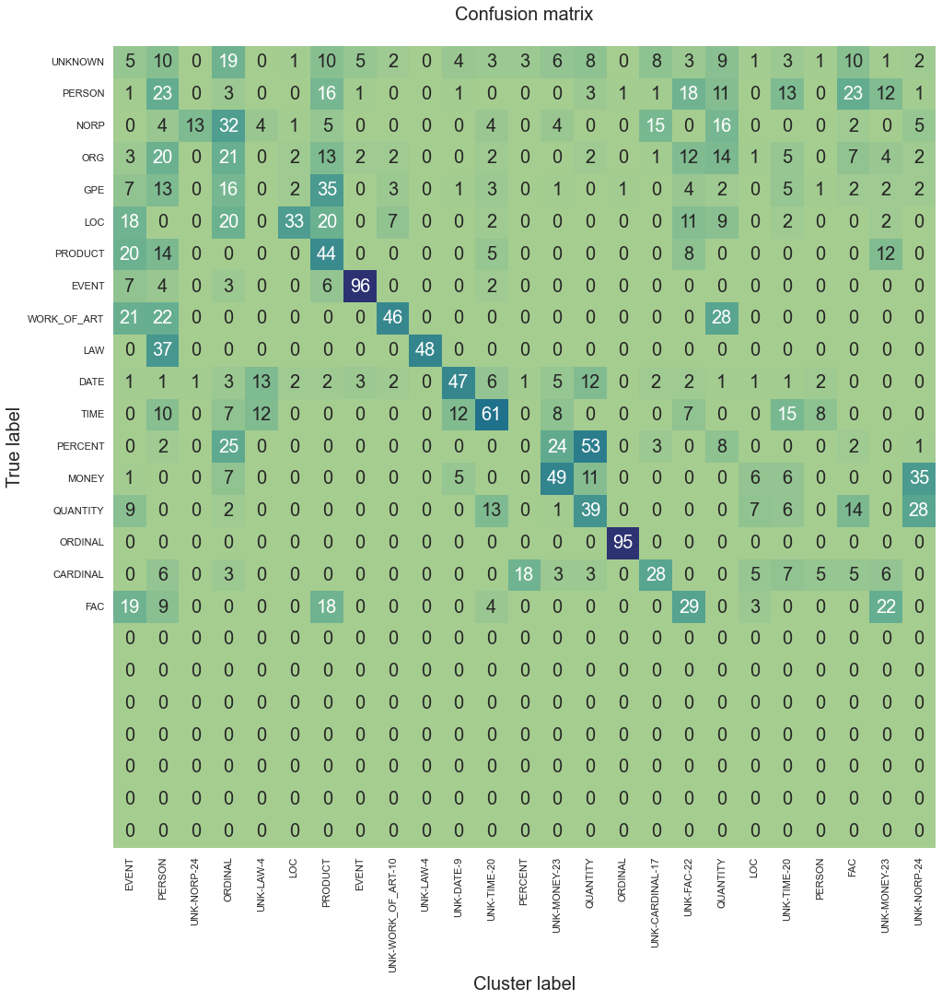

F1 score (macro) = 0.5702
Accuracy = 0.5075
Precision = 0.8391
Recall = 0.5165
New clusters =      4
... wrote results to c:\Users\Will\Projects\MSc\project\src\results\test-latent-15-ents-lw0.4-rw0.8-z-Kmeans\index.html
Finished 'evaluate_model' in 28.302 secs
--------------------------------------------------
1/9: test-latent-15-ents-lw0.4-rw0.9-z-Kmeans
--------------------------------------------------
{'train_size': 0, 'radius': 6, 'latent_weight': 0.4, 'reconstr_weight': 0.9, 'head': 'z'}
ERROR: Invalid config key <module 'tensorflow.keras' from 'c:\\Users\\Will\\Anaconda3\\envs\\tf-27\\lib\\site-packages\\keras\\api\\_v2\\keras\\__init__.py'>

F1 by Known Clusters: 0.2390


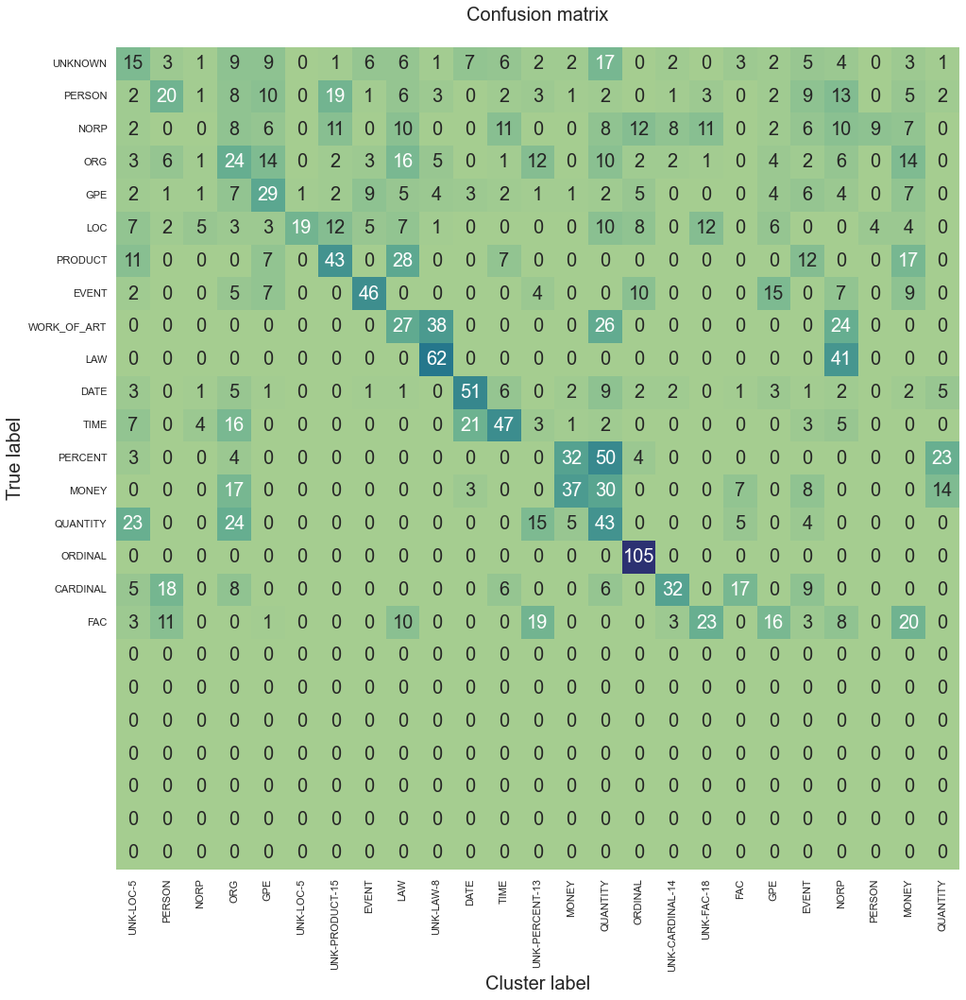

F1 score (macro) = 0.5262
Accuracy = 0.4530
Precision = 0.8938
Recall = 0.4617
New clusters =      5
... wrote results to c:\Users\Will\Projects\MSc\project\src\results\test-latent-15-ents-lw0.4-rw0.9-z-Kmeans\index.html
Finished 'evaluate_model' in 25.206 secs
--------------------------------------------------
2/9: test-latent-15-ents-lw0.4-rw1.0-z-Kmeans
--------------------------------------------------
{'train_size': 0, 'radius': 6, 'latent_weight': 0.4, 'reconstr_weight': 1.0, 'head': 'z'}
ERROR: Invalid config key <module 'tensorflow.keras' from 'c:\\Users\\Will\\Anaconda3\\envs\\tf-27\\lib\\site-packages\\keras\\api\\_v2\\keras\\__init__.py'>

F1 by Known Clusters: 0.3158


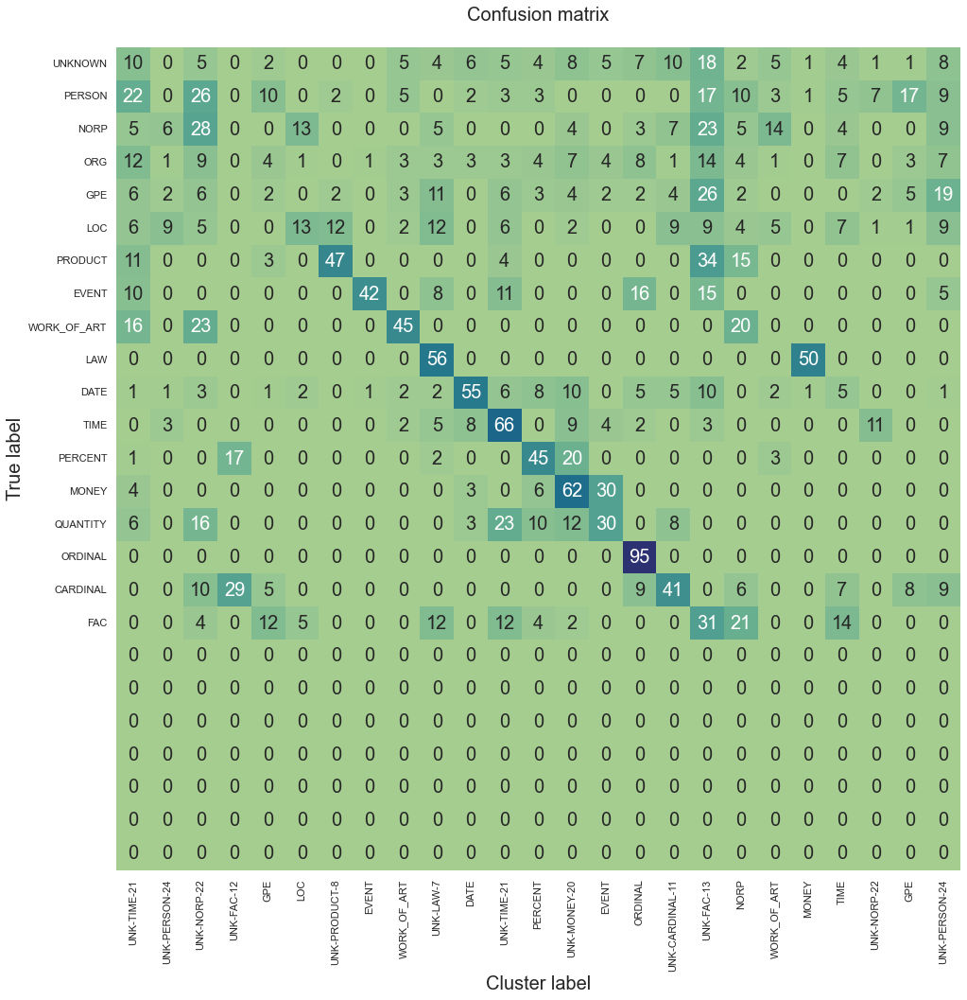

F1 score (macro) = 0.5560
Accuracy = 0.4940
Precision = 0.8388
Recall = 0.4997
New clusters =      4
... wrote results to c:\Users\Will\Projects\MSc\project\src\results\test-latent-15-ents-lw0.4-rw1.0-z-Kmeans\index.html
Finished 'evaluate_model' in 25.06 secs
--------------------------------------------------
3/9: test-latent-15-ents-lw0.5-rw0.8-z-Kmeans
--------------------------------------------------
{'train_size': 0, 'radius': 6, 'latent_weight': 0.5, 'reconstr_weight': 0.8, 'head': 'z'}
ERROR: Invalid config key <module 'tensorflow.keras' from 'c:\\Users\\Will\\Anaconda3\\envs\\tf-27\\lib\\site-packages\\keras\\api\\_v2\\keras\\__init__.py'>

F1 by Known Clusters: 0.2805


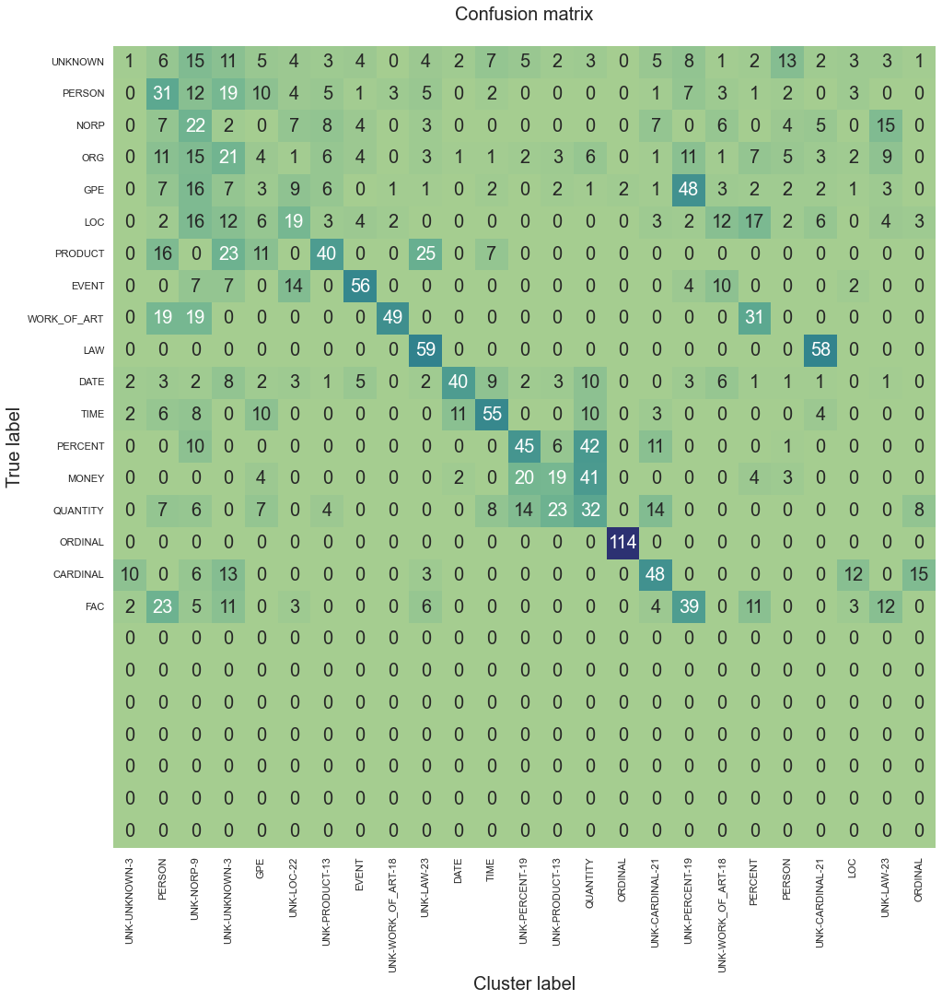

F1 score (macro) = 0.5431
Accuracy = 0.4940
Precision = 0.7832
Recall = 0.4912
New clusters =      6
... wrote results to c:\Users\Will\Projects\MSc\project\src\results\test-latent-15-ents-lw0.5-rw0.8-z-Kmeans\index.html
Finished 'evaluate_model' in 26.541 secs
--------------------------------------------------
4/9: test-latent-15-ents-lw0.5-rw0.9-z-Kmeans
--------------------------------------------------
{'train_size': 0, 'radius': 6, 'latent_weight': 0.5, 'reconstr_weight': 0.9, 'head': 'z'}
ERROR: Invalid config key <module 'tensorflow.keras' from 'c:\\Users\\Will\\Anaconda3\\envs\\tf-27\\lib\\site-packages\\keras\\api\\_v2\\keras\\__init__.py'>

F1 by Known Clusters: 0.2150


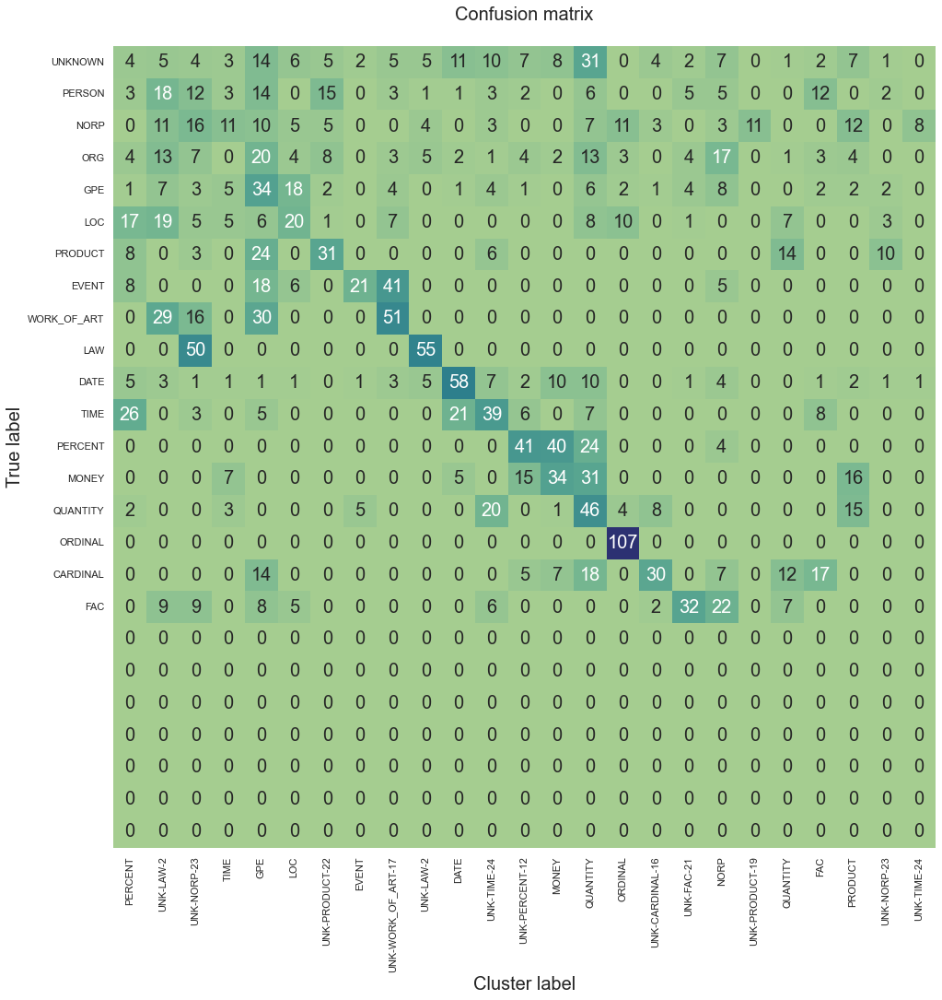

F1 score (macro) = 0.5372
Accuracy = 0.4815
Precision = 0.8401
Recall = 0.4738
New clusters =      2
... wrote results to c:\Users\Will\Projects\MSc\project\src\results\test-latent-15-ents-lw0.5-rw0.9-z-Kmeans\index.html
Finished 'evaluate_model' in 26.05 secs
--------------------------------------------------
5/9: test-latent-15-ents-lw0.5-rw1.0-z-Kmeans
--------------------------------------------------
{'train_size': 0, 'radius': 6, 'latent_weight': 0.5, 'reconstr_weight': 1.0, 'head': 'z'}
ERROR: Invalid config key <module 'tensorflow.keras' from 'c:\\Users\\Will\\Anaconda3\\envs\\tf-27\\lib\\site-packages\\keras\\api\\_v2\\keras\\__init__.py'>

F1 by Known Clusters: 0.2172


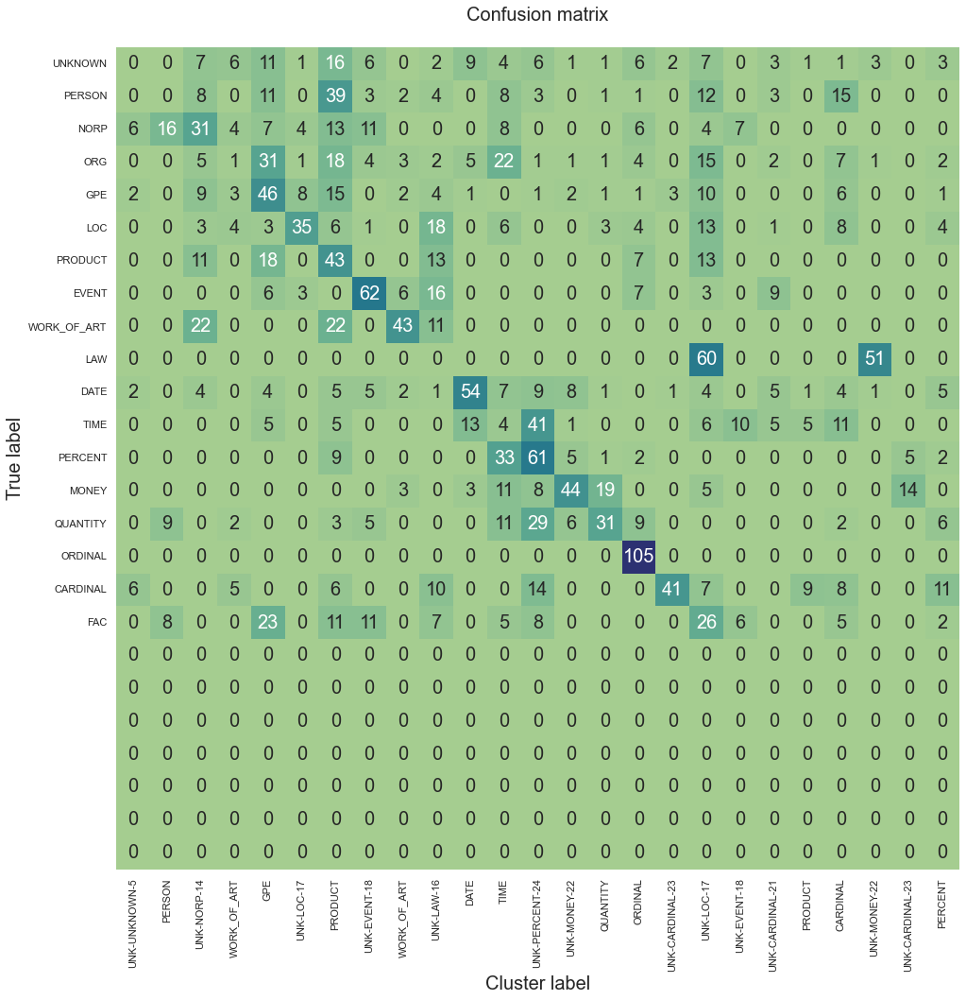

F1 score (macro) = 0.5388
Accuracy = 0.4720
Precision = 0.8380
Recall = 0.4792
New clusters =      3
... wrote results to c:\Users\Will\Projects\MSc\project\src\results\test-latent-15-ents-lw0.5-rw1.0-z-Kmeans\index.html
Finished 'evaluate_model' in 25.522 secs
--------------------------------------------------
6/9: test-latent-15-ents-lw1.0-rw0.8-z-Kmeans
--------------------------------------------------
{'train_size': 0, 'radius': 6, 'latent_weight': 1.0, 'reconstr_weight': 0.8, 'head': 'z'}
ERROR: Invalid config key <module 'tensorflow.keras' from 'c:\\Users\\Will\\Anaconda3\\envs\\tf-27\\lib\\site-packages\\keras\\api\\_v2\\keras\\__init__.py'>

F1 by Known Clusters: 0.3232


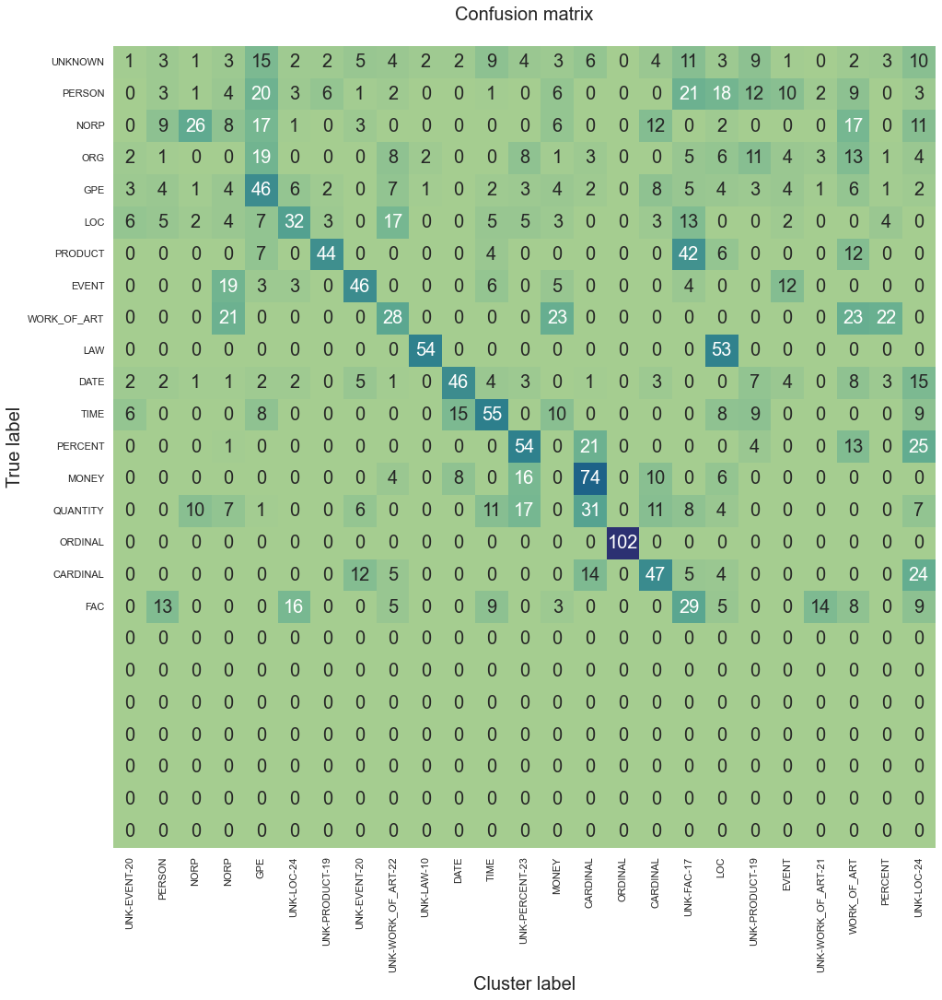

F1 score (macro) = 0.5654
Accuracy = 0.5125
Precision = 0.8387
Recall = 0.5133
New clusters =      5
... wrote results to c:\Users\Will\Projects\MSc\project\src\results\test-latent-15-ents-lw1.0-rw0.8-z-Kmeans\index.html
Finished 'evaluate_model' in 26.624 secs
--------------------------------------------------
7/9: test-latent-15-ents-lw1.0-rw0.9-z-Kmeans
--------------------------------------------------
{'train_size': 0, 'radius': 6, 'latent_weight': 1.0, 'reconstr_weight': 0.9, 'head': 'z'}
ERROR: Invalid config key <module 'tensorflow.keras' from 'c:\\Users\\Will\\Anaconda3\\envs\\tf-27\\lib\\site-packages\\keras\\api\\_v2\\keras\\__init__.py'>

F1 by Known Clusters: 0.2256


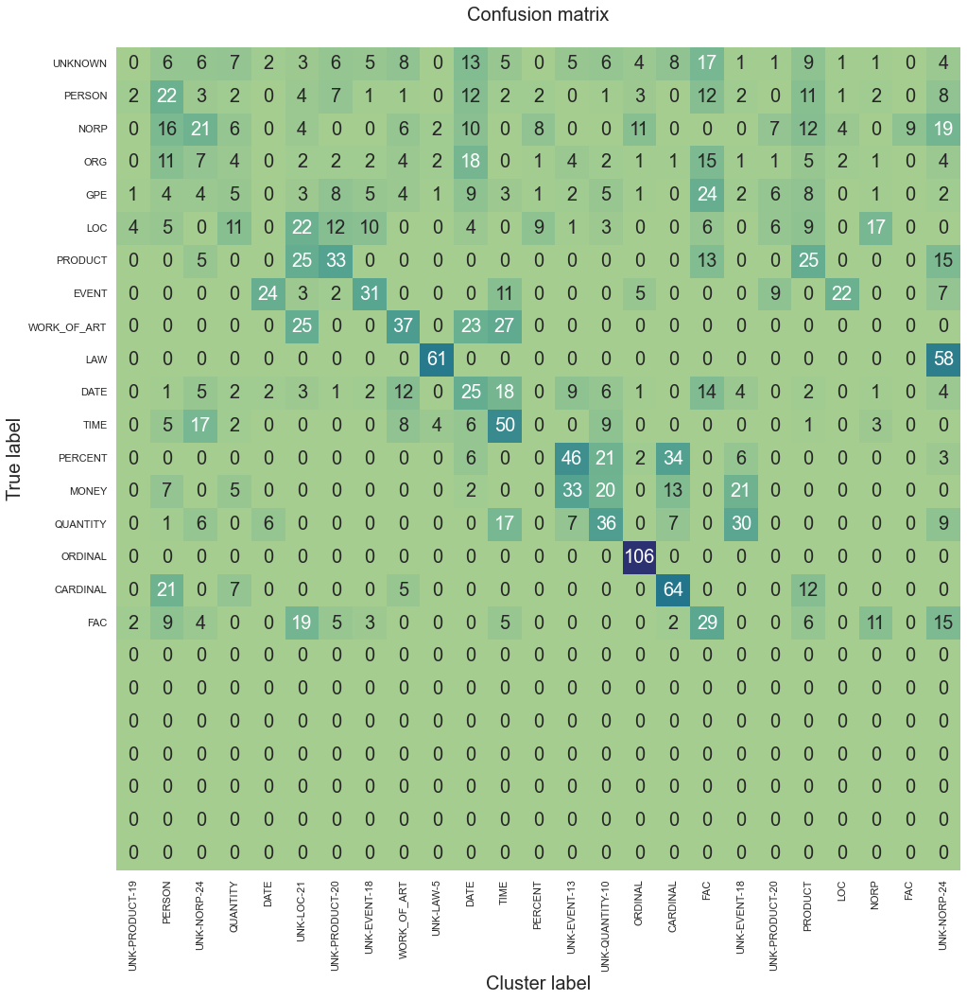

F1 score (macro) = 0.5031
Accuracy = 0.4610
Precision = 0.7833
Recall = 0.4492
New clusters =      4
... wrote results to c:\Users\Will\Projects\MSc\project\src\results\test-latent-15-ents-lw1.0-rw0.9-z-Kmeans\index.html
Finished 'evaluate_model' in 25.417 secs
--------------------------------------------------
8/9: test-latent-15-ents-lw1.0-rw1.0-z-Kmeans
--------------------------------------------------
{'train_size': 0, 'radius': 6, 'latent_weight': 1.0, 'reconstr_weight': 1.0, 'head': 'z'}
ERROR: Invalid config key <module 'tensorflow.keras' from 'c:\\Users\\Will\\Anaconda3\\envs\\tf-27\\lib\\site-packages\\keras\\api\\_v2\\keras\\__init__.py'>

F1 by Known Clusters: 0.3045


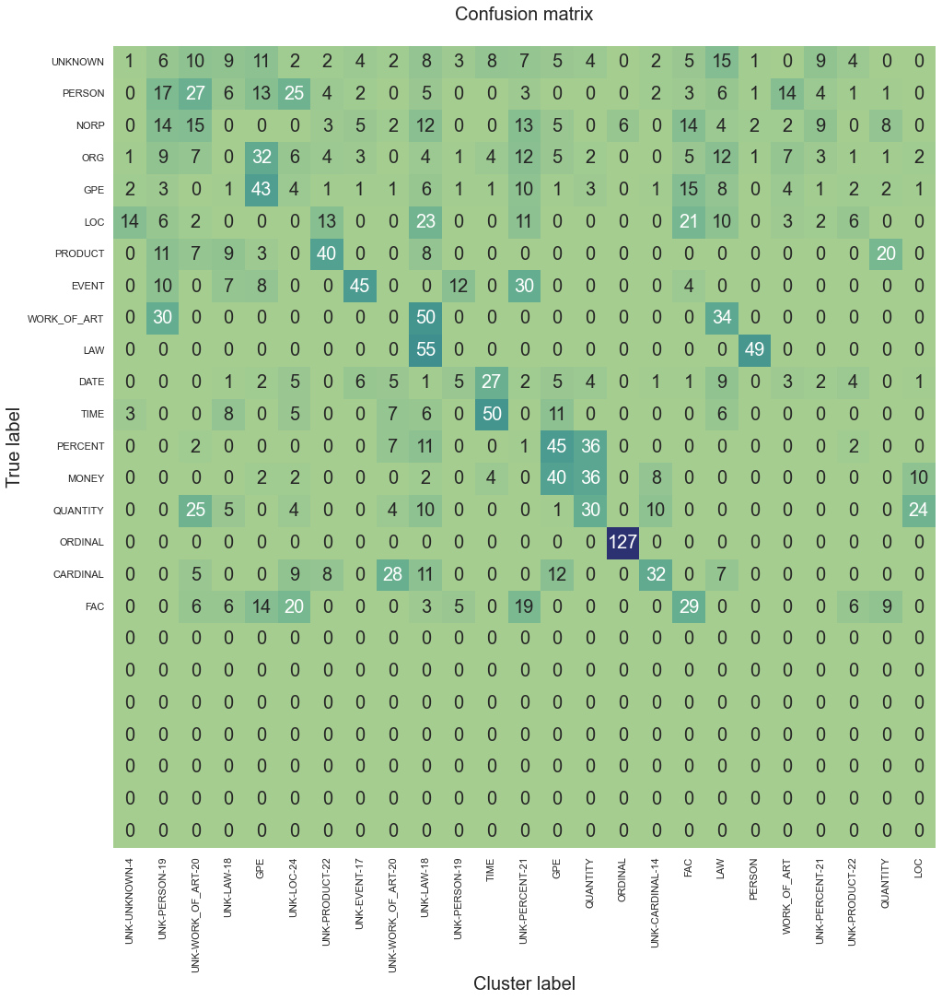

F1 score (macro) = 0.5024
Accuracy = 0.4665
Precision = 0.7278
Recall = 0.4598
New clusters =      3
... wrote results to c:\Users\Will\Projects\MSc\project\src\results\test-latent-15-ents-lw1.0-rw1.0-z-Kmeans\index.html
Finished 'evaluate_model' in 26.839 secs
--------------------------------------------------
9/9: test-latent-15-ents-lw0.4-rw0.8-z-Kmeans
--------------------------------------------------
{'train_size': 0, 'radius': 6, 'latent_weight': 0.4, 'reconstr_weight': 0.8, 'head': 'z'}
ERROR: Invalid config key <module 'tensorflow.keras' from 'c:\\Users\\Will\\Anaconda3\\envs\\tf-27\\lib\\site-packages\\keras\\api\\_v2\\keras\\__init__.py'>

F1 by Known Clusters: 0.2755


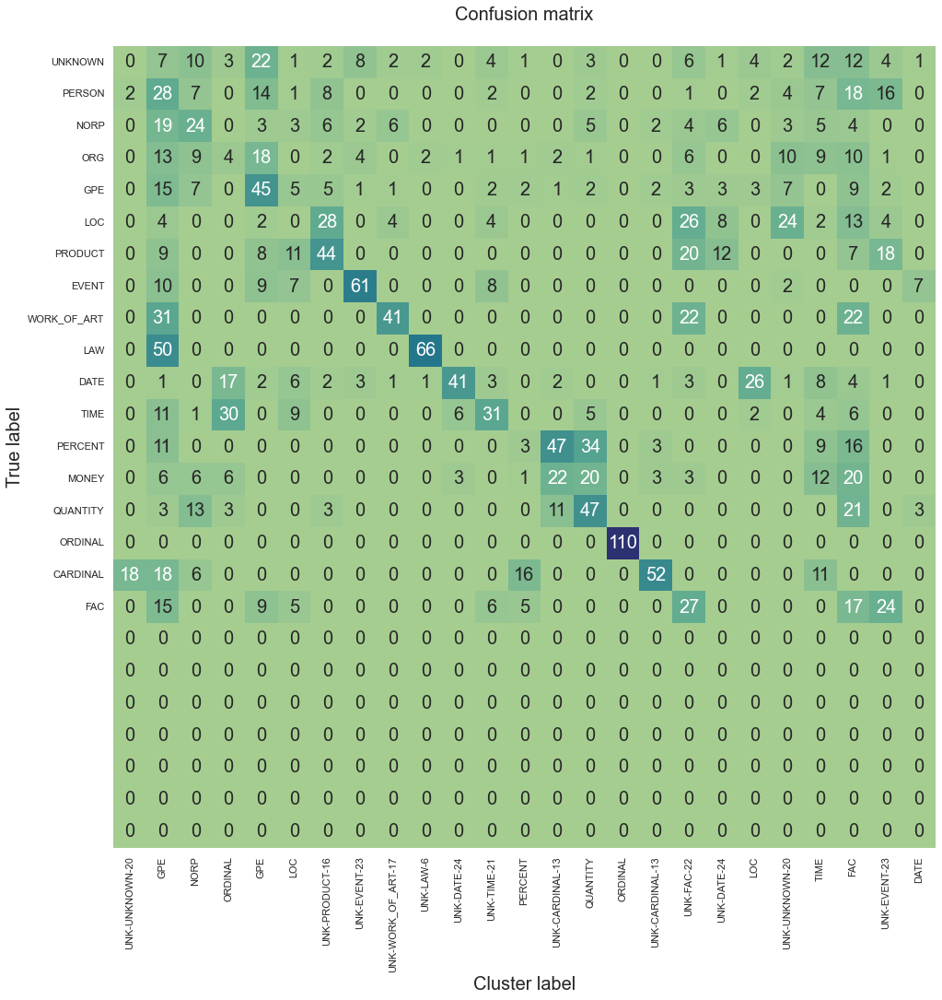

F1 score (macro) = 0.5418
Accuracy = 0.4915
Precision = 0.7831
Recall = 0.4840
New clusters =      5
... wrote results to c:\Users\Will\Projects\MSc\project\src\results\test-latent-15-ents-lw0.4-rw0.8-z-Kmeans\index.html
Finished 'evaluate_model' in 25.071 secs
--------------------------------------------------
10/9: test-latent-15-ents-lw0.4-rw0.9-z-Kmeans
--------------------------------------------------
{'train_size': 0, 'radius': 6, 'latent_weight': 0.4, 'reconstr_weight': 0.9, 'head': 'z'}
ERROR: Invalid config key <module 'tensorflow.keras' from 'c:\\Users\\Will\\Anaconda3\\envs\\tf-27\\lib\\site-packages\\keras\\api\\_v2\\keras\\__init__.py'>

F1 by Known Clusters: 0.2892


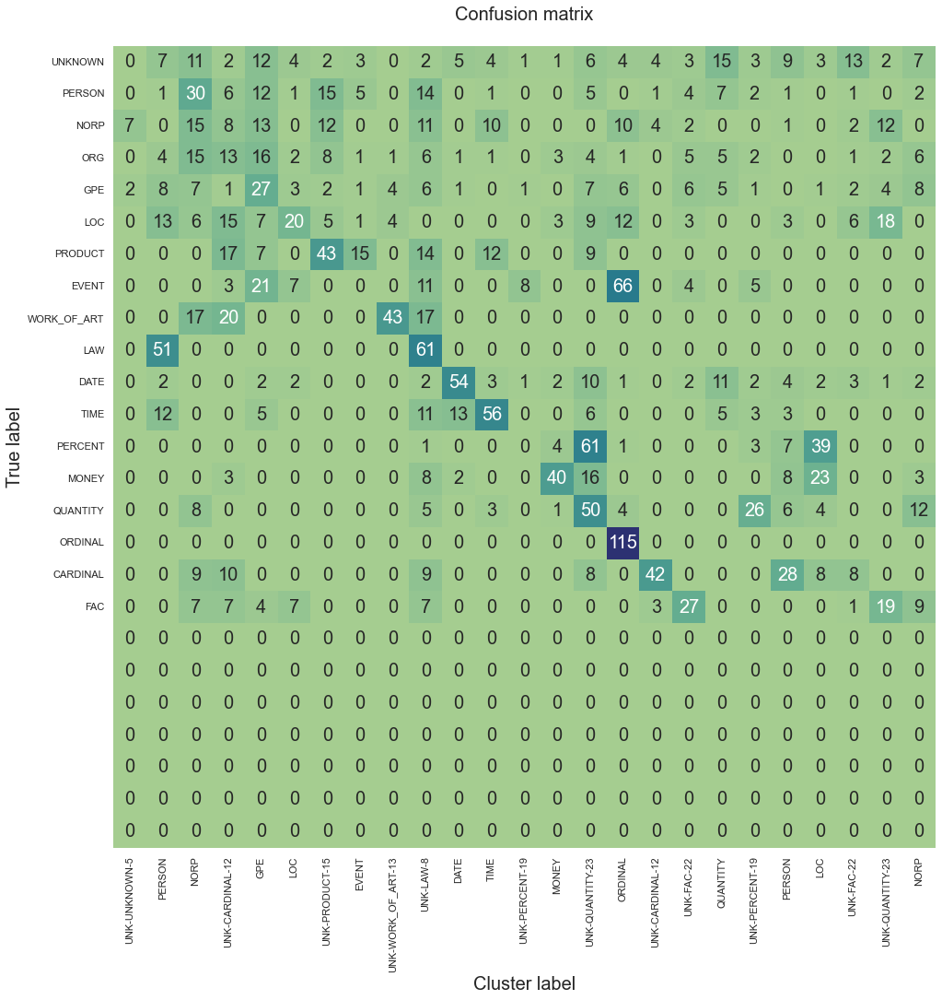

F1 score (macro) = 0.5398
Accuracy = 0.4835
Precision = 0.8948
Recall = 0.4791
New clusters =      3
... wrote results to c:\Users\Will\Projects\MSc\project\src\results\test-latent-15-ents-lw0.4-rw0.9-z-Kmeans\index.html
Finished 'evaluate_model' in 27.262 secs
--------------------------------------------------
11/9: test-latent-15-ents-lw0.4-rw1.0-z-Kmeans
--------------------------------------------------
{'train_size': 0, 'radius': 6, 'latent_weight': 0.4, 'reconstr_weight': 1.0, 'head': 'z'}
ERROR: Invalid config key <module 'tensorflow.keras' from 'c:\\Users\\Will\\Anaconda3\\envs\\tf-27\\lib\\site-packages\\keras\\api\\_v2\\keras\\__init__.py'>

F1 by Known Clusters: 0.2882


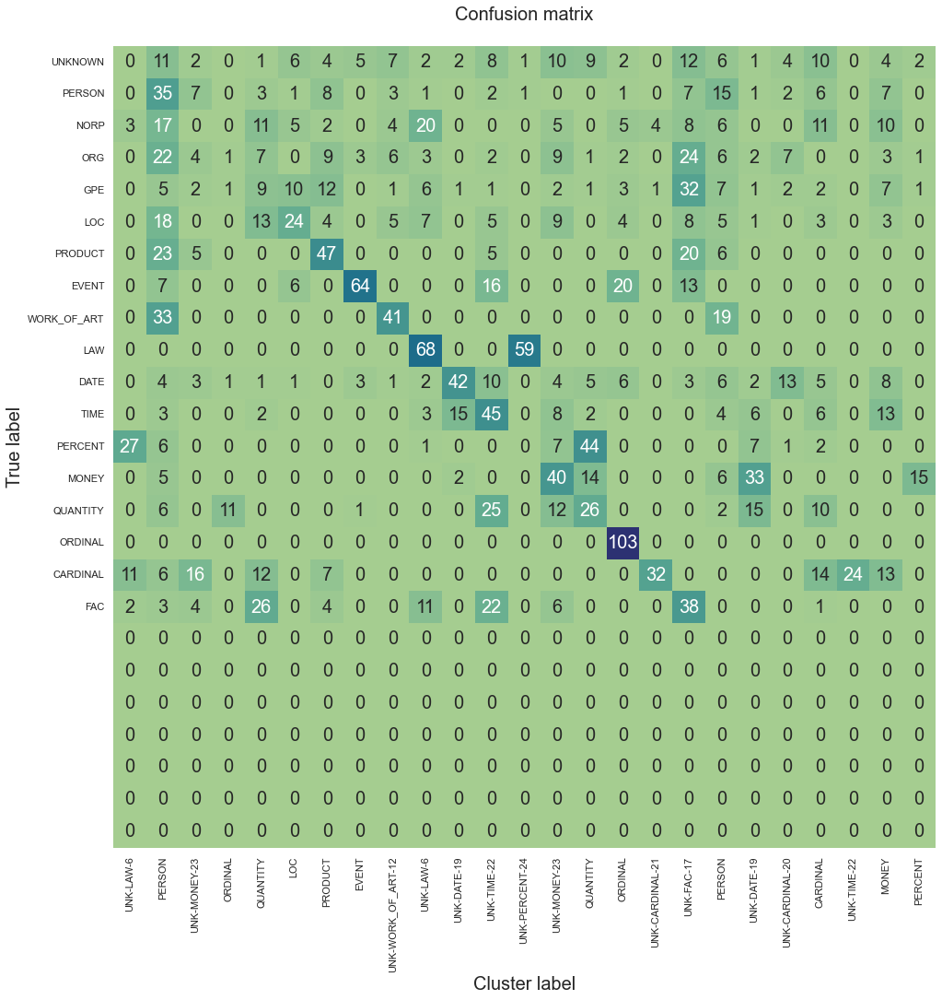

F1 score (macro) = 0.5475
Accuracy = 0.5010
Precision = 0.7832
Recall = 0.4981
New clusters =      3
... wrote results to c:\Users\Will\Projects\MSc\project\src\results\test-latent-15-ents-lw0.4-rw1.0-z-Kmeans\index.html
Finished 'evaluate_model' in 29.204 secs
--------------------------------------------------
12/9: test-latent-15-ents-lw0.5-rw0.8-z-Kmeans
--------------------------------------------------
{'train_size': 0, 'radius': 6, 'latent_weight': 0.5, 'reconstr_weight': 0.8, 'head': 'z'}
ERROR: Invalid config key <module 'tensorflow.keras' from 'c:\\Users\\Will\\Anaconda3\\envs\\tf-27\\lib\\site-packages\\keras\\api\\_v2\\keras\\__init__.py'>

F1 by Known Clusters: 0.3177


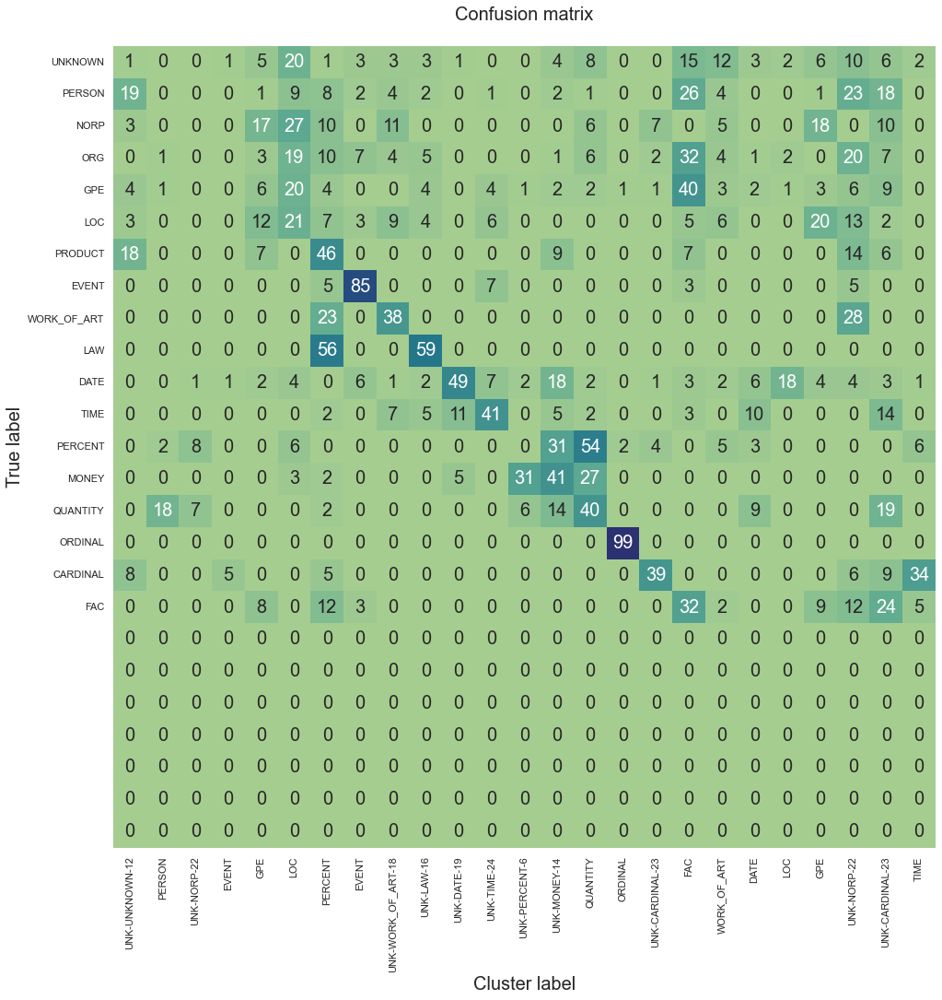

F1 score (macro) = 0.5478
Accuracy = 0.4830
Precision = 0.8385
Recall = 0.4952
New clusters =      5
... wrote results to c:\Users\Will\Projects\MSc\project\src\results\test-latent-15-ents-lw0.5-rw0.8-z-Kmeans\index.html
Finished 'evaluate_model' in 26.845 secs
--------------------------------------------------
13/9: test-latent-15-ents-lw0.5-rw0.9-z-Kmeans
--------------------------------------------------
{'train_size': 0, 'radius': 6, 'latent_weight': 0.5, 'reconstr_weight': 0.9, 'head': 'z'}
ERROR: Invalid config key <module 'tensorflow.keras' from 'c:\\Users\\Will\\Anaconda3\\envs\\tf-27\\lib\\site-packages\\keras\\api\\_v2\\keras\\__init__.py'>

F1 by Known Clusters: 0.3086


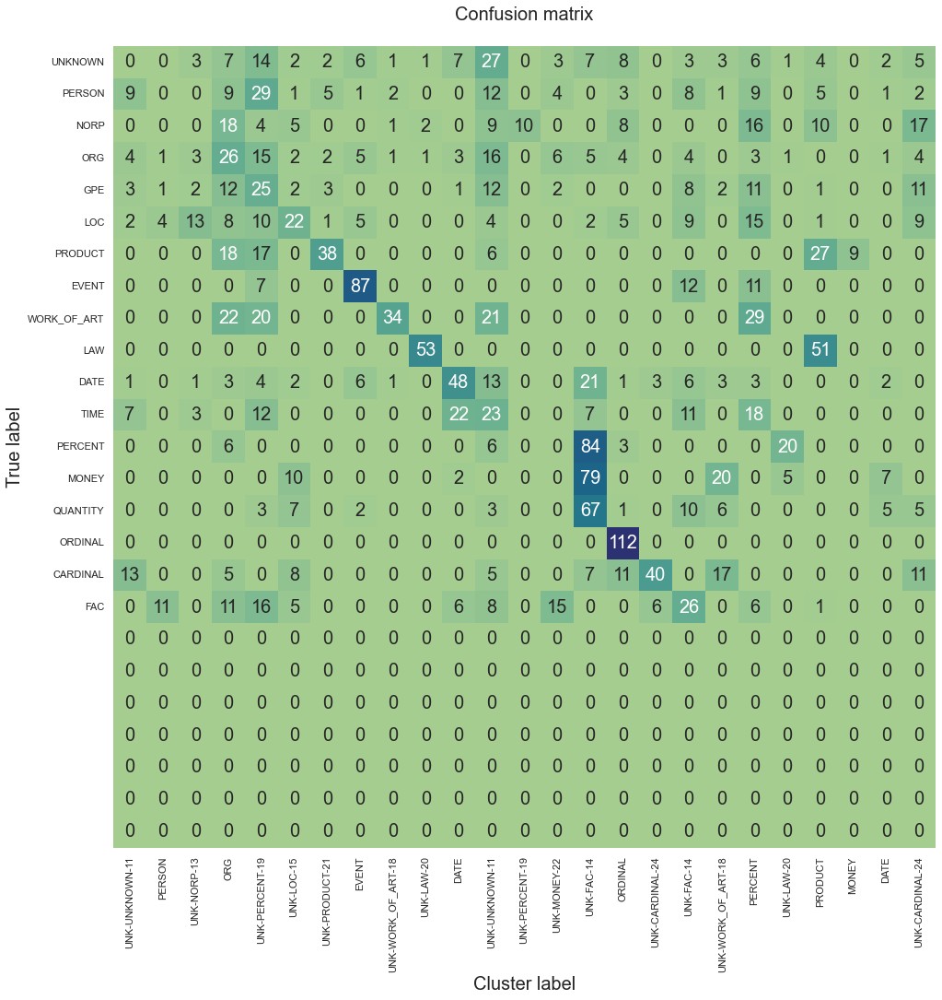

F1 score (macro) = 0.5083
Accuracy = 0.4630
Precision = 0.7830
Recall = 0.4551
New clusters =      3
... wrote results to c:\Users\Will\Projects\MSc\project\src\results\test-latent-15-ents-lw0.5-rw0.9-z-Kmeans\index.html
Finished 'evaluate_model' in 25.764 secs
--------------------------------------------------
14/9: test-latent-15-ents-lw0.5-rw1.0-z-Kmeans
--------------------------------------------------
{'train_size': 0, 'radius': 6, 'latent_weight': 0.5, 'reconstr_weight': 1.0, 'head': 'z'}
ERROR: Invalid config key <module 'tensorflow.keras' from 'c:\\Users\\Will\\Anaconda3\\envs\\tf-27\\lib\\site-packages\\keras\\api\\_v2\\keras\\__init__.py'>

F1 by Known Clusters: 0.3149


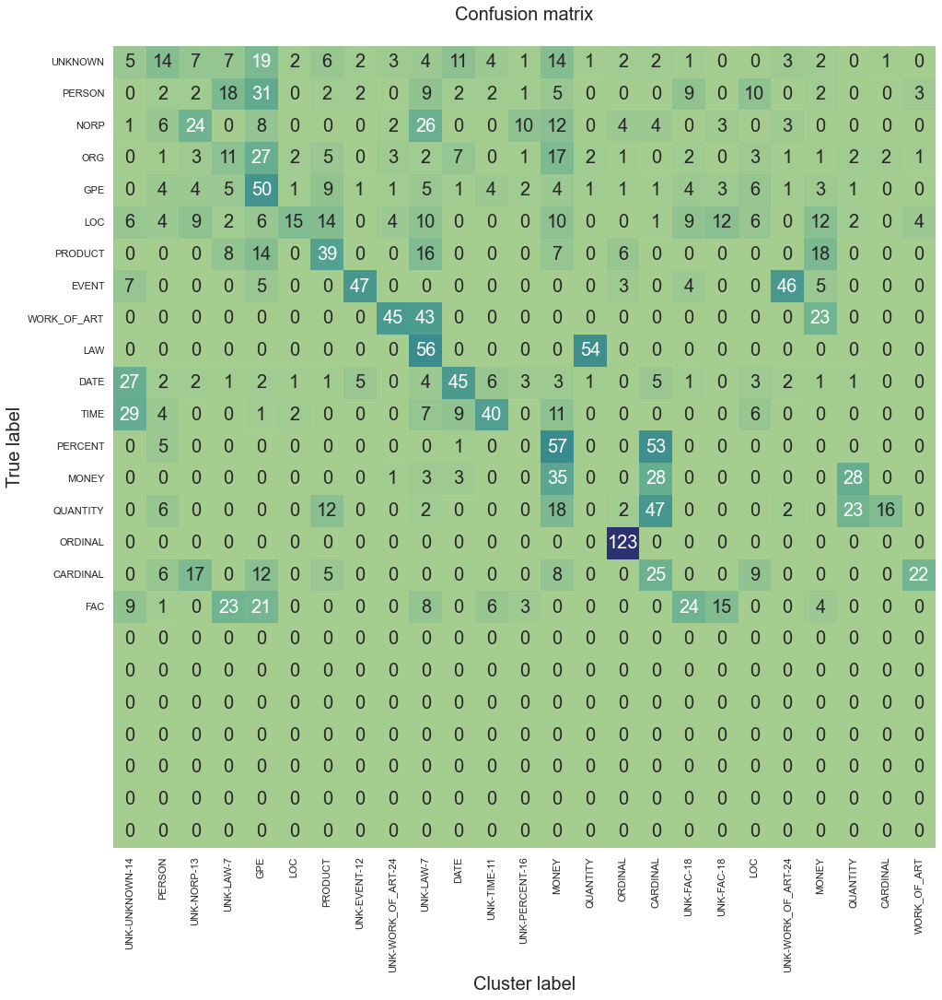

F1 score (macro) = 0.5497
Accuracy = 0.5025
Precision = 0.8945
Recall = 0.4944
New clusters =      4
... wrote results to c:\Users\Will\Projects\MSc\project\src\results\test-latent-15-ents-lw0.5-rw1.0-z-Kmeans\index.html
Finished 'evaluate_model' in 25.744 secs
--------------------------------------------------
15/9: test-latent-15-ents-lw1.0-rw0.8-z-Kmeans
--------------------------------------------------
{'train_size': 0, 'radius': 6, 'latent_weight': 1.0, 'reconstr_weight': 0.8, 'head': 'z'}
ERROR: Invalid config key <module 'tensorflow.keras' from 'c:\\Users\\Will\\Anaconda3\\envs\\tf-27\\lib\\site-packages\\keras\\api\\_v2\\keras\\__init__.py'>

F1 by Known Clusters: 0.2383


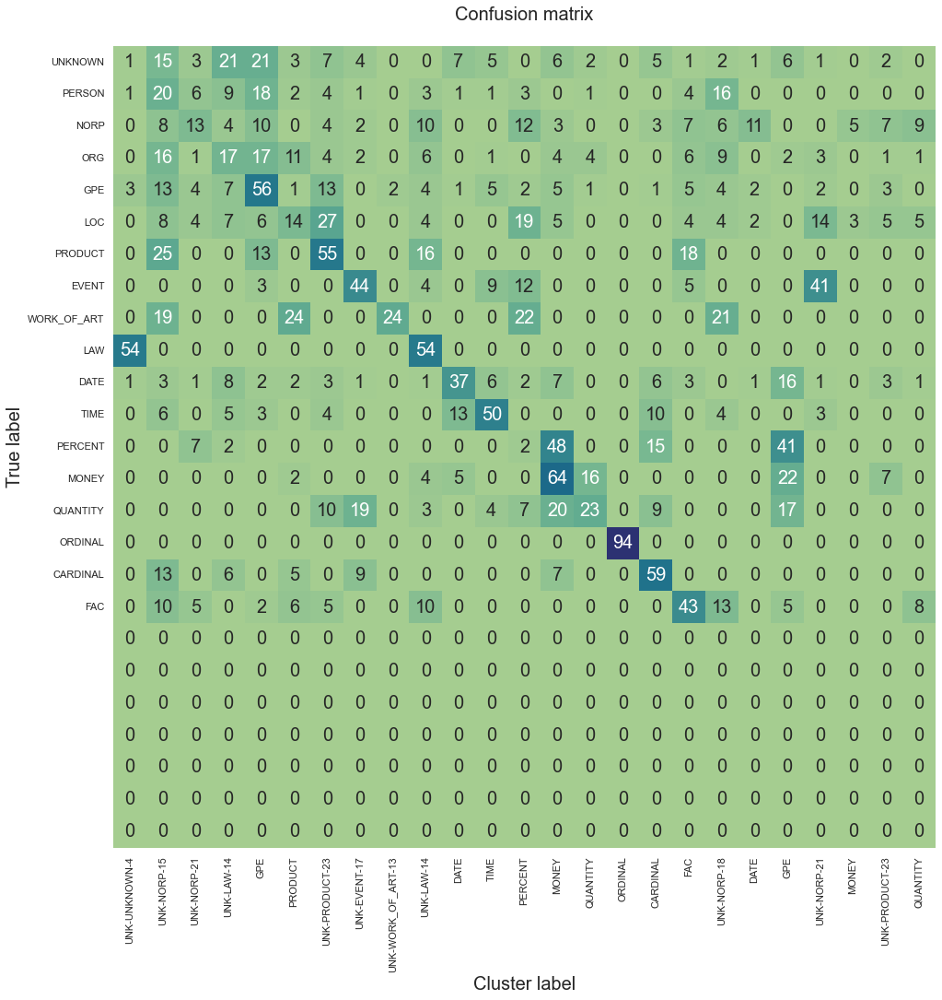

F1 score (macro) = 0.5518
Accuracy = 0.4945
Precision = 0.7834
Recall = 0.4970
New clusters =      4
... wrote results to c:\Users\Will\Projects\MSc\project\src\results\test-latent-15-ents-lw1.0-rw0.8-z-Kmeans\index.html
Finished 'evaluate_model' in 24.686 secs
--------------------------------------------------
16/9: test-latent-15-ents-lw1.0-rw0.9-z-Kmeans
--------------------------------------------------
{'train_size': 0, 'radius': 6, 'latent_weight': 1.0, 'reconstr_weight': 0.9, 'head': 'z'}
ERROR: Invalid config key <module 'tensorflow.keras' from 'c:\\Users\\Will\\Anaconda3\\envs\\tf-27\\lib\\site-packages\\keras\\api\\_v2\\keras\\__init__.py'>

F1 by Known Clusters: 0.3154


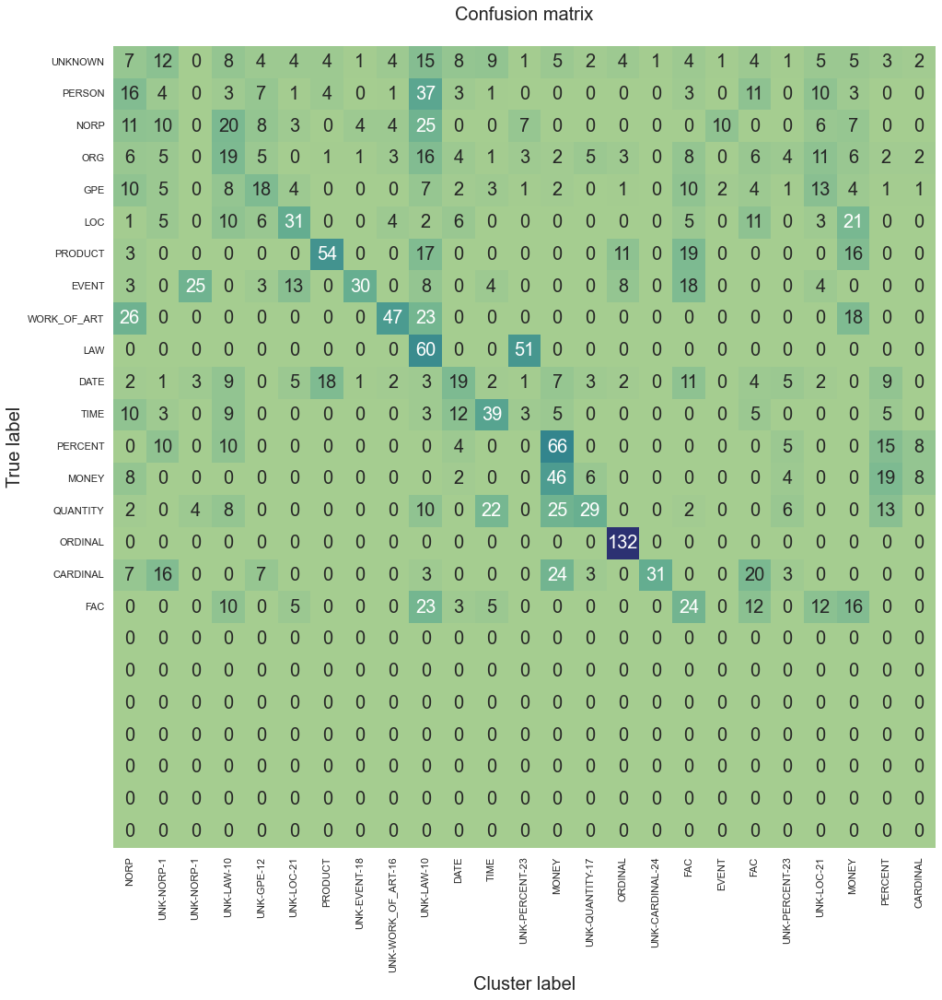

F1 score (macro) = 0.5179
Accuracy = 0.4645
Precision = 0.8387
Recall = 0.4531
New clusters =      4
... wrote results to c:\Users\Will\Projects\MSc\project\src\results\test-latent-15-ents-lw1.0-rw0.9-z-Kmeans\index.html
Finished 'evaluate_model' in 26.498 secs
--------------------------------------------------
17/9: test-latent-15-ents-lw1.0-rw1.0-z-Kmeans
--------------------------------------------------
{'train_size': 0, 'radius': 6, 'latent_weight': 1.0, 'reconstr_weight': 1.0, 'head': 'z'}
ERROR: Invalid config key <module 'tensorflow.keras' from 'c:\\Users\\Will\\Anaconda3\\envs\\tf-27\\lib\\site-packages\\keras\\api\\_v2\\keras\\__init__.py'>

F1 by Known Clusters: 0.4017


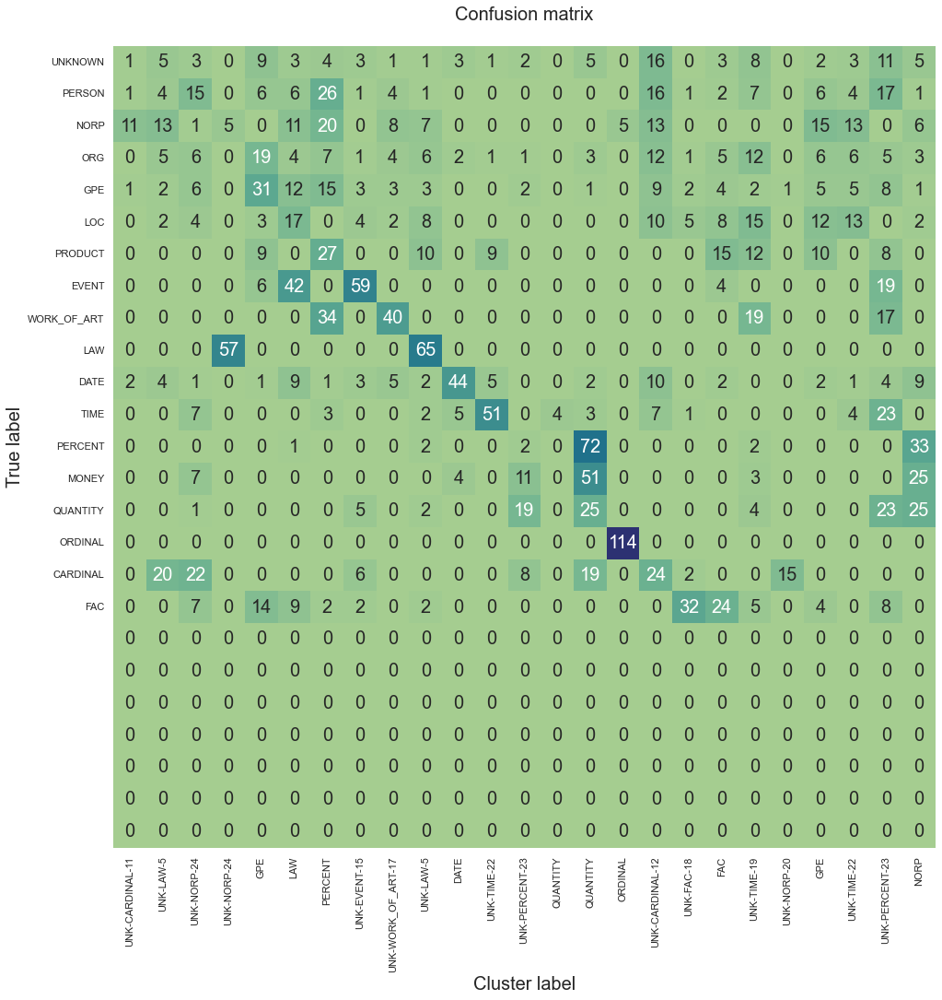

F1 score (macro) = 0.5010
Accuracy = 0.4860
Precision = 0.6711
Recall = 0.4804
New clusters =      5
... wrote results to c:\Users\Will\Projects\MSc\project\src\results\test-latent-15-ents-lw1.0-rw1.0-z-Kmeans\index.html
Finished 'evaluate_model' in 25.556 secs
--------------------------------------------------
18/9: test-latent-15-ents-lw0.4-rw0.8-z-Kmeans
--------------------------------------------------
{'train_size': 0, 'radius': 6, 'latent_weight': 0.4, 'reconstr_weight': 0.8, 'head': 'z'}
ERROR: Invalid config key <module 'tensorflow.keras' from 'c:\\Users\\Will\\Anaconda3\\envs\\tf-27\\lib\\site-packages\\keras\\api\\_v2\\keras\\__init__.py'>

F1 by Known Clusters: 0.2328


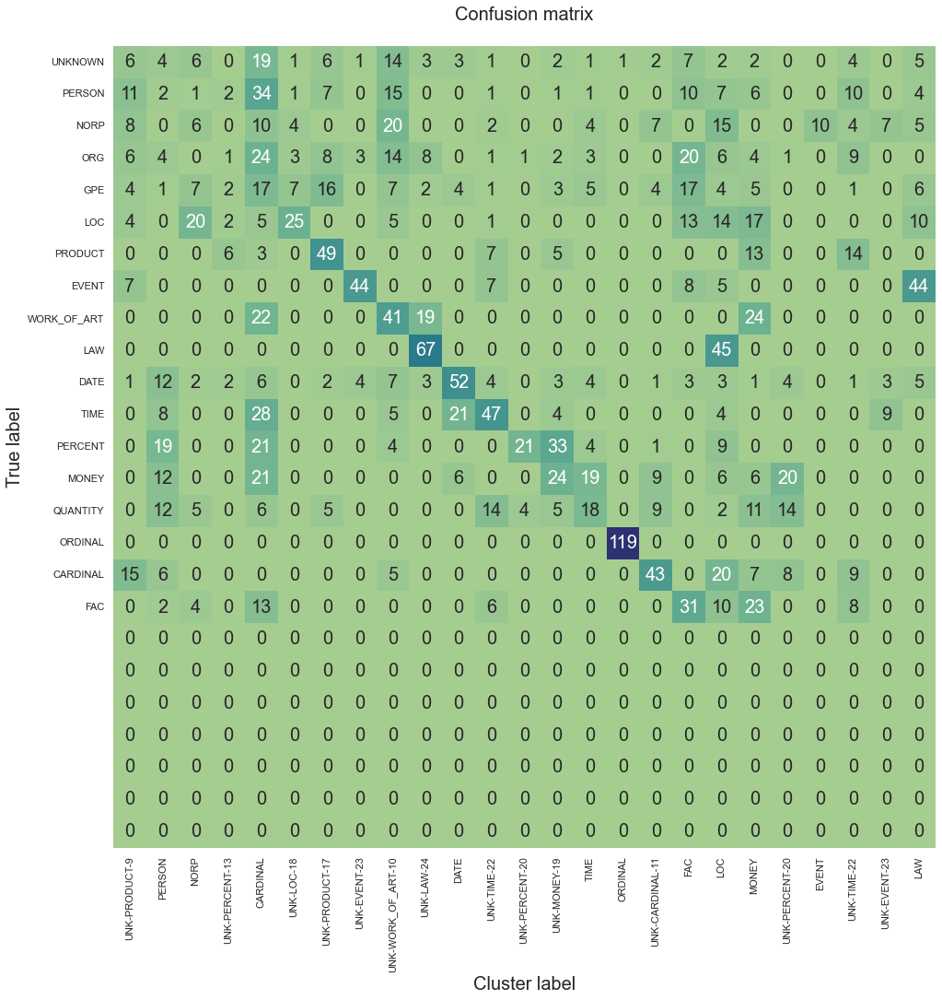

F1 score (macro) = 0.5248
Accuracy = 0.4705
Precision = 0.7821
Recall = 0.4748
New clusters =      4
... wrote results to c:\Users\Will\Projects\MSc\project\src\results\test-latent-15-ents-lw0.4-rw0.8-z-Kmeans\index.html
Finished 'evaluate_model' in 25.092 secs
--------------------------------------------------
19/9: test-latent-15-ents-lw0.4-rw0.9-z-Kmeans
--------------------------------------------------
{'train_size': 0, 'radius': 6, 'latent_weight': 0.4, 'reconstr_weight': 0.9, 'head': 'z'}
ERROR: Invalid config key <module 'tensorflow.keras' from 'c:\\Users\\Will\\Anaconda3\\envs\\tf-27\\lib\\site-packages\\keras\\api\\_v2\\keras\\__init__.py'>

F1 by Known Clusters: 0.1413


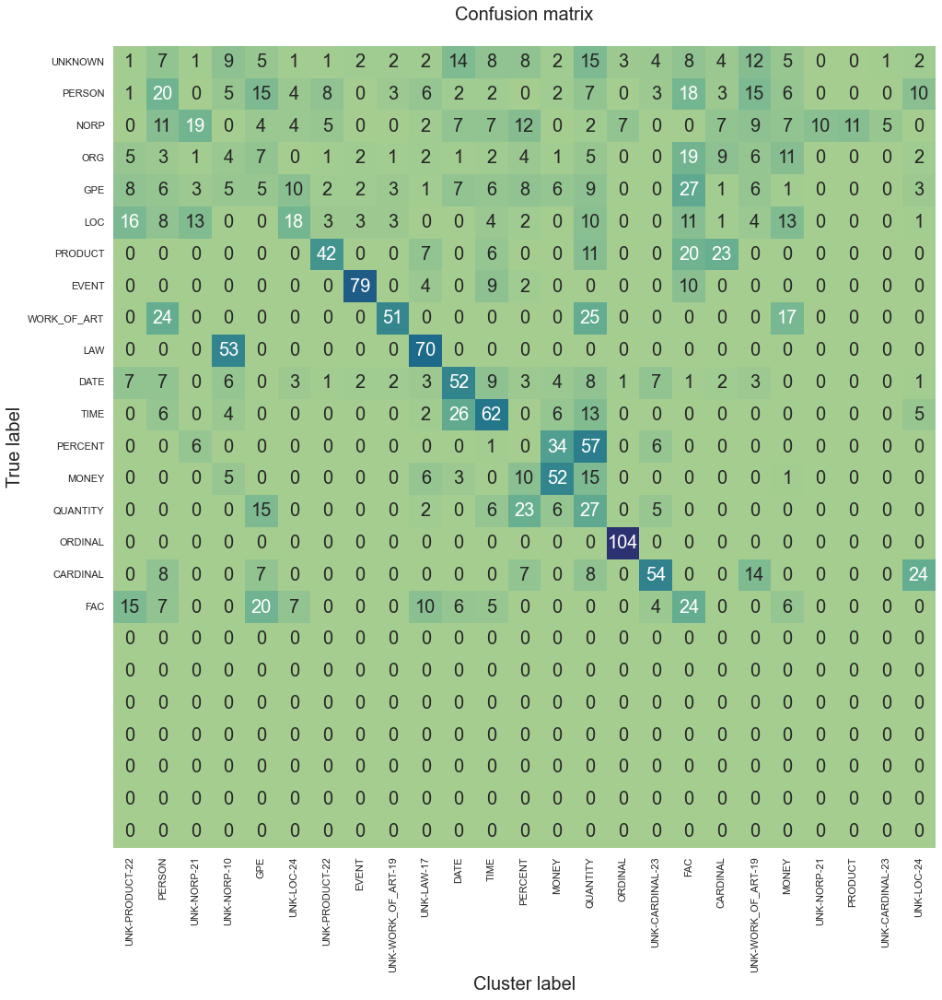

F1 score (macro) = 0.5823
Accuracy = 0.5225
Precision = 0.8950
Recall = 0.5160
New clusters =      5
... wrote results to c:\Users\Will\Projects\MSc\project\src\results\test-latent-15-ents-lw0.4-rw0.9-z-Kmeans\index.html
Finished 'evaluate_model' in 26.674 secs
--------------------------------------------------
20/9: test-latent-15-ents-lw0.4-rw1.0-z-Kmeans
--------------------------------------------------
{'train_size': 0, 'radius': 6, 'latent_weight': 0.4, 'reconstr_weight': 1.0, 'head': 'z'}
ERROR: Invalid config key <module 'tensorflow.keras' from 'c:\\Users\\Will\\Anaconda3\\envs\\tf-27\\lib\\site-packages\\keras\\api\\_v2\\keras\\__init__.py'>

F1 by Known Clusters: 0.2154


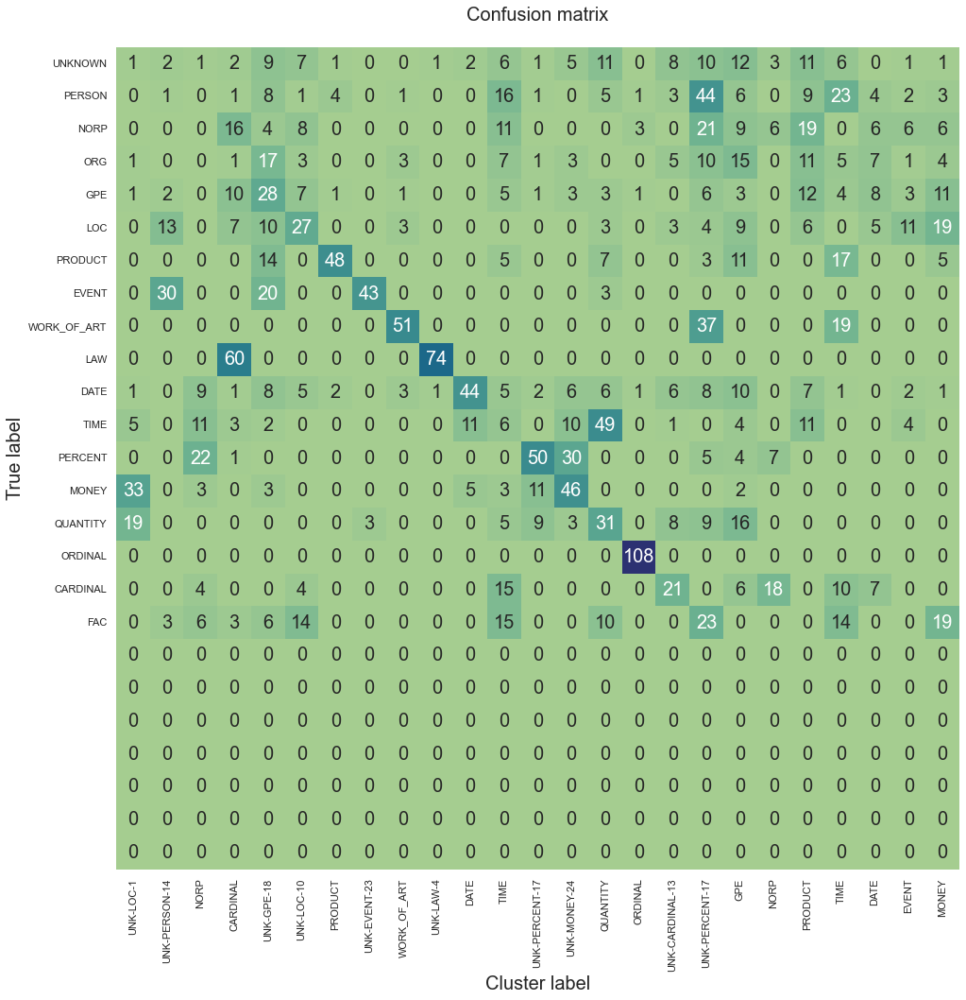

F1 score (macro) = 0.5600
Accuracy = 0.5045
Precision = 0.8385
Recall = 0.4994
New clusters =      6
... wrote results to c:\Users\Will\Projects\MSc\project\src\results\test-latent-15-ents-lw0.4-rw1.0-z-Kmeans\index.html
Finished 'evaluate_model' in 25.611 secs
--------------------------------------------------
21/9: test-latent-15-ents-lw0.5-rw0.8-z-Kmeans
--------------------------------------------------
{'train_size': 0, 'radius': 6, 'latent_weight': 0.5, 'reconstr_weight': 0.8, 'head': 'z'}
ERROR: Invalid config key <module 'tensorflow.keras' from 'c:\\Users\\Will\\Anaconda3\\envs\\tf-27\\lib\\site-packages\\keras\\api\\_v2\\keras\\__init__.py'>

F1 by Known Clusters: 0.3082


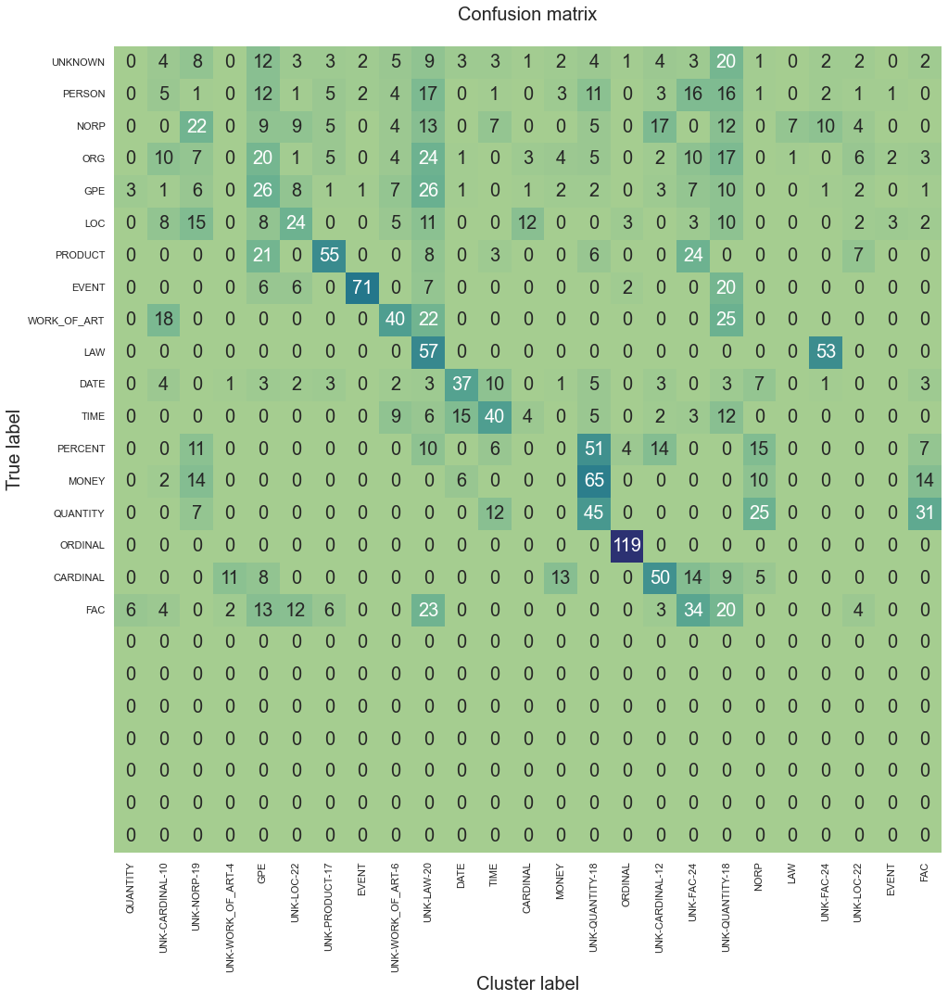

F1 score (macro) = 0.5343
Accuracy = 0.4725
Precision = 0.7823
Recall = 0.4801
New clusters =      4
... wrote results to c:\Users\Will\Projects\MSc\project\src\results\test-latent-15-ents-lw0.5-rw0.8-z-Kmeans\index.html
Finished 'evaluate_model' in 25.666 secs
--------------------------------------------------
22/9: test-latent-15-ents-lw0.5-rw0.9-z-Kmeans
--------------------------------------------------
{'train_size': 0, 'radius': 6, 'latent_weight': 0.5, 'reconstr_weight': 0.9, 'head': 'z'}
ERROR: Invalid config key <module 'tensorflow.keras' from 'c:\\Users\\Will\\Anaconda3\\envs\\tf-27\\lib\\site-packages\\keras\\api\\_v2\\keras\\__init__.py'>

F1 by Known Clusters: 0.2802


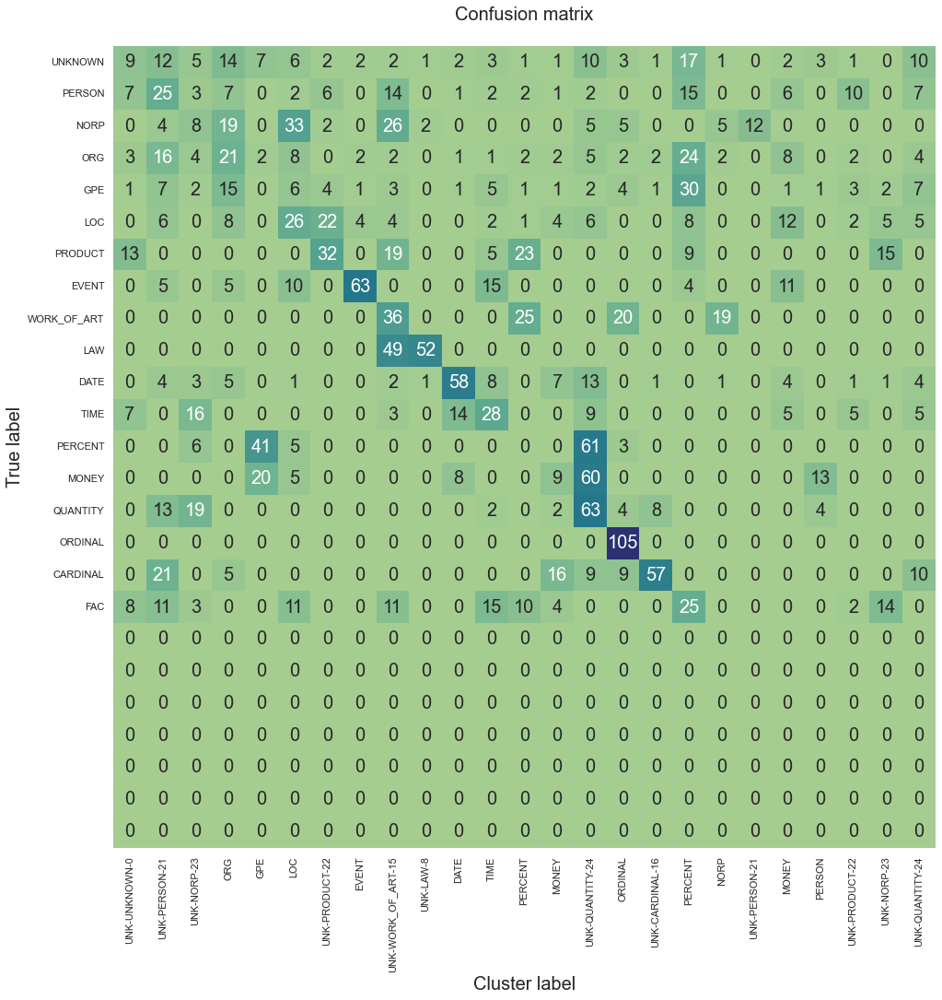

F1 score (macro) = 0.5339
Accuracy = 0.4630
Precision = 0.8943
Recall = 0.4649
New clusters =      3
... wrote results to c:\Users\Will\Projects\MSc\project\src\results\test-latent-15-ents-lw0.5-rw0.9-z-Kmeans\index.html
Finished 'evaluate_model' in 25.527 secs
--------------------------------------------------
23/9: test-latent-15-ents-lw0.5-rw1.0-z-Kmeans
--------------------------------------------------
{'train_size': 0, 'radius': 6, 'latent_weight': 0.5, 'reconstr_weight': 1.0, 'head': 'z'}
ERROR: Invalid config key <module 'tensorflow.keras' from 'c:\\Users\\Will\\Anaconda3\\envs\\tf-27\\lib\\site-packages\\keras\\api\\_v2\\keras\\__init__.py'>

F1 by Known Clusters: 0.3301


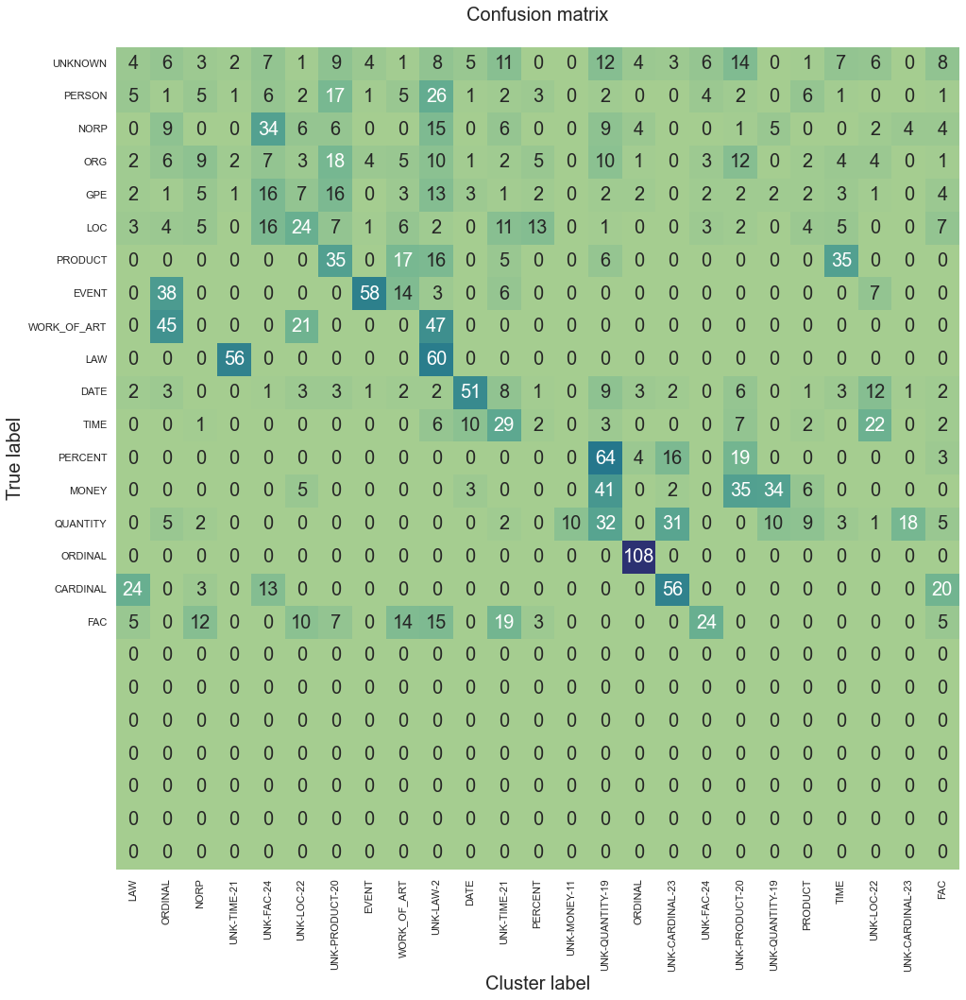

F1 score (macro) = 0.5514
Accuracy = 0.5075
Precision = 0.7839
Recall = 0.4964
New clusters =      5
... wrote results to c:\Users\Will\Projects\MSc\project\src\results\test-latent-15-ents-lw0.5-rw1.0-z-Kmeans\index.html
Finished 'evaluate_model' in 25.864 secs
--------------------------------------------------
24/9: test-latent-15-ents-lw1.0-rw0.8-z-Kmeans
--------------------------------------------------
{'train_size': 0, 'radius': 6, 'latent_weight': 1.0, 'reconstr_weight': 0.8, 'head': 'z'}
ERROR: Invalid config key <module 'tensorflow.keras' from 'c:\\Users\\Will\\Anaconda3\\envs\\tf-27\\lib\\site-packages\\keras\\api\\_v2\\keras\\__init__.py'>

F1 by Known Clusters: 0.3018


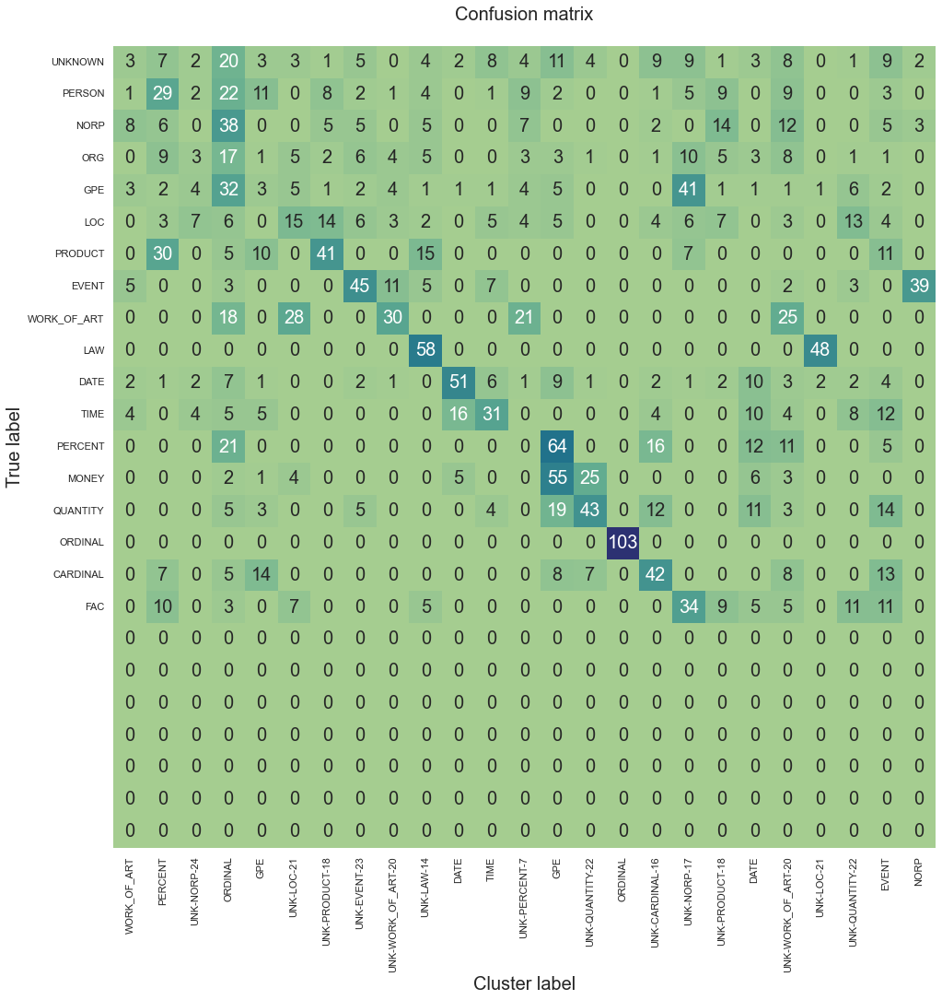

F1 score (macro) = 0.5218
Accuracy = 0.4895
Precision = 0.7280
Recall = 0.4773
New clusters =      4
... wrote results to c:\Users\Will\Projects\MSc\project\src\results\test-latent-15-ents-lw1.0-rw0.8-z-Kmeans\index.html
Finished 'evaluate_model' in 26.58 secs
--------------------------------------------------
25/9: test-latent-15-ents-lw1.0-rw0.9-z-Kmeans
--------------------------------------------------
{'train_size': 0, 'radius': 6, 'latent_weight': 1.0, 'reconstr_weight': 0.9, 'head': 'z'}
ERROR: Invalid config key <module 'tensorflow.keras' from 'c:\\Users\\Will\\Anaconda3\\envs\\tf-27\\lib\\site-packages\\keras\\api\\_v2\\keras\\__init__.py'>

F1 by Known Clusters: 0.3293


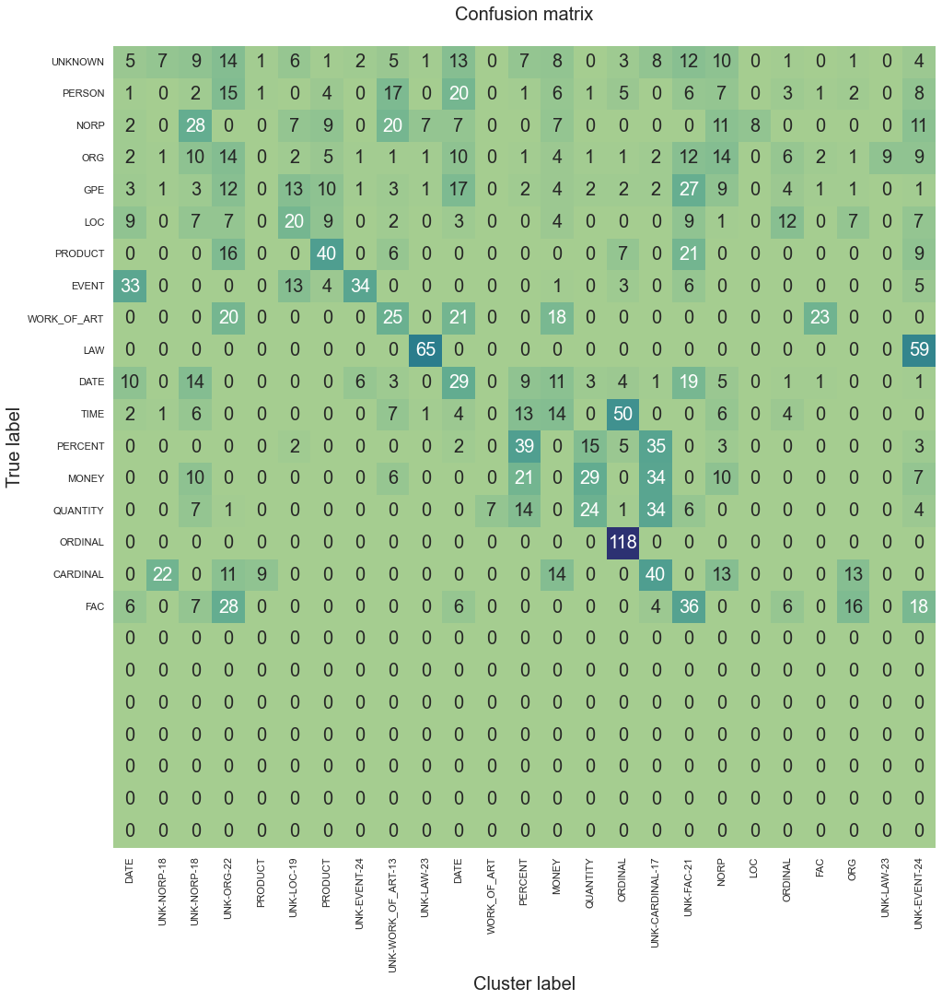

F1 score (macro) = 0.4787
Accuracy = 0.4395
Precision = 0.7831
Recall = 0.4278
New clusters =      3
... wrote results to c:\Users\Will\Projects\MSc\project\src\results\test-latent-15-ents-lw1.0-rw0.9-z-Kmeans\index.html
Finished 'evaluate_model' in 26.388 secs
--------------------------------------------------
26/9: test-latent-15-ents-lw1.0-rw1.0-z-Kmeans
--------------------------------------------------
{'train_size': 0, 'radius': 6, 'latent_weight': 1.0, 'reconstr_weight': 1.0, 'head': 'z'}
ERROR: Invalid config key <module 'tensorflow.keras' from 'c:\\Users\\Will\\Anaconda3\\envs\\tf-27\\lib\\site-packages\\keras\\api\\_v2\\keras\\__init__.py'>

F1 by Known Clusters: 0.2767


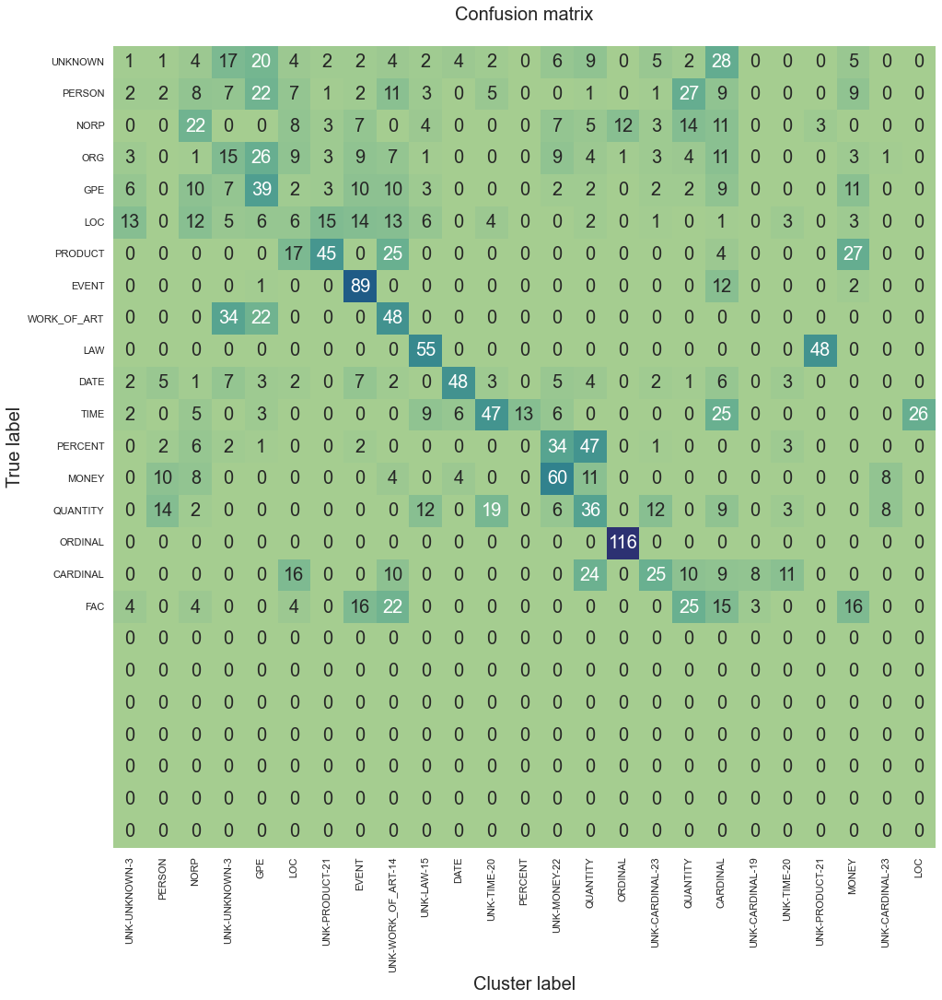

F1 score (macro) = 0.5508
Accuracy = 0.5025
Precision = 0.8392
Recall = 0.5011
New clusters =      3
... wrote results to c:\Users\Will\Projects\MSc\project\src\results\test-latent-15-ents-lw1.0-rw1.0-z-Kmeans\index.html
Finished 'evaluate_model' in 25.899 secs
--------------------------------------------------
27/9: test-latent-15-ents-lw0.4-rw0.8-z-Kmeans
--------------------------------------------------
{'train_size': 0, 'radius': 6, 'latent_weight': 0.4, 'reconstr_weight': 0.8, 'head': 'z'}
ERROR: Invalid config key <module 'tensorflow.keras' from 'c:\\Users\\Will\\Anaconda3\\envs\\tf-27\\lib\\site-packages\\keras\\api\\_v2\\keras\\__init__.py'>

F1 by Known Clusters: 0.3291


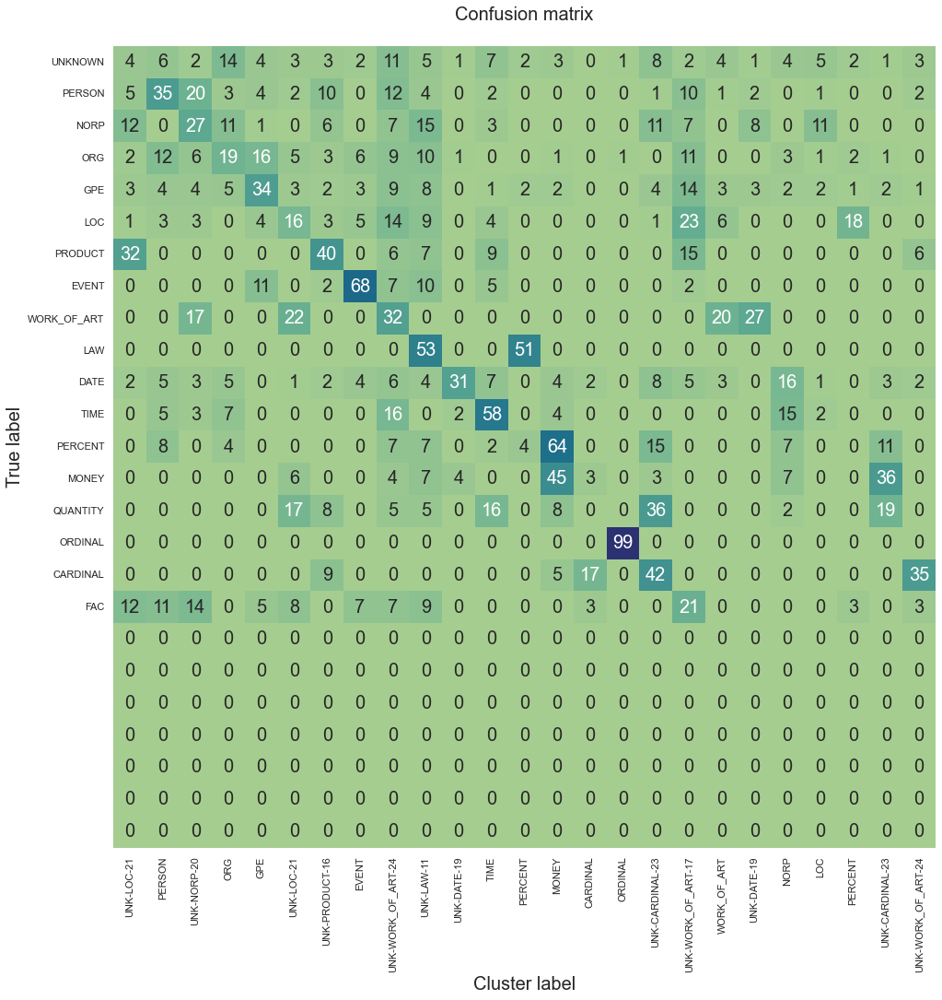

F1 score (macro) = 0.5689
Accuracy = 0.5040
Precision = 0.8383
Recall = 0.5120
New clusters =      4
... wrote results to c:\Users\Will\Projects\MSc\project\src\results\test-latent-15-ents-lw0.4-rw0.8-z-Kmeans\index.html
Finished 'evaluate_model' in 27.248 secs
--------------------------------------------------
28/9: test-latent-15-ents-lw0.4-rw0.9-z-Kmeans
--------------------------------------------------
{'train_size': 0, 'radius': 6, 'latent_weight': 0.4, 'reconstr_weight': 0.9, 'head': 'z'}
ERROR: Invalid config key <module 'tensorflow.keras' from 'c:\\Users\\Will\\Anaconda3\\envs\\tf-27\\lib\\site-packages\\keras\\api\\_v2\\keras\\__init__.py'>

F1 by Known Clusters: 0.2222


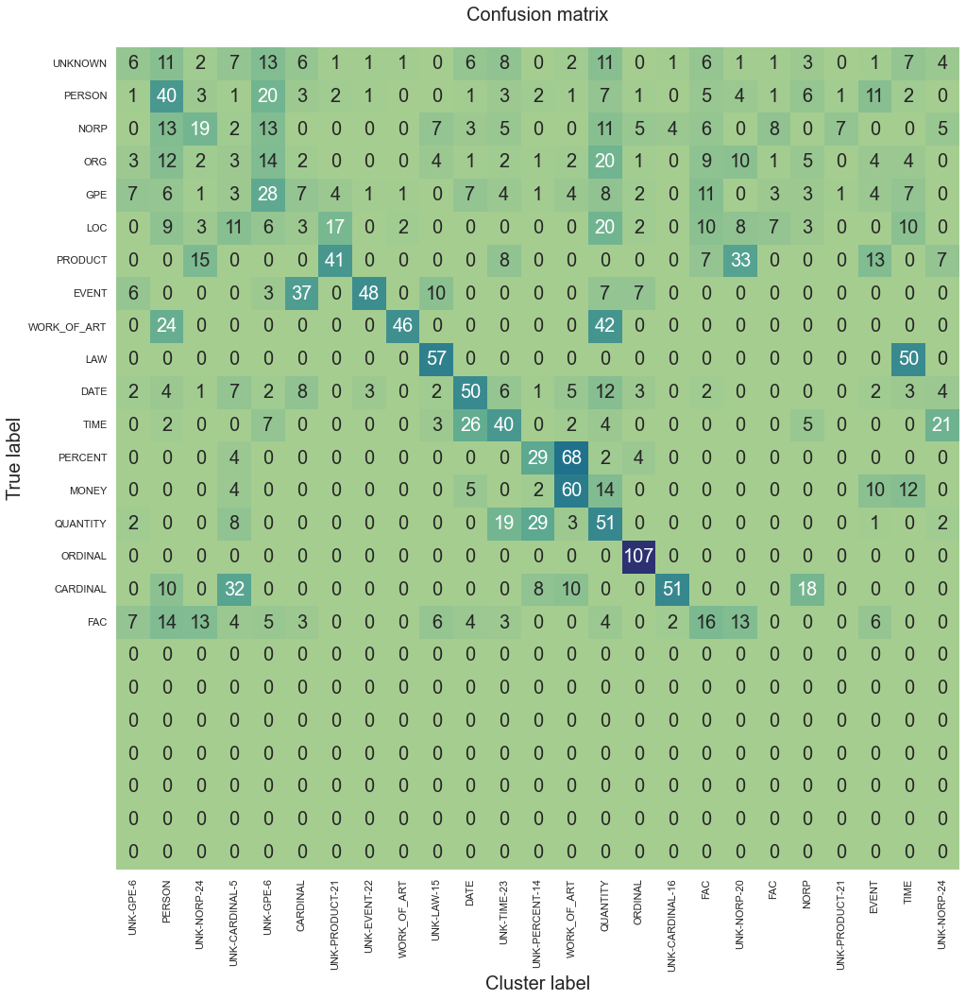

F1 score (macro) = 0.5505
Accuracy = 0.5080
Precision = 0.7829
Recall = 0.5043
New clusters =      4
... wrote results to c:\Users\Will\Projects\MSc\project\src\results\test-latent-15-ents-lw0.4-rw0.9-z-Kmeans\index.html
Finished 'evaluate_model' in 28.412 secs
--------------------------------------------------
29/9: test-latent-15-ents-lw0.4-rw1.0-z-Kmeans
--------------------------------------------------
{'train_size': 0, 'radius': 6, 'latent_weight': 0.4, 'reconstr_weight': 1.0, 'head': 'z'}
ERROR: Invalid config key <module 'tensorflow.keras' from 'c:\\Users\\Will\\Anaconda3\\envs\\tf-27\\lib\\site-packages\\keras\\api\\_v2\\keras\\__init__.py'>

F1 by Known Clusters: 0.3053


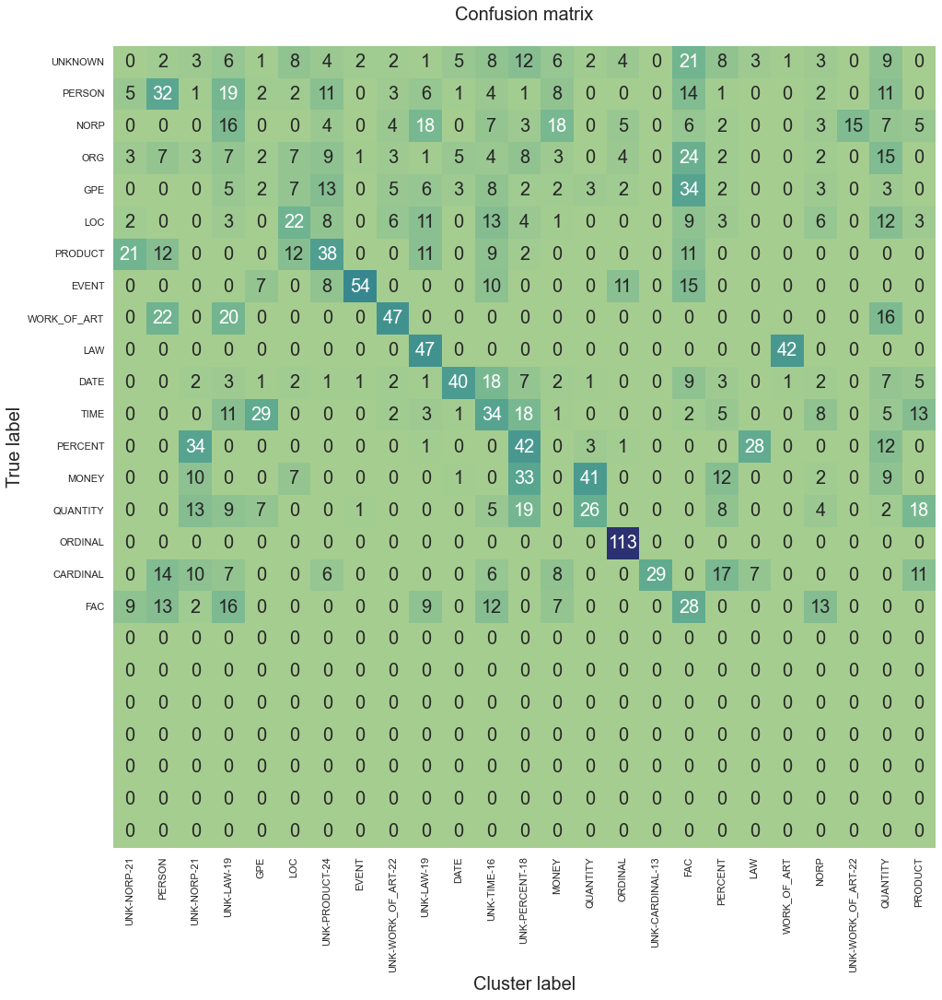

F1 score (macro) = 0.5464
Accuracy = 0.4775
Precision = 0.8942
Recall = 0.4813
New clusters =      3
... wrote results to c:\Users\Will\Projects\MSc\project\src\results\test-latent-15-ents-lw0.4-rw1.0-z-Kmeans\index.html
Finished 'evaluate_model' in 26.992 secs
--------------------------------------------------
30/9: test-latent-15-ents-lw0.5-rw0.8-z-Kmeans
--------------------------------------------------
{'train_size': 0, 'radius': 6, 'latent_weight': 0.5, 'reconstr_weight': 0.8, 'head': 'z'}
ERROR: Invalid config key <module 'tensorflow.keras' from 'c:\\Users\\Will\\Anaconda3\\envs\\tf-27\\lib\\site-packages\\keras\\api\\_v2\\keras\\__init__.py'>

F1 by Known Clusters: 0.3889


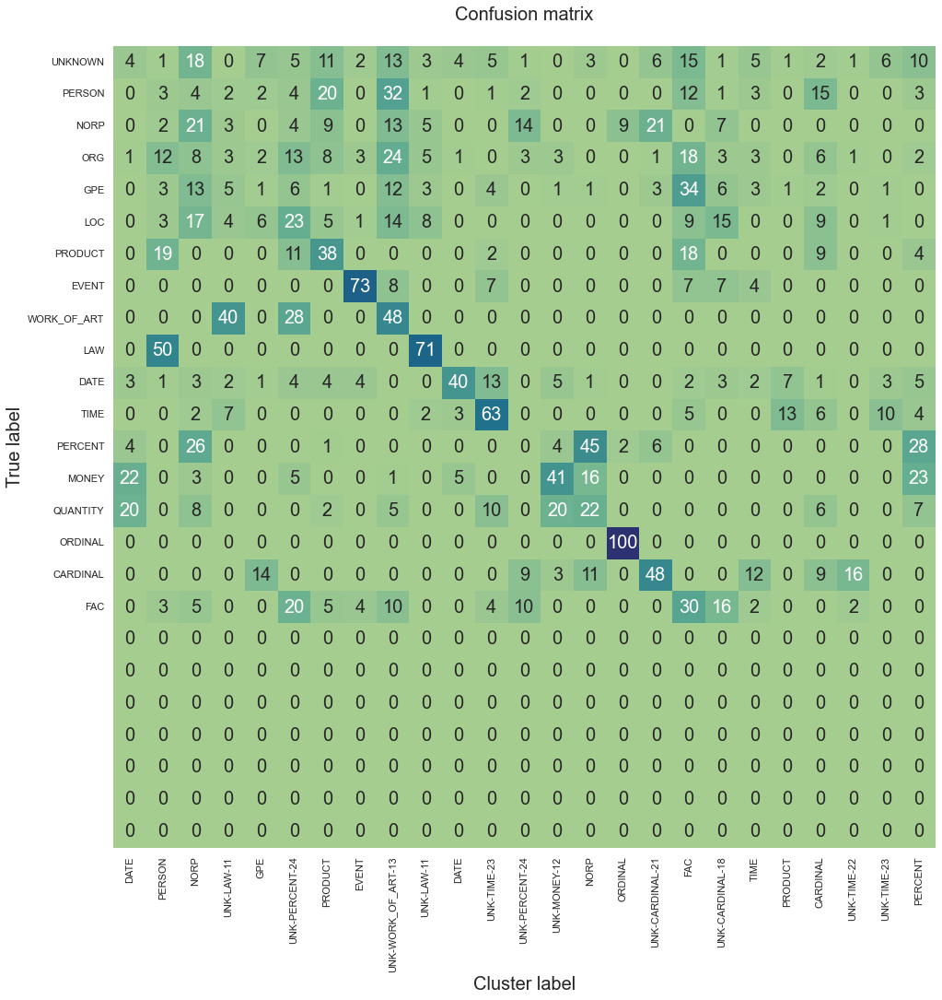

F1 score (macro) = 0.5383
Accuracy = 0.5145
Precision = 0.7841
Recall = 0.5049
New clusters =      3
... wrote results to c:\Users\Will\Projects\MSc\project\src\results\test-latent-15-ents-lw0.5-rw0.8-z-Kmeans\index.html
Finished 'evaluate_model' in 26.644 secs
--------------------------------------------------
31/9: test-latent-15-ents-lw0.5-rw0.9-z-Kmeans
--------------------------------------------------
{'train_size': 0, 'radius': 6, 'latent_weight': 0.5, 'reconstr_weight': 0.9, 'head': 'z'}
ERROR: Invalid config key <module 'tensorflow.keras' from 'c:\\Users\\Will\\Anaconda3\\envs\\tf-27\\lib\\site-packages\\keras\\api\\_v2\\keras\\__init__.py'>

F1 by Known Clusters: 0.3796


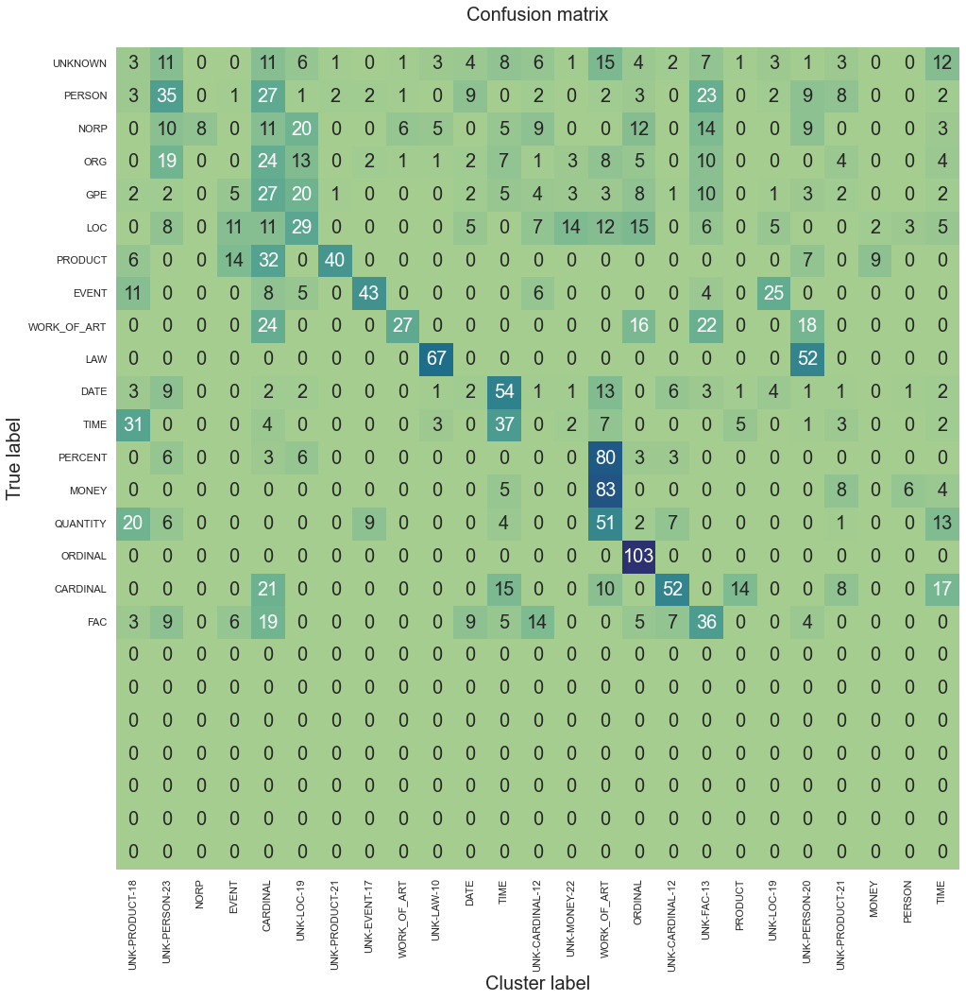

F1 score (macro) = 0.4953
Accuracy = 0.4625
Precision = 0.7271
Recall = 0.4606
New clusters =      3
... wrote results to c:\Users\Will\Projects\MSc\project\src\results\test-latent-15-ents-lw0.5-rw0.9-z-Kmeans\index.html
Finished 'evaluate_model' in 26.85 secs
--------------------------------------------------
32/9: test-latent-15-ents-lw0.5-rw1.0-z-Kmeans
--------------------------------------------------
{'train_size': 0, 'radius': 6, 'latent_weight': 0.5, 'reconstr_weight': 1.0, 'head': 'z'}
ERROR: Invalid config key <module 'tensorflow.keras' from 'c:\\Users\\Will\\Anaconda3\\envs\\tf-27\\lib\\site-packages\\keras\\api\\_v2\\keras\\__init__.py'>

F1 by Known Clusters: 0.2579


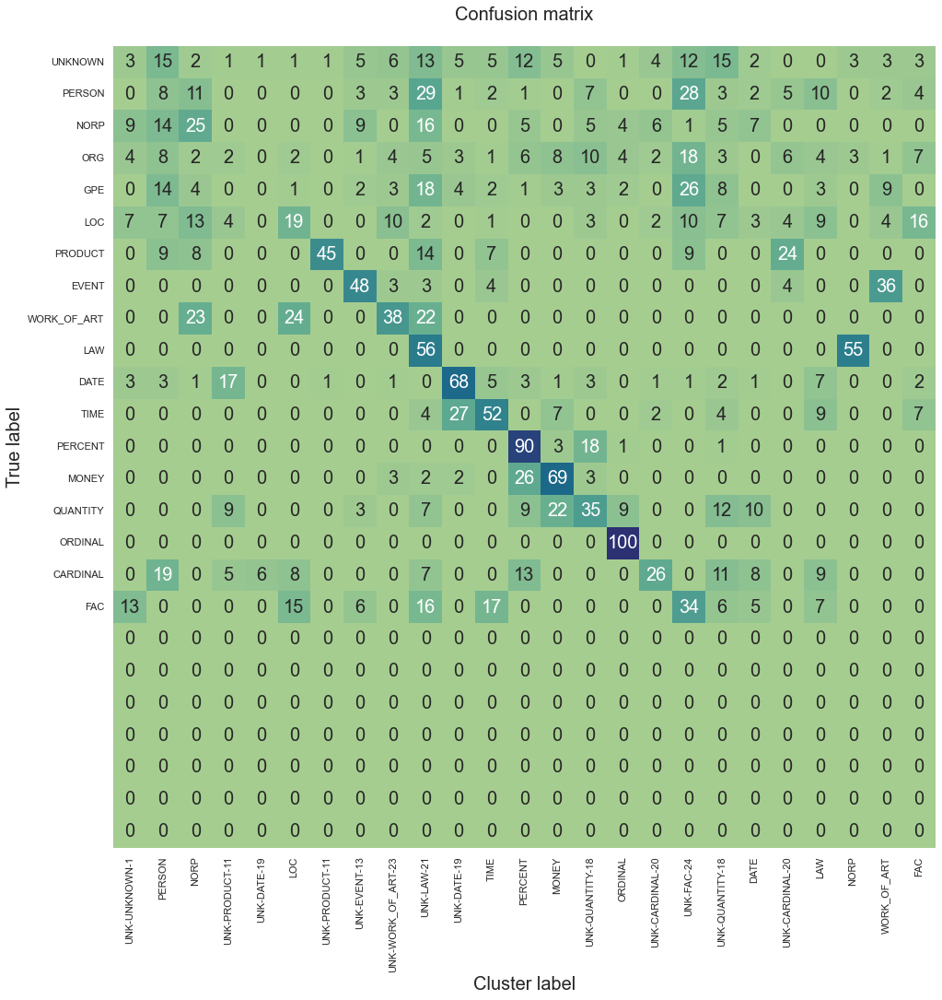

F1 score (macro) = 0.5702
Accuracy = 0.5170
Precision = 0.8394
Recall = 0.5193
New clusters =      4
... wrote results to c:\Users\Will\Projects\MSc\project\src\results\test-latent-15-ents-lw0.5-rw1.0-z-Kmeans\index.html
Finished 'evaluate_model' in 26.398 secs
--------------------------------------------------
33/9: test-latent-15-ents-lw1.0-rw0.8-z-Kmeans
--------------------------------------------------
{'train_size': 0, 'radius': 6, 'latent_weight': 1.0, 'reconstr_weight': 0.8, 'head': 'z'}
ERROR: Invalid config key <module 'tensorflow.keras' from 'c:\\Users\\Will\\Anaconda3\\envs\\tf-27\\lib\\site-packages\\keras\\api\\_v2\\keras\\__init__.py'>

F1 by Known Clusters: 0.2312


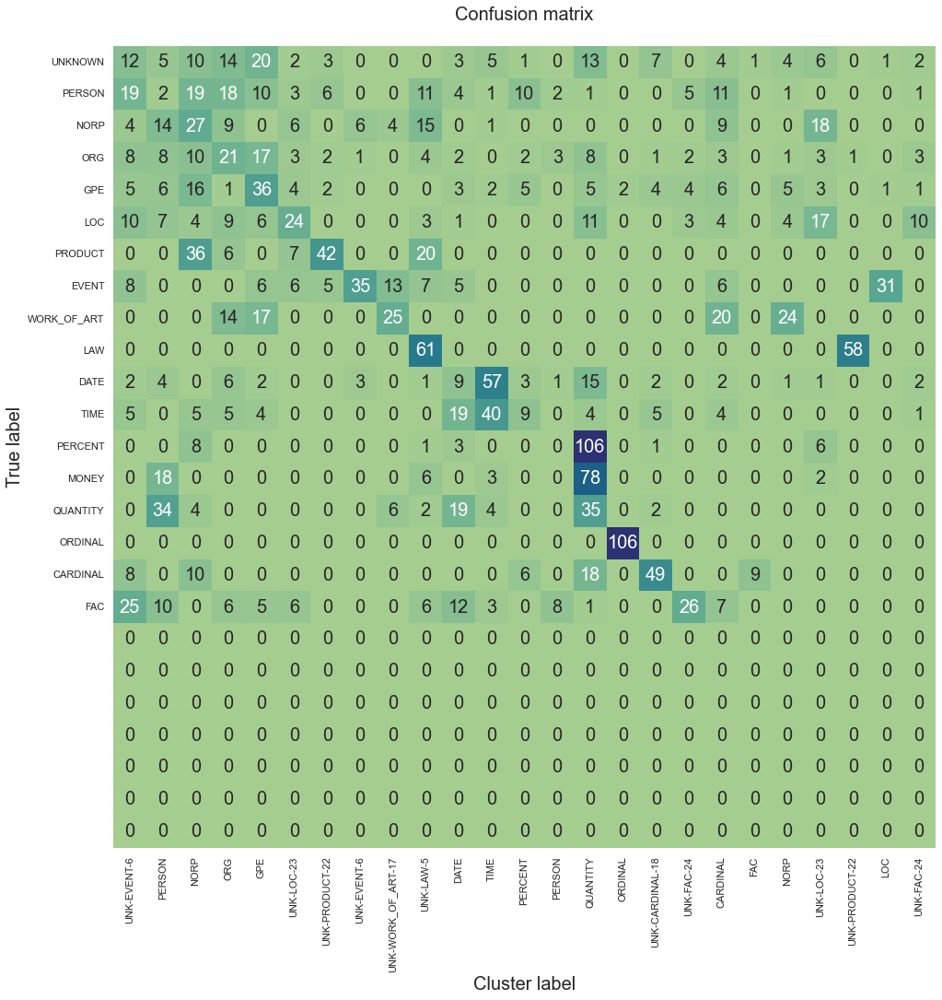

F1 score (macro) = 0.5586
Accuracy = 0.5015
Precision = 0.8945
Recall = 0.4981
New clusters =      4
... wrote results to c:\Users\Will\Projects\MSc\project\src\results\test-latent-15-ents-lw1.0-rw0.8-z-Kmeans\index.html
Finished 'evaluate_model' in 26.392 secs
--------------------------------------------------
34/9: test-latent-15-ents-lw1.0-rw0.9-z-Kmeans
--------------------------------------------------
{'train_size': 0, 'radius': 6, 'latent_weight': 1.0, 'reconstr_weight': 0.9, 'head': 'z'}
ERROR: Invalid config key <module 'tensorflow.keras' from 'c:\\Users\\Will\\Anaconda3\\envs\\tf-27\\lib\\site-packages\\keras\\api\\_v2\\keras\\__init__.py'>

F1 by Known Clusters: 0.3664


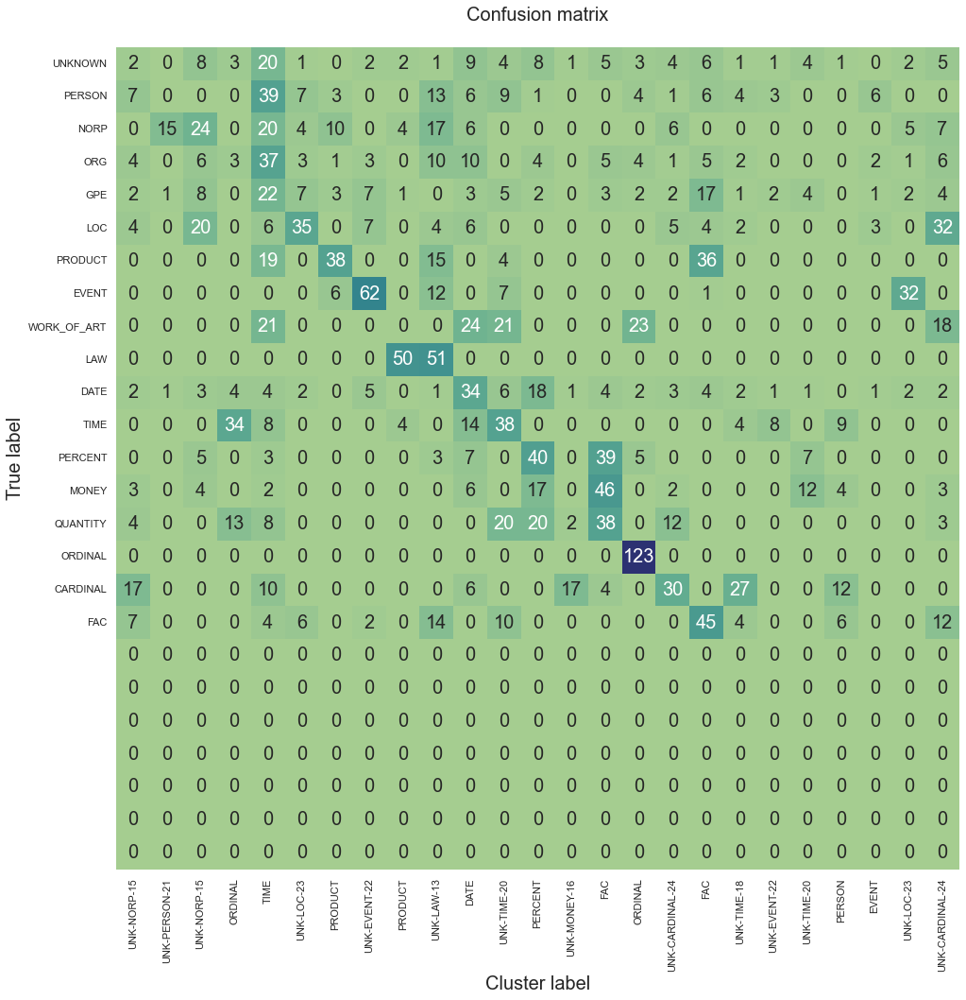

F1 score (macro) = 0.5208
Accuracy = 0.4800
Precision = 0.7268
Recall = 0.4773
New clusters =      4
... wrote results to c:\Users\Will\Projects\MSc\project\src\results\test-latent-15-ents-lw1.0-rw0.9-z-Kmeans\index.html
Finished 'evaluate_model' in 26.453 secs
--------------------------------------------------
35/9: test-latent-15-ents-lw1.0-rw1.0-z-Kmeans
--------------------------------------------------
{'train_size': 0, 'radius': 6, 'latent_weight': 1.0, 'reconstr_weight': 1.0, 'head': 'z'}
ERROR: Invalid config key <module 'tensorflow.keras' from 'c:\\Users\\Will\\Anaconda3\\envs\\tf-27\\lib\\site-packages\\keras\\api\\_v2\\keras\\__init__.py'>

F1 by Known Clusters: 0.2294


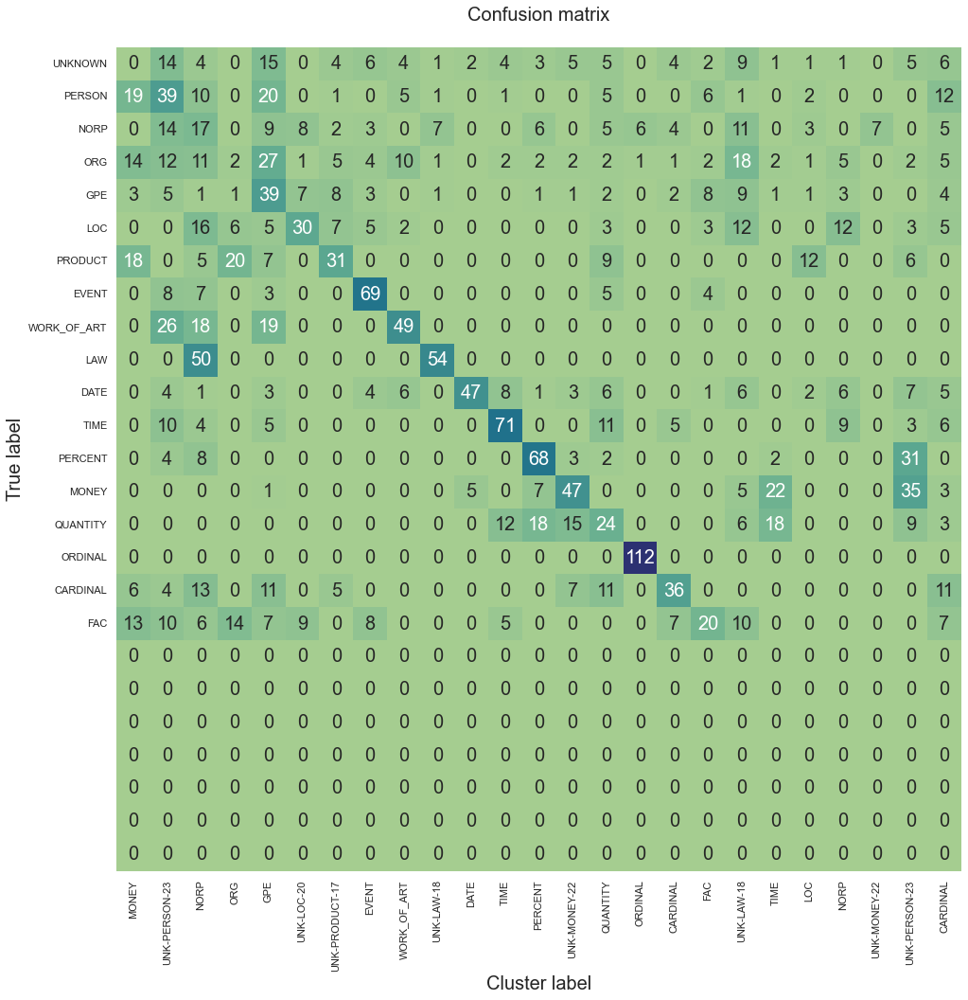

F1 score (macro) = 0.5947
Accuracy = 0.5195
Precision = 0.9495
Recall = 0.5248
New clusters =      6
... wrote results to c:\Users\Will\Projects\MSc\project\src\results\test-latent-15-ents-lw1.0-rw1.0-z-Kmeans\index.html
Finished 'evaluate_model' in 26.984 secs
--------------------------------------------------
36/9: test-latent-15-ents-lw0.4-rw0.8-z-Kmeans
--------------------------------------------------
{'train_size': 0, 'radius': 6, 'latent_weight': 0.4, 'reconstr_weight': 0.8, 'head': 'z'}
ERROR: Invalid config key <module 'tensorflow.keras' from 'c:\\Users\\Will\\Anaconda3\\envs\\tf-27\\lib\\site-packages\\keras\\api\\_v2\\keras\\__init__.py'>

F1 by Known Clusters: 0.2942


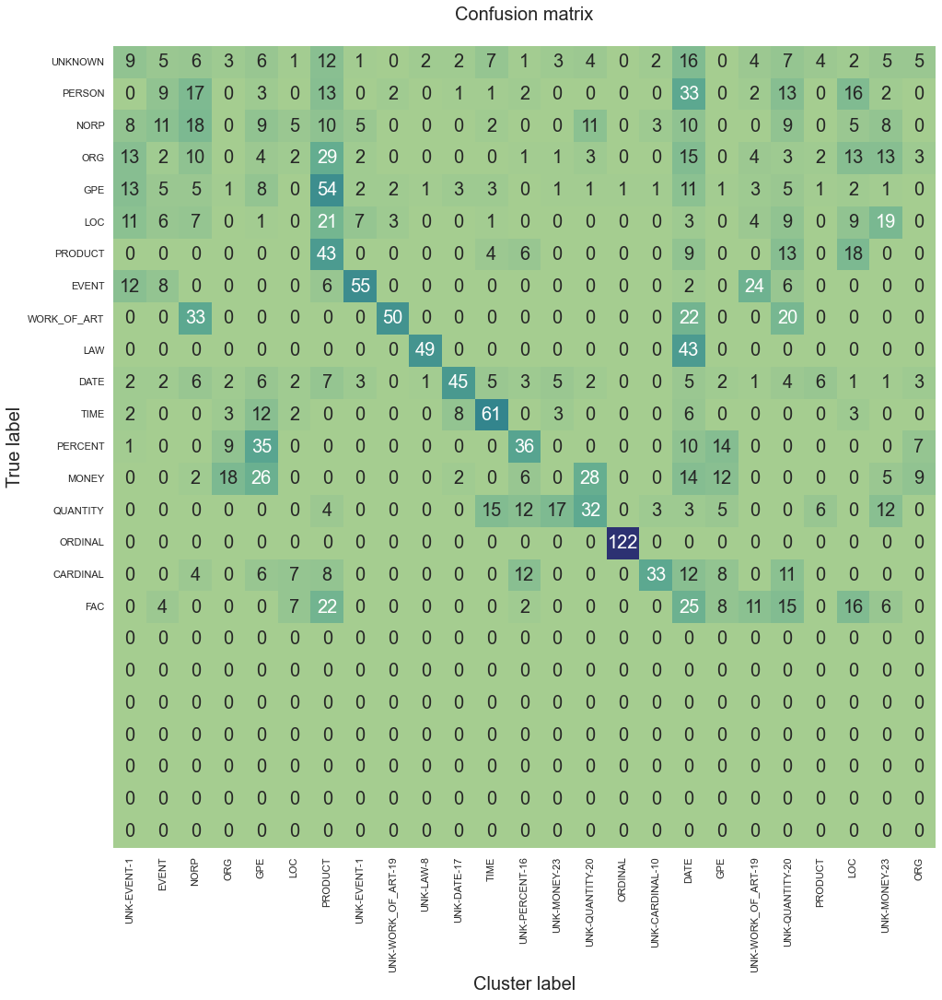

F1 score (macro) = 0.5166
Accuracy = 0.4655
Precision = 0.8384
Recall = 0.4680
New clusters =      6
... wrote results to c:\Users\Will\Projects\MSc\project\src\results\test-latent-15-ents-lw0.4-rw0.8-z-Kmeans\index.html
Finished 'evaluate_model' in 27.493 secs
--------------------------------------------------
37/9: test-latent-15-ents-lw0.4-rw0.9-z-Kmeans
--------------------------------------------------
{'train_size': 0, 'radius': 6, 'latent_weight': 0.4, 'reconstr_weight': 0.9, 'head': 'z'}
ERROR: Invalid config key <module 'tensorflow.keras' from 'c:\\Users\\Will\\Anaconda3\\envs\\tf-27\\lib\\site-packages\\keras\\api\\_v2\\keras\\__init__.py'>

F1 by Known Clusters: 0.1408


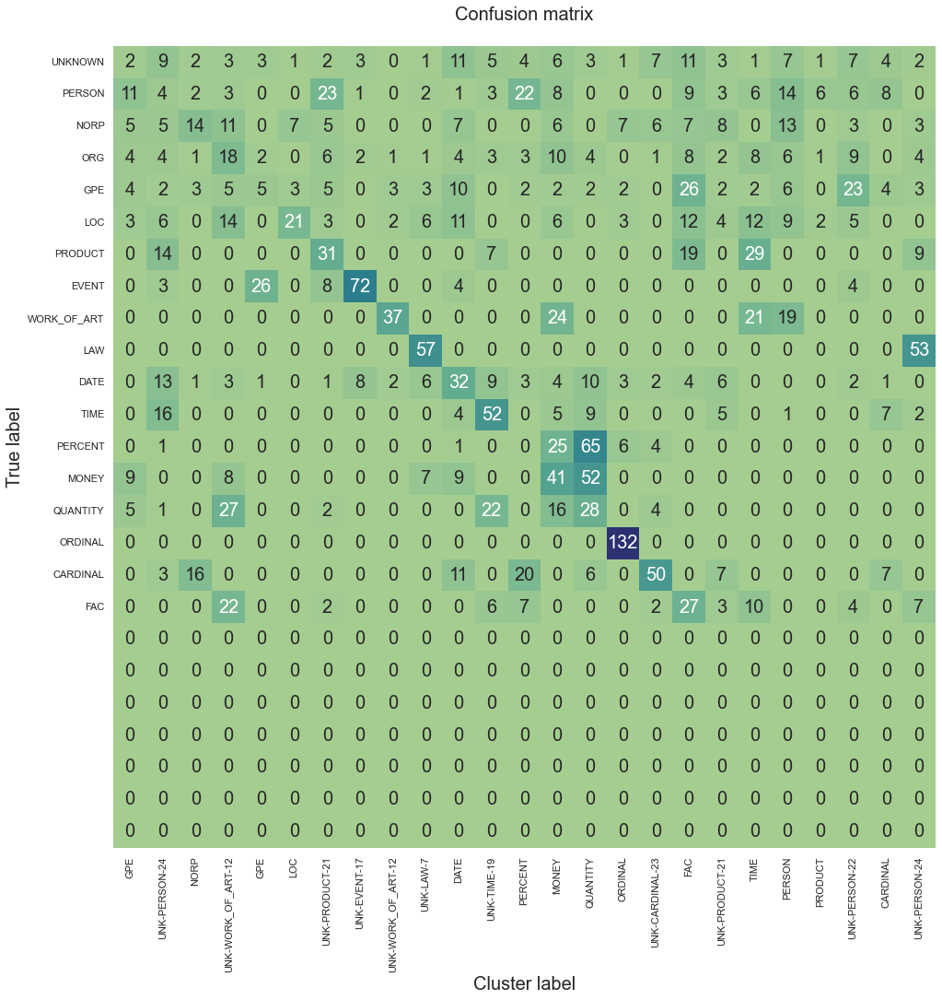

F1 score (macro) = 0.5496
Accuracy = 0.4900
Precision = 0.8938
Recall = 0.4877
New clusters =      4
... wrote results to c:\Users\Will\Projects\MSc\project\src\results\test-latent-15-ents-lw0.4-rw0.9-z-Kmeans\index.html
Finished 'evaluate_model' in 27.123 secs
--------------------------------------------------
38/9: test-latent-15-ents-lw0.4-rw1.0-z-Kmeans
--------------------------------------------------
{'train_size': 0, 'radius': 6, 'latent_weight': 0.4, 'reconstr_weight': 1.0, 'head': 'z'}
ERROR: Invalid config key <module 'tensorflow.keras' from 'c:\\Users\\Will\\Anaconda3\\envs\\tf-27\\lib\\site-packages\\keras\\api\\_v2\\keras\\__init__.py'>

F1 by Known Clusters: 0.2581


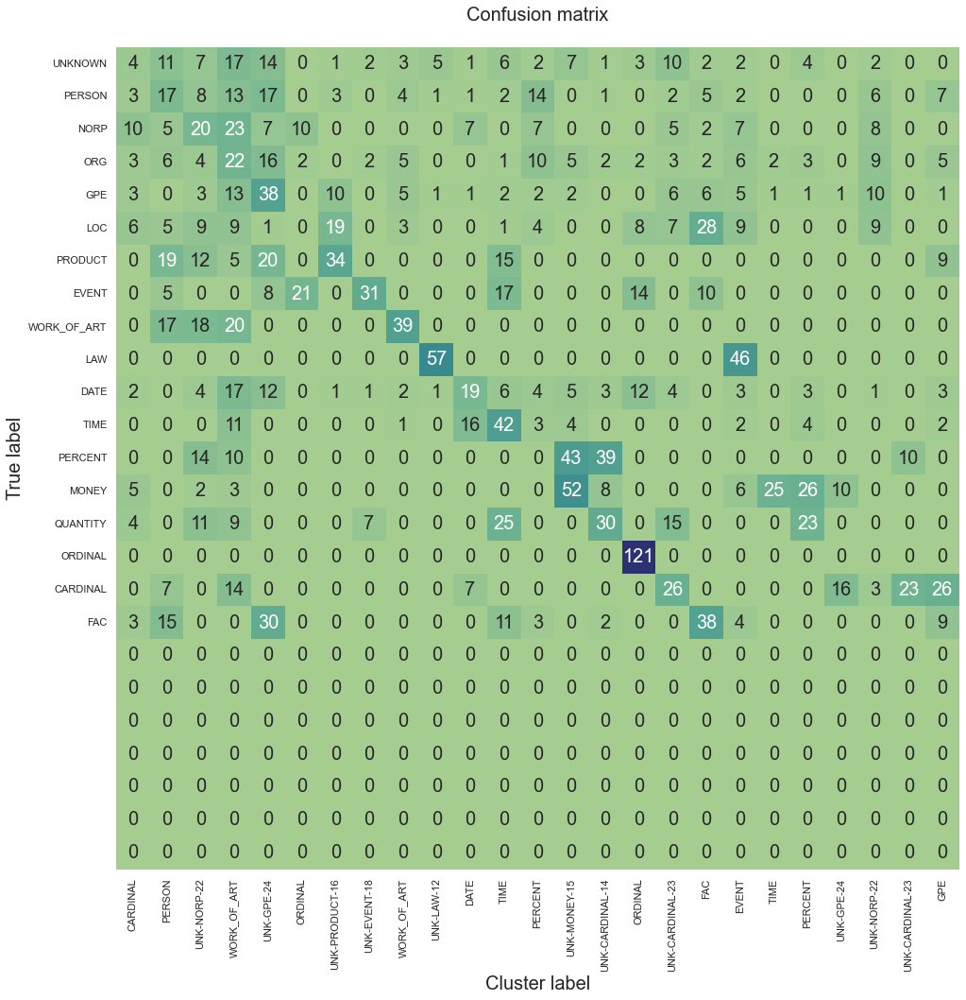

F1 score (macro) = 0.5117
Accuracy = 0.4595
Precision = 0.7827
Recall = 0.4586
New clusters =      5
... wrote results to c:\Users\Will\Projects\MSc\project\src\results\test-latent-15-ents-lw0.4-rw1.0-z-Kmeans\index.html
Finished 'evaluate_model' in 26.06 secs
--------------------------------------------------
39/9: test-latent-15-ents-lw0.5-rw0.8-z-Kmeans
--------------------------------------------------
{'train_size': 0, 'radius': 6, 'latent_weight': 0.5, 'reconstr_weight': 0.8, 'head': 'z'}
ERROR: Invalid config key <module 'tensorflow.keras' from 'c:\\Users\\Will\\Anaconda3\\envs\\tf-27\\lib\\site-packages\\keras\\api\\_v2\\keras\\__init__.py'>

F1 by Known Clusters: 0.2946


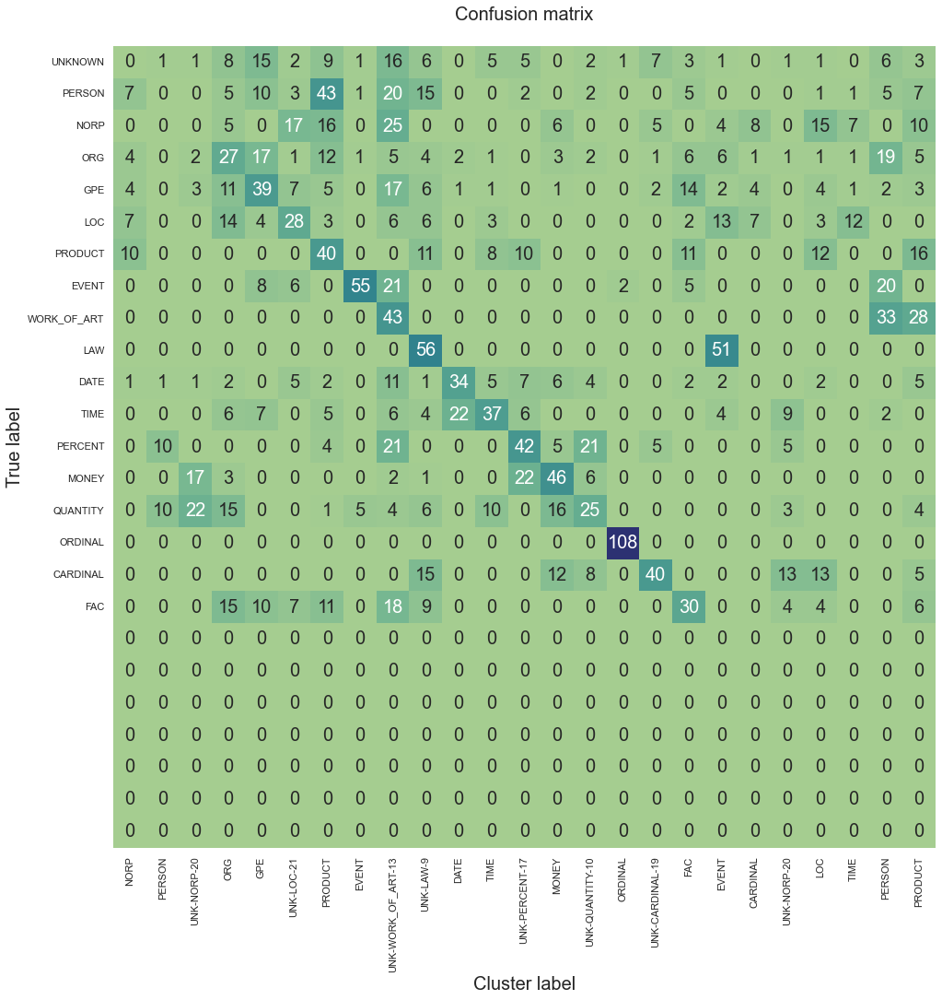

F1 score (macro) = 0.5624
Accuracy = 0.4745
Precision = 0.9490
Recall = 0.4883
New clusters =      5
... wrote results to c:\Users\Will\Projects\MSc\project\src\results\test-latent-15-ents-lw0.5-rw0.8-z-Kmeans\index.html
Finished 'evaluate_model' in 25.337 secs
--------------------------------------------------
40/9: test-latent-15-ents-lw0.5-rw0.9-z-Kmeans
--------------------------------------------------
{'train_size': 0, 'radius': 6, 'latent_weight': 0.5, 'reconstr_weight': 0.9, 'head': 'z'}
ERROR: Invalid config key <module 'tensorflow.keras' from 'c:\\Users\\Will\\Anaconda3\\envs\\tf-27\\lib\\site-packages\\keras\\api\\_v2\\keras\\__init__.py'>

F1 by Known Clusters: 0.4267


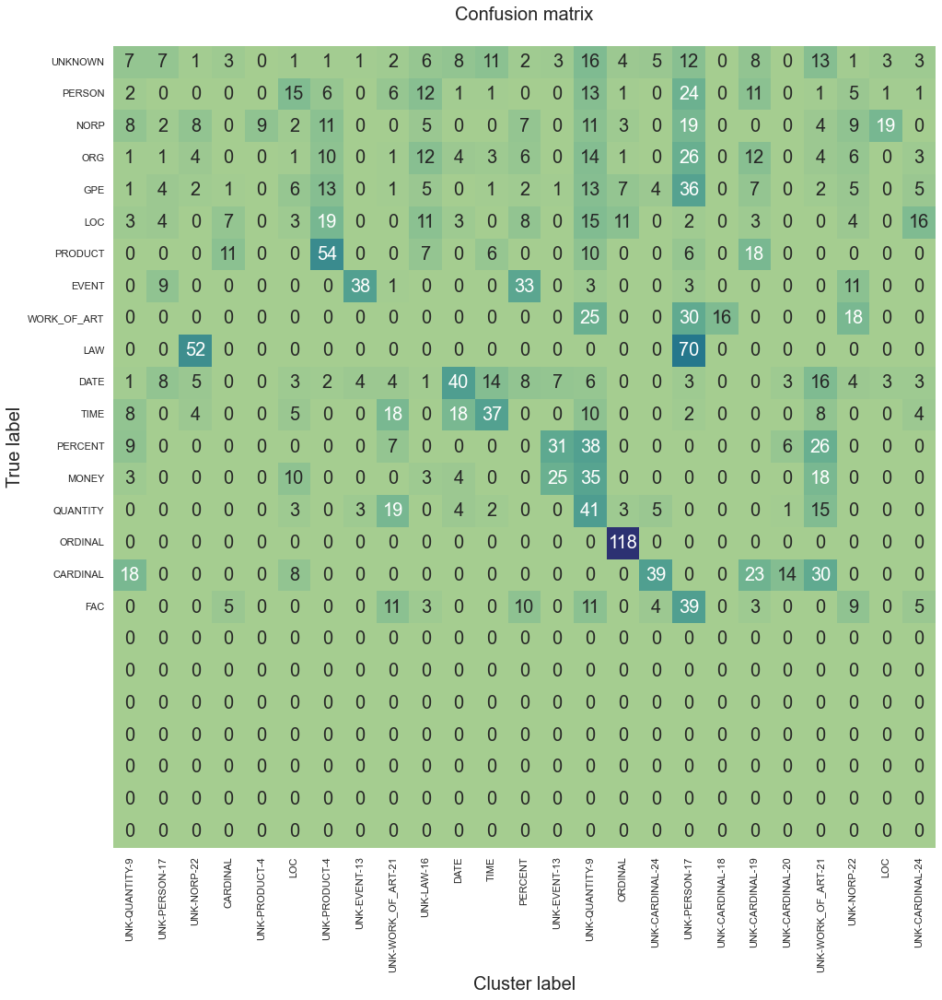

F1 score (macro) = 0.4741
Accuracy = 0.4500
Precision = 0.7276
Recall = 0.4381
New clusters =      4
... wrote results to c:\Users\Will\Projects\MSc\project\src\results\test-latent-15-ents-lw0.5-rw0.9-z-Kmeans\index.html
Finished 'evaluate_model' in 25.998 secs
--------------------------------------------------
41/9: test-latent-15-ents-lw0.5-rw1.0-z-Kmeans
--------------------------------------------------
{'train_size': 0, 'radius': 6, 'latent_weight': 0.5, 'reconstr_weight': 1.0, 'head': 'z'}
ERROR: Invalid config key <module 'tensorflow.keras' from 'c:\\Users\\Will\\Anaconda3\\envs\\tf-27\\lib\\site-packages\\keras\\api\\_v2\\keras\\__init__.py'>

F1 by Known Clusters: 0.3005


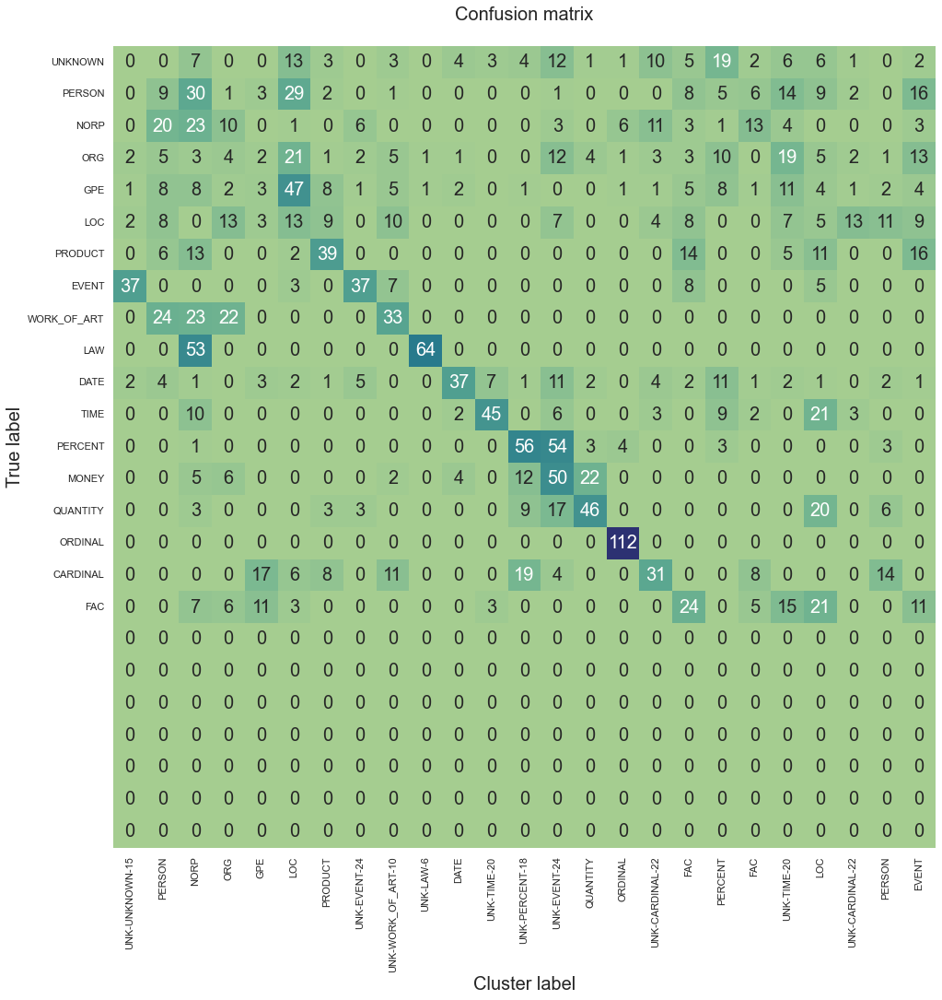

F1 score (macro) = 0.5454
Accuracy = 0.4880
Precision = 0.8939
Recall = 0.4934
New clusters =      4
... wrote results to c:\Users\Will\Projects\MSc\project\src\results\test-latent-15-ents-lw0.5-rw1.0-z-Kmeans\index.html
Finished 'evaluate_model' in 24.98 secs
--------------------------------------------------
42/9: test-latent-15-ents-lw1.0-rw0.8-z-Kmeans
--------------------------------------------------
{'train_size': 0, 'radius': 6, 'latent_weight': 1.0, 'reconstr_weight': 0.8, 'head': 'z'}
ERROR: Invalid config key <module 'tensorflow.keras' from 'c:\\Users\\Will\\Anaconda3\\envs\\tf-27\\lib\\site-packages\\keras\\api\\_v2\\keras\\__init__.py'>

F1 by Known Clusters: 0.2371


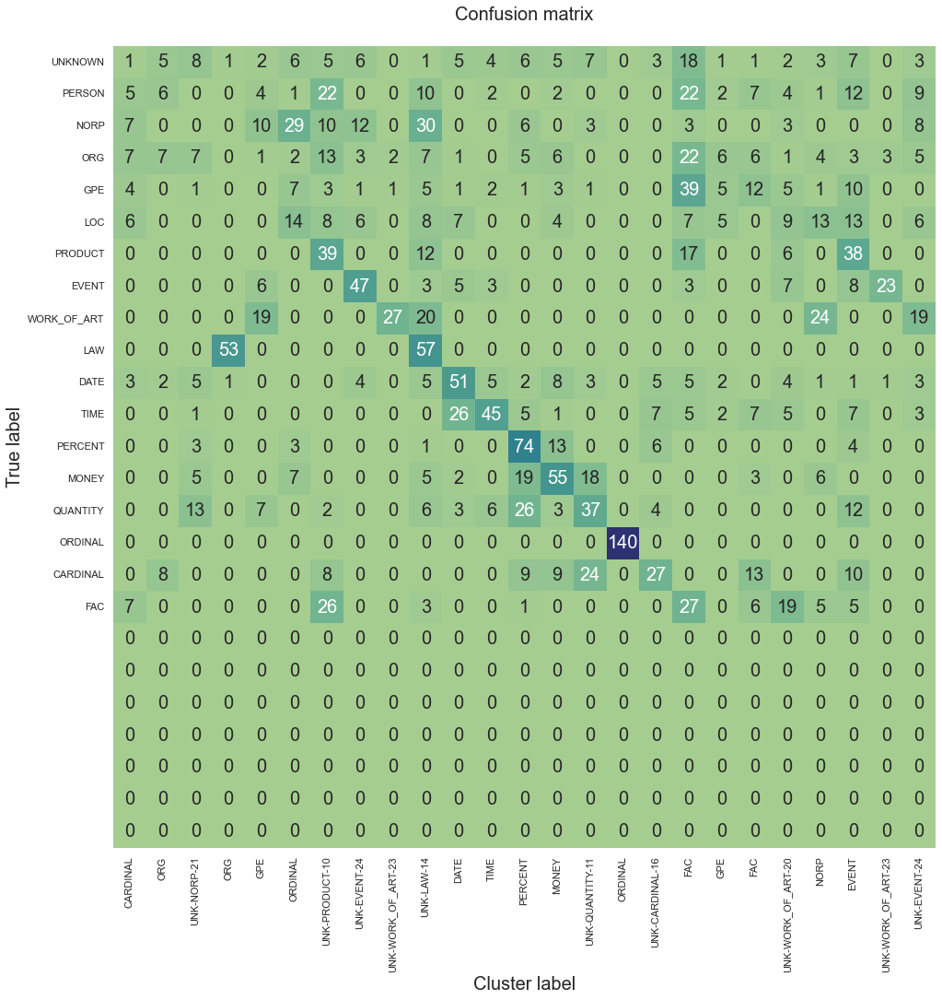

F1 score (macro) = 0.5545
Accuracy = 0.5045
Precision = 0.8384
Recall = 0.4992
New clusters =      6
... wrote results to c:\Users\Will\Projects\MSc\project\src\results\test-latent-15-ents-lw1.0-rw0.8-z-Kmeans\index.html
Finished 'evaluate_model' in 26.606 secs
--------------------------------------------------
43/9: test-latent-15-ents-lw1.0-rw0.9-z-Kmeans
--------------------------------------------------
{'train_size': 0, 'radius': 6, 'latent_weight': 1.0, 'reconstr_weight': 0.9, 'head': 'z'}
ERROR: Invalid config key <module 'tensorflow.keras' from 'c:\\Users\\Will\\Anaconda3\\envs\\tf-27\\lib\\site-packages\\keras\\api\\_v2\\keras\\__init__.py'>

F1 by Known Clusters: 0.2193


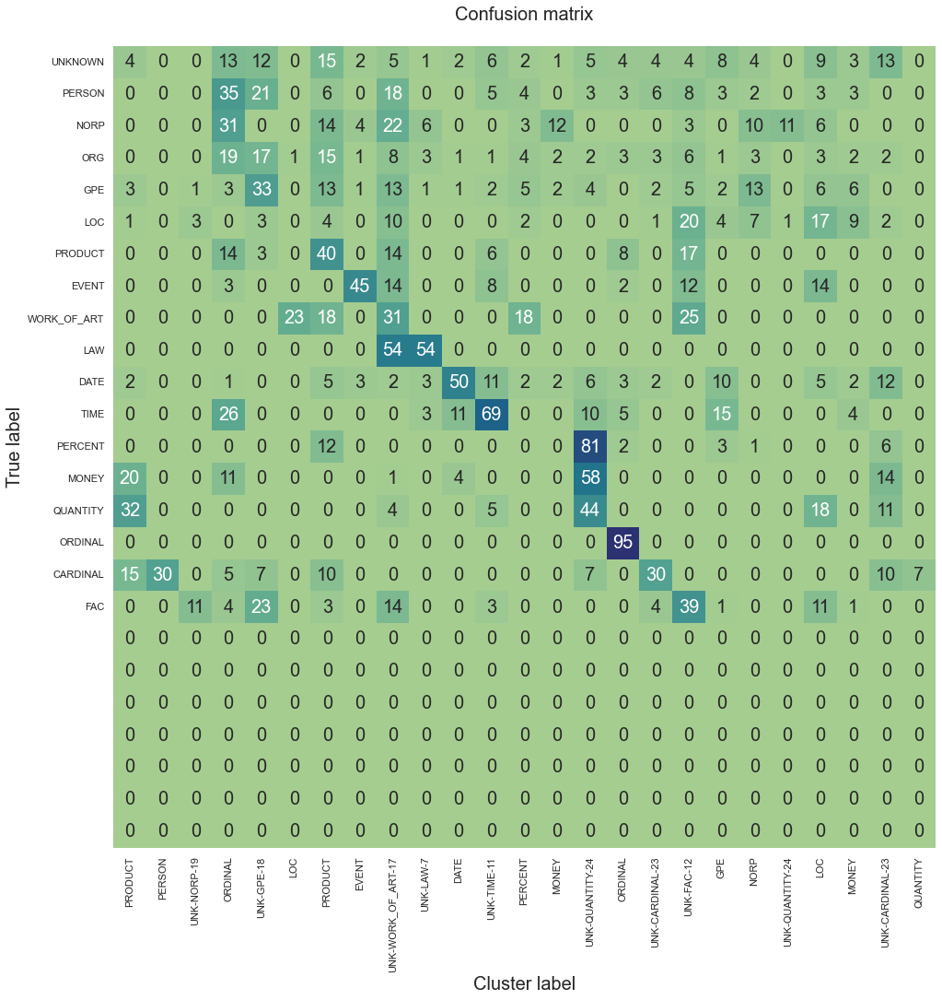

F1 score (macro) = 0.5438
Accuracy = 0.4775
Precision = 0.8945
Recall = 0.4736
New clusters =      3
... wrote results to c:\Users\Will\Projects\MSc\project\src\results\test-latent-15-ents-lw1.0-rw0.9-z-Kmeans\index.html
Finished 'evaluate_model' in 25.978 secs
--------------------------------------------------
44/9: test-latent-15-ents-lw1.0-rw1.0-z-Kmeans
--------------------------------------------------
{'train_size': 0, 'radius': 6, 'latent_weight': 1.0, 'reconstr_weight': 1.0, 'head': 'z'}
ERROR: Invalid config key <module 'tensorflow.keras' from 'c:\\Users\\Will\\Anaconda3\\envs\\tf-27\\lib\\site-packages\\keras\\api\\_v2\\keras\\__init__.py'>

F1 by Known Clusters: 0.2778


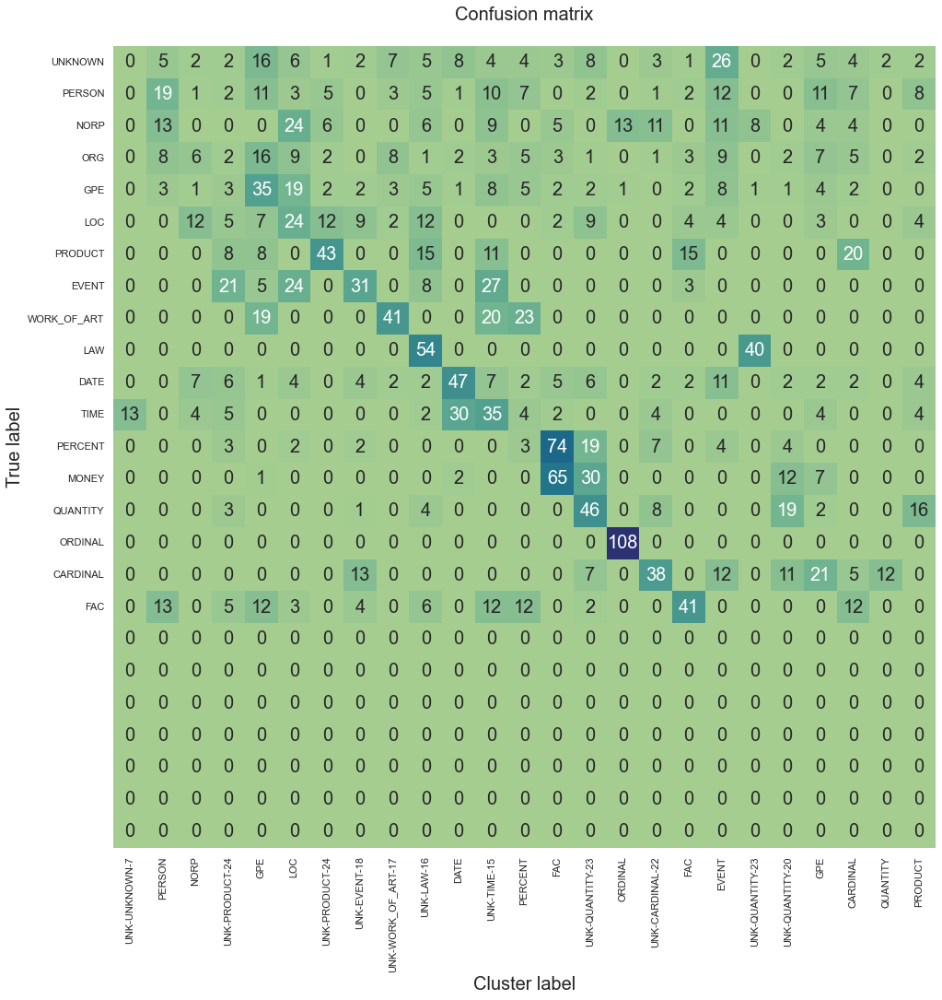

F1 score (macro) = 0.5378
Accuracy = 0.4755
Precision = 0.8390
Recall = 0.4789
New clusters =      5
... wrote results to c:\Users\Will\Projects\MSc\project\src\results\test-latent-15-ents-lw1.0-rw1.0-z-Kmeans\index.html
Finished 'evaluate_model' in 25.666 secs
Run Name                                 Runs       F1 avg       F1 Cluster   F1 Global    Precision    Recall      
test-latent-15-ents-lw0.4-rw0.8-z-Kmeans 5           0.4139       0.2833       0.5445      0.8162       0.4911      
test-latent-15-ents-lw0.4-rw0.9-z-Kmeans 5           0.3781       0.2065       0.5497      0.8720       0.4897      
test-latent-15-ents-lw0.4-rw1.0-z-Kmeans 5           0.4104       0.2766       0.5443      0.8275       0.4874      
test-latent-15-ents-lw0.5-rw0.8-z-Kmeans 5           0.4316       0.3180       0.5452      0.8274       0.4919      
test-latent-15-ents-lw0.5-rw0.9-z-Kmeans 5           0.4159       0.3220       0.5098      0.7944       0.4585      
test-latent-15-ents-lw0.5-rw1.0-z-Km

In [ ]:

def do_run(cfg, idx, total):
    run_name = (f"test-latent-15-ents-lw{cfg['latent_weight']}-"
               f"rw{cfg['reconstr_weight']}-"
               f"{cfg['head']}-Kmeans")
    print('-'*50)
    print(f"{idx}/{total}: {run_name}")
    print('-'*50)
    print(cfg)
    dc = DeepLatentCluster(run_name, {**cfg})
    
    score = dc.evaluate_model(
        run_name,
        sample_size=2000,
        verbose=0)
    score['run_name'] = run_name
    scores.append(score)

grid_search(config, do_run, 5)

summarise_scores(scores)


--------------------------------------------------
0: test-latent-15-ents-lw0.05-rw0.1-enc-Kmeans
--------------------------------------------------
{'train_size': 0, 'radius': 6, 'latent_weight': 0.05, 'reconstr_weight': 0.1, 'head': 'enc'}
ERROR: Invalid config key <module 'tensorflow.keras' from 'c:\\Users\\Will\\Anaconda3\\envs\\tf-27\\lib\\site-packages\\keras\\api\\_v2\\keras\\__init__.py'>

F1 by Known Clusters: 0.2227


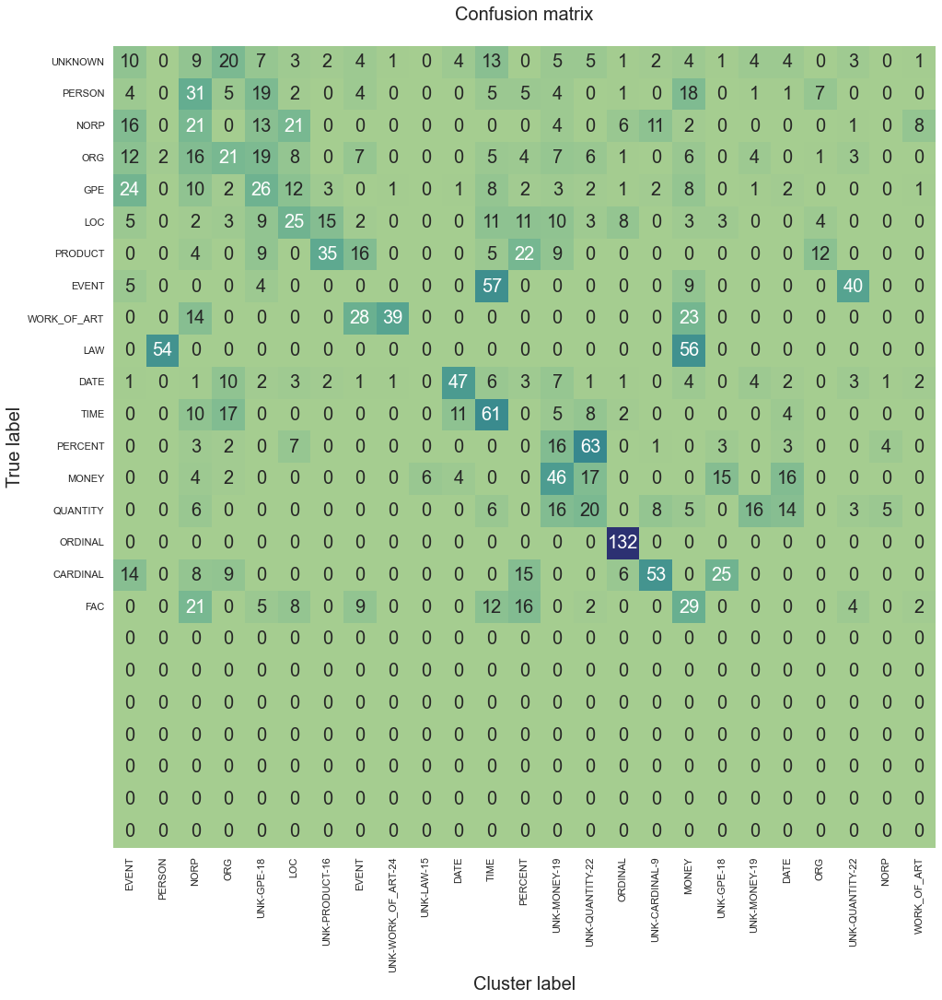

F1 score (macro) = 0.5582
Accuracy = 0.4970
Precision = 0.8940
Recall = 0.4917
New clusters = 0.0000
... wrote results to c:\Users\Will\Projects\MSc\project\src\results\test-latent-15-ents-lw0.05-rw0.1-enc-Kmeans\index.html
Finished 'evaluate_model' in 136.535 secs
--------------------------------------------------
0: test-latent-15-ents-lw0.05-rw0.1-enc-Kmeans
--------------------------------------------------
{'train_size': 0, 'radius': 6, 'latent_weight': 0.05, 'reconstr_weight': 0.1, 'head': 'enc'}
ERROR: Invalid config key <module 'tensorflow.keras' from 'c:\\Users\\Will\\Anaconda3\\envs\\tf-27\\lib\\site-packages\\keras\\api\\_v2\\keras\\__init__.py'>


In [ ]:
from grid_search import grid_search

scores = []
num_runs = 1
config = {
    'train_size': [0],
    "radius": [6],
    'latent_weight': [0.05, 0.1, 0.2, 0.5, 1.0],
    'reconstr_weight': [0.1, 0.25, 0.5, 0.75, 1.0],
    'head': ['enc'],
}


def do_run(cfg, idx, n_runs):
    for n in range(n_runs):
        run_name = (f"test-latent-15-ents-lw{cfg['latent_weight']}-"
                f"rw{cfg['reconstr_weight']}-"
                f"{cfg['head']}-Kmeans")
        print('-'*50)
        print(f"{idx}: {run_name}")
        print('-'*50)
        print(cfg)
        dc = DeepLatentCluster(
            run_name,
            {
                **cfg,
            })
        # dc.make_model(1)
        # dc.train_model(verbose=0)
        score = dc.evaluate_model(
            run_name,
            sample_size=2000,
            verbose=0)
        score['run_name'] = run_name
        scores.append(score)

grid_search(config, do_run)



summarise_scores(scores)


# All together

--------------------------------------------------
0: test-latent-15-ents-train_size=0-radius=6-latent_weight=0.9-reconstr_weight=0.65-head=enc-cluster=OPTICS-noise_factor=0.5-
--------------------------------------------------
{'train_size': 0, 'radius': 6, 'latent_weight': 0.9, 'reconstr_weight': 0.65, 'head': 'enc', 'cluster': 'OPTICS', 'noise_factor': 0.5}
Autoencoder
Latent Model
model compiled
Epoch 206: early stopping


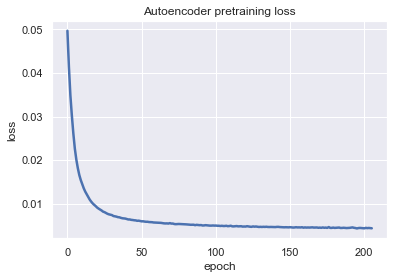

Iter: 7999 loss=1277.839599609375


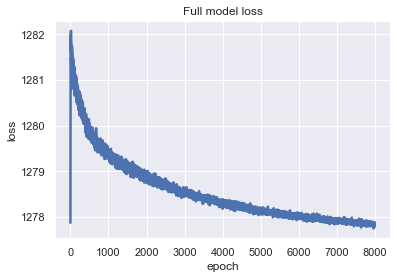

Training Done

F1 by Known Clusters: 0.3754
F1 score (macro) = 0.7435
Accuracy = 0.7483
Precision = 0.9546
Recall = 0.7396
... wrote results to c:\Users\Will\Projects\MSc\project\src\results\test-latent-15-ents-train_size=0-radius=6-latent_weight=0.9-reconstr_weight=0.65-head=enc-cluster=OPTICS-noise_factor=0.5-\index.html
Finished 'evaluate_model' in 284.018 secs
--------------------------------------------------
1: test-latent-15-ents-train_size=0-radius=6-latent_weight=0.9-reconstr_weight=0.75-head=enc-cluster=OPTICS-noise_factor=0.5-
--------------------------------------------------
{'train_size': 0, 'radius': 6, 'latent_weight': 0.9, 'reconstr_weight': 0.75, 'head': 'enc', 'cluster': 'OPTICS', 'noise_factor': 0.5}
Autoencoder
Latent Model
model compiled
Epoch 149: early stopping


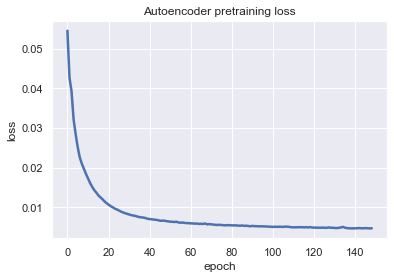

Iter: 7999 loss=1278.15380859375


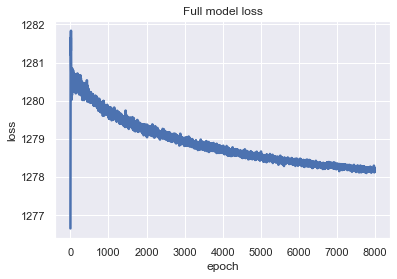

Training Done

F1 by Known Clusters: 0.3712
F1 score (macro) = 0.7571
Accuracy = 0.7583
Precision = 0.9557
Recall = 0.7465
... wrote results to c:\Users\Will\Projects\MSc\project\src\results\test-latent-15-ents-train_size=0-radius=6-latent_weight=0.9-reconstr_weight=0.75-head=enc-cluster=OPTICS-noise_factor=0.5-\index.html
Finished 'evaluate_model' in 286.612 secs
--------------------------------------------------
2: test-latent-15-ents-train_size=0-radius=6-latent_weight=0.9-reconstr_weight=0.85-head=enc-cluster=OPTICS-noise_factor=0.5-
--------------------------------------------------
{'train_size': 0, 'radius': 6, 'latent_weight': 0.9, 'reconstr_weight': 0.85, 'head': 'enc', 'cluster': 'OPTICS', 'noise_factor': 0.5}
Autoencoder
Latent Model
model compiled
Epoch 148: early stopping


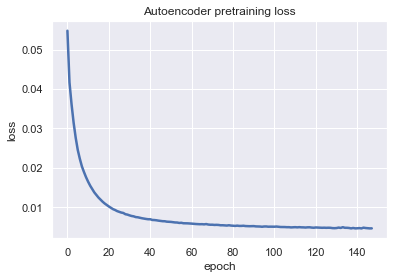

Iter: 7999 loss=1278.4287109375


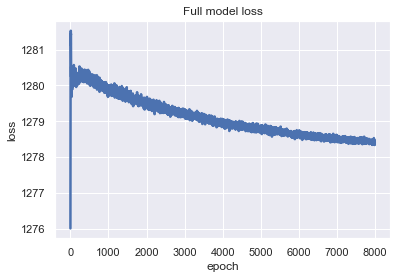

Training Done

F1 by Known Clusters: 0.3778
F1 score (macro) = 0.7416
Accuracy = 0.7353
Precision = 0.9536
Recall = 0.7402
... wrote results to c:\Users\Will\Projects\MSc\project\src\results\test-latent-15-ents-train_size=0-radius=6-latent_weight=0.9-reconstr_weight=0.85-head=enc-cluster=OPTICS-noise_factor=0.5-\index.html
Finished 'evaluate_model' in 288.001 secs
--------------------------------------------------
3: test-latent-15-ents-train_size=0-radius=6-latent_weight=1.0-reconstr_weight=0.65-head=enc-cluster=OPTICS-noise_factor=0.5-
--------------------------------------------------
{'train_size': 0, 'radius': 6, 'latent_weight': 1.0, 'reconstr_weight': 0.65, 'head': 'enc', 'cluster': 'OPTICS', 'noise_factor': 0.5}
Autoencoder
Latent Model
model compiled
Epoch 151: early stopping


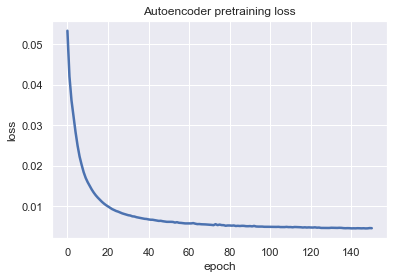

Iter: 7999 loss=1420.0714111328125


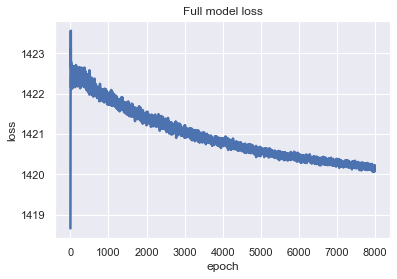

Training Done

F1 by Known Clusters: 0.3507
F1 score (macro) = 0.7547
Accuracy = 0.7500
Precision = 0.8991
Recall = 0.7451
... wrote results to c:\Users\Will\Projects\MSc\project\src\results\test-latent-15-ents-train_size=0-radius=6-latent_weight=1.0-reconstr_weight=0.65-head=enc-cluster=OPTICS-noise_factor=0.5-\index.html
Finished 'evaluate_model' in 287.737 secs
--------------------------------------------------
4: test-latent-15-ents-train_size=0-radius=6-latent_weight=1.0-reconstr_weight=0.75-head=enc-cluster=OPTICS-noise_factor=0.5-
--------------------------------------------------
{'train_size': 0, 'radius': 6, 'latent_weight': 1.0, 'reconstr_weight': 0.75, 'head': 'enc', 'cluster': 'OPTICS', 'noise_factor': 0.5}
Autoencoder
Latent Model
model compiled
Epoch 155: early stopping


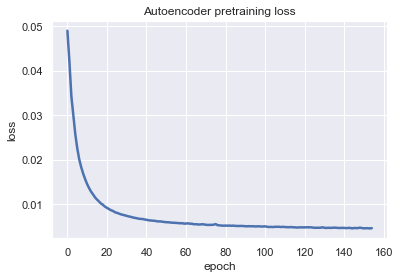

Iter: 7999 loss=1420.0474853515625


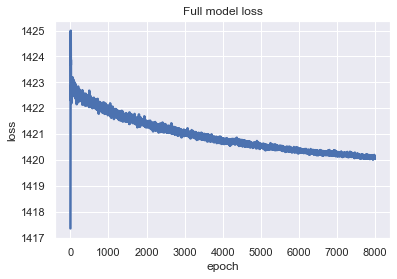

Training Done

F1 by Known Clusters: 0.3604
F1 score (macro) = 0.7372
Accuracy = 0.7423
Precision = 0.9539
Recall = 0.7357
... wrote results to c:\Users\Will\Projects\MSc\project\src\results\test-latent-15-ents-train_size=0-radius=6-latent_weight=1.0-reconstr_weight=0.75-head=enc-cluster=OPTICS-noise_factor=0.5-\index.html
Finished 'evaluate_model' in 284.468 secs
--------------------------------------------------
5: test-latent-15-ents-train_size=0-radius=6-latent_weight=1.0-reconstr_weight=0.85-head=enc-cluster=OPTICS-noise_factor=0.5-
--------------------------------------------------
{'train_size': 0, 'radius': 6, 'latent_weight': 1.0, 'reconstr_weight': 0.85, 'head': 'enc', 'cluster': 'OPTICS', 'noise_factor': 0.5}
Autoencoder
Latent Model
model compiled
Epoch 146: early stopping


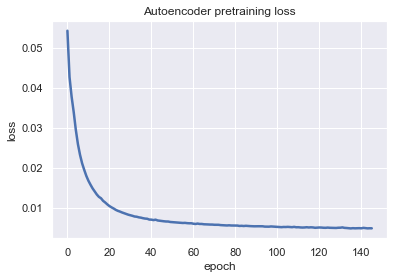

Iter: 7999 loss=1420.7235107421875


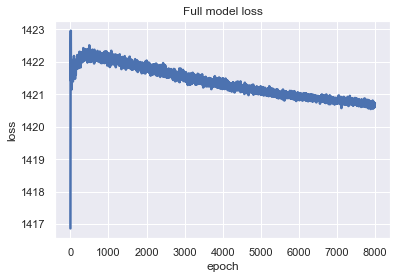

Training Done

F1 by Known Clusters: 0.3640
F1 score (macro) = 0.7574
Accuracy = 0.7480
Precision = 0.9556
Recall = 0.7519
... wrote results to c:\Users\Will\Projects\MSc\project\src\results\test-latent-15-ents-train_size=0-radius=6-latent_weight=1.0-reconstr_weight=0.85-head=enc-cluster=OPTICS-noise_factor=0.5-\index.html
Finished 'evaluate_model' in 286.239 secs
--------------------------------------------------
6: test-latent-15-ents-train_size=0-radius=6-latent_weight=1.1-reconstr_weight=0.65-head=enc-cluster=OPTICS-noise_factor=0.5-
--------------------------------------------------
{'train_size': 0, 'radius': 6, 'latent_weight': 1.1, 'reconstr_weight': 0.65, 'head': 'enc', 'cluster': 'OPTICS', 'noise_factor': 0.5}
Autoencoder
Latent Model
model compiled
Epoch 127: early stopping


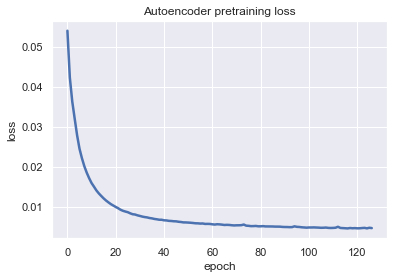

Iter: 7999 loss=1562.3958740234375


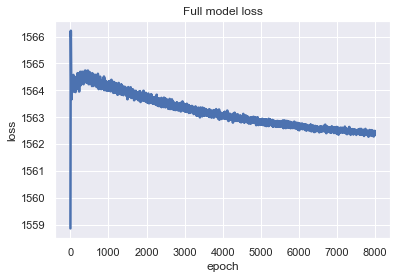

Training Done

F1 by Known Clusters: 0.3596
F1 score (macro) = 0.7349
Accuracy = 0.7290
Precision = 0.8990
Recall = 0.7313
... wrote results to c:\Users\Will\Projects\MSc\project\src\results\test-latent-15-ents-train_size=0-radius=6-latent_weight=1.1-reconstr_weight=0.65-head=enc-cluster=OPTICS-noise_factor=0.5-\index.html
Finished 'evaluate_model' in 291.014 secs
--------------------------------------------------
7: test-latent-15-ents-train_size=0-radius=6-latent_weight=1.1-reconstr_weight=0.75-head=enc-cluster=OPTICS-noise_factor=0.5-
--------------------------------------------------
{'train_size': 0, 'radius': 6, 'latent_weight': 1.1, 'reconstr_weight': 0.75, 'head': 'enc', 'cluster': 'OPTICS', 'noise_factor': 0.5}
Autoencoder
Latent Model
model compiled
Epoch 168: early stopping


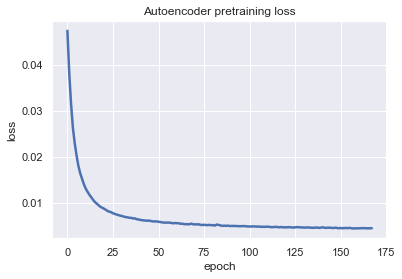

Iter: 7999 loss=1562.067138671875


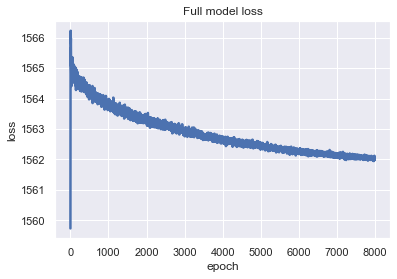

Training Done

F1 by Known Clusters: 0.3543
F1 score (macro) = 0.7314
Accuracy = 0.7230
Precision = 0.9533
Recall = 0.7309
... wrote results to c:\Users\Will\Projects\MSc\project\src\results\test-latent-15-ents-train_size=0-radius=6-latent_weight=1.1-reconstr_weight=0.75-head=enc-cluster=OPTICS-noise_factor=0.5-\index.html
Finished 'evaluate_model' in 289.042 secs
--------------------------------------------------
8: test-latent-15-ents-train_size=0-radius=6-latent_weight=1.1-reconstr_weight=0.85-head=enc-cluster=OPTICS-noise_factor=0.5-
--------------------------------------------------
{'train_size': 0, 'radius': 6, 'latent_weight': 1.1, 'reconstr_weight': 0.85, 'head': 'enc', 'cluster': 'OPTICS', 'noise_factor': 0.5}
Autoencoder
Latent Model
model compiled
Epoch 183: early stopping


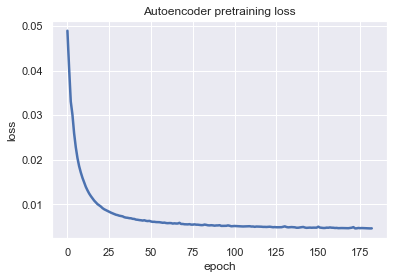

Iter: 7999 loss=1561.980712890625


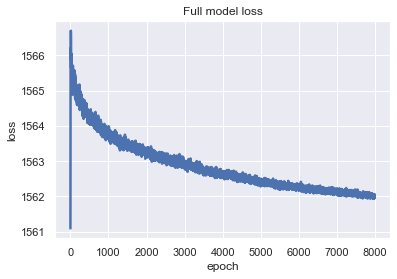

Training Done

F1 by Known Clusters: 0.3502
F1 score (macro) = 0.7405
Accuracy = 0.7360
Precision = 0.8989
Recall = 0.7340
... wrote results to c:\Users\Will\Projects\MSc\project\src\results\test-latent-15-ents-train_size=0-radius=6-latent_weight=1.1-reconstr_weight=0.85-head=enc-cluster=OPTICS-noise_factor=0.5-\index.html
Finished 'evaluate_model' in 287.312 secs


In [ ]:
from grid_search import grid_search

scores = []
num_runs = 1
config = {
    'train_size': [0],
    "radius": [6],
    'latent_weight': [0.9, 1.0, 1.1],
    'reconstr_weight': [0.65,0.75,0.85],
    'head': ['enc'],
    'cluster': ['OPTICS'],
    'noise_factor': [0.5]
}

grid_search(config, do_run)

In [ ]:
summarise_scores(scores)

Run Name                                 Runs       F1 avg       F1 Cluster   F1 Global    Precision    Recall      
test-latent-15-ents-train_size=0-radius=6-latent_weight=0.9-reconstr_weight=0.65-head=enc-cluster=OPTICS-noise_factor=0.5- 1           0.5595       0.3754       0.7435      0.9546       0.7396      
test-latent-15-ents-train_size=0-radius=6-latent_weight=0.9-reconstr_weight=0.75-head=enc-cluster=OPTICS-noise_factor=0.5- 1           0.5642       0.3712       0.7571      0.9557       0.7465      
test-latent-15-ents-train_size=0-radius=6-latent_weight=0.9-reconstr_weight=0.85-head=enc-cluster=OPTICS-noise_factor=0.5- 1           0.5597       0.3778       0.7416      0.9536       0.7402      
test-latent-15-ents-train_size=0-radius=6-latent_weight=1.0-reconstr_weight=0.65-head=enc-cluster=OPTICS-noise_factor=0.5- 1           0.5527       0.3507       0.7547      0.8991       0.7451      
test-latent-15-ents-train_size=0-radius=6-latent_weight=1.0-reconstr_weight=0.75-head=e

# Noise over best

--------------------------------------------------
0/7: test-train_size=0-radius=6-latent_weight=0.9-reconstr_weight=0.75-head=ae-cluster=OPTICS-noise_factor=0.0-
--------------------------------------------------
{'train_size': 0, 'radius': 6, 'latent_weight': 0.9, 'reconstr_weight': 0.75, 'head': 'ae', 'cluster': 'OPTICS', 'noise_factor': 0.0}
Autoencoder
Latent Model
model compiled
Epoch 158: early stopping


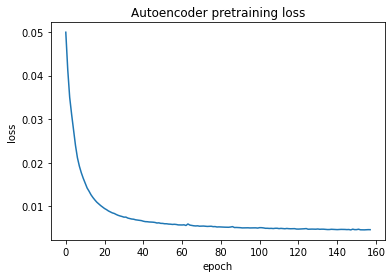

Stop traing for tolerance threshold reached
Iter: 5526 loss=1280.8306884765625


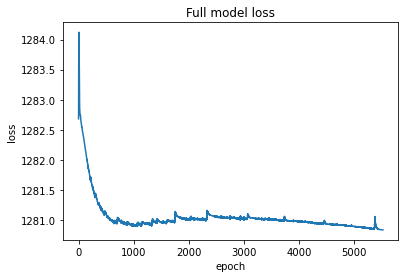

Training Done

F1 by Known Clusters: 0.3773
F1 score (macro) = 0.7374
Accuracy = 0.7287
Precision = 0.9538
Recall = 0.7317
... wrote results to c:\Users\Will\Projects\MSc\project\src\results\test-train_size=0-radius=6-latent_weight=0.9-reconstr_weight=0.75-head=ae-cluster=OPTICS-noise_factor=0.0-\index.html
Finished 'evaluate_model' in 235.27 secs
--------------------------------------------------
1/7: test-train_size=0-radius=6-latent_weight=0.9-reconstr_weight=0.75-head=ae-cluster=OPTICS-noise_factor=0.2-
--------------------------------------------------
{'train_size': 0, 'radius': 6, 'latent_weight': 0.9, 'reconstr_weight': 0.75, 'head': 'ae', 'cluster': 'OPTICS', 'noise_factor': 0.2}
Autoencoder
Latent Model
model compiled
Epoch 172: early stopping


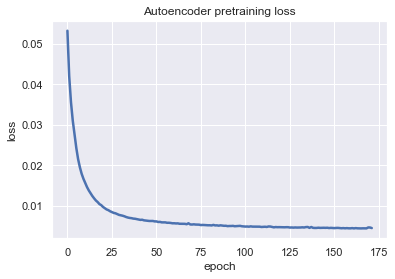

Iter: 7999 loss=1277.378662109375


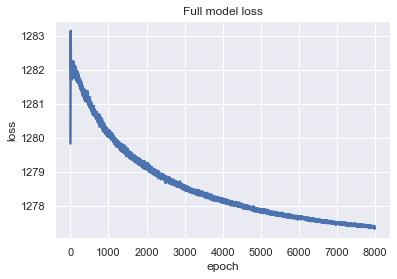

Training Done

F1 by Known Clusters: 0.3611
F1 score (macro) = 0.7476
Accuracy = 0.7463
Precision = 0.9532
Recall = 0.7421
... wrote results to c:\Users\Will\Projects\MSc\project\src\results\test-train_size=0-radius=6-latent_weight=0.9-reconstr_weight=0.75-head=ae-cluster=OPTICS-noise_factor=0.2-\index.html
Finished 'evaluate_model' in 251.7 secs
--------------------------------------------------
2/7: test-train_size=0-radius=6-latent_weight=0.9-reconstr_weight=0.75-head=ae-cluster=OPTICS-noise_factor=0.4-
--------------------------------------------------
{'train_size': 0, 'radius': 6, 'latent_weight': 0.9, 'reconstr_weight': 0.75, 'head': 'ae', 'cluster': 'OPTICS', 'noise_factor': 0.4}
Autoencoder
Latent Model
model compiled
Epoch 153: early stopping


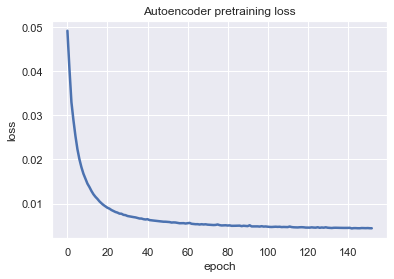

Iter: 7999 loss=1277.625


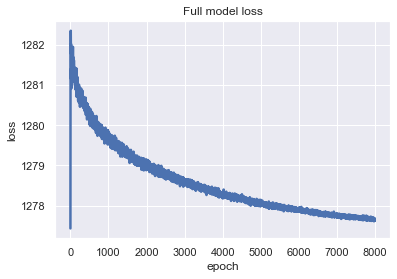

Training Done

F1 by Known Clusters: 0.3602
F1 score (macro) = 0.7467
Accuracy = 0.7307
Precision = 0.9529
Recall = 0.7340
... wrote results to c:\Users\Will\Projects\MSc\project\src\results\test-train_size=0-radius=6-latent_weight=0.9-reconstr_weight=0.75-head=ae-cluster=OPTICS-noise_factor=0.4-\index.html
Finished 'evaluate_model' in 251.223 secs
--------------------------------------------------
3/7: test-train_size=0-radius=6-latent_weight=0.9-reconstr_weight=0.75-head=ae-cluster=OPTICS-noise_factor=0.5-
--------------------------------------------------
{'train_size': 0, 'radius': 6, 'latent_weight': 0.9, 'reconstr_weight': 0.75, 'head': 'ae', 'cluster': 'OPTICS', 'noise_factor': 0.5}
Autoencoder
Latent Model
model compiled
Epoch 207: early stopping


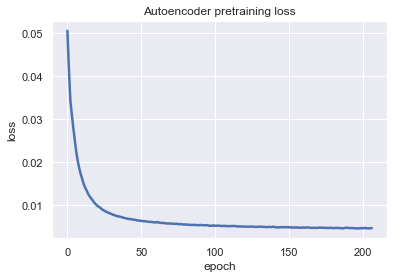

Iter: 7999 loss=1277.9078369140625


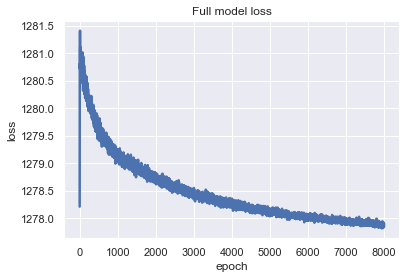

Training Done

F1 by Known Clusters: 0.3730
F1 score (macro) = 0.7544
Accuracy = 0.7383
Precision = 0.9537
Recall = 0.7473
... wrote results to c:\Users\Will\Projects\MSc\project\src\results\test-train_size=0-radius=6-latent_weight=0.9-reconstr_weight=0.75-head=ae-cluster=OPTICS-noise_factor=0.5-\index.html
Finished 'evaluate_model' in 254.386 secs
--------------------------------------------------
4/7: test-train_size=0-radius=6-latent_weight=0.9-reconstr_weight=0.75-head=ae-cluster=OPTICS-noise_factor=0.6-
--------------------------------------------------
{'train_size': 0, 'radius': 6, 'latent_weight': 0.9, 'reconstr_weight': 0.75, 'head': 'ae', 'cluster': 'OPTICS', 'noise_factor': 0.6}
Autoencoder
Latent Model
model compiled
Epoch 201: early stopping


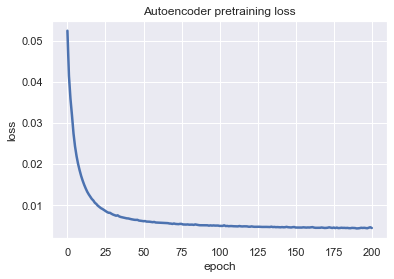

Iter: 7999 loss=1278.277587890625


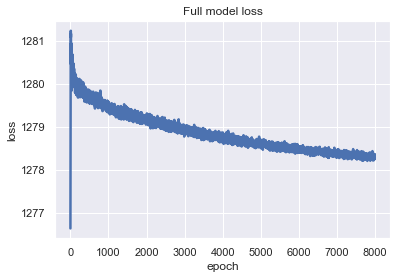

Training Done

F1 by Known Clusters: 0.3982
F1 score (macro) = 0.7472
Accuracy = 0.7500
Precision = 0.9549
Recall = 0.7415
... wrote results to c:\Users\Will\Projects\MSc\project\src\results\test-train_size=0-radius=6-latent_weight=0.9-reconstr_weight=0.75-head=ae-cluster=OPTICS-noise_factor=0.6-\index.html
Finished 'evaluate_model' in 253.793 secs
--------------------------------------------------
5/7: test-train_size=0-radius=6-latent_weight=0.9-reconstr_weight=0.75-head=ae-cluster=OPTICS-noise_factor=0.8-
--------------------------------------------------
{'train_size': 0, 'radius': 6, 'latent_weight': 0.9, 'reconstr_weight': 0.75, 'head': 'ae', 'cluster': 'OPTICS', 'noise_factor': 0.8}
Autoencoder
Latent Model
model compiled
Epoch 183: early stopping


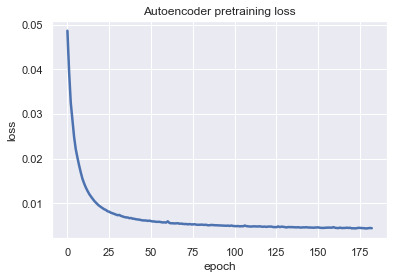

Iter: 7999 loss=1278.9603271484375


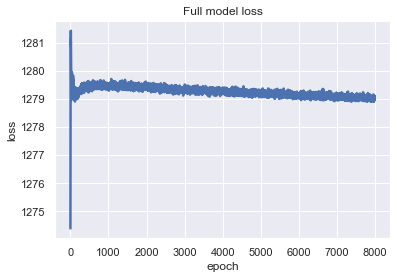

Training Done

F1 by Known Clusters: 0.3418
F1 score (macro) = 0.7493
Accuracy = 0.7360
Precision = 0.8988
Recall = 0.7415
... wrote results to c:\Users\Will\Projects\MSc\project\src\results\test-train_size=0-radius=6-latent_weight=0.9-reconstr_weight=0.75-head=ae-cluster=OPTICS-noise_factor=0.8-\index.html
Finished 'evaluate_model' in 249.216 secs
--------------------------------------------------
6/7: test-train_size=0-radius=6-latent_weight=0.9-reconstr_weight=0.75-head=ae-cluster=OPTICS-noise_factor=1.0-
--------------------------------------------------
{'train_size': 0, 'radius': 6, 'latent_weight': 0.9, 'reconstr_weight': 0.75, 'head': 'ae', 'cluster': 'OPTICS', 'noise_factor': 1.0}
Autoencoder
Latent Model
model compiled
Epoch 186: early stopping


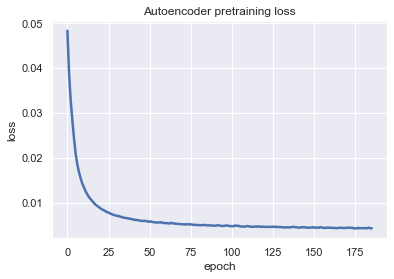

Iter: 7999 loss=1279.4547119140625


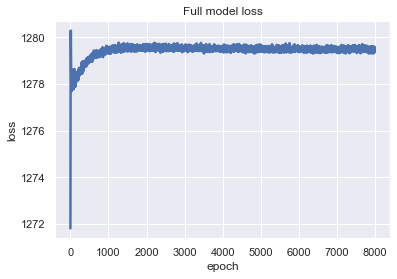

Training Done

F1 by Known Clusters: 0.3782
F1 score (macro) = 0.7494
Accuracy = 0.7477
Precision = 0.9549
Recall = 0.7468
... wrote results to c:\Users\Will\Projects\MSc\project\src\results\test-train_size=0-radius=6-latent_weight=0.9-reconstr_weight=0.75-head=ae-cluster=OPTICS-noise_factor=1.0-\index.html
Finished 'evaluate_model' in 258.527 secs


In [ ]:
from grid_search import grid_search

scores = []
num_runs = 1
config = {
    'train_size': [0],
    "radius": [6],
    'latent_weight': [0.9],
    'reconstr_weight': [0.75],
    'head': ['ae'],
    'cluster': ['OPTICS'],
    'noise_factor': [0.0, 0.2, 0.4, 0.5, 0.6, 0.8, 1.0]
}

grid_search(config, do_run)

In [ ]:
summarise_scores(scores)

Run Name                                 Runs       F1 avg       F1 Cluster   F1 Global    Precision    Recall      
test-train_size=0-radius=6-latent_weight=0.9-reconstr_weight=0.75-head=ae-cluster=OPTICS-noise_factor=0.0- 1           0.5574       0.3773       0.7374      0.9538       0.7317      
test-train_size=0-radius=6-latent_weight=0.9-reconstr_weight=0.75-head=ae-cluster=OPTICS-noise_factor=0.2- 1           0.5544       0.3611       0.7476      0.9532       0.7421      
test-train_size=0-radius=6-latent_weight=0.9-reconstr_weight=0.75-head=ae-cluster=OPTICS-noise_factor=0.4- 1           0.5534       0.3602       0.7467      0.9529       0.7340      
test-train_size=0-radius=6-latent_weight=0.9-reconstr_weight=0.75-head=ae-cluster=OPTICS-noise_factor=0.5- 1           0.5637       0.3730       0.7544      0.9537       0.7473      
test-train_size=0-radius=6-latent_weight=0.9-reconstr_weight=0.75-head=ae-cluster=OPTICS-noise_factor=0.6- 1           0.5727       0.3982       0.7472

## Min cluster size for OPTICS

--------------------------------------------------
test-optics-mcs-5
--------------------------------------------------
Autoencoder
Latent Model
model compiled
Epoch 170: early stopping


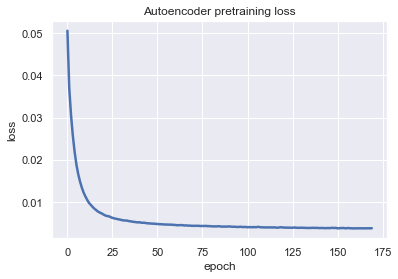

Iter: 7999 loss=1.3795928955078125


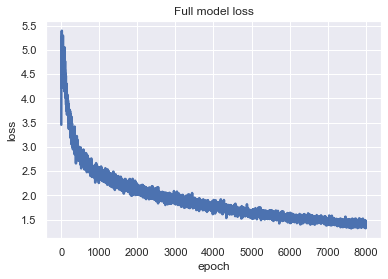

Training Done

F1 by Known Clusters: 0.3521
F1 score (macro) = 0.7394
Accuracy = 0.7413
Precision = 0.8981
Recall = 0.7312
... wrote results to c:\Users\Will\Projects\MSc\project\src\results\test-optics-mcs-5\index.html
Finished 'evaluate_model' in 332.413 secs
--------------------------------------------------
test-optics-mcs-10
--------------------------------------------------
Autoencoder
Latent Model
model compiled

F1 by Known Clusters: 0.1416
F1 score (macro) = 0.5653
Accuracy = 0.5050
Precision = 0.9498
Recall = 0.5171
... wrote results to c:\Users\Will\Projects\MSc\project\src\results\test-optics-mcs-10\index.html
Finished 'evaluate_model' in 281.591 secs
--------------------------------------------------
test-optics-mcs-15
--------------------------------------------------
Autoencoder
Latent Model
model compiled

F1 by Known Clusters: 0.0964
F1 score (macro) = 0.4090
Accuracy = 0.3757
Precision = 0.8381
Recall = 0.3773
... wrote results to c:\Users\Will\Projects\MSc\project\sr

In [ ]:
trained = False
ae_file = None
scores=[]
for min_cluster_size in [5, 10, 15, 20]:
    run_name = f'test-optics-mcs-{min_cluster_size}'
    print('-'*50)
    print(f"{run_name}")
    print('-'*50)

    dc = None
    dc = DeepLatentCluster(
        run_name,
        {
            'train_size':0,
            'reconstr_weight':0.75,
            'latent_weight':0.9,
            "cluster": 'OPTICS',
            "entity_count": 15,
            "noise_factor": 0.6,
            "head": "ae",
            "radius": 6,
            "alpha1": 80,
        })
    dc.make_model()
    
    if not trained:
        dc.train_model(verbose=0)
        trained = True
        ae_file = run_name

    score = dc.evaluate_model(
            run_name,
            head='z',
            sample_size=3000,
            verbose=0,
            config={
                'min_cluster_size': min_cluster_size,
                'ae_weights_file': ae_file,
                })
    score['run_name'] = run_name
    scores.append(score)

summarise_scores(scores)

--------------------------------------------------
test-kmeans-high-alpha
--------------------------------------------------
ERROR: Invalid config key <module 'tensorflow.keras' from 'c:\\Users\\Will\\Anaconda3\\envs\\tf-27\\lib\\site-packages\\keras\\api\\_v2\\keras\\__init__.py'>
Autoencoder
Latent Model
model compiled

F1 by Known Clusters: 0.2585


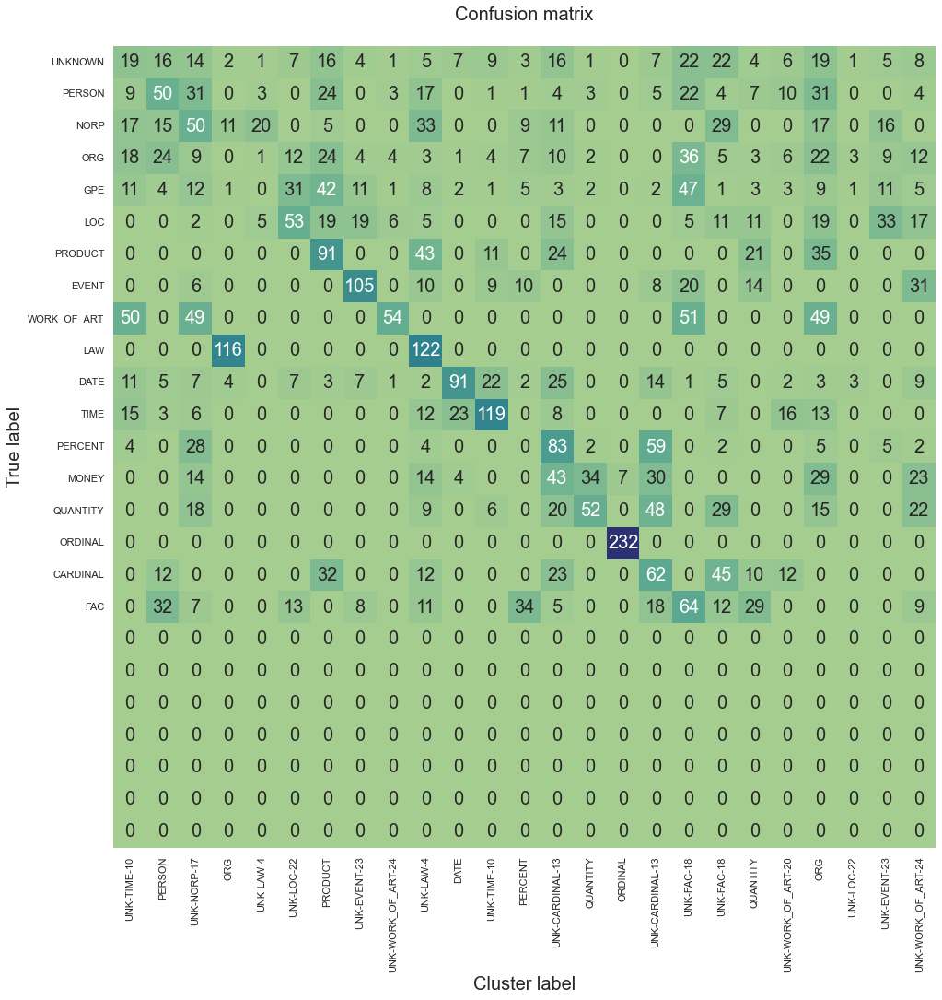

F1 score (macro) = 0.5206
Accuracy = 0.4672
Precision = 0.8384
Recall = 0.4606
New clusters =      4
... wrote results to c:\Users\Will\Projects\MSc\project\src\results\test-kmeans-high-alpha\index.html
Finished 'evaluate_model' in 46.872 secs
Run Name                                 Runs       F1 avg       F1 Cluster   F1 Global    Precision    Recall      
test-kmeans-high-alpha                   1           0.3895       0.2585       0.5206      0.8384       0.4606      


In [ ]:
run_name = f'test-kmeans-high-alpha'
print('-'*50)
print(f"{run_name}")
print('-'*50)

dc = None
dc = DeepLatentCluster(
    run_name,
    {
        'train_size':0,
        'reconstr_weight':0.75,
        'latent_weight':0.9,
        "cluster": 'Kmeans',
        "entity_count": 15,
        "noise_factor": 0.6,
        "head": "ae",
        "radius": 6,
        "alpha1": 80,
    })
dc.make_model()

# dc.train_model(verbose=0)

score = dc.evaluate_model(
        run_name,
        head='z',
        sample_size=4000,
        verbose=0,
        )
score['run_name'] = run_name
summarise_scores([score])


In [ ]:
%tb plain

--------------------------------------------------
test-kmeans-high-alpha-enc
--------------------------------------------------
ERROR: Invalid config key <module 'tensorflow.keras' from 'c:\\Users\\Will\\Anaconda3\\envs\\tf-27\\lib\\site-packages\\keras\\api\\_v2\\keras\\__init__.py'>
Autoencoder
Latent Model
model compiled
Epoch 203: early stopping


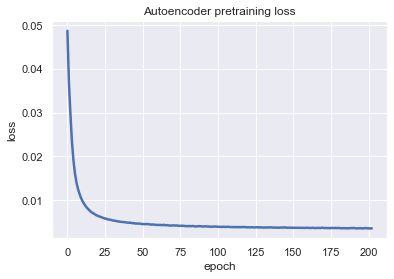

  0%|          | 0/8000 [00:00<?, ?it/s]

Iter: 7999 loss=1419.97802734375


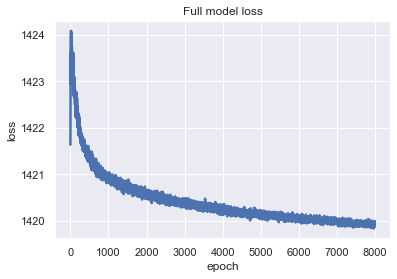

Training Done

F1 by Known Clusters: 0.3122


<Figure size 432x288 with 0 Axes>

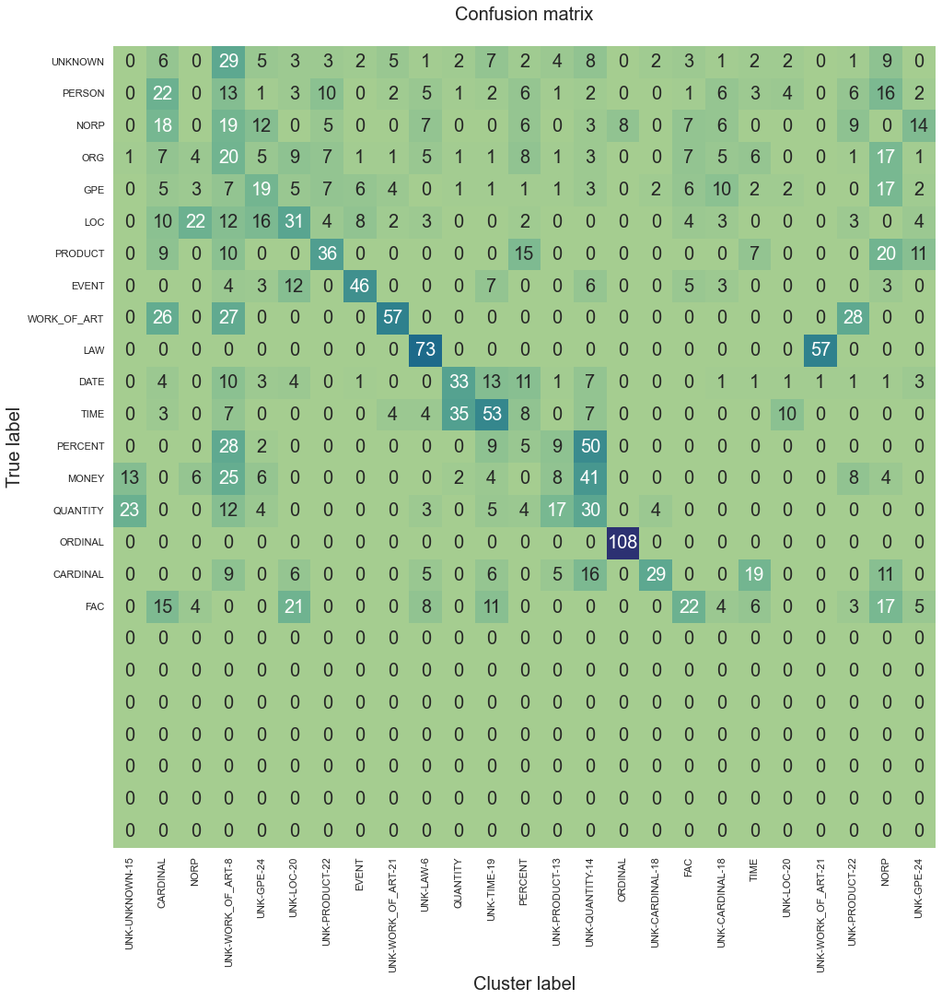

F1 score (macro) = 0.4882
Accuracy = 0.4585
Precision = 0.7268
Recall = 0.4487
New clusters =      4
... wrote results to c:\Users\Will\Projects\MSc\project\src\results\test-kmeans-high-alpha-enc\index.html
Finished 'evaluate_model' in 26.571 secs
Run Name                                 Runs       F1 avg       F1 Cluster   F1 Global    Precision    Recall      
test-kmeans-high-alpha-enc               1           0.4002       0.3122       0.4882      0.7268       0.4487      


In [ ]:
run_name = f'test-kmeans-high-alpha-enc'
print('-'*50)
print(f"{run_name}")
print('-'*50)

dc = None
dc = DeepLatentCluster(
    run_name,
    {
        'train_size':0,
        'reconstr_weight':0.75,
        'latent_weight':1.0,
        "cluster": 'Kmeans',
        "entity_count": 15,
        "noise_factor": 0.6,
        "head": "enc",
        "radius": 6,
        "alpha1": 80,
    })
dc.make_model()

dc.train_model(verbose=0)

score = dc.evaluate_model(
        run_name,
        head='enc',
        sample_size=2000,
        verbose=0,
        )
score['run_name'] = run_name
summarise_scores([score])


--------------------------------------------------
0/5: test-train_size=0-radius=6-latent_weight=1.0-reconstr_weight=0.75-head=enc-cluster=Kmeans-noise_factor=0.6-entity_count=15-alpha1=20-
--------------------------------------------------
{'train_size': 0, 'radius': 6, 'latent_weight': 1.0, 'reconstr_weight': 0.75, 'head': 'enc', 'cluster': 'Kmeans', 'noise_factor': 0.6, 'entity_count': 15, 'alpha1': 20}
ERROR: Invalid config key <module 'tensorflow.keras' from 'c:\\Users\\Will\\Anaconda3\\envs\\tf-27\\lib\\site-packages\\keras\\api\\_v2\\keras\\__init__.py'>
Autoencoder
Latent Model
model compiled
Epoch 172: early stopping


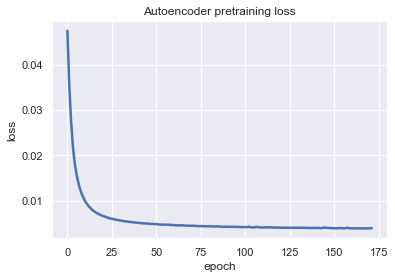

  0%|          | 0/8000 [00:00<?, ?it/s]

Iter: 7999 loss=1420.2177734375


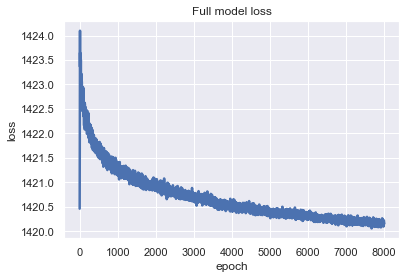

Training Done

F1 by Known Clusters: 0.2527


<Figure size 432x288 with 0 Axes>

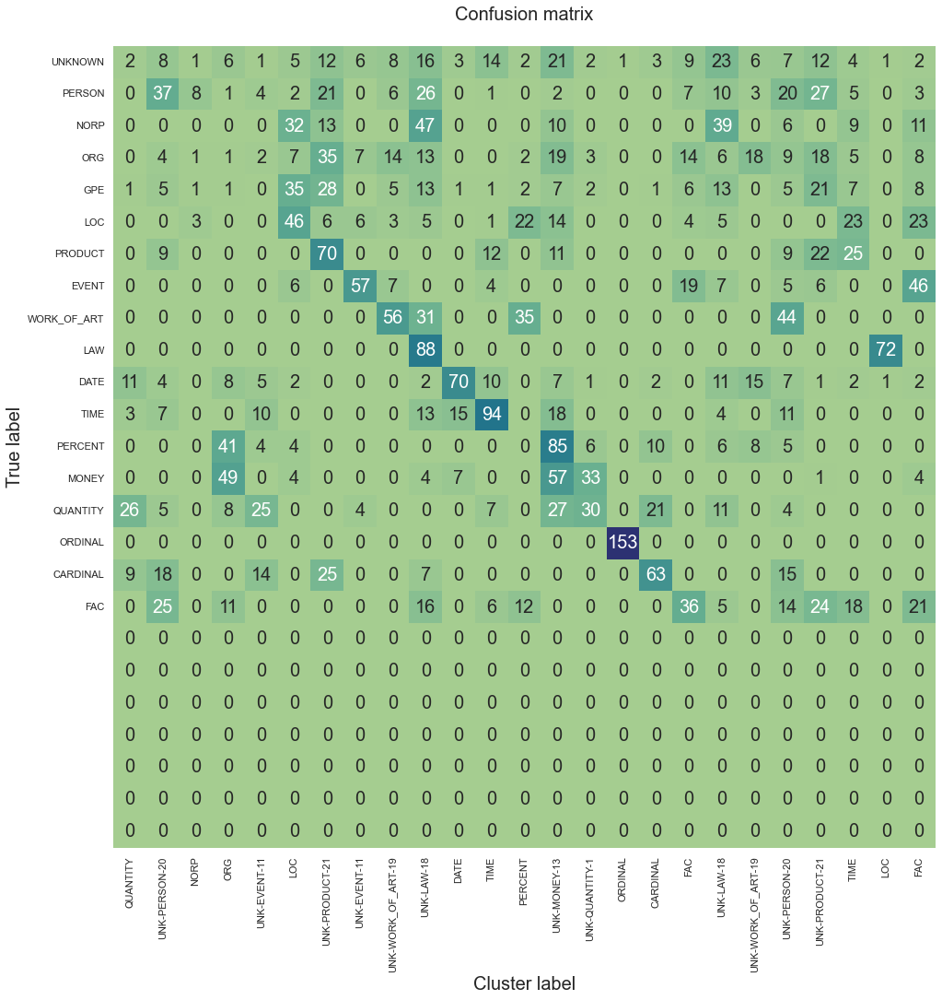

F1 score (macro) = 0.5679
Accuracy = 0.4923
Precision = 0.8946
Recall = 0.4991
New clusters =      7
... wrote results to c:\Users\Will\Projects\MSc\project\src\results\test-train_size=0-radius=6-latent_weight=1.0-reconstr_weight=0.75-head=enc-cluster=Kmeans-noise_factor=0.6-entity_count=15-alpha1=20-\index.html
Finished 'evaluate_model' in 32.19 secs
--------------------------------------------------
1/5: test-train_size=0-radius=6-latent_weight=1.0-reconstr_weight=0.75-head=enc-cluster=Kmeans-noise_factor=0.6-entity_count=15-alpha1=40-
--------------------------------------------------
{'train_size': 0, 'radius': 6, 'latent_weight': 1.0, 'reconstr_weight': 0.75, 'head': 'enc', 'cluster': 'Kmeans', 'noise_factor': 0.6, 'entity_count': 15, 'alpha1': 40}
ERROR: Invalid config key <module 'tensorflow.keras' from 'c:\\Users\\Will\\Anaconda3\\envs\\tf-27\\lib\\site-packages\\keras\\api\\_v2\\keras\\__init__.py'>
Autoencoder
Latent Model
model compiled
Epoch 150: early stopping


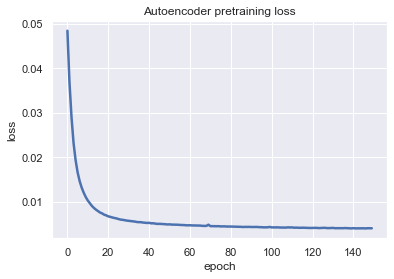

  0%|          | 0/8000 [00:00<?, ?it/s]

Iter: 7999 loss=1420.0849609375


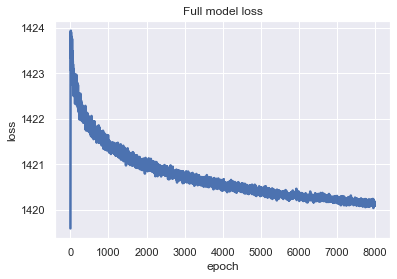

Training Done

F1 by Known Clusters: 0.3693


<Figure size 432x288 with 0 Axes>

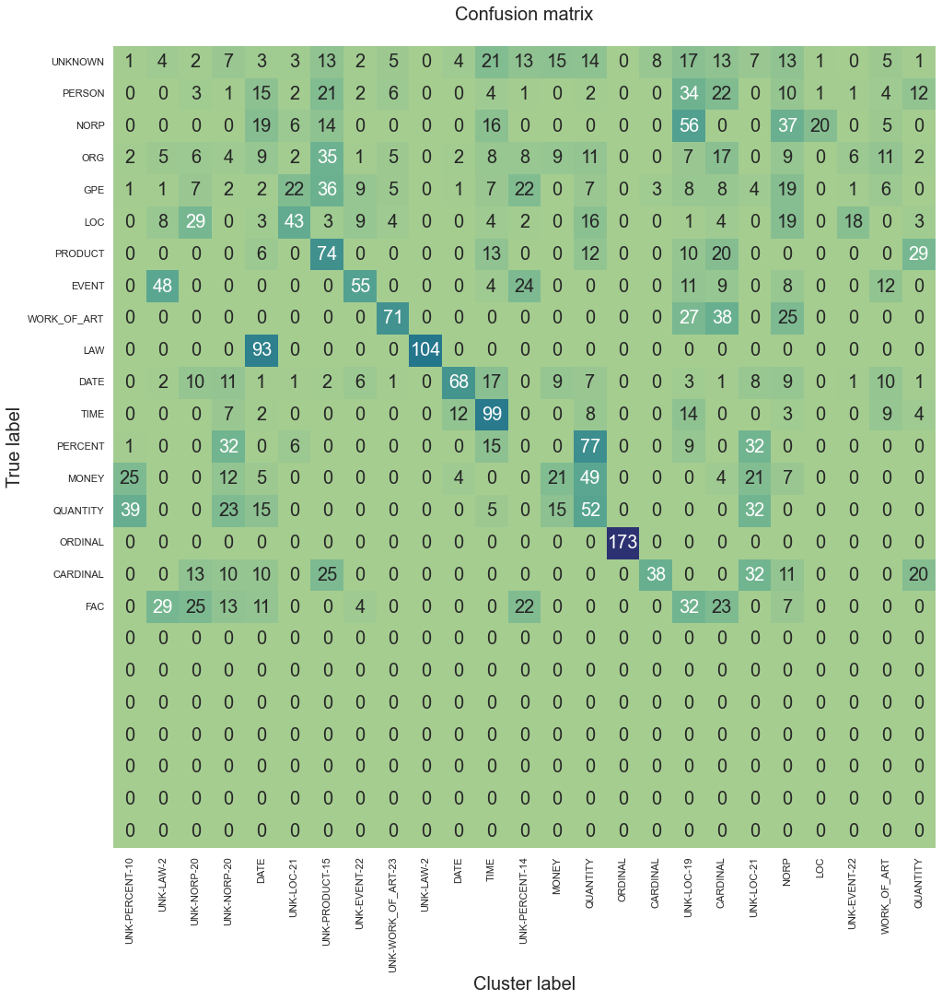

F1 score (macro) = 0.5218
Accuracy = 0.5007
Precision = 0.7279
Recall = 0.4867
New clusters =      2
... wrote results to c:\Users\Will\Projects\MSc\project\src\results\test-train_size=0-radius=6-latent_weight=1.0-reconstr_weight=0.75-head=enc-cluster=Kmeans-noise_factor=0.6-entity_count=15-alpha1=40-\index.html
Finished 'evaluate_model' in 30.875 secs
--------------------------------------------------
2/5: test-train_size=0-radius=6-latent_weight=1.0-reconstr_weight=0.75-head=enc-cluster=Kmeans-noise_factor=0.6-entity_count=15-alpha1=60-
--------------------------------------------------
{'train_size': 0, 'radius': 6, 'latent_weight': 1.0, 'reconstr_weight': 0.75, 'head': 'enc', 'cluster': 'Kmeans', 'noise_factor': 0.6, 'entity_count': 15, 'alpha1': 60}
ERROR: Invalid config key <module 'tensorflow.keras' from 'c:\\Users\\Will\\Anaconda3\\envs\\tf-27\\lib\\site-packages\\keras\\api\\_v2\\keras\\__init__.py'>
Autoencoder
Latent Model
model compiled
Epoch 156: early stopping


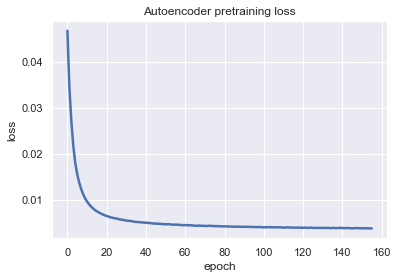

  0%|          | 0/8000 [00:00<?, ?it/s]

Iter: 7999 loss=1420.1544189453125


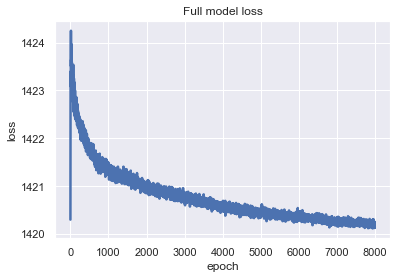

Training Done

F1 by Known Clusters: 0.2980


<Figure size 432x288 with 0 Axes>

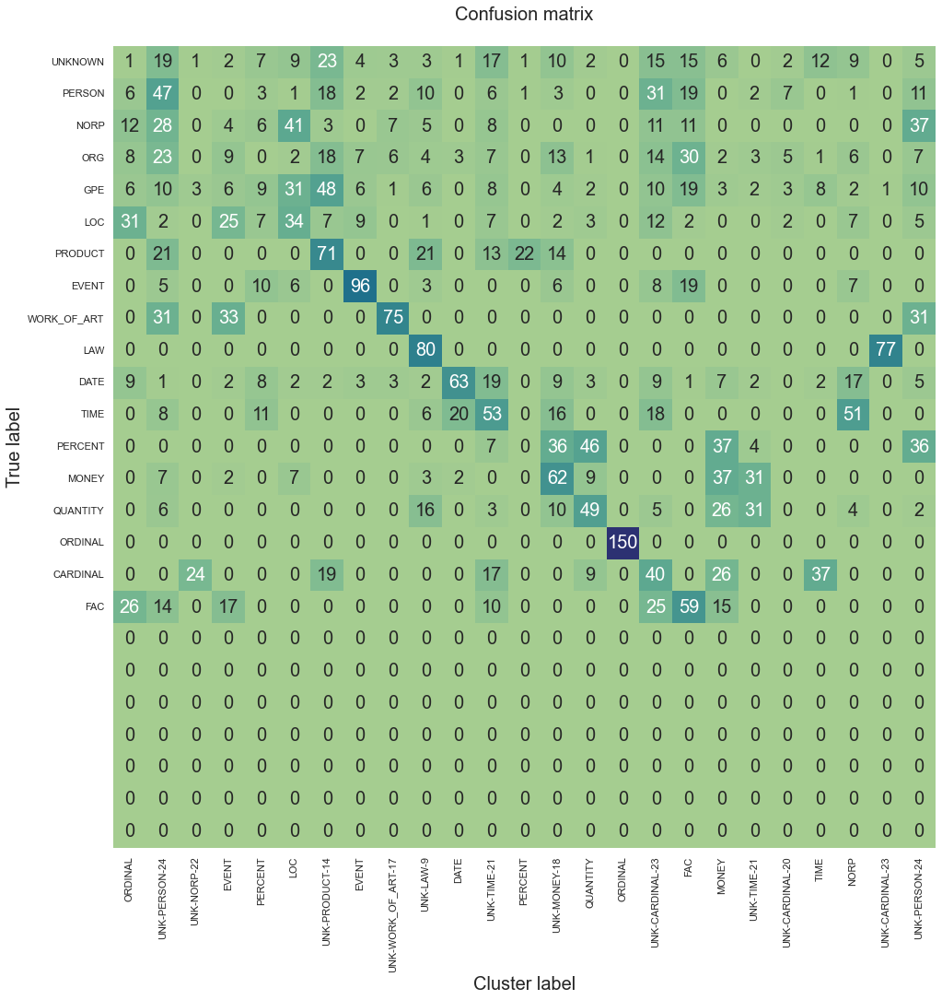

F1 score (macro) = 0.5575
Accuracy = 0.4837
Precision = 0.8387
Recall = 0.4915
New clusters =      5
... wrote results to c:\Users\Will\Projects\MSc\project\src\results\test-train_size=0-radius=6-latent_weight=1.0-reconstr_weight=0.75-head=enc-cluster=Kmeans-noise_factor=0.6-entity_count=15-alpha1=60-\index.html
Finished 'evaluate_model' in 31.402 secs
--------------------------------------------------
3/5: test-train_size=0-radius=6-latent_weight=1.0-reconstr_weight=0.75-head=enc-cluster=Kmeans-noise_factor=0.6-entity_count=15-alpha1=80-
--------------------------------------------------
{'train_size': 0, 'radius': 6, 'latent_weight': 1.0, 'reconstr_weight': 0.75, 'head': 'enc', 'cluster': 'Kmeans', 'noise_factor': 0.6, 'entity_count': 15, 'alpha1': 80}
ERROR: Invalid config key <module 'tensorflow.keras' from 'c:\\Users\\Will\\Anaconda3\\envs\\tf-27\\lib\\site-packages\\keras\\api\\_v2\\keras\\__init__.py'>
Autoencoder
Latent Model
model compiled
Epoch 178: early stopping


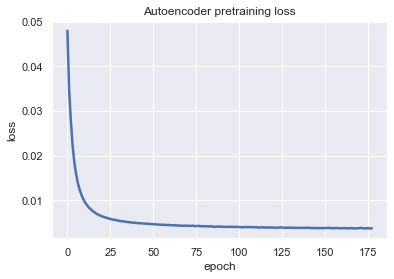

  0%|          | 0/8000 [00:00<?, ?it/s]

Iter: 7999 loss=1419.90576171875


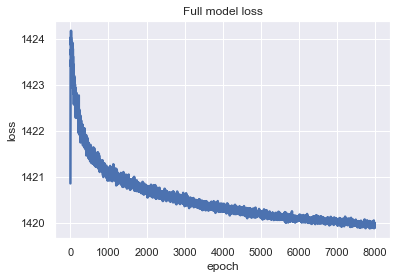

Training Done

F1 by Known Clusters: 0.2109


<Figure size 432x288 with 0 Axes>

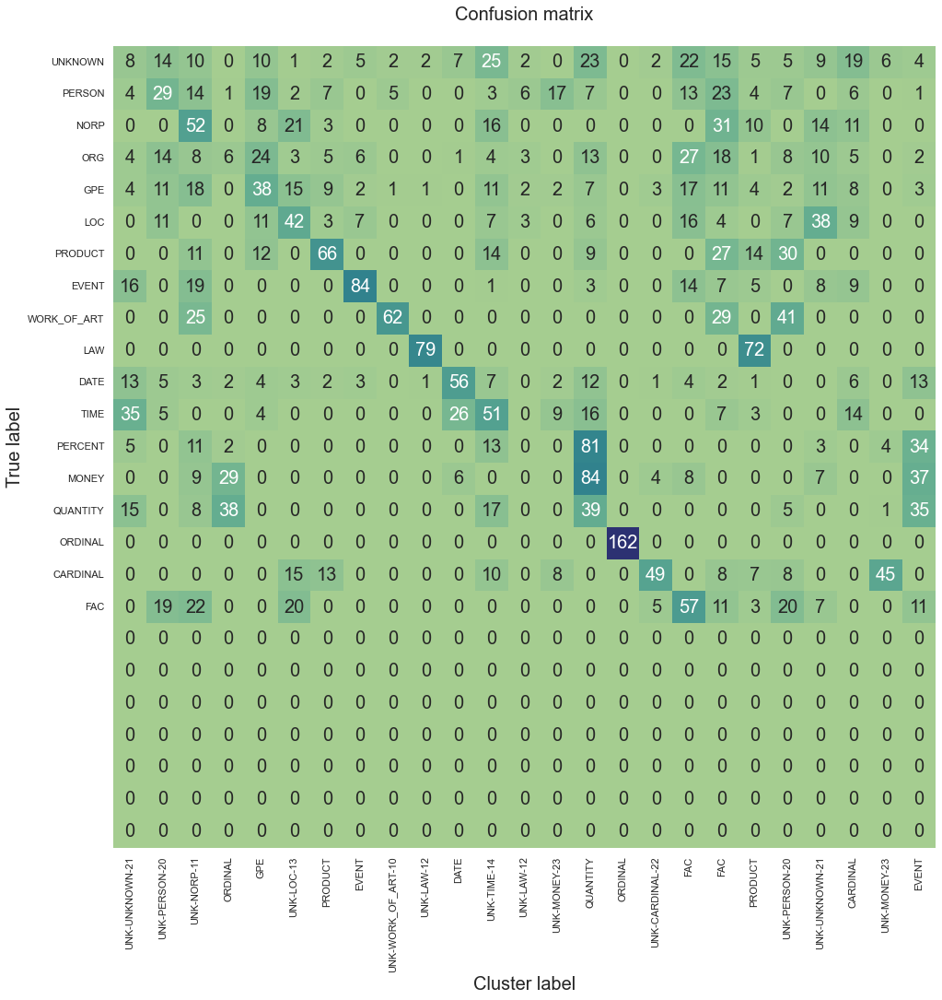

F1 score (macro) = 0.5551
Accuracy = 0.4897
Precision = 0.8397
Recall = 0.4854
New clusters =      6
... wrote results to c:\Users\Will\Projects\MSc\project\src\results\test-train_size=0-radius=6-latent_weight=1.0-reconstr_weight=0.75-head=enc-cluster=Kmeans-noise_factor=0.6-entity_count=15-alpha1=80-\index.html
Finished 'evaluate_model' in 31.157 secs
--------------------------------------------------
4/5: test-train_size=0-radius=6-latent_weight=1.0-reconstr_weight=0.75-head=enc-cluster=Kmeans-noise_factor=0.6-entity_count=15-alpha1=100-
--------------------------------------------------
{'train_size': 0, 'radius': 6, 'latent_weight': 1.0, 'reconstr_weight': 0.75, 'head': 'enc', 'cluster': 'Kmeans', 'noise_factor': 0.6, 'entity_count': 15, 'alpha1': 100}
ERROR: Invalid config key <module 'tensorflow.keras' from 'c:\\Users\\Will\\Anaconda3\\envs\\tf-27\\lib\\site-packages\\keras\\api\\_v2\\keras\\__init__.py'>
Autoencoder
Latent Model
model compiled
Epoch 155: early stopping


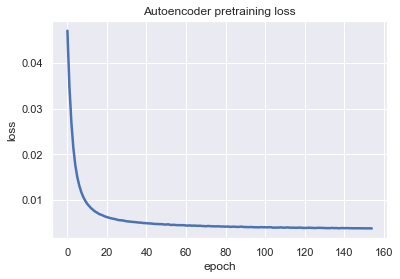

  0%|          | 0/8000 [00:00<?, ?it/s]

Iter: 7999 loss=1420.240966796875


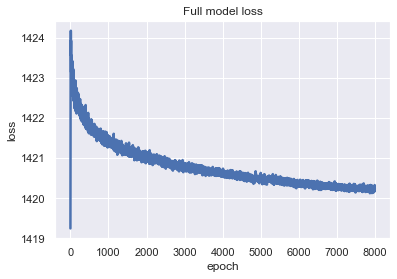

Training Done

F1 by Known Clusters: 0.3589


<Figure size 432x288 with 0 Axes>

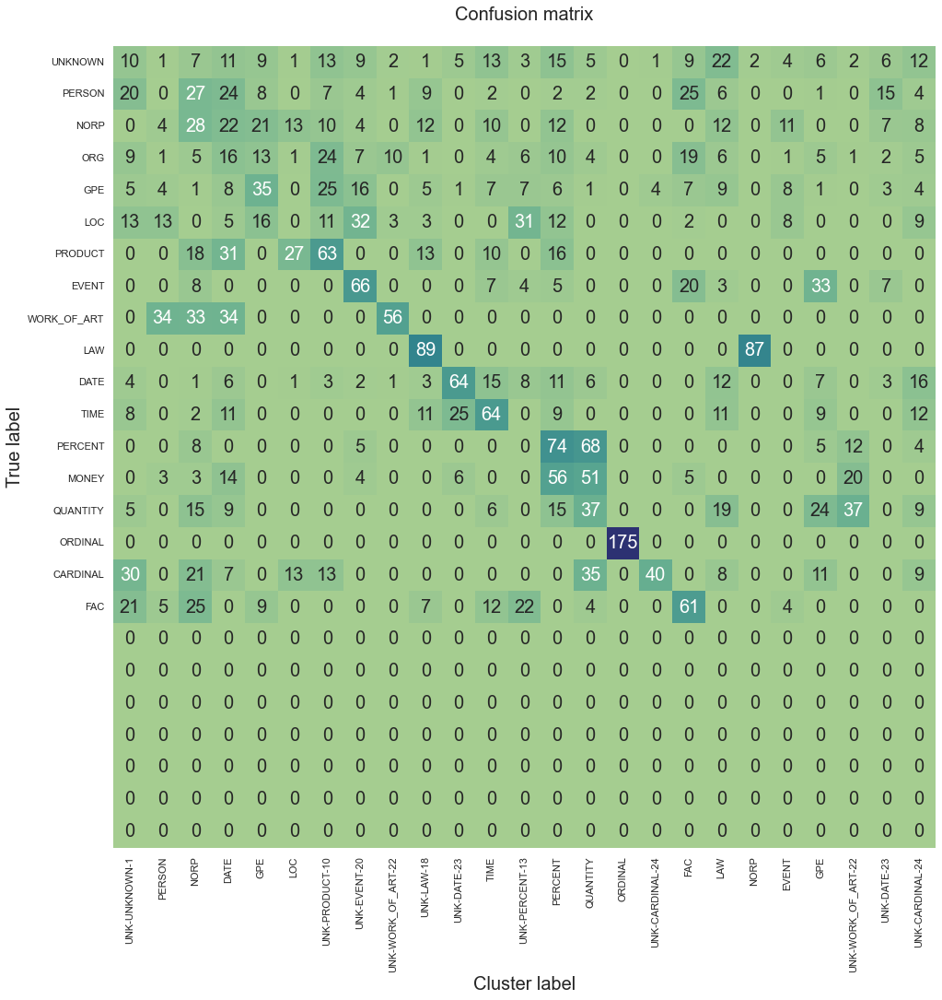

F1 score (macro) = 0.5087
Accuracy = 0.4707
Precision = 0.8387
Recall = 0.4648
New clusters =      6
... wrote results to c:\Users\Will\Projects\MSc\project\src\results\test-train_size=0-radius=6-latent_weight=1.0-reconstr_weight=0.75-head=enc-cluster=Kmeans-noise_factor=0.6-entity_count=15-alpha1=100-\index.html
Finished 'evaluate_model' in 32.031 secs
Run Name                                 Runs       F1 avg       F1 Cluster   F1 Global    Precision    Recall      
test-train_size=0-radius=6-latent_weight=1.0-reconstr_weight=0.75-head=enc-cluster=Kmeans-noise_factor=0.6-entity_count=15-alpha1=20- 1           0.4103       0.2527       0.5679      0.8946       0.4991      
test-train_size=0-radius=6-latent_weight=1.0-reconstr_weight=0.75-head=enc-cluster=Kmeans-noise_factor=0.6-entity_count=15-alpha1=40- 1           0.4455       0.3693       0.5218      0.7279       0.4867      
test-train_size=0-radius=6-latent_weight=1.0-reconstr_weight=0.75-head=enc-cluster=Kmeans-noise_factor=0.6-

In [ ]:
from grid_search import grid_search

num_runs = 1
config = {
    'train_size': [0],
    "radius": [6],
    'latent_weight': [1.0],
    'reconstr_weight': [0.75],
    'head': ['enc'],
    'cluster': ['Kmeans'],
    'noise_factor': [0.6],
    "entity_count": [15],
    'alpha1': [20, 40, 60, 80, 100]
}

scores = grid_search(config, do_run)

summarise_scores(scores)

# Using KL Divergence

## P from encoder, Q from latent space

--------------------------------------------------
0/60: test-train_size=3000-radius=0-latent_weight=1e-05-reconstr_weight=0.1-head=z-cluster=Kmeans-entity_count=15-noise_factor=0.1-
--------------------------------------------------
{'train_size': 3000, 'radius': 0, 'latent_weight': 1e-05, 'reconstr_weight': 0.1, 'head': 'z', 'cluster': 'Kmeans', 'entity_count': 15, 'noise_factor': 0.1}
ERROR: Invalid config key <module 'tensorflow.keras' from 'c:\\Users\\Will\\Anaconda3\\envs\\tf-27\\lib\\site-packages\\keras\\api\\_v2\\keras\\__init__.py'>
Autoencoder
Latent Model
model compiled
Epoch 203: early stopping


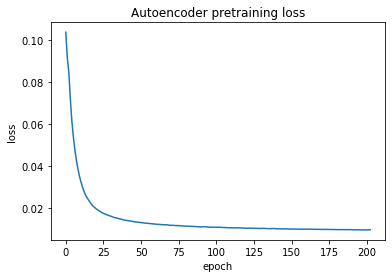

  0%|          | 0/8000 [00:00<?, ?it/s]

Stop traing for tolerance threshold reached
Iter: 104 loss=0.0018527510110288858


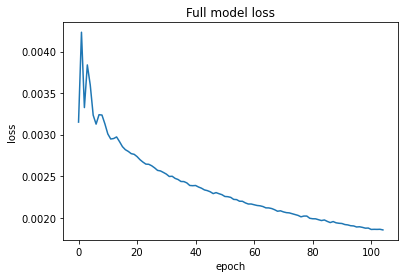

Training Done
Creating data


  0%|          | 0/3 [00:00<?, ?it/s]

Reading lines


100%|██████████| 3453/3453 [00:00<00:00, 43709.26it/s]


pre-embedding all
Finished 'get_pipe' in 5.364 secs


100%|██████████| 3453/3453 [07:00<00:00,  8.21it/s]


Emedded 3453 sentences
Saved to ./data\conll_n0_test
Embedding sentences radius 0


3453it [00:12, 267.43it/s]


Finished 'get_training_data_spacy' in 609.631 secs
SAVED ./data/conll_spacy_n0_r0_test.pkl

F1 by Known Clusters: 0.1417


<Figure size 432x288 with 0 Axes>

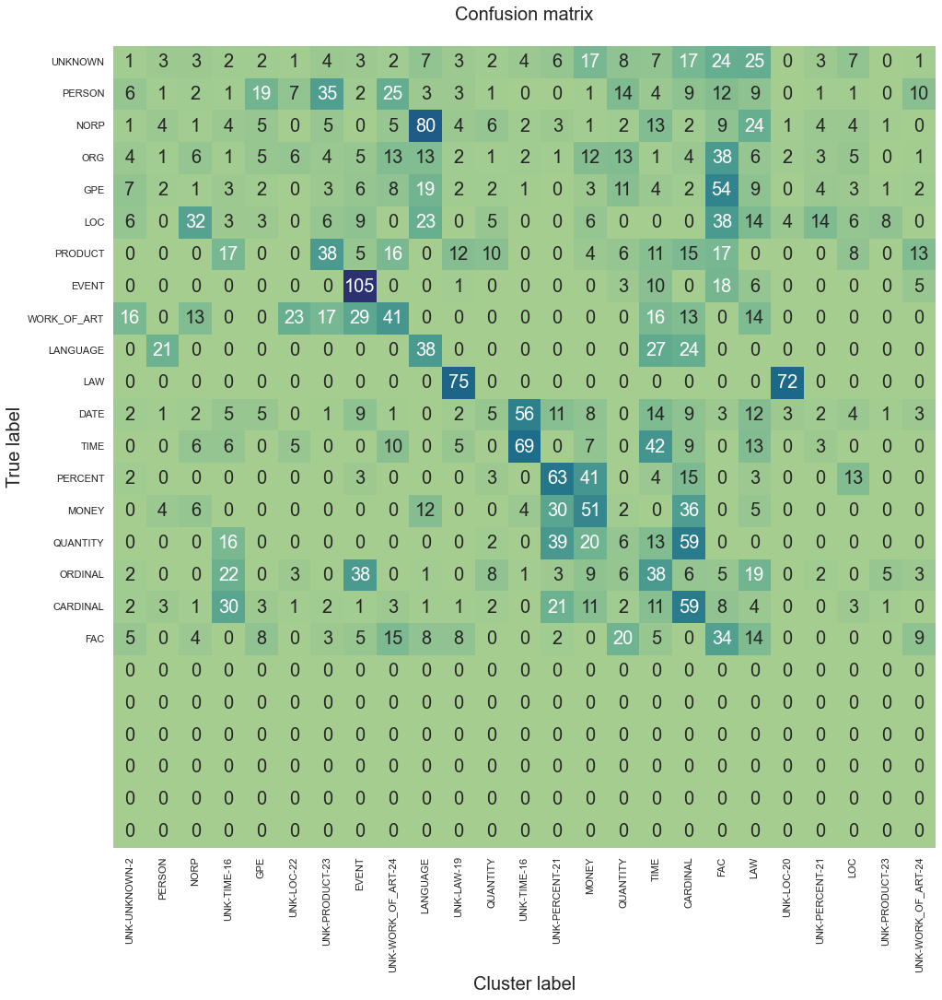

F1 score (macro) = 0.4373
Accuracy = 0.3733
Precision = 0.7934
Recall = 0.3742
New clusters =      1
... wrote results to c:\Users\Will\Projects\MSc\project\src\results\test-train_size=3000-radius=0-latent_weight=1e-05-reconstr_weight=0.1-head=z-cluster=Kmeans-entity_count=15-noise_factor=0.1-\index.html
Finished 'evaluate_model' in 764.042 secs
--------------------------------------------------
1/60: test-train_size=3000-radius=0-latent_weight=1e-05-reconstr_weight=0.25-head=z-cluster=Kmeans-entity_count=15-noise_factor=0.1-
--------------------------------------------------
{'train_size': 3000, 'radius': 0, 'latent_weight': 1e-05, 'reconstr_weight': 0.25, 'head': 'z', 'cluster': 'Kmeans', 'entity_count': 15, 'noise_factor': 0.1}
ERROR: Invalid config key <module 'tensorflow.keras' from 'c:\\Users\\Will\\Anaconda3\\envs\\tf-27\\lib\\site-packages\\keras\\api\\_v2\\keras\\__init__.py'>
Autoencoder
Latent Model
model compiled
Epoch 245: early stopping


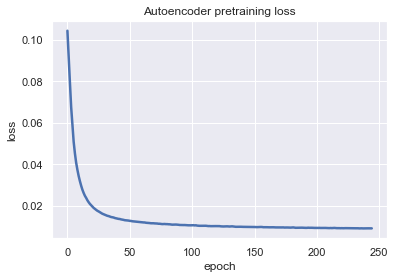

  0%|          | 0/8000 [00:00<?, ?it/s]

Stop traing for tolerance threshold reached
Iter: 157 loss=0.003943665884435177


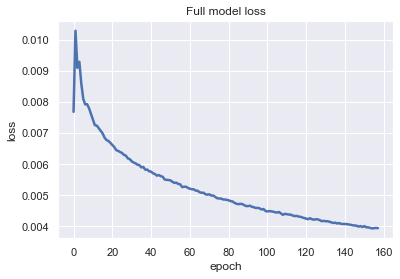

Training Done

F1 by Known Clusters: 0.2828


<Figure size 432x288 with 0 Axes>

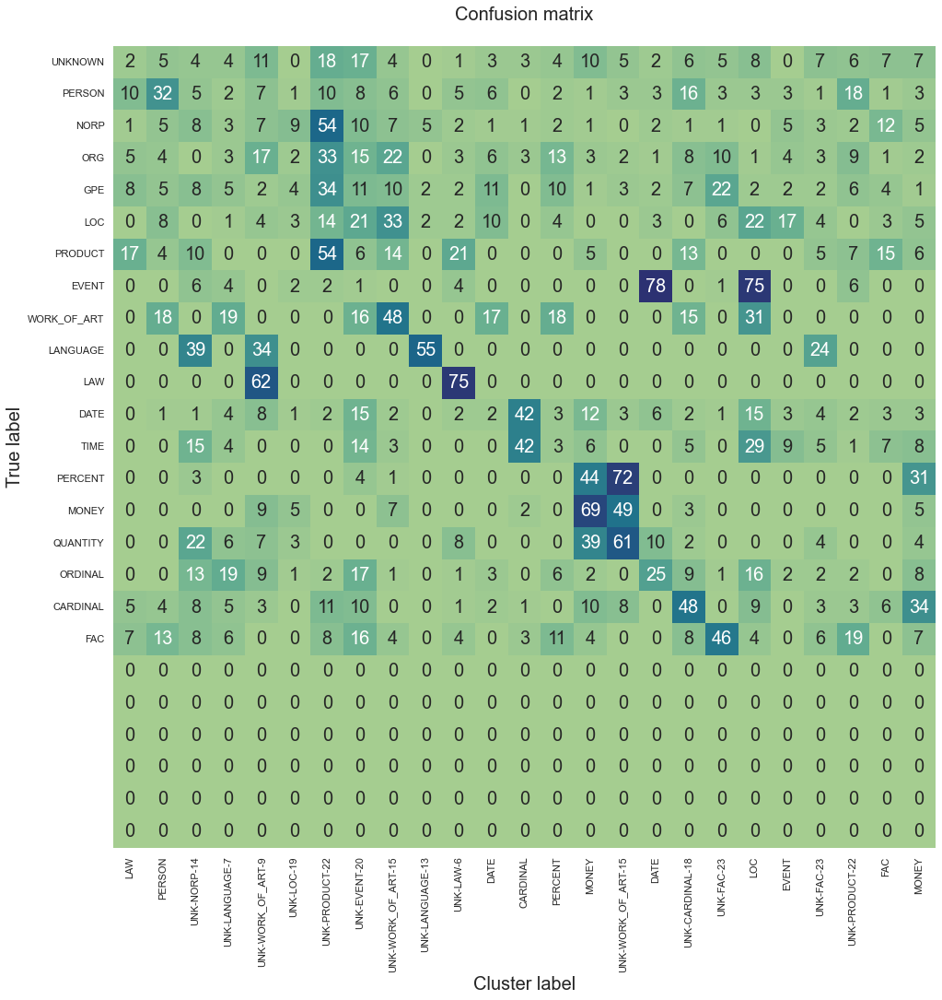

F1 score (macro) = 0.4323
Accuracy = 0.3813
Precision = 0.6879
Recall = 0.3862
New clusters =      4
... wrote results to c:\Users\Will\Projects\MSc\project\src\results\test-train_size=3000-radius=0-latent_weight=1e-05-reconstr_weight=0.25-head=z-cluster=Kmeans-entity_count=15-noise_factor=0.1-\index.html
Finished 'evaluate_model' in 73.945 secs
--------------------------------------------------
2/60: test-train_size=3000-radius=0-latent_weight=1e-05-reconstr_weight=0.5-head=z-cluster=Kmeans-entity_count=15-noise_factor=0.1-
--------------------------------------------------
{'train_size': 3000, 'radius': 0, 'latent_weight': 1e-05, 'reconstr_weight': 0.5, 'head': 'z', 'cluster': 'Kmeans', 'entity_count': 15, 'noise_factor': 0.1}
ERROR: Invalid config key <module 'tensorflow.keras' from 'c:\\Users\\Will\\Anaconda3\\envs\\tf-27\\lib\\site-packages\\keras\\api\\_v2\\keras\\__init__.py'>
Autoencoder
Latent Model
model compiled
Epoch 256: early stopping


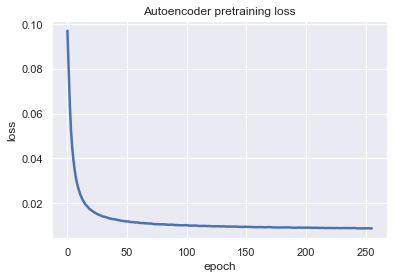

  0%|          | 0/8000 [00:00<?, ?it/s]

Stop traing for tolerance threshold reached
Iter: 272 loss=0.006539533380419016


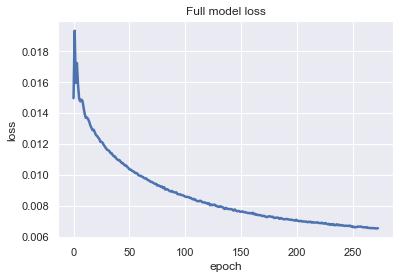

Training Done

F1 by Known Clusters: 0.2304


<Figure size 432x288 with 0 Axes>

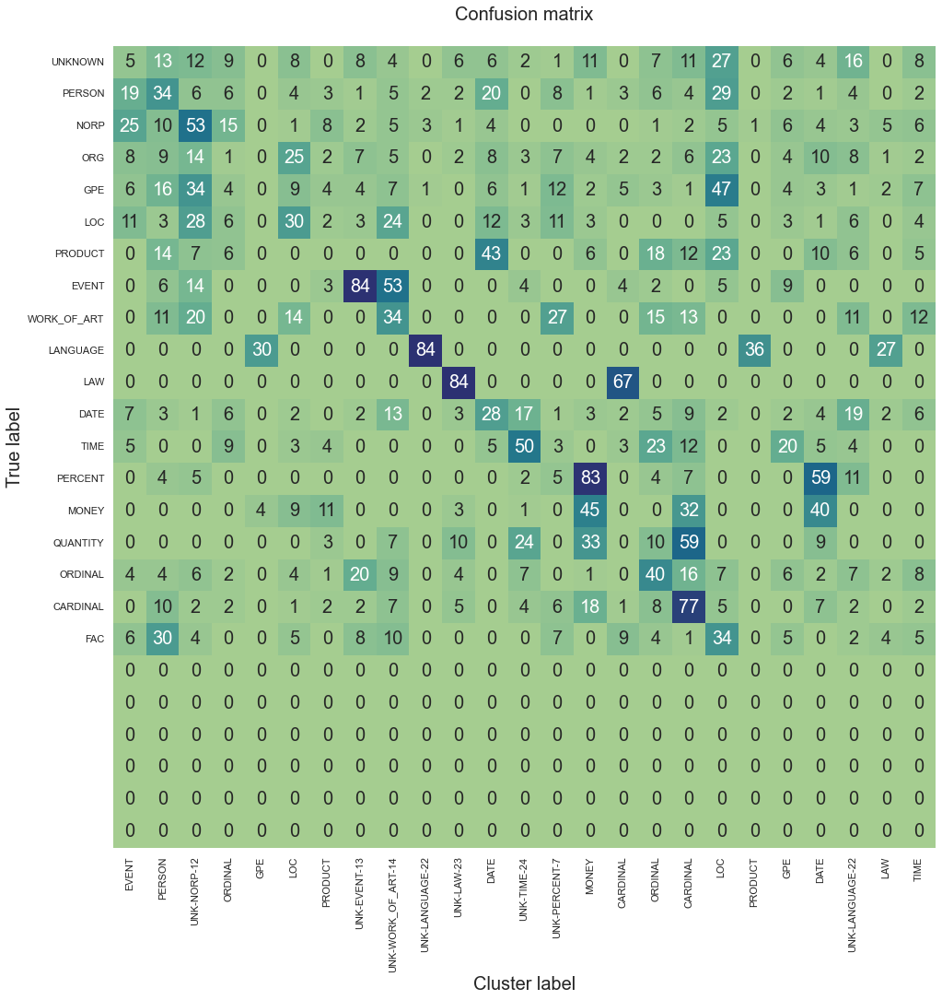

F1 score (macro) = 0.4559
Accuracy = 0.4247
Precision = 0.7940
Recall = 0.4081
New clusters =      5
... wrote results to c:\Users\Will\Projects\MSc\project\src\results\test-train_size=3000-radius=0-latent_weight=1e-05-reconstr_weight=0.5-head=z-cluster=Kmeans-entity_count=15-noise_factor=0.1-\index.html
Finished 'evaluate_model' in 33.838 secs
--------------------------------------------------
3/60: test-train_size=3000-radius=0-latent_weight=1e-05-reconstr_weight=0.75-head=z-cluster=Kmeans-entity_count=15-noise_factor=0.1-
--------------------------------------------------
{'train_size': 3000, 'radius': 0, 'latent_weight': 1e-05, 'reconstr_weight': 0.75, 'head': 'z', 'cluster': 'Kmeans', 'entity_count': 15, 'noise_factor': 0.1}
ERROR: Invalid config key <module 'tensorflow.keras' from 'c:\\Users\\Will\\Anaconda3\\envs\\tf-27\\lib\\site-packages\\keras\\api\\_v2\\keras\\__init__.py'>
Autoencoder
Latent Model
model compiled
Epoch 207: early stopping


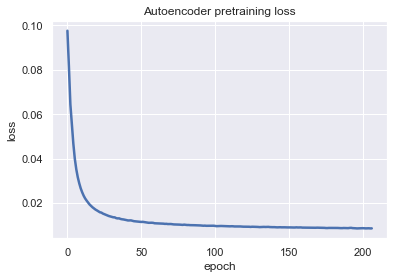

  0%|          | 0/8000 [00:00<?, ?it/s]

Stop traing for tolerance threshold reached
Iter: 649 loss=0.008423399180173874


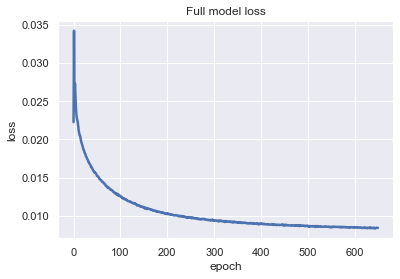

Training Done

F1 by Known Clusters: 0.1256


<Figure size 432x288 with 0 Axes>

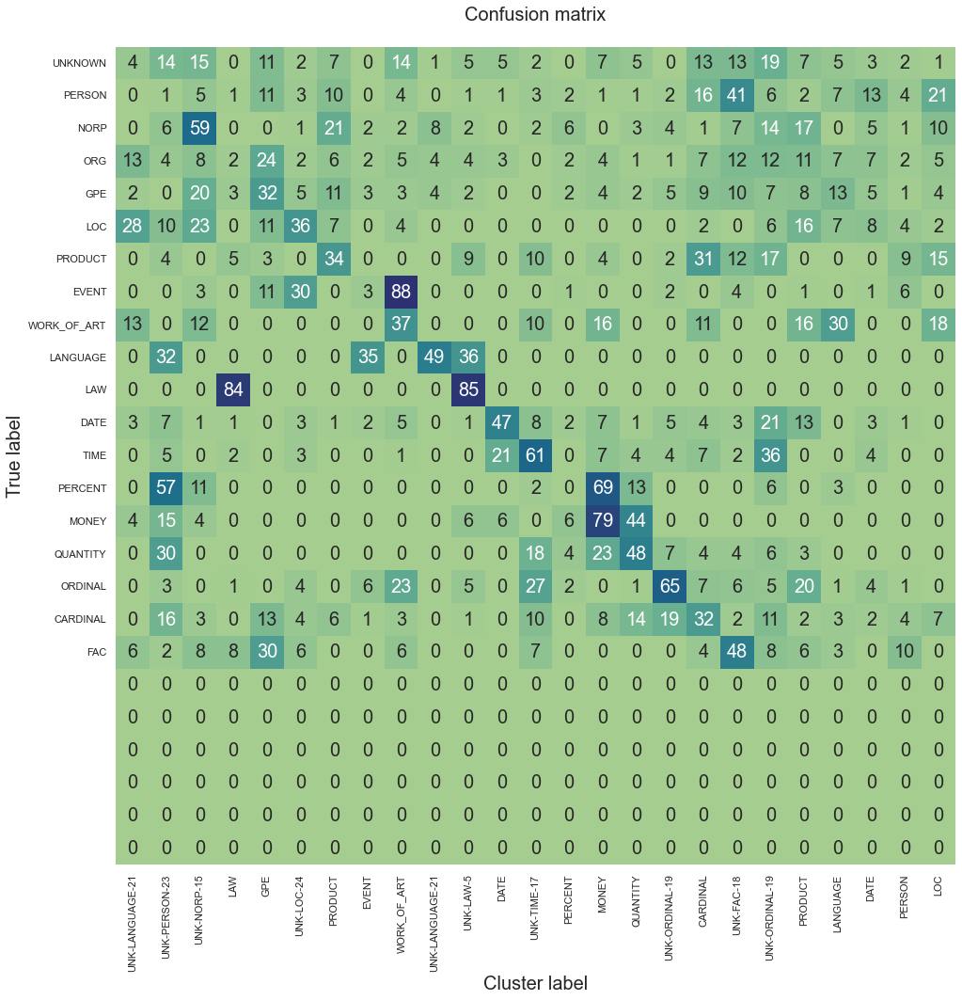

F1 score (macro) = 0.5023
Accuracy = 0.4193
Precision = 0.8990
Recall = 0.4161
New clusters =      4
... wrote results to c:\Users\Will\Projects\MSc\project\src\results\test-train_size=3000-radius=0-latent_weight=1e-05-reconstr_weight=0.75-head=z-cluster=Kmeans-entity_count=15-noise_factor=0.1-\index.html
Finished 'evaluate_model' in 33.982 secs
--------------------------------------------------
4/60: test-train_size=3000-radius=0-latent_weight=1e-05-reconstr_weight=0.9-head=z-cluster=Kmeans-entity_count=15-noise_factor=0.1-
--------------------------------------------------
{'train_size': 3000, 'radius': 0, 'latent_weight': 1e-05, 'reconstr_weight': 0.9, 'head': 'z', 'cluster': 'Kmeans', 'entity_count': 15, 'noise_factor': 0.1}
ERROR: Invalid config key <module 'tensorflow.keras' from 'c:\\Users\\Will\\Anaconda3\\envs\\tf-27\\lib\\site-packages\\keras\\api\\_v2\\keras\\__init__.py'>
Autoencoder
Latent Model
model compiled
Epoch 243: early stopping


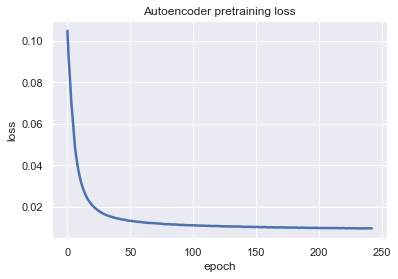

  0%|          | 0/8000 [00:00<?, ?it/s]

Stop traing for tolerance threshold reached
Iter: 889 loss=0.010042363777756691


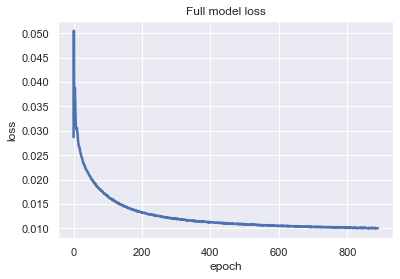

Training Done

F1 by Known Clusters: 0.2848


<Figure size 432x288 with 0 Axes>

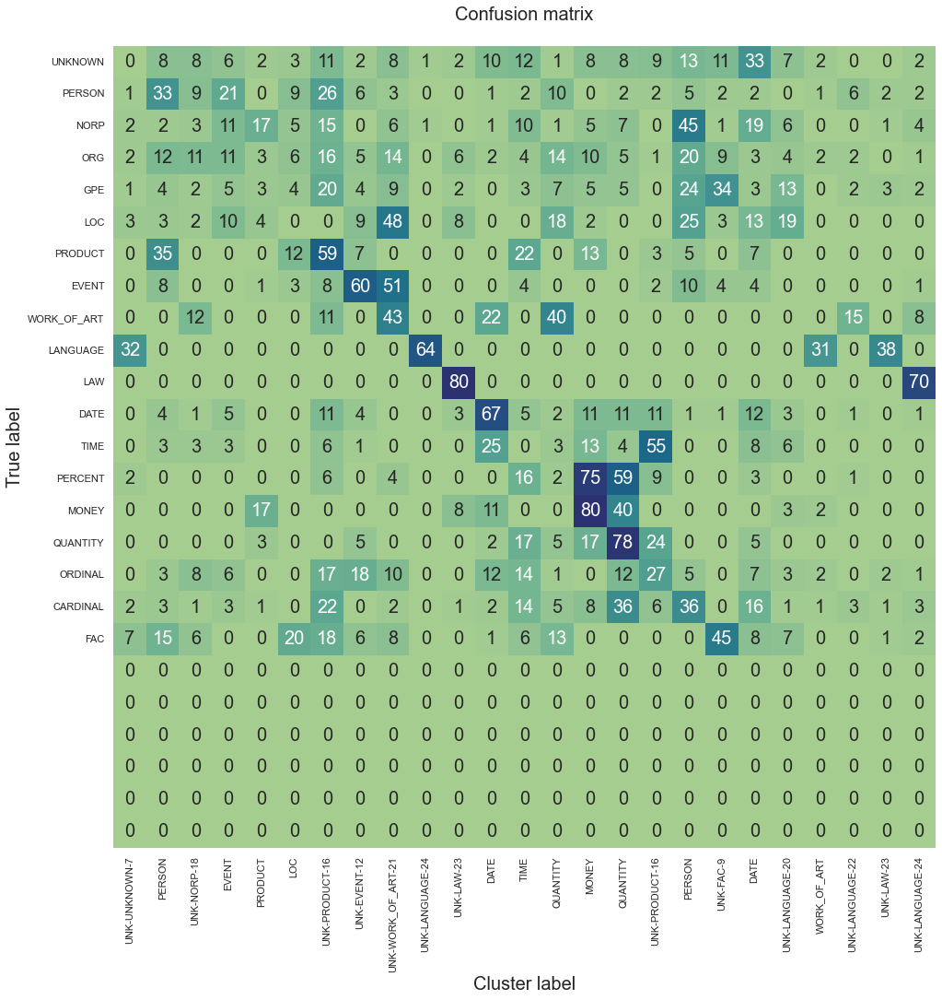

F1 score (macro) = 0.4499
Accuracy = 0.4077
Precision = 0.6887
Recall = 0.4085
New clusters =      2
... wrote results to c:\Users\Will\Projects\MSc\project\src\results\test-train_size=3000-radius=0-latent_weight=1e-05-reconstr_weight=0.9-head=z-cluster=Kmeans-entity_count=15-noise_factor=0.1-\index.html
Finished 'evaluate_model' in 34.378 secs
--------------------------------------------------
5/60: test-train_size=3000-radius=0-latent_weight=0.0001-reconstr_weight=0.1-head=z-cluster=Kmeans-entity_count=15-noise_factor=0.1-
--------------------------------------------------
{'train_size': 3000, 'radius': 0, 'latent_weight': 0.0001, 'reconstr_weight': 0.1, 'head': 'z', 'cluster': 'Kmeans', 'entity_count': 15, 'noise_factor': 0.1}
ERROR: Invalid config key <module 'tensorflow.keras' from 'c:\\Users\\Will\\Anaconda3\\envs\\tf-27\\lib\\site-packages\\keras\\api\\_v2\\keras\\__init__.py'>
Autoencoder
Latent Model
model compiled
Epoch 233: early stopping


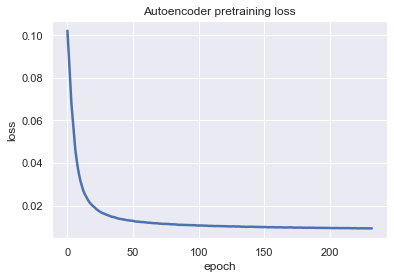

  0%|          | 0/8000 [00:00<?, ?it/s]

Stop traing for tolerance threshold reached
Iter: 90 loss=0.0013796596322208643


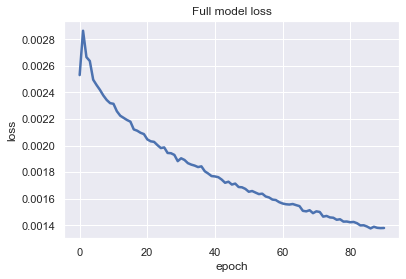

Training Done

F1 by Known Clusters: 0.1650


<Figure size 432x288 with 0 Axes>

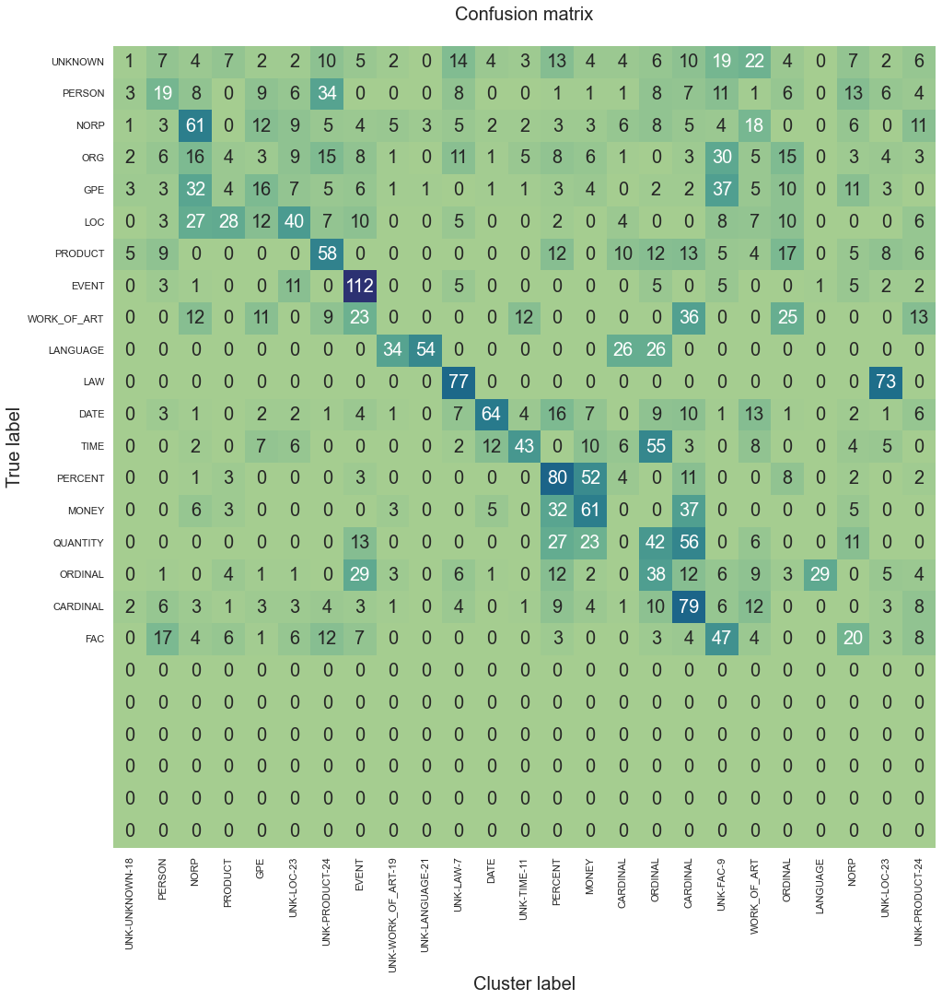

F1 score (macro) = 0.5013
Accuracy = 0.4257
Precision = 0.8465
Recall = 0.4318
New clusters =      3
... wrote results to c:\Users\Will\Projects\MSc\project\src\results\test-train_size=3000-radius=0-latent_weight=0.0001-reconstr_weight=0.1-head=z-cluster=Kmeans-entity_count=15-noise_factor=0.1-\index.html
Finished 'evaluate_model' in 32.883 secs
--------------------------------------------------
6/60: test-train_size=3000-radius=0-latent_weight=0.0001-reconstr_weight=0.25-head=z-cluster=Kmeans-entity_count=15-noise_factor=0.1-
--------------------------------------------------
{'train_size': 3000, 'radius': 0, 'latent_weight': 0.0001, 'reconstr_weight': 0.25, 'head': 'z', 'cluster': 'Kmeans', 'entity_count': 15, 'noise_factor': 0.1}
ERROR: Invalid config key <module 'tensorflow.keras' from 'c:\\Users\\Will\\Anaconda3\\envs\\tf-27\\lib\\site-packages\\keras\\api\\_v2\\keras\\__init__.py'>
Autoencoder
Latent Model
model compiled
Epoch 220: early stopping


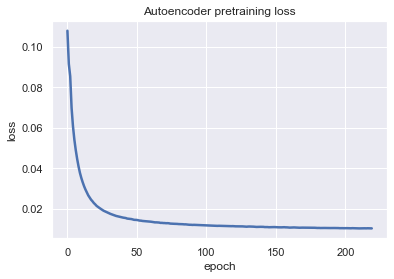

  0%|          | 0/8000 [00:00<?, ?it/s]

Stop traing for tolerance threshold reached
Iter: 228 loss=0.0032000436913222075


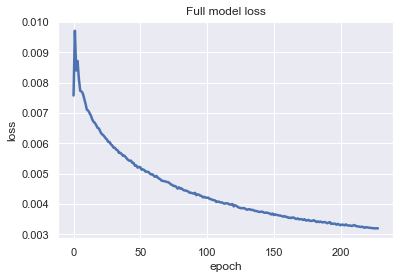

Training Done

F1 by Known Clusters: 0.1962


<Figure size 432x288 with 0 Axes>

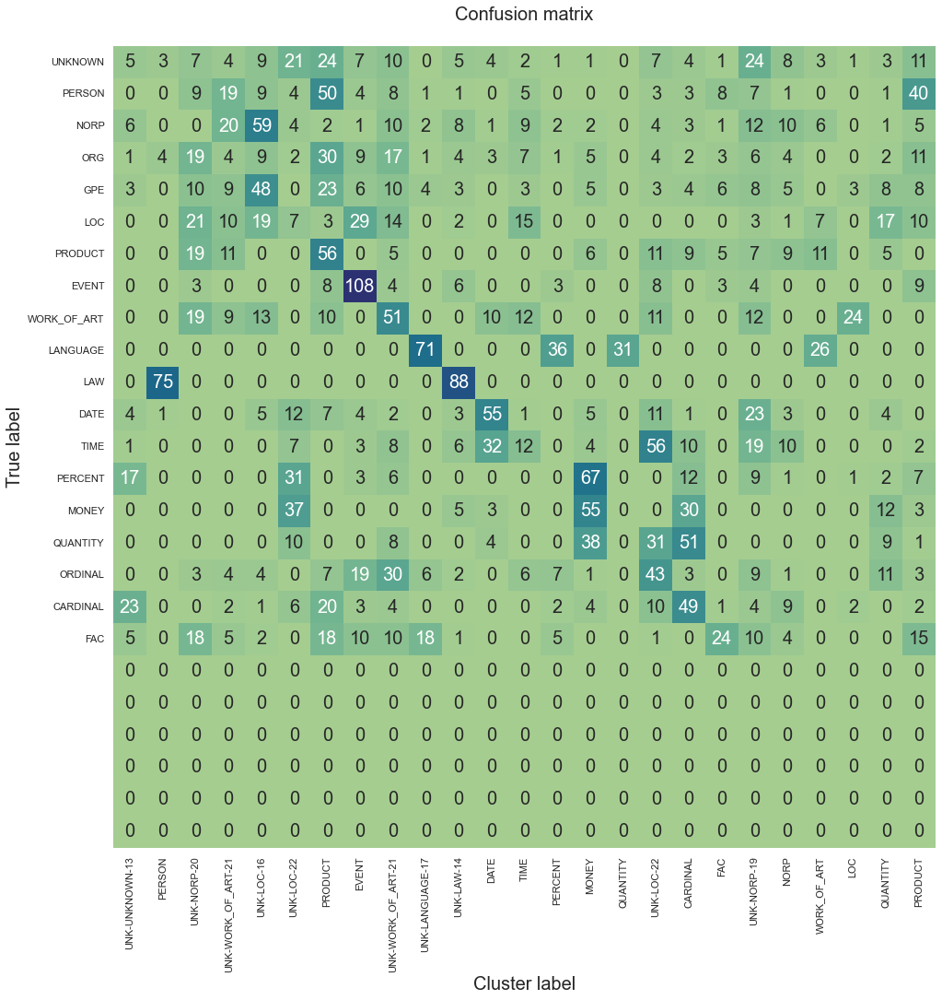

F1 score (macro) = 0.4640
Accuracy = 0.4087
Precision = 0.7940
Recall = 0.4030
New clusters =      3
... wrote results to c:\Users\Will\Projects\MSc\project\src\results\test-train_size=3000-radius=0-latent_weight=0.0001-reconstr_weight=0.25-head=z-cluster=Kmeans-entity_count=15-noise_factor=0.1-\index.html
Finished 'evaluate_model' in 33.666 secs
--------------------------------------------------
7/60: test-train_size=3000-radius=0-latent_weight=0.0001-reconstr_weight=0.5-head=z-cluster=Kmeans-entity_count=15-noise_factor=0.1-
--------------------------------------------------
{'train_size': 3000, 'radius': 0, 'latent_weight': 0.0001, 'reconstr_weight': 0.5, 'head': 'z', 'cluster': 'Kmeans', 'entity_count': 15, 'noise_factor': 0.1}
ERROR: Invalid config key <module 'tensorflow.keras' from 'c:\\Users\\Will\\Anaconda3\\envs\\tf-27\\lib\\site-packages\\keras\\api\\_v2\\keras\\__init__.py'>
Autoencoder
Latent Model
model compiled
Epoch 220: early stopping


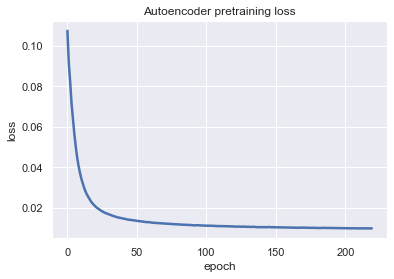

  0%|          | 0/8000 [00:00<?, ?it/s]

Stop traing for tolerance threshold reached
Iter: 390 loss=0.005757320672273636


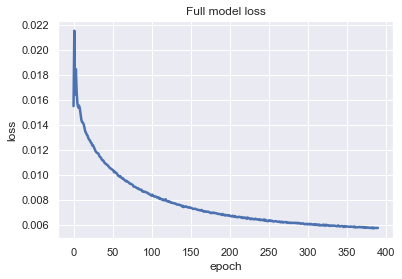

Training Done

F1 by Known Clusters: 0.1719


<Figure size 432x288 with 0 Axes>

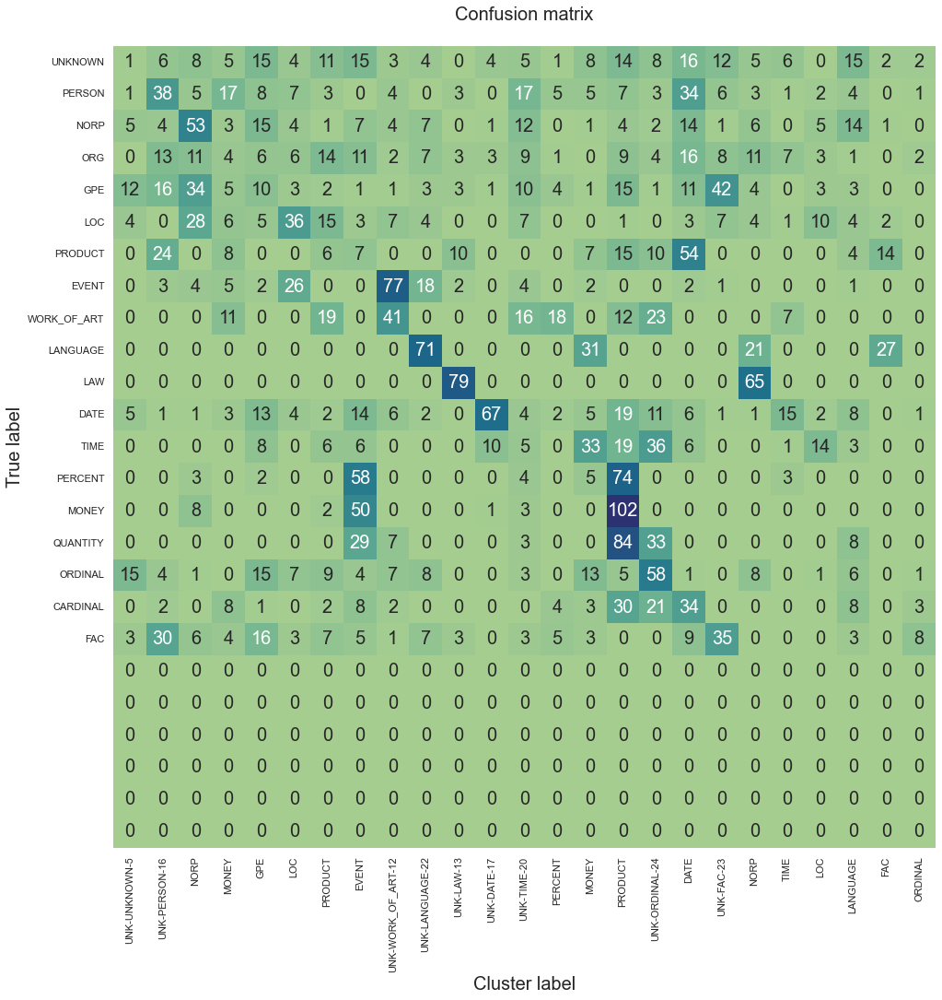

F1 score (macro) = 0.4562
Accuracy = 0.3897
Precision = 0.7939
Recall = 0.3855
New clusters =      2
... wrote results to c:\Users\Will\Projects\MSc\project\src\results\test-train_size=3000-radius=0-latent_weight=0.0001-reconstr_weight=0.5-head=z-cluster=Kmeans-entity_count=15-noise_factor=0.1-\index.html
Finished 'evaluate_model' in 34.358 secs
--------------------------------------------------
8/60: test-train_size=3000-radius=0-latent_weight=0.0001-reconstr_weight=0.75-head=z-cluster=Kmeans-entity_count=15-noise_factor=0.1-
--------------------------------------------------
{'train_size': 3000, 'radius': 0, 'latent_weight': 0.0001, 'reconstr_weight': 0.75, 'head': 'z', 'cluster': 'Kmeans', 'entity_count': 15, 'noise_factor': 0.1}
ERROR: Invalid config key <module 'tensorflow.keras' from 'c:\\Users\\Will\\Anaconda3\\envs\\tf-27\\lib\\site-packages\\keras\\api\\_v2\\keras\\__init__.py'>
Autoencoder
Latent Model
model compiled
Epoch 222: early stopping


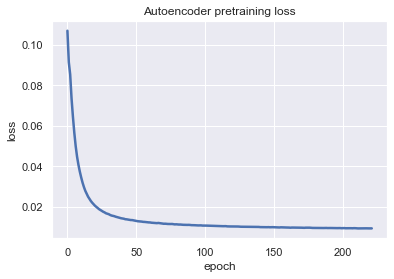

  0%|          | 0/8000 [00:00<?, ?it/s]

Stop traing for tolerance threshold reached
Iter: 697 loss=0.008053511381149292


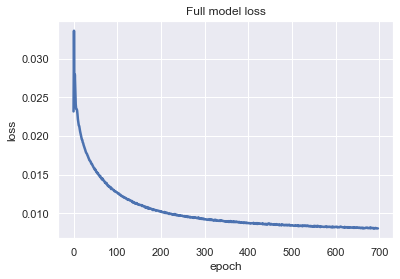

Training Done

F1 by Known Clusters: 0.1589


<Figure size 432x288 with 0 Axes>

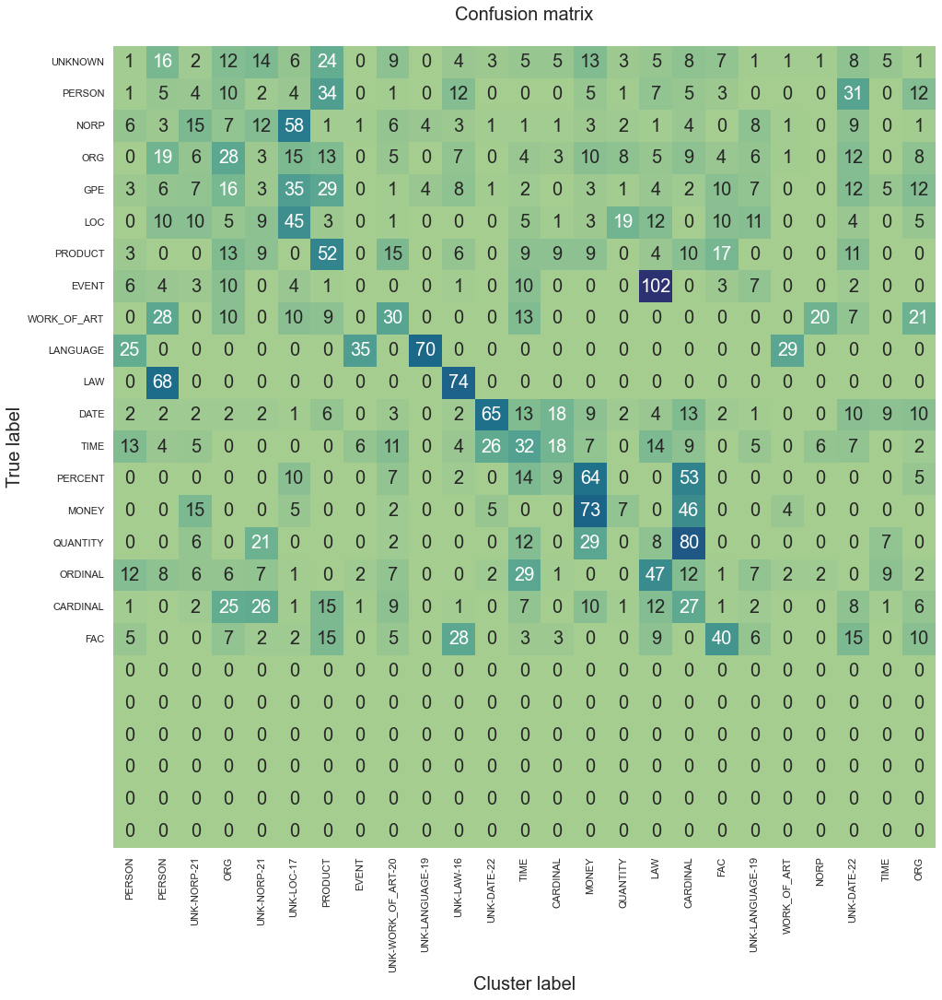

F1 score (macro) = 0.4584
Accuracy = 0.3950
Precision = 0.7936
Recall = 0.4017
New clusters =      3
... wrote results to c:\Users\Will\Projects\MSc\project\src\results\test-train_size=3000-radius=0-latent_weight=0.0001-reconstr_weight=0.75-head=z-cluster=Kmeans-entity_count=15-noise_factor=0.1-\index.html
Finished 'evaluate_model' in 34.451 secs
--------------------------------------------------
9/60: test-train_size=3000-radius=0-latent_weight=0.0001-reconstr_weight=0.9-head=z-cluster=Kmeans-entity_count=15-noise_factor=0.1-
--------------------------------------------------
{'train_size': 3000, 'radius': 0, 'latent_weight': 0.0001, 'reconstr_weight': 0.9, 'head': 'z', 'cluster': 'Kmeans', 'entity_count': 15, 'noise_factor': 0.1}
ERROR: Invalid config key <module 'tensorflow.keras' from 'c:\\Users\\Will\\Anaconda3\\envs\\tf-27\\lib\\site-packages\\keras\\api\\_v2\\keras\\__init__.py'>
Autoencoder
Latent Model
model compiled
Epoch 212: early stopping


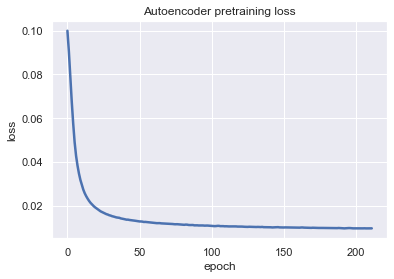

  0%|          | 0/8000 [00:00<?, ?it/s]

Stop traing for tolerance threshold reached
Iter: 372 loss=0.010806993581354618


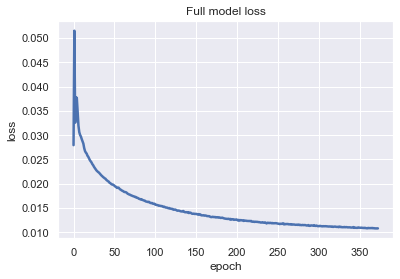

Training Done

F1 by Known Clusters: 0.2144


<Figure size 432x288 with 0 Axes>

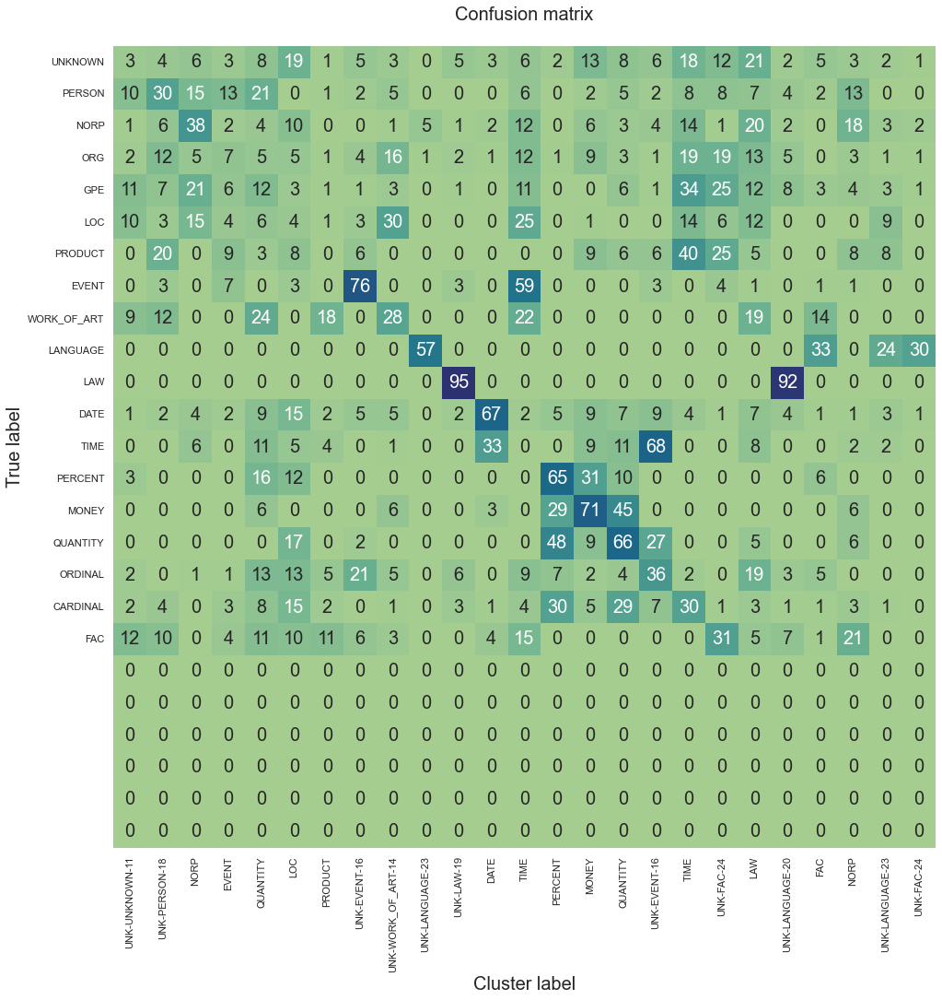

F1 score (macro) = 0.4539
Accuracy = 0.4063
Precision = 0.7412
Recall = 0.4010
New clusters =      3
... wrote results to c:\Users\Will\Projects\MSc\project\src\results\test-train_size=3000-radius=0-latent_weight=0.0001-reconstr_weight=0.9-head=z-cluster=Kmeans-entity_count=15-noise_factor=0.1-\index.html
Finished 'evaluate_model' in 34.105 secs
--------------------------------------------------
10/60: test-train_size=3000-radius=0-latent_weight=0.001-reconstr_weight=0.1-head=z-cluster=Kmeans-entity_count=15-noise_factor=0.1-
--------------------------------------------------
{'train_size': 3000, 'radius': 0, 'latent_weight': 0.001, 'reconstr_weight': 0.1, 'head': 'z', 'cluster': 'Kmeans', 'entity_count': 15, 'noise_factor': 0.1}
ERROR: Invalid config key <module 'tensorflow.keras' from 'c:\\Users\\Will\\Anaconda3\\envs\\tf-27\\lib\\site-packages\\keras\\api\\_v2\\keras\\__init__.py'>
Autoencoder
Latent Model
model compiled
Epoch 228: early stopping


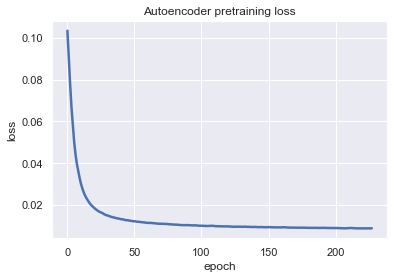

  0%|          | 0/8000 [00:00<?, ?it/s]

Stop traing for tolerance threshold reached
Iter: 1486 loss=-0.003806076943874359


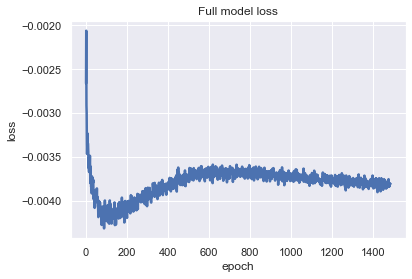

Training Done

F1 by Known Clusters: 0.1327


<Figure size 432x288 with 0 Axes>

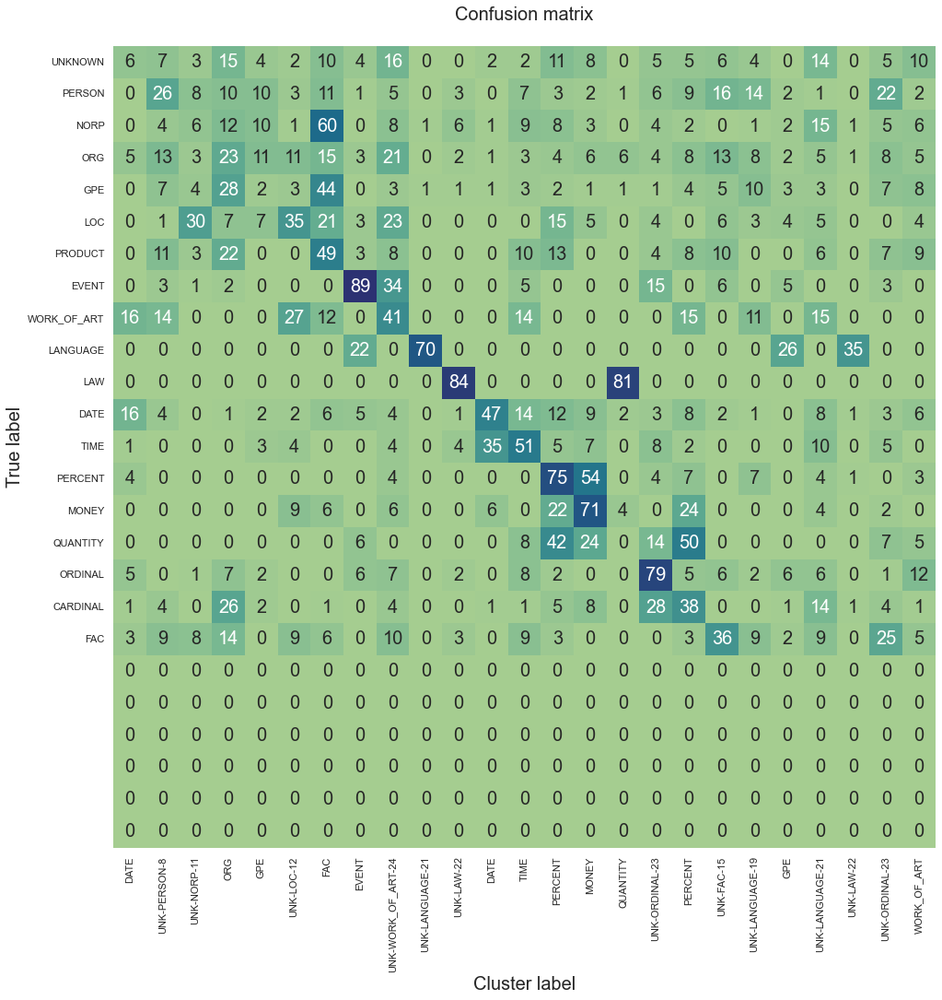

F1 score (macro) = 0.4902
Accuracy = 0.4153
Precision = 0.8460
Recall = 0.4181
New clusters =      3
... wrote results to c:\Users\Will\Projects\MSc\project\src\results\test-train_size=3000-radius=0-latent_weight=0.001-reconstr_weight=0.1-head=z-cluster=Kmeans-entity_count=15-noise_factor=0.1-\index.html
Finished 'evaluate_model' in 34.389 secs
--------------------------------------------------
11/60: test-train_size=3000-radius=0-latent_weight=0.001-reconstr_weight=0.25-head=z-cluster=Kmeans-entity_count=15-noise_factor=0.1-
--------------------------------------------------
{'train_size': 3000, 'radius': 0, 'latent_weight': 0.001, 'reconstr_weight': 0.25, 'head': 'z', 'cluster': 'Kmeans', 'entity_count': 15, 'noise_factor': 0.1}
ERROR: Invalid config key <module 'tensorflow.keras' from 'c:\\Users\\Will\\Anaconda3\\envs\\tf-27\\lib\\site-packages\\keras\\api\\_v2\\keras\\__init__.py'>
Autoencoder
Latent Model
model compiled
Epoch 156: early stopping


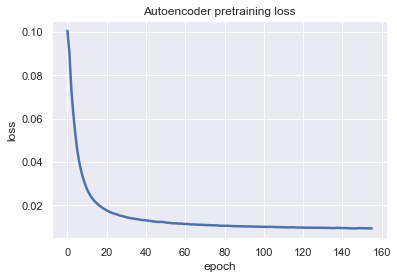

  0%|          | 0/8000 [00:00<?, ?it/s]

Stop traing for tolerance threshold reached
Iter: 1278 loss=-0.00123032764531672


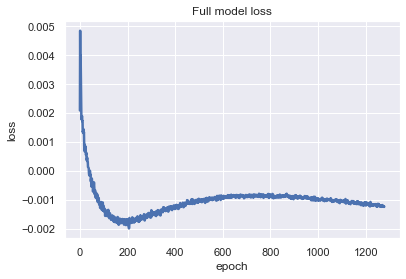

Training Done

F1 by Known Clusters: 0.2417


<Figure size 432x288 with 0 Axes>

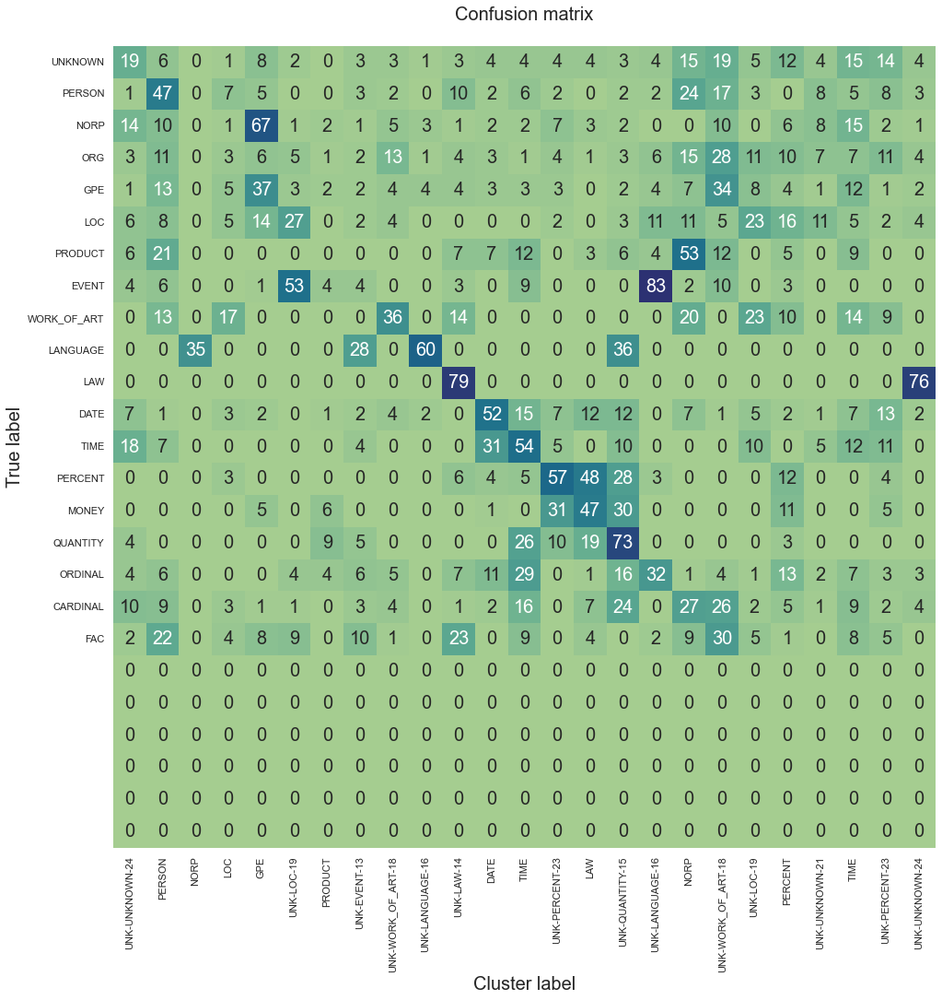

F1 score (macro) = 0.4341
Accuracy = 0.3893
Precision = 0.6884
Recall = 0.3834
New clusters =      6
... wrote results to c:\Users\Will\Projects\MSc\project\src\results\test-train_size=3000-radius=0-latent_weight=0.001-reconstr_weight=0.25-head=z-cluster=Kmeans-entity_count=15-noise_factor=0.1-\index.html
Finished 'evaluate_model' in 34.988 secs
--------------------------------------------------
12/60: test-train_size=3000-radius=0-latent_weight=0.001-reconstr_weight=0.5-head=z-cluster=Kmeans-entity_count=15-noise_factor=0.1-
--------------------------------------------------
{'train_size': 3000, 'radius': 0, 'latent_weight': 0.001, 'reconstr_weight': 0.5, 'head': 'z', 'cluster': 'Kmeans', 'entity_count': 15, 'noise_factor': 0.1}
ERROR: Invalid config key <module 'tensorflow.keras' from 'c:\\Users\\Will\\Anaconda3\\envs\\tf-27\\lib\\site-packages\\keras\\api\\_v2\\keras\\__init__.py'>
Autoencoder
Latent Model
model compiled
Epoch 284: early stopping


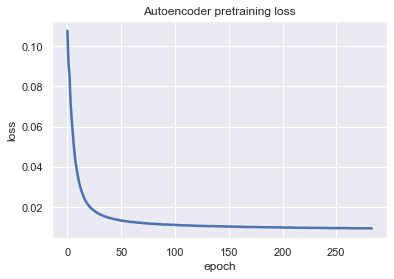

  0%|          | 0/8000 [00:00<?, ?it/s]

Stop traing for tolerance threshold reached
Iter: 6028 loss=0.0024890454951673746


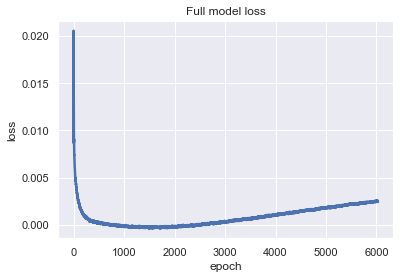

Training Done

F1 by Known Clusters: 0.1747


<Figure size 432x288 with 0 Axes>

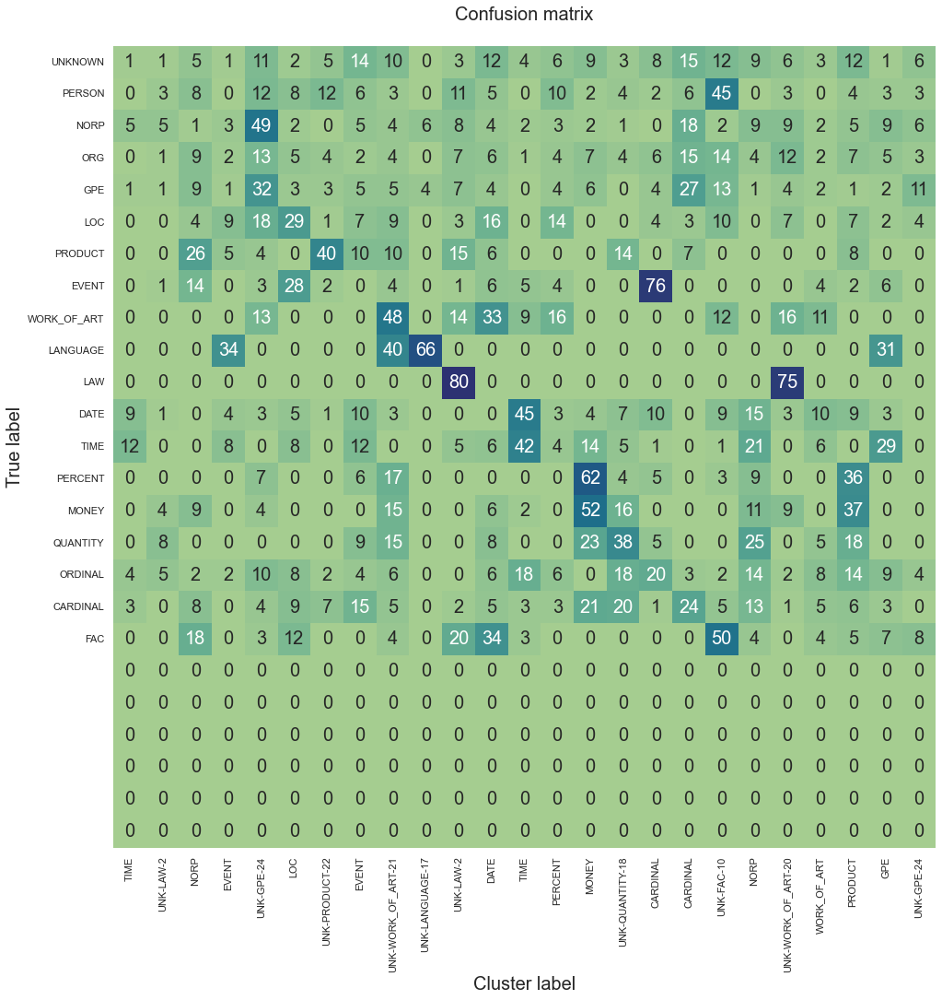

F1 score (macro) = 0.4260
Accuracy = 0.3680
Precision = 0.7935
Recall = 0.3655
New clusters =      4
... wrote results to c:\Users\Will\Projects\MSc\project\src\results\test-train_size=3000-radius=0-latent_weight=0.001-reconstr_weight=0.5-head=z-cluster=Kmeans-entity_count=15-noise_factor=0.1-\index.html
Finished 'evaluate_model' in 35.473 secs
--------------------------------------------------
13/60: test-train_size=3000-radius=0-latent_weight=0.001-reconstr_weight=0.75-head=z-cluster=Kmeans-entity_count=15-noise_factor=0.1-
--------------------------------------------------
{'train_size': 3000, 'radius': 0, 'latent_weight': 0.001, 'reconstr_weight': 0.75, 'head': 'z', 'cluster': 'Kmeans', 'entity_count': 15, 'noise_factor': 0.1}
ERROR: Invalid config key <module 'tensorflow.keras' from 'c:\\Users\\Will\\Anaconda3\\envs\\tf-27\\lib\\site-packages\\keras\\api\\_v2\\keras\\__init__.py'>
Autoencoder
Latent Model
model compiled
Epoch 261: early stopping


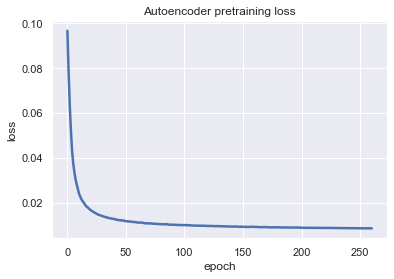

  0%|          | 0/8000 [00:00<?, ?it/s]

Stop traing for tolerance threshold reached
Iter: 3159 loss=0.0038508563302457333


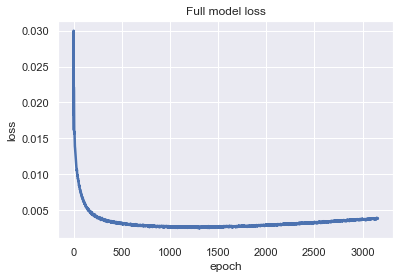

Training Done

F1 by Known Clusters: 0.2067


<Figure size 432x288 with 0 Axes>

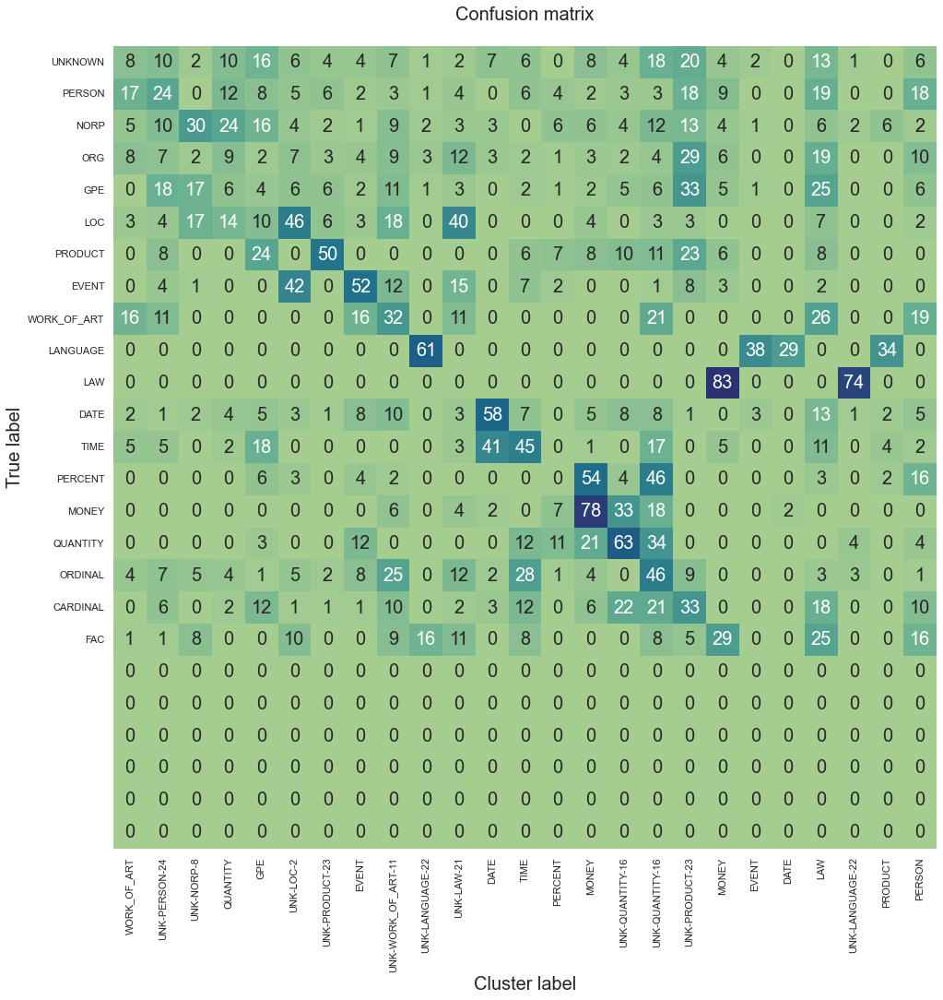

F1 score (macro) = 0.4546
Accuracy = 0.3987
Precision = 0.7411
Recall = 0.3966
New clusters =      4
... wrote results to c:\Users\Will\Projects\MSc\project\src\results\test-train_size=3000-radius=0-latent_weight=0.001-reconstr_weight=0.75-head=z-cluster=Kmeans-entity_count=15-noise_factor=0.1-\index.html
Finished 'evaluate_model' in 33.656 secs
--------------------------------------------------
14/60: test-train_size=3000-radius=0-latent_weight=0.001-reconstr_weight=0.9-head=z-cluster=Kmeans-entity_count=15-noise_factor=0.1-
--------------------------------------------------
{'train_size': 3000, 'radius': 0, 'latent_weight': 0.001, 'reconstr_weight': 0.9, 'head': 'z', 'cluster': 'Kmeans', 'entity_count': 15, 'noise_factor': 0.1}
ERROR: Invalid config key <module 'tensorflow.keras' from 'c:\\Users\\Will\\Anaconda3\\envs\\tf-27\\lib\\site-packages\\keras\\api\\_v2\\keras\\__init__.py'>
Autoencoder
Latent Model
model compiled
Epoch 289: early stopping


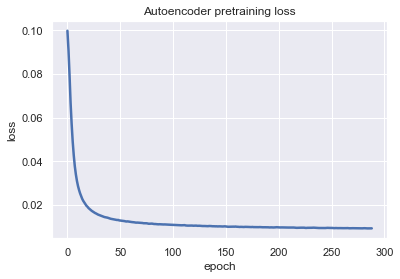

  0%|          | 0/8000 [00:00<?, ?it/s]

Stop traing for tolerance threshold reached
Iter: 3171 loss=0.005385163705796003


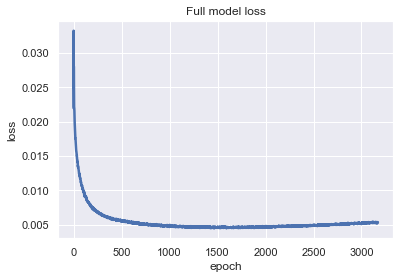

Training Done

F1 by Known Clusters: 0.2190


<Figure size 432x288 with 0 Axes>

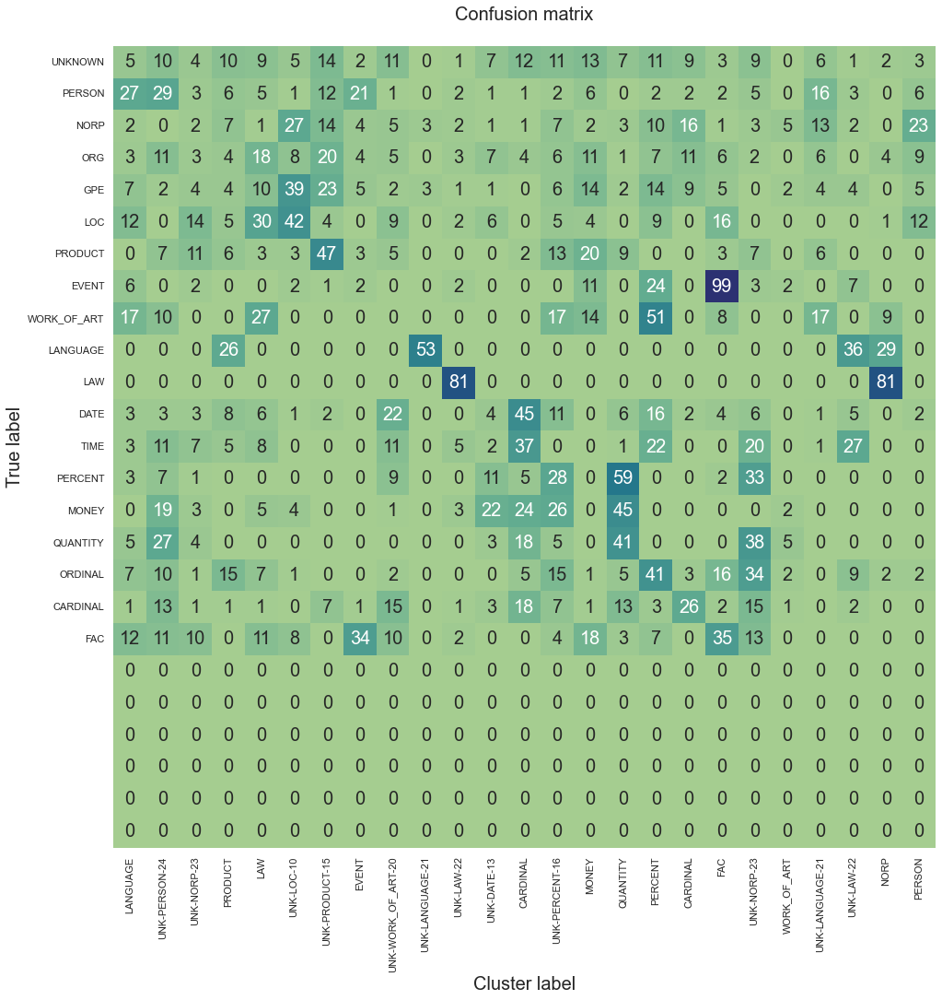

F1 score (macro) = 0.4293
Accuracy = 0.3733
Precision = 0.7411
Recall = 0.3745
New clusters =      3
... wrote results to c:\Users\Will\Projects\MSc\project\src\results\test-train_size=3000-radius=0-latent_weight=0.001-reconstr_weight=0.9-head=z-cluster=Kmeans-entity_count=15-noise_factor=0.1-\index.html
Finished 'evaluate_model' in 34.373 secs
--------------------------------------------------
15/60: test-train_size=3000-radius=0-latent_weight=0.01-reconstr_weight=0.1-head=z-cluster=Kmeans-entity_count=15-noise_factor=0.1-
--------------------------------------------------
{'train_size': 3000, 'radius': 0, 'latent_weight': 0.01, 'reconstr_weight': 0.1, 'head': 'z', 'cluster': 'Kmeans', 'entity_count': 15, 'noise_factor': 0.1}
ERROR: Invalid config key <module 'tensorflow.keras' from 'c:\\Users\\Will\\Anaconda3\\envs\\tf-27\\lib\\site-packages\\keras\\api\\_v2\\keras\\__init__.py'>
Autoencoder
Latent Model
model compiled
Epoch 279: early stopping


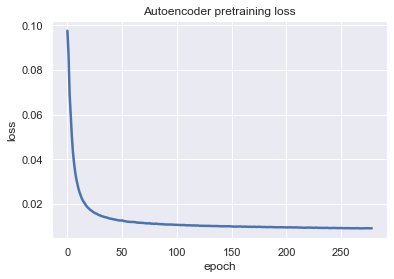

  0%|          | 0/8000 [00:00<?, ?it/s]

Iter: 7999 loss=-0.022901667281985283


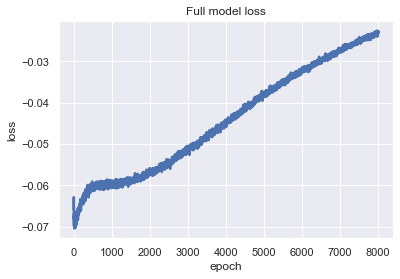

Training Done

F1 by Known Clusters: 0.1821


<Figure size 432x288 with 0 Axes>

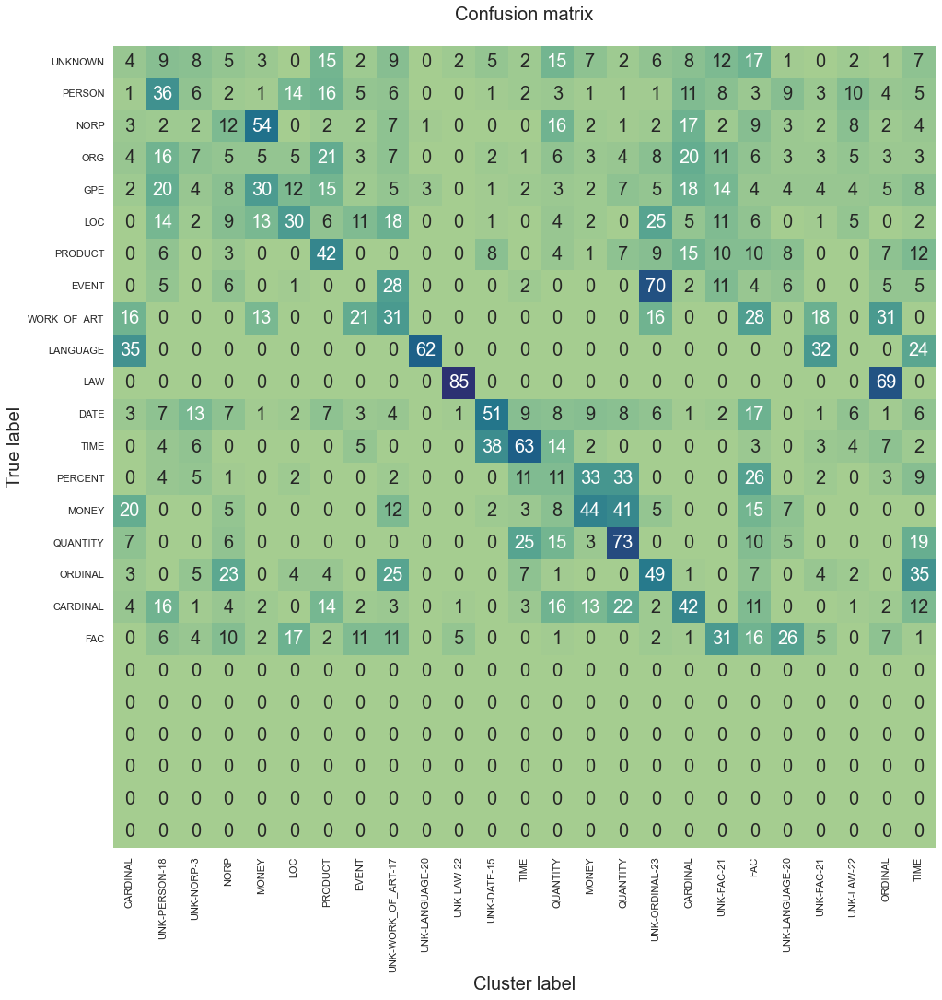

F1 score (macro) = 0.4633
Accuracy = 0.3880
Precision = 0.7933
Recall = 0.3939
New clusters =      5
... wrote results to c:\Users\Will\Projects\MSc\project\src\results\test-train_size=3000-radius=0-latent_weight=0.01-reconstr_weight=0.1-head=z-cluster=Kmeans-entity_count=15-noise_factor=0.1-\index.html
Finished 'evaluate_model' in 35.095 secs
--------------------------------------------------
16/60: test-train_size=3000-radius=0-latent_weight=0.01-reconstr_weight=0.25-head=z-cluster=Kmeans-entity_count=15-noise_factor=0.1-
--------------------------------------------------
{'train_size': 3000, 'radius': 0, 'latent_weight': 0.01, 'reconstr_weight': 0.25, 'head': 'z', 'cluster': 'Kmeans', 'entity_count': 15, 'noise_factor': 0.1}
ERROR: Invalid config key <module 'tensorflow.keras' from 'c:\\Users\\Will\\Anaconda3\\envs\\tf-27\\lib\\site-packages\\keras\\api\\_v2\\keras\\__init__.py'>
Autoencoder
Latent Model
model compiled
Epoch 267: early stopping


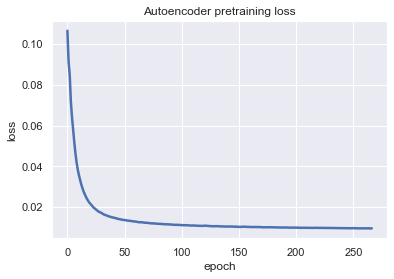

  0%|          | 0/8000 [00:00<?, ?it/s]

Iter: 7999 loss=-0.02225874923169613


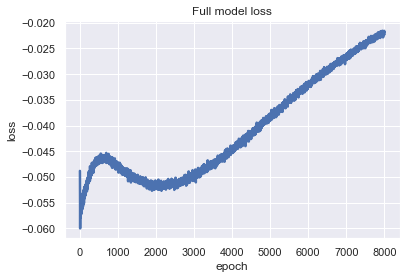

Training Done

F1 by Known Clusters: 0.2292


<Figure size 432x288 with 0 Axes>

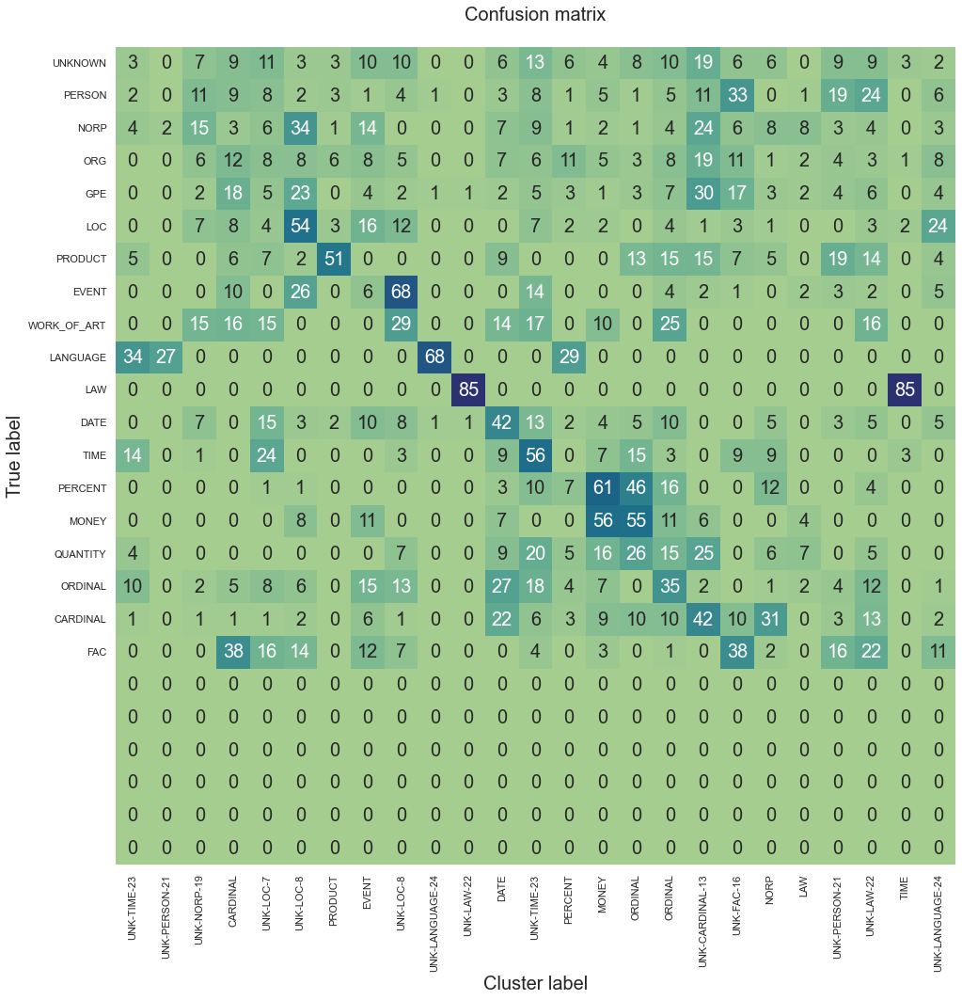

F1 score (macro) = 0.4430
Accuracy = 0.3953
Precision = 0.7410
Recall = 0.3888
New clusters =      5
... wrote results to c:\Users\Will\Projects\MSc\project\src\results\test-train_size=3000-radius=0-latent_weight=0.01-reconstr_weight=0.25-head=z-cluster=Kmeans-entity_count=15-noise_factor=0.1-\index.html
Finished 'evaluate_model' in 35.475 secs
--------------------------------------------------
17/60: test-train_size=3000-radius=0-latent_weight=0.01-reconstr_weight=0.5-head=z-cluster=Kmeans-entity_count=15-noise_factor=0.1-
--------------------------------------------------
{'train_size': 3000, 'radius': 0, 'latent_weight': 0.01, 'reconstr_weight': 0.5, 'head': 'z', 'cluster': 'Kmeans', 'entity_count': 15, 'noise_factor': 0.1}
ERROR: Invalid config key <module 'tensorflow.keras' from 'c:\\Users\\Will\\Anaconda3\\envs\\tf-27\\lib\\site-packages\\keras\\api\\_v2\\keras\\__init__.py'>
Autoencoder
Latent Model
model compiled
Epoch 208: early stopping


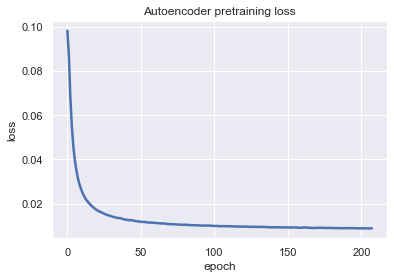

  0%|          | 0/8000 [00:00<?, ?it/s]

Iter: 7999 loss=-0.011404519900679588


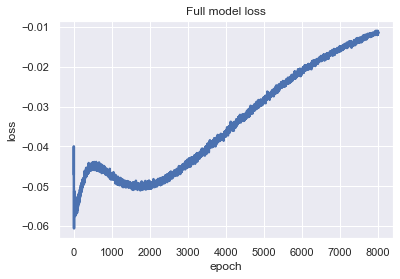

Training Done

F1 by Known Clusters: 0.2513


<Figure size 432x288 with 0 Axes>

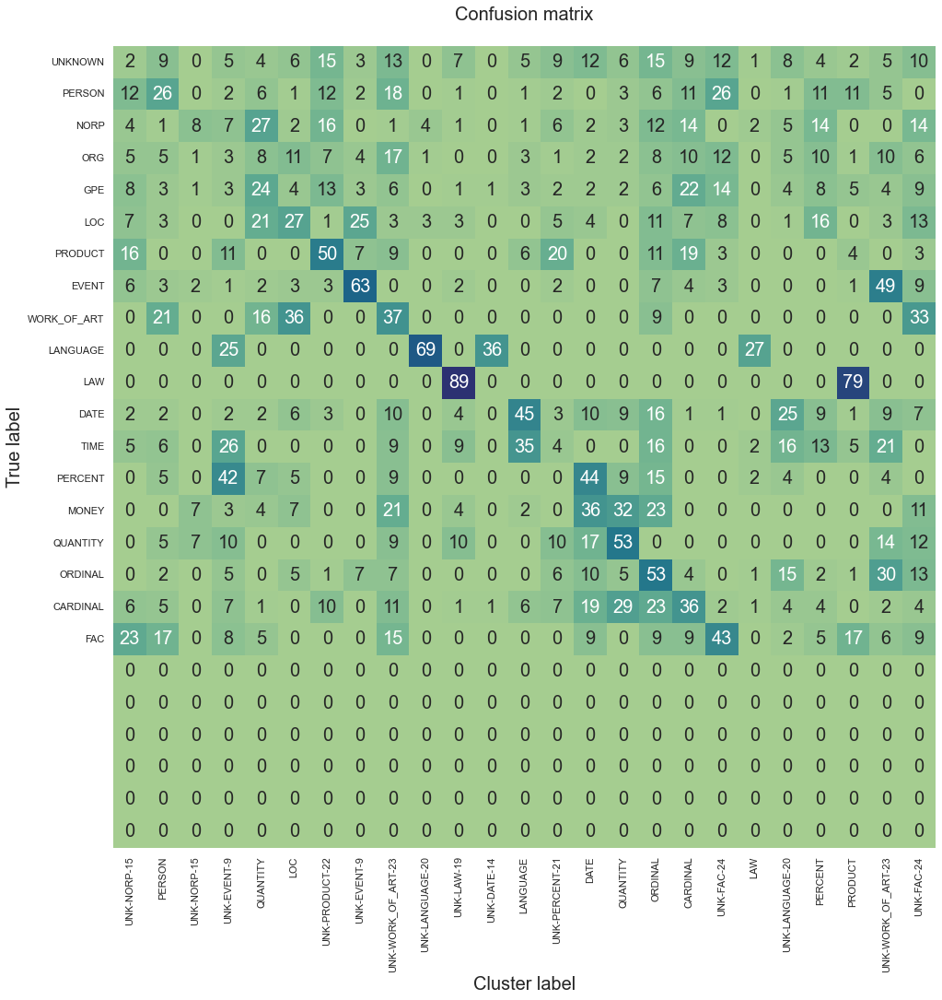

F1 score (macro) = 0.4421
Accuracy = 0.3970
Precision = 0.7412
Recall = 0.3919
New clusters =      6
... wrote results to c:\Users\Will\Projects\MSc\project\src\results\test-train_size=3000-radius=0-latent_weight=0.01-reconstr_weight=0.5-head=z-cluster=Kmeans-entity_count=15-noise_factor=0.1-\index.html
Finished 'evaluate_model' in 35.616 secs
--------------------------------------------------
18/60: test-train_size=3000-radius=0-latent_weight=0.01-reconstr_weight=0.75-head=z-cluster=Kmeans-entity_count=15-noise_factor=0.1-
--------------------------------------------------
{'train_size': 3000, 'radius': 0, 'latent_weight': 0.01, 'reconstr_weight': 0.75, 'head': 'z', 'cluster': 'Kmeans', 'entity_count': 15, 'noise_factor': 0.1}
ERROR: Invalid config key <module 'tensorflow.keras' from 'c:\\Users\\Will\\Anaconda3\\envs\\tf-27\\lib\\site-packages\\keras\\api\\_v2\\keras\\__init__.py'>
Autoencoder
Latent Model
model compiled
Epoch 203: early stopping


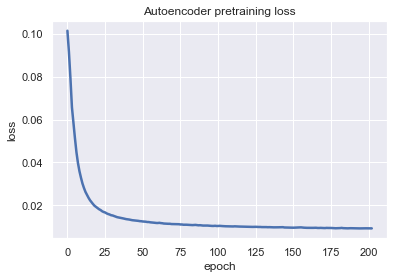

  0%|          | 0/8000 [00:00<?, ?it/s]

Iter: 7999 loss=-0.012773803435266018


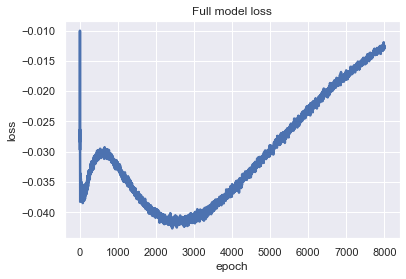

Training Done

F1 by Known Clusters: 0.1923


<Figure size 432x288 with 0 Axes>

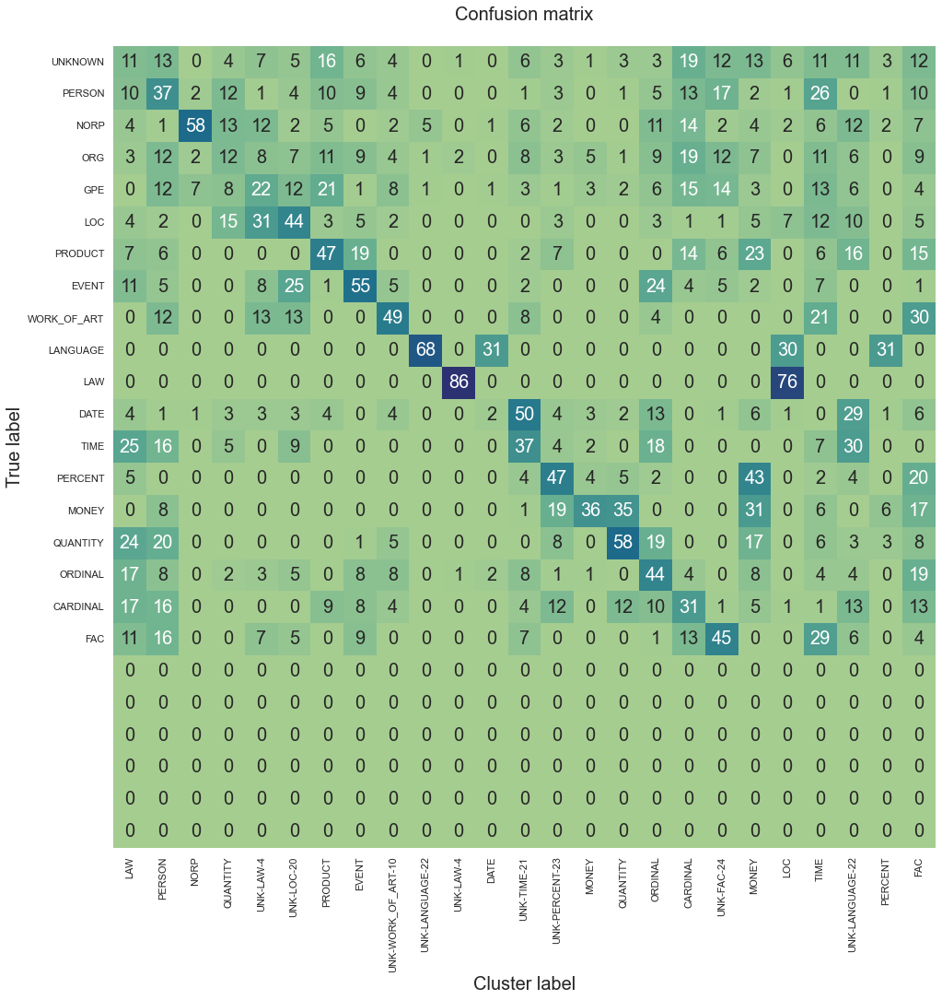

F1 score (macro) = 0.4991
Accuracy = 0.4220
Precision = 0.8468
Recall = 0.4232
New clusters =      4
... wrote results to c:\Users\Will\Projects\MSc\project\src\results\test-train_size=3000-radius=0-latent_weight=0.01-reconstr_weight=0.75-head=z-cluster=Kmeans-entity_count=15-noise_factor=0.1-\index.html
Finished 'evaluate_model' in 35.015 secs
--------------------------------------------------
19/60: test-train_size=3000-radius=0-latent_weight=0.01-reconstr_weight=0.9-head=z-cluster=Kmeans-entity_count=15-noise_factor=0.1-
--------------------------------------------------
{'train_size': 3000, 'radius': 0, 'latent_weight': 0.01, 'reconstr_weight': 0.9, 'head': 'z', 'cluster': 'Kmeans', 'entity_count': 15, 'noise_factor': 0.1}
ERROR: Invalid config key <module 'tensorflow.keras' from 'c:\\Users\\Will\\Anaconda3\\envs\\tf-27\\lib\\site-packages\\keras\\api\\_v2\\keras\\__init__.py'>
Autoencoder
Latent Model
model compiled
Epoch 243: early stopping


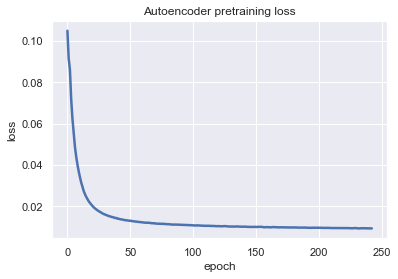

  0%|          | 0/8000 [00:00<?, ?it/s]

Iter: 7999 loss=-0.007716349326074123


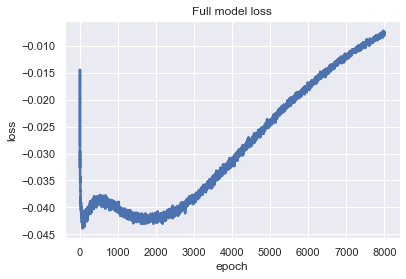

Training Done

F1 by Known Clusters: 0.3067


<Figure size 432x288 with 0 Axes>

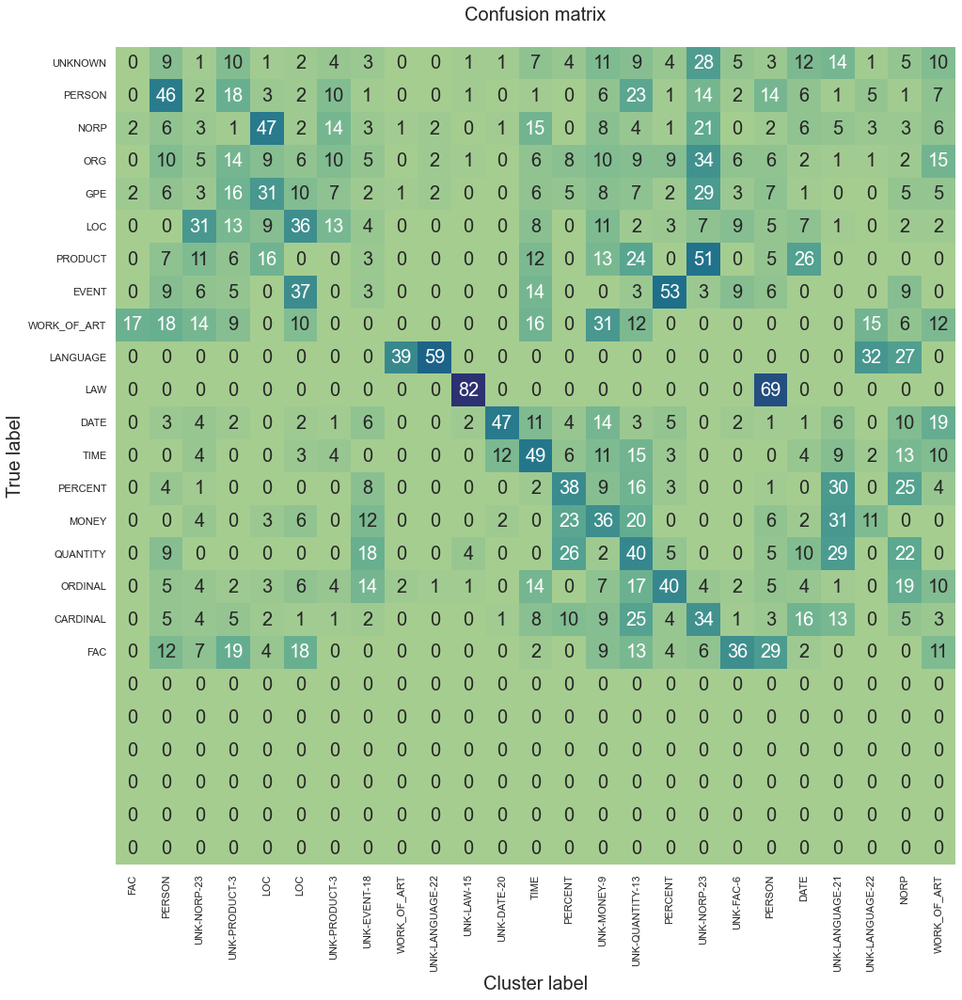

F1 score (macro) = 0.4286
Accuracy = 0.3693
Precision = 0.7406
Recall = 0.3760
New clusters =      3
... wrote results to c:\Users\Will\Projects\MSc\project\src\results\test-train_size=3000-radius=0-latent_weight=0.01-reconstr_weight=0.9-head=z-cluster=Kmeans-entity_count=15-noise_factor=0.1-\index.html
Finished 'evaluate_model' in 34.908 secs
--------------------------------------------------
20/60: test-train_size=3000-radius=0-latent_weight=0.1-reconstr_weight=0.1-head=z-cluster=Kmeans-entity_count=15-noise_factor=0.1-
--------------------------------------------------
{'train_size': 3000, 'radius': 0, 'latent_weight': 0.1, 'reconstr_weight': 0.1, 'head': 'z', 'cluster': 'Kmeans', 'entity_count': 15, 'noise_factor': 0.1}
ERROR: Invalid config key <module 'tensorflow.keras' from 'c:\\Users\\Will\\Anaconda3\\envs\\tf-27\\lib\\site-packages\\keras\\api\\_v2\\keras\\__init__.py'>
Autoencoder
Latent Model
model compiled
Epoch 253: early stopping


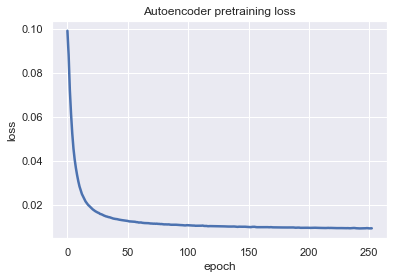

  0%|          | 0/8000 [00:00<?, ?it/s]

Iter: 7999 loss=-0.2930827736854553


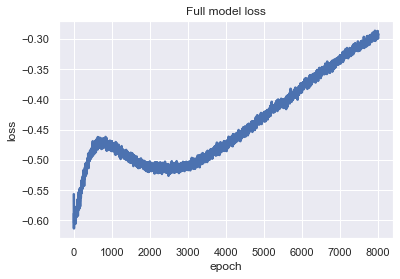

Training Done

F1 by Known Clusters: 0.2988


<Figure size 432x288 with 0 Axes>

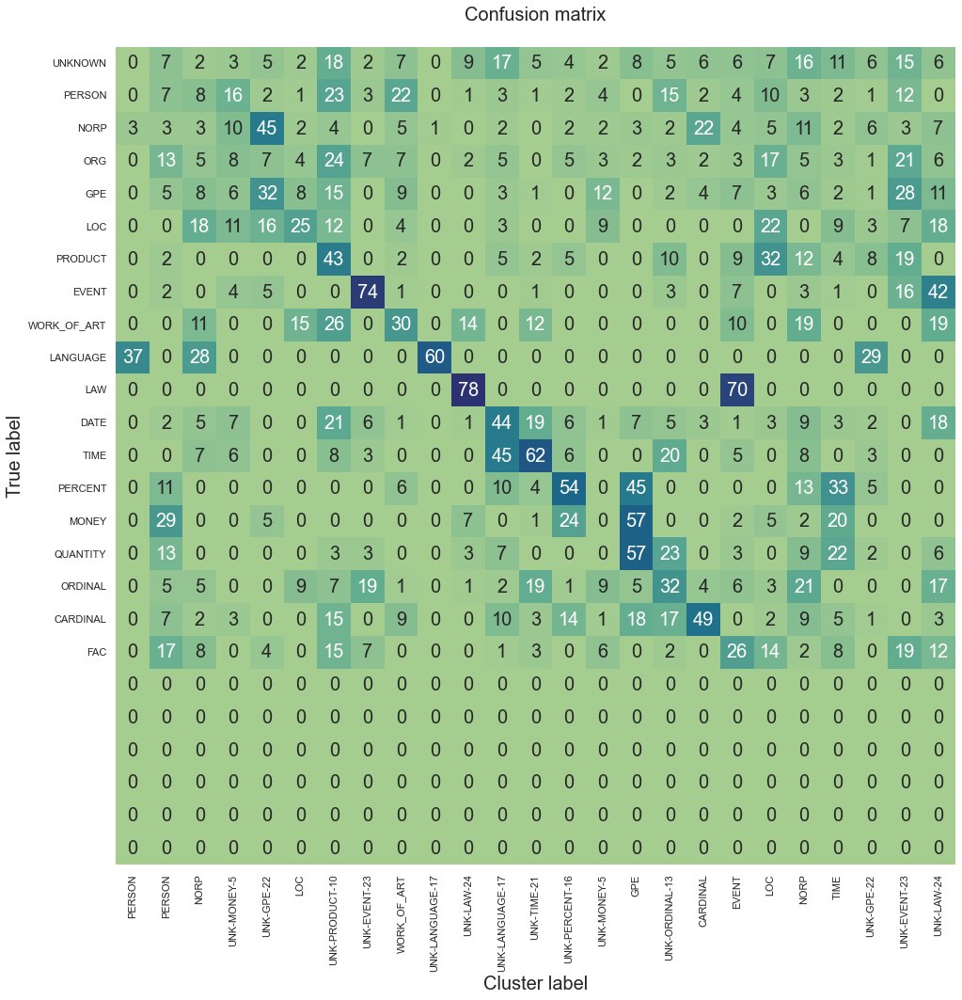

F1 score (macro) = 0.4418
Accuracy = 0.4000
Precision = 0.7414
Recall = 0.3953
New clusters =      5
... wrote results to c:\Users\Will\Projects\MSc\project\src\results\test-train_size=3000-radius=0-latent_weight=0.1-reconstr_weight=0.1-head=z-cluster=Kmeans-entity_count=15-noise_factor=0.1-\index.html
Finished 'evaluate_model' in 35.812 secs
--------------------------------------------------
21/60: test-train_size=3000-radius=0-latent_weight=0.1-reconstr_weight=0.25-head=z-cluster=Kmeans-entity_count=15-noise_factor=0.1-
--------------------------------------------------
{'train_size': 3000, 'radius': 0, 'latent_weight': 0.1, 'reconstr_weight': 0.25, 'head': 'z', 'cluster': 'Kmeans', 'entity_count': 15, 'noise_factor': 0.1}
ERROR: Invalid config key <module 'tensorflow.keras' from 'c:\\Users\\Will\\Anaconda3\\envs\\tf-27\\lib\\site-packages\\keras\\api\\_v2\\keras\\__init__.py'>
Autoencoder
Latent Model
model compiled
Epoch 283: early stopping


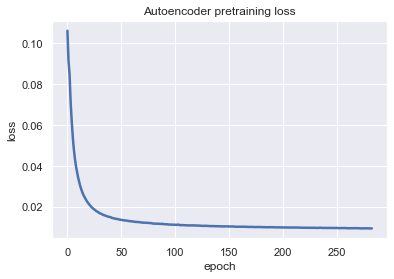

  0%|          | 0/8000 [00:00<?, ?it/s]

Iter: 7999 loss=-0.20368130505084991


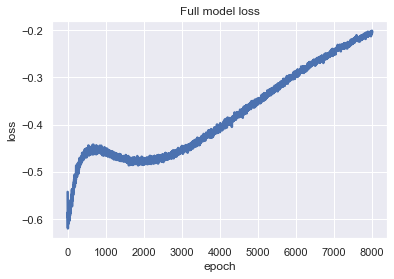

Training Done

F1 by Known Clusters: 0.2086


<Figure size 432x288 with 0 Axes>

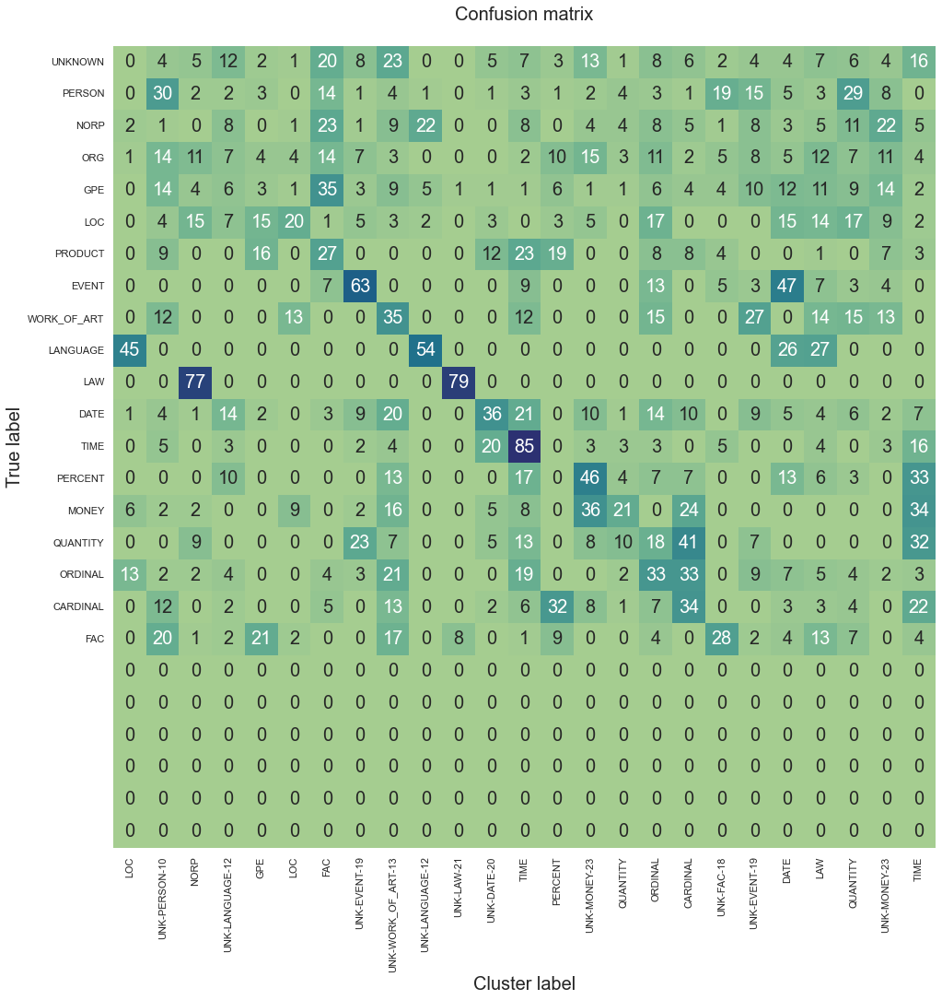

F1 score (macro) = 0.4469
Accuracy = 0.3807
Precision = 0.8463
Recall = 0.3801
New clusters =      6
... wrote results to c:\Users\Will\Projects\MSc\project\src\results\test-train_size=3000-radius=0-latent_weight=0.1-reconstr_weight=0.25-head=z-cluster=Kmeans-entity_count=15-noise_factor=0.1-\index.html
Finished 'evaluate_model' in 35.651 secs
--------------------------------------------------
22/60: test-train_size=3000-radius=0-latent_weight=0.1-reconstr_weight=0.5-head=z-cluster=Kmeans-entity_count=15-noise_factor=0.1-
--------------------------------------------------
{'train_size': 3000, 'radius': 0, 'latent_weight': 0.1, 'reconstr_weight': 0.5, 'head': 'z', 'cluster': 'Kmeans', 'entity_count': 15, 'noise_factor': 0.1}
ERROR: Invalid config key <module 'tensorflow.keras' from 'c:\\Users\\Will\\Anaconda3\\envs\\tf-27\\lib\\site-packages\\keras\\api\\_v2\\keras\\__init__.py'>
Autoencoder
Latent Model
model compiled
Epoch 234: early stopping


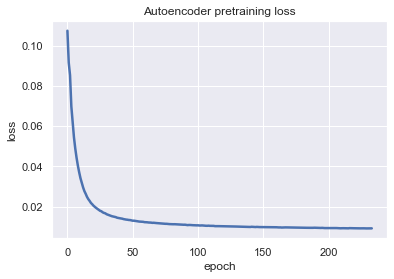

  0%|          | 0/8000 [00:00<?, ?it/s]

Iter: 7999 loss=-0.14610478281974792


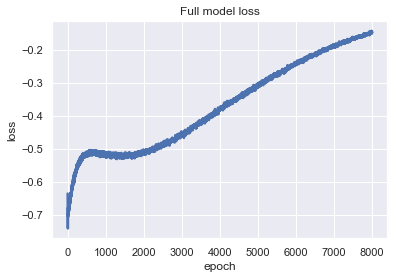

Training Done

F1 by Known Clusters: 0.1999


<Figure size 432x288 with 0 Axes>

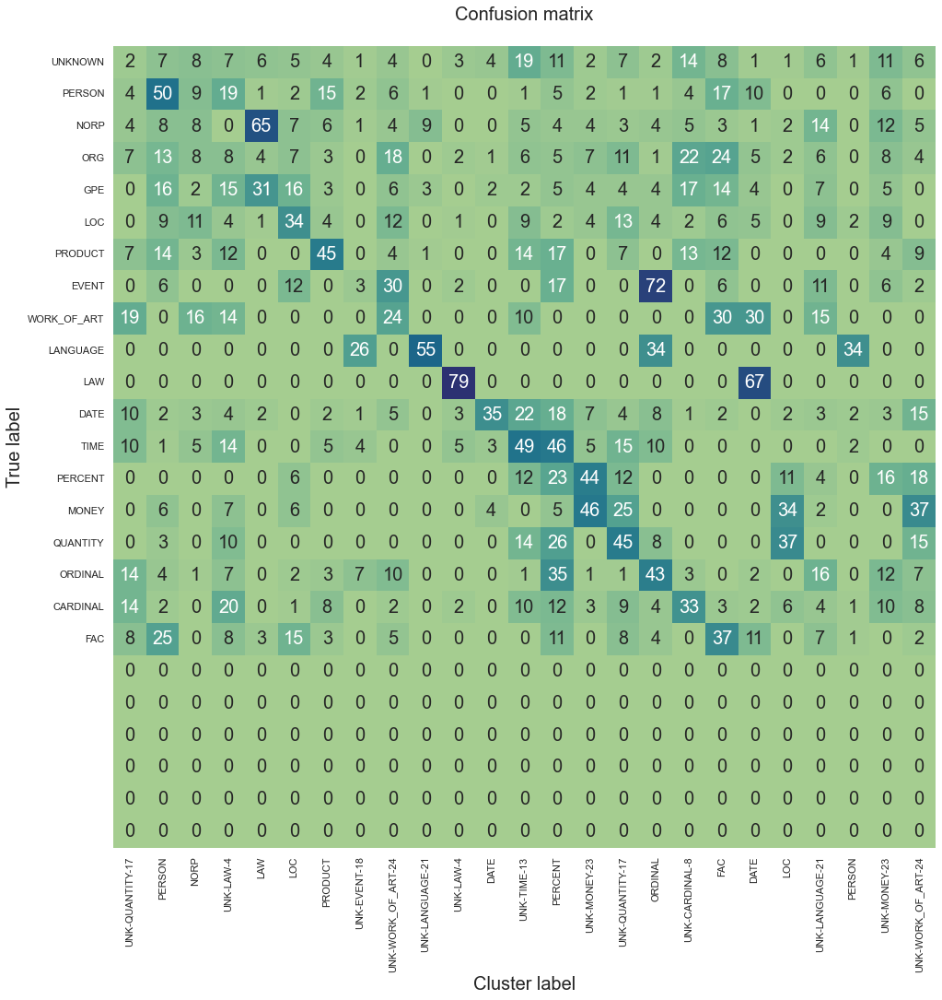

F1 score (macro) = 0.4563
Accuracy = 0.3830
Precision = 0.8458
Recall = 0.3890
New clusters =      4
... wrote results to c:\Users\Will\Projects\MSc\project\src\results\test-train_size=3000-radius=0-latent_weight=0.1-reconstr_weight=0.5-head=z-cluster=Kmeans-entity_count=15-noise_factor=0.1-\index.html
Finished 'evaluate_model' in 35.767 secs
--------------------------------------------------
23/60: test-train_size=3000-radius=0-latent_weight=0.1-reconstr_weight=0.75-head=z-cluster=Kmeans-entity_count=15-noise_factor=0.1-
--------------------------------------------------
{'train_size': 3000, 'radius': 0, 'latent_weight': 0.1, 'reconstr_weight': 0.75, 'head': 'z', 'cluster': 'Kmeans', 'entity_count': 15, 'noise_factor': 0.1}
ERROR: Invalid config key <module 'tensorflow.keras' from 'c:\\Users\\Will\\Anaconda3\\envs\\tf-27\\lib\\site-packages\\keras\\api\\_v2\\keras\\__init__.py'>
Autoencoder
Latent Model
model compiled
Epoch 210: early stopping


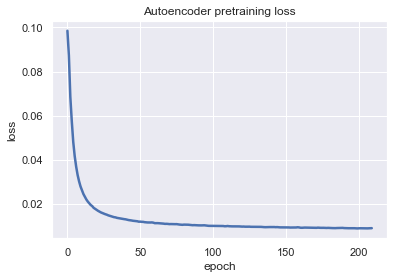

  0%|          | 0/8000 [00:00<?, ?it/s]

Iter: 7999 loss=-0.14339177310466766


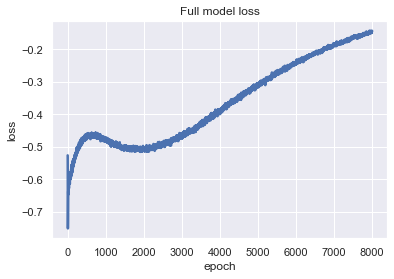

Training Done

F1 by Known Clusters: 0.1499


<Figure size 432x288 with 0 Axes>

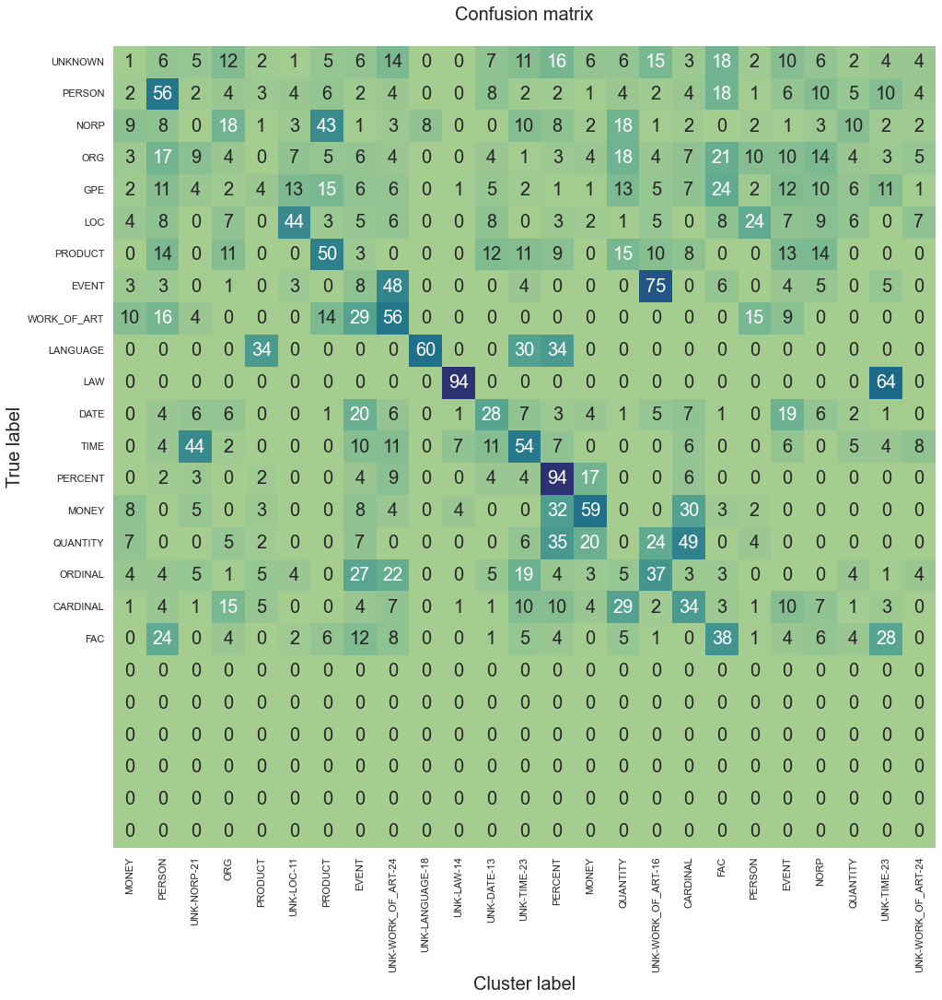

F1 score (macro) = 0.4806
Accuracy = 0.4073
Precision = 0.8465
Recall = 0.4074
New clusters =      3
... wrote results to c:\Users\Will\Projects\MSc\project\src\results\test-train_size=3000-radius=0-latent_weight=0.1-reconstr_weight=0.75-head=z-cluster=Kmeans-entity_count=15-noise_factor=0.1-\index.html
Finished 'evaluate_model' in 35.584 secs
--------------------------------------------------
24/60: test-train_size=3000-radius=0-latent_weight=0.1-reconstr_weight=0.9-head=z-cluster=Kmeans-entity_count=15-noise_factor=0.1-
--------------------------------------------------
{'train_size': 3000, 'radius': 0, 'latent_weight': 0.1, 'reconstr_weight': 0.9, 'head': 'z', 'cluster': 'Kmeans', 'entity_count': 15, 'noise_factor': 0.1}
ERROR: Invalid config key <module 'tensorflow.keras' from 'c:\\Users\\Will\\Anaconda3\\envs\\tf-27\\lib\\site-packages\\keras\\api\\_v2\\keras\\__init__.py'>
Autoencoder
Latent Model
model compiled
Epoch 227: early stopping


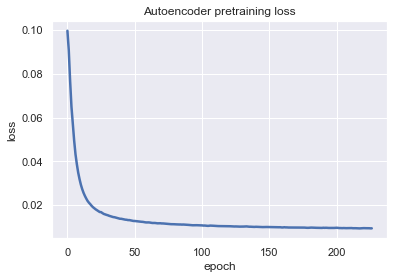

  0%|          | 0/8000 [00:00<?, ?it/s]

Iter: 7999 loss=-0.16078874468803406


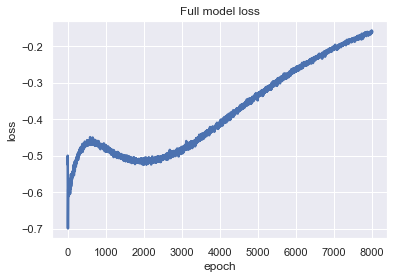

Training Done

F1 by Known Clusters: 0.2350


<Figure size 432x288 with 0 Axes>

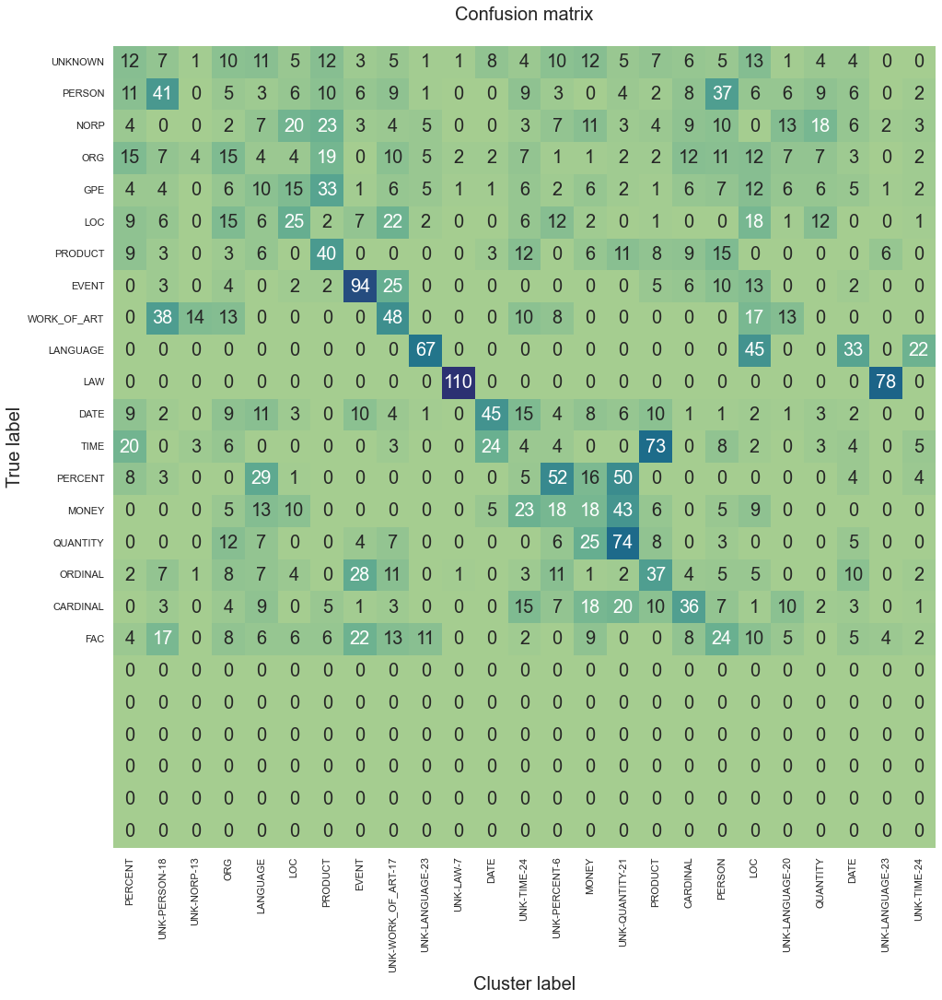

F1 score (macro) = 0.4504
Accuracy = 0.4080
Precision = 0.7935
Recall = 0.3970
New clusters =      5
... wrote results to c:\Users\Will\Projects\MSc\project\src\results\test-train_size=3000-radius=0-latent_weight=0.1-reconstr_weight=0.9-head=z-cluster=Kmeans-entity_count=15-noise_factor=0.1-\index.html
Finished 'evaluate_model' in 35.584 secs
--------------------------------------------------
25/60: test-train_size=3000-radius=0-latent_weight=1.0-reconstr_weight=0.1-head=z-cluster=Kmeans-entity_count=15-noise_factor=0.1-
--------------------------------------------------
{'train_size': 3000, 'radius': 0, 'latent_weight': 1.0, 'reconstr_weight': 0.1, 'head': 'z', 'cluster': 'Kmeans', 'entity_count': 15, 'noise_factor': 0.1}
ERROR: Invalid config key <module 'tensorflow.keras' from 'c:\\Users\\Will\\Anaconda3\\envs\\tf-27\\lib\\site-packages\\keras\\api\\_v2\\keras\\__init__.py'>
Autoencoder
Latent Model
model compiled
Epoch 283: early stopping


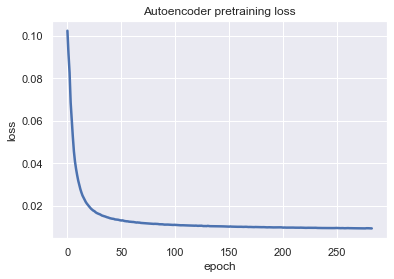

  0%|          | 0/8000 [00:00<?, ?it/s]

Iter: 7999 loss=-2.555589437484741


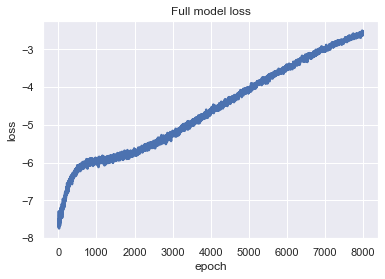

Training Done

F1 by Known Clusters: 0.2872


<Figure size 432x288 with 0 Axes>

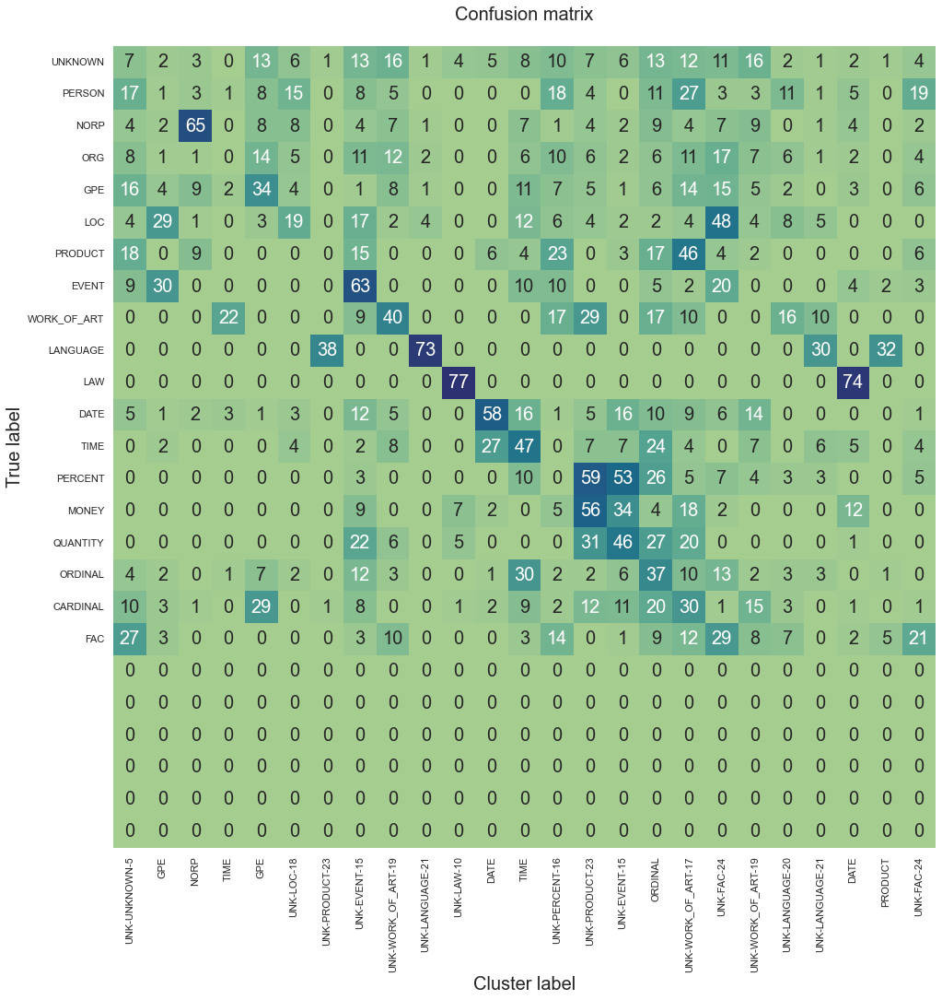

F1 score (macro) = 0.4376
Accuracy = 0.3987
Precision = 0.6886
Recall = 0.3892
New clusters =      4
... wrote results to c:\Users\Will\Projects\MSc\project\src\results\test-train_size=3000-radius=0-latent_weight=1.0-reconstr_weight=0.1-head=z-cluster=Kmeans-entity_count=15-noise_factor=0.1-\index.html
Finished 'evaluate_model' in 35.64 secs
--------------------------------------------------
26/60: test-train_size=3000-radius=0-latent_weight=1.0-reconstr_weight=0.25-head=z-cluster=Kmeans-entity_count=15-noise_factor=0.1-
--------------------------------------------------
{'train_size': 3000, 'radius': 0, 'latent_weight': 1.0, 'reconstr_weight': 0.25, 'head': 'z', 'cluster': 'Kmeans', 'entity_count': 15, 'noise_factor': 0.1}
ERROR: Invalid config key <module 'tensorflow.keras' from 'c:\\Users\\Will\\Anaconda3\\envs\\tf-27\\lib\\site-packages\\keras\\api\\_v2\\keras\\__init__.py'>
Autoencoder
Latent Model
model compiled
Epoch 224: early stopping


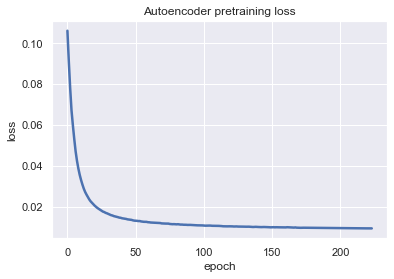

  0%|          | 0/8000 [00:00<?, ?it/s]

Iter: 7999 loss=-2.0242598056793213


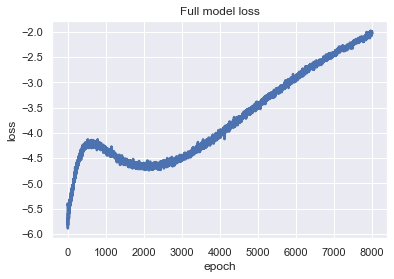

Training Done

F1 by Known Clusters: 0.2248


<Figure size 432x288 with 0 Axes>

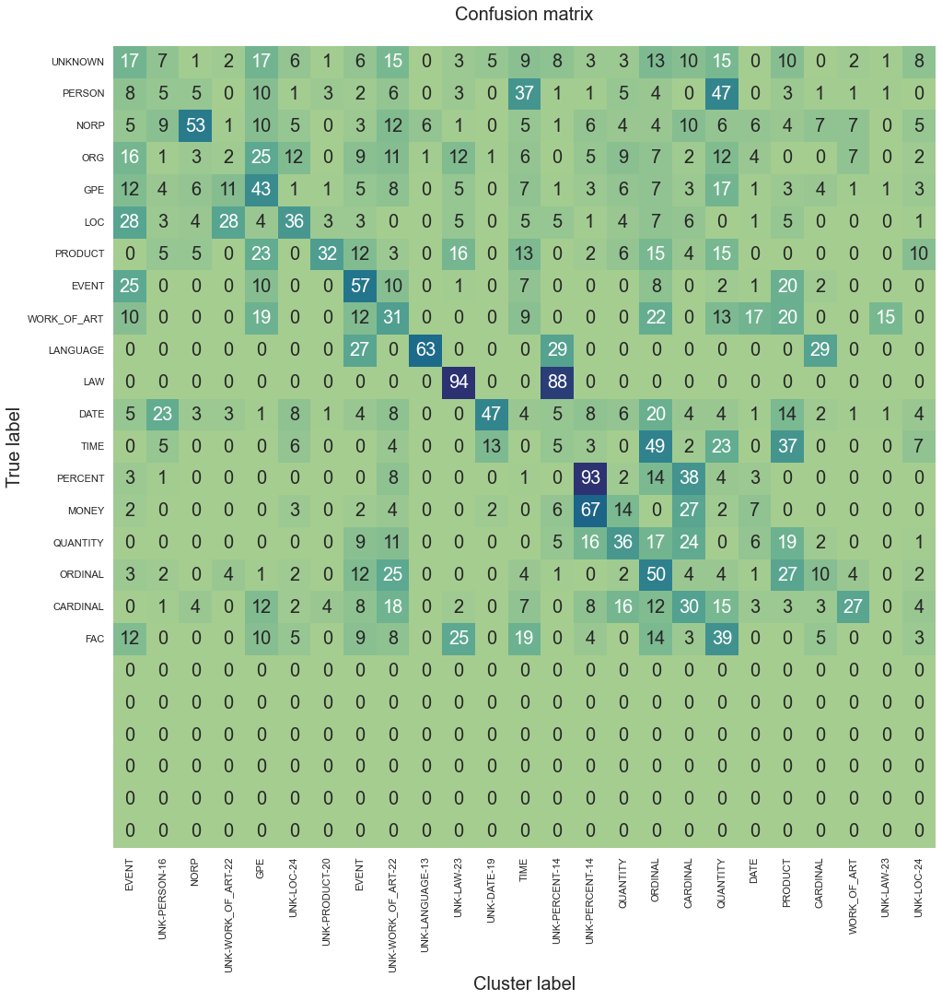

F1 score (macro) = 0.4651
Accuracy = 0.4070
Precision = 0.7939
Recall = 0.3991
New clusters =      2
... wrote results to c:\Users\Will\Projects\MSc\project\src\results\test-train_size=3000-radius=0-latent_weight=1.0-reconstr_weight=0.25-head=z-cluster=Kmeans-entity_count=15-noise_factor=0.1-\index.html
Finished 'evaluate_model' in 34.733 secs
--------------------------------------------------
27/60: test-train_size=3000-radius=0-latent_weight=1.0-reconstr_weight=0.5-head=z-cluster=Kmeans-entity_count=15-noise_factor=0.1-
--------------------------------------------------
{'train_size': 3000, 'radius': 0, 'latent_weight': 1.0, 'reconstr_weight': 0.5, 'head': 'z', 'cluster': 'Kmeans', 'entity_count': 15, 'noise_factor': 0.1}
ERROR: Invalid config key <module 'tensorflow.keras' from 'c:\\Users\\Will\\Anaconda3\\envs\\tf-27\\lib\\site-packages\\keras\\api\\_v2\\keras\\__init__.py'>
Autoencoder
Latent Model
model compiled
Epoch 249: early stopping


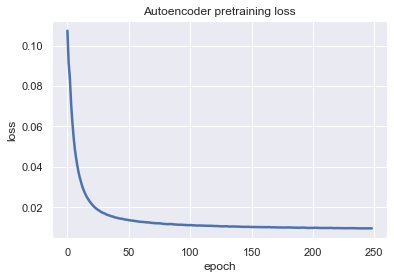

  0%|          | 0/8000 [00:00<?, ?it/s]

Iter: 7999 loss=-1.9387203454971313


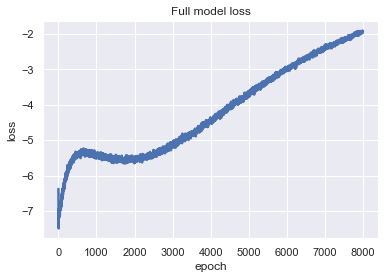

Training Done

F1 by Known Clusters: 0.1683


<Figure size 432x288 with 0 Axes>

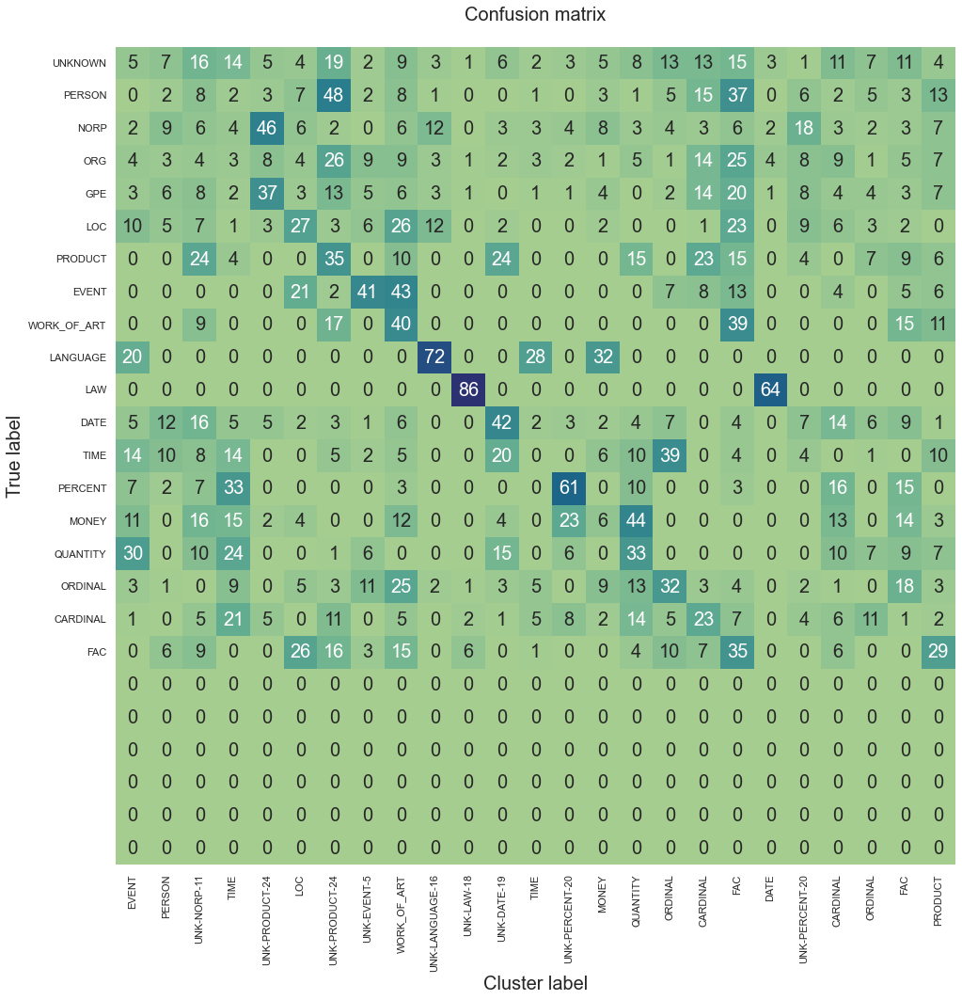

F1 score (macro) = 0.4280
Accuracy = 0.3710
Precision = 0.8469
Recall = 0.3669
New clusters =      5
... wrote results to c:\Users\Will\Projects\MSc\project\src\results\test-train_size=3000-radius=0-latent_weight=1.0-reconstr_weight=0.5-head=z-cluster=Kmeans-entity_count=15-noise_factor=0.1-\index.html
Finished 'evaluate_model' in 35.239 secs
--------------------------------------------------
28/60: test-train_size=3000-radius=0-latent_weight=1.0-reconstr_weight=0.75-head=z-cluster=Kmeans-entity_count=15-noise_factor=0.1-
--------------------------------------------------
{'train_size': 3000, 'radius': 0, 'latent_weight': 1.0, 'reconstr_weight': 0.75, 'head': 'z', 'cluster': 'Kmeans', 'entity_count': 15, 'noise_factor': 0.1}
ERROR: Invalid config key <module 'tensorflow.keras' from 'c:\\Users\\Will\\Anaconda3\\envs\\tf-27\\lib\\site-packages\\keras\\api\\_v2\\keras\\__init__.py'>
Autoencoder
Latent Model
model compiled
Epoch 216: early stopping


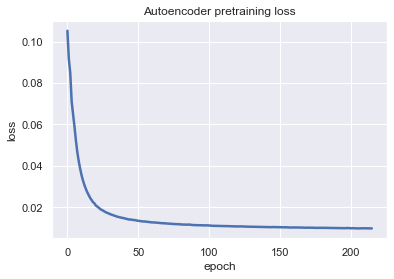

  0%|          | 0/8000 [00:00<?, ?it/s]

Iter: 7999 loss=-2.3899388313293457


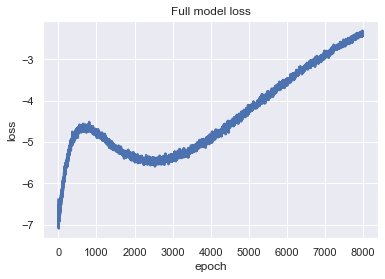

Training Done

F1 by Known Clusters: 0.2243


<Figure size 432x288 with 0 Axes>

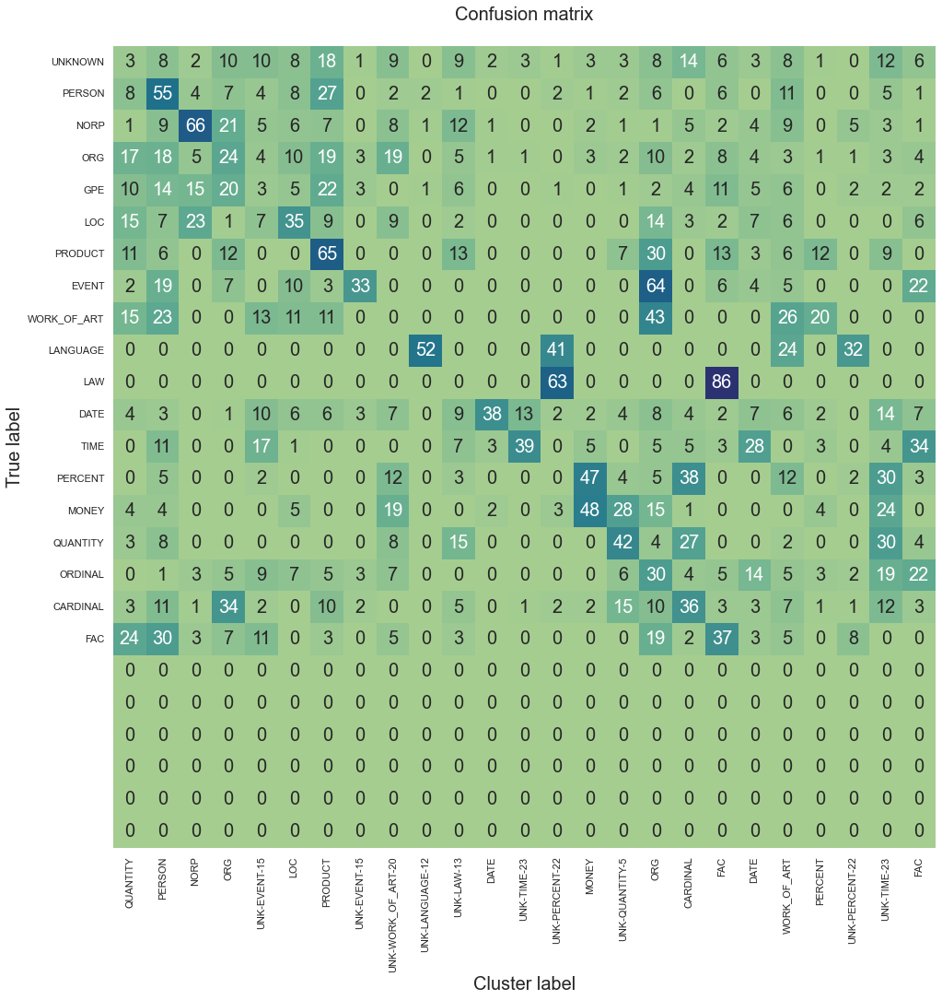

F1 score (macro) = 0.4561
Accuracy = 0.3837
Precision = 0.8460
Recall = 0.3836
New clusters =      4
... wrote results to c:\Users\Will\Projects\MSc\project\src\results\test-train_size=3000-radius=0-latent_weight=1.0-reconstr_weight=0.75-head=z-cluster=Kmeans-entity_count=15-noise_factor=0.1-\index.html
Finished 'evaluate_model' in 34.327 secs
--------------------------------------------------
29/60: test-train_size=3000-radius=0-latent_weight=1.0-reconstr_weight=0.9-head=z-cluster=Kmeans-entity_count=15-noise_factor=0.1-
--------------------------------------------------
{'train_size': 3000, 'radius': 0, 'latent_weight': 1.0, 'reconstr_weight': 0.9, 'head': 'z', 'cluster': 'Kmeans', 'entity_count': 15, 'noise_factor': 0.1}
ERROR: Invalid config key <module 'tensorflow.keras' from 'c:\\Users\\Will\\Anaconda3\\envs\\tf-27\\lib\\site-packages\\keras\\api\\_v2\\keras\\__init__.py'>
Autoencoder
Latent Model
model compiled
Epoch 290: early stopping


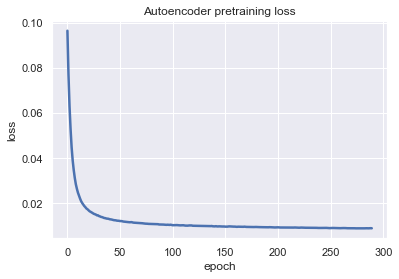

  0%|          | 0/8000 [00:00<?, ?it/s]

Iter: 7999 loss=-0.8465200066566467


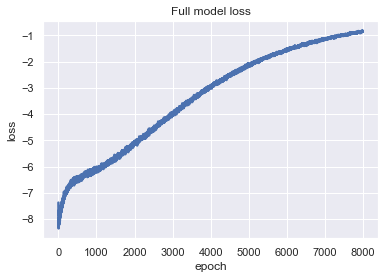

Training Done

F1 by Known Clusters: 0.2462


<Figure size 432x288 with 0 Axes>

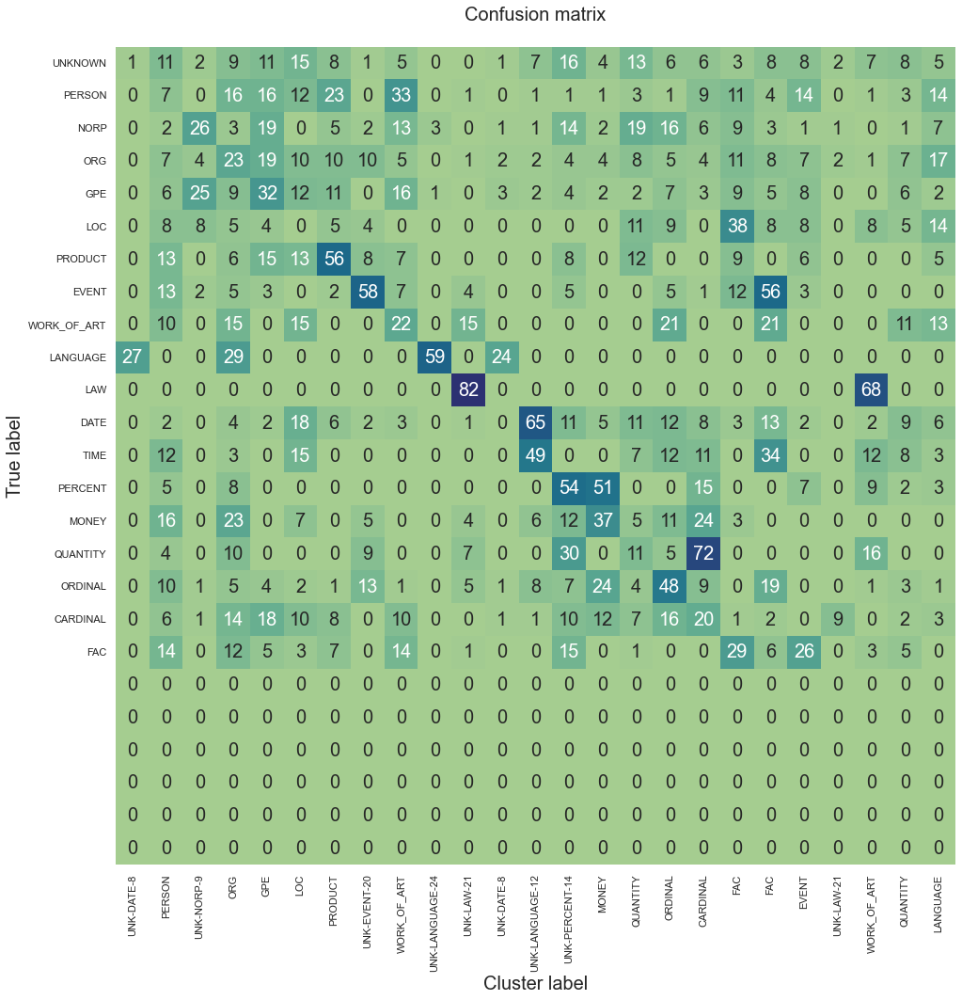

F1 score (macro) = 0.4431
Accuracy = 0.3837
Precision = 0.8989
Recall = 0.3866
New clusters =      4
... wrote results to c:\Users\Will\Projects\MSc\project\src\results\test-train_size=3000-radius=0-latent_weight=1.0-reconstr_weight=0.9-head=z-cluster=Kmeans-entity_count=15-noise_factor=0.1-\index.html
Finished 'evaluate_model' in 34.289 secs
--------------------------------------------------
30/60: test-train_size=3000-radius=6-latent_weight=1e-05-reconstr_weight=0.1-head=z-cluster=Kmeans-entity_count=15-noise_factor=0.1-
--------------------------------------------------
{'train_size': 3000, 'radius': 6, 'latent_weight': 1e-05, 'reconstr_weight': 0.1, 'head': 'z', 'cluster': 'Kmeans', 'entity_count': 15, 'noise_factor': 0.1}
ERROR: Invalid config key <module 'tensorflow.keras' from 'c:\\Users\\Will\\Anaconda3\\envs\\tf-27\\lib\\site-packages\\keras\\api\\_v2\\keras\\__init__.py'>
Autoencoder
Latent Model
model compiled
Creating data


  0%|          | 0/3 [00:00<?, ?it/s]

Reading lines


100%|██████████| 3000/3000 [00:00<00:00, 37497.02it/s]


Loading ./data\conll_n3000_train
Embedding sentences radius 6


3000it [00:12, 249.20it/s]


Finished 'get_training_data_spacy' in 13.24 secs
SAVED ./data/conll_spacy_n3000_r6.pkl
Epoch 204: early stopping


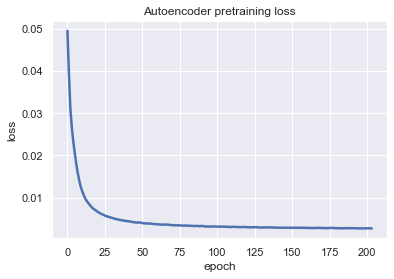

  0%|          | 0/8000 [00:00<?, ?it/s]

Stop traing for tolerance threshold reached
Iter: 35 loss=0.0013510100543498993


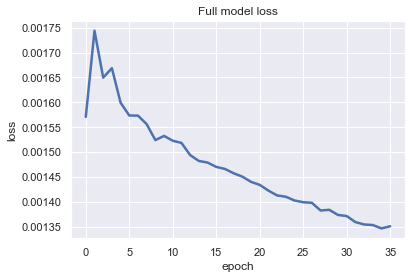

Training Done

F1 by Known Clusters: 0.2365


<Figure size 432x288 with 0 Axes>

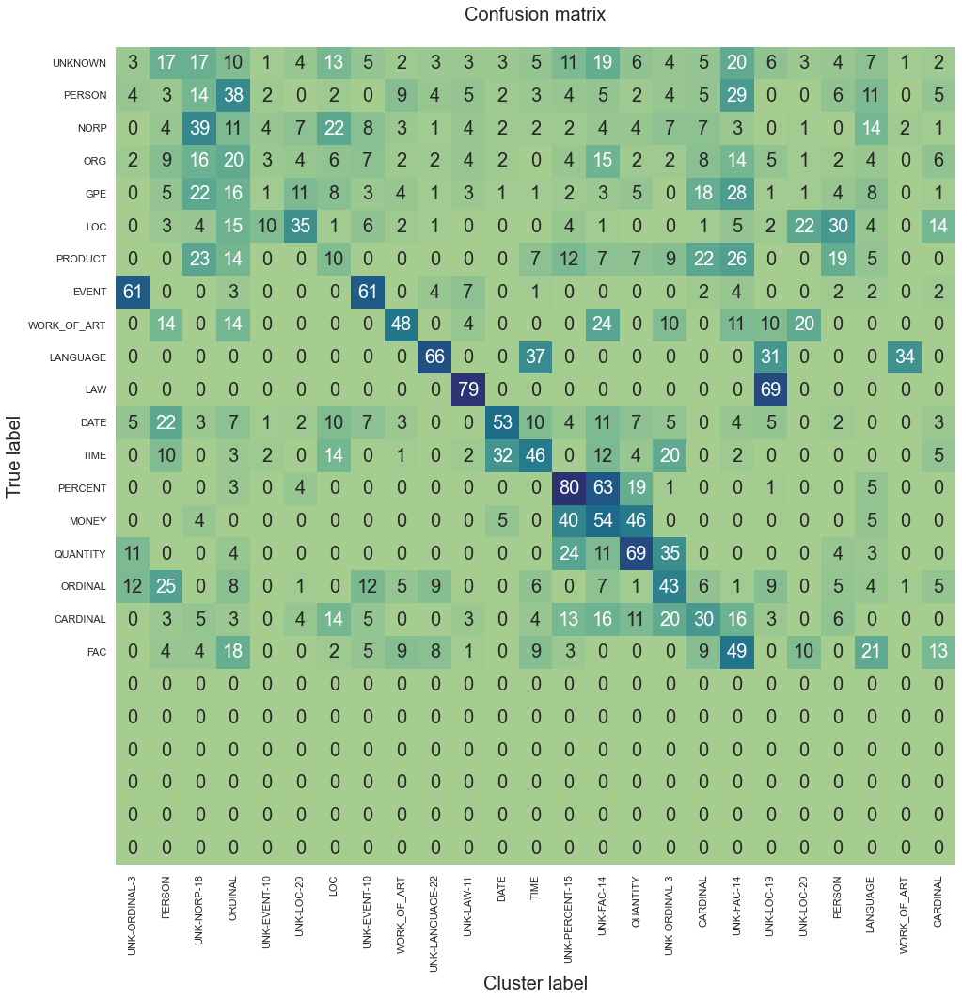

F1 score (macro) = 0.4754
Accuracy = 0.4270
Precision = 0.7417
Recall = 0.4193
New clusters =      4
... wrote results to c:\Users\Will\Projects\MSc\project\src\results\test-train_size=3000-radius=6-latent_weight=1e-05-reconstr_weight=0.1-head=z-cluster=Kmeans-entity_count=15-noise_factor=0.1-\index.html
Finished 'evaluate_model' in 36.115 secs
--------------------------------------------------
31/60: test-train_size=3000-radius=6-latent_weight=1e-05-reconstr_weight=0.25-head=z-cluster=Kmeans-entity_count=15-noise_factor=0.1-
--------------------------------------------------
{'train_size': 3000, 'radius': 6, 'latent_weight': 1e-05, 'reconstr_weight': 0.25, 'head': 'z', 'cluster': 'Kmeans', 'entity_count': 15, 'noise_factor': 0.1}
ERROR: Invalid config key <module 'tensorflow.keras' from 'c:\\Users\\Will\\Anaconda3\\envs\\tf-27\\lib\\site-packages\\keras\\api\\_v2\\keras\\__init__.py'>
Autoencoder
Latent Model
model compiled
Epoch 189: early stopping


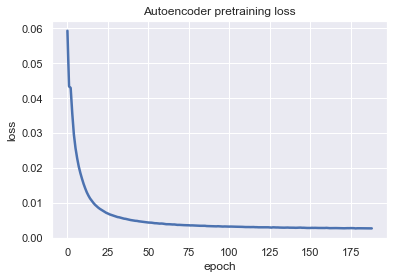

  0%|          | 0/8000 [00:00<?, ?it/s]

Stop traing for tolerance threshold reached
Iter: 110 loss=0.0030688110273331404


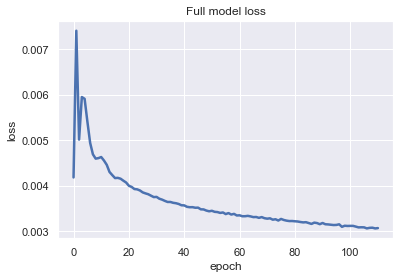

Training Done

F1 by Known Clusters: 0.2467


<Figure size 432x288 with 0 Axes>

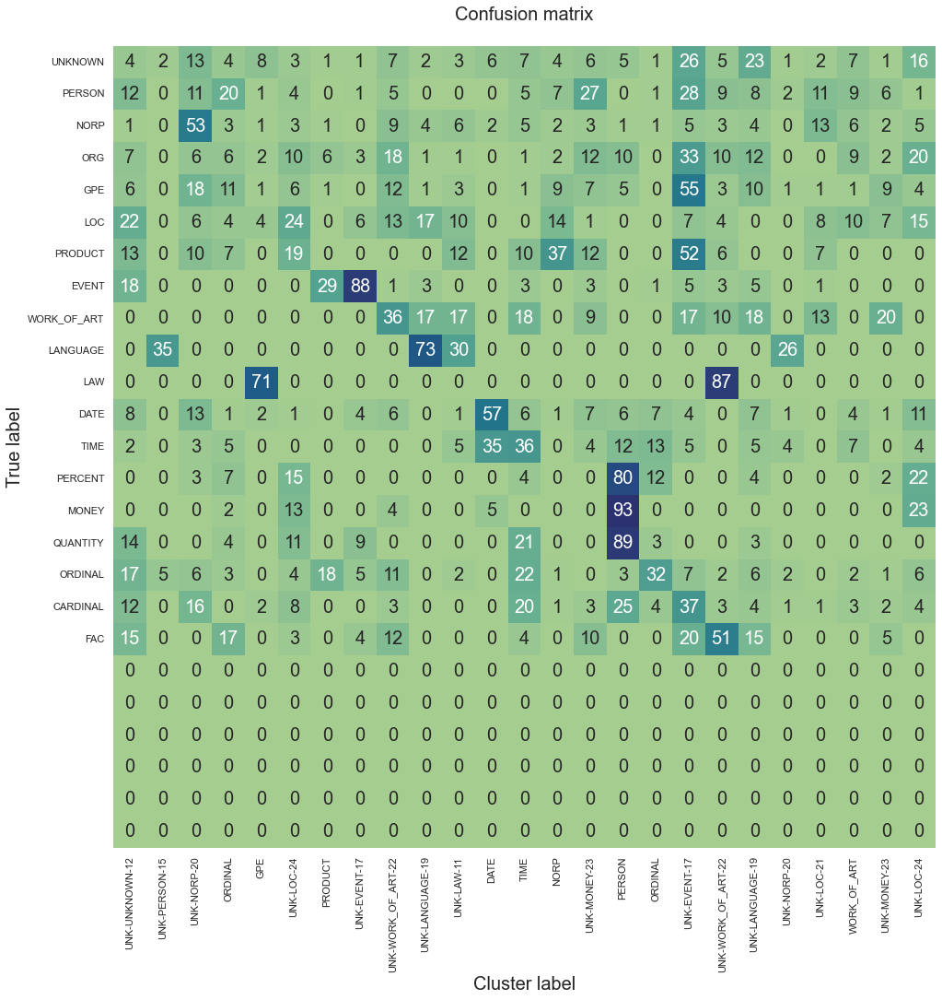

F1 score (macro) = 0.4271
Accuracy = 0.3850
Precision = 0.6884
Recall = 0.3876
New clusters =      2
... wrote results to c:\Users\Will\Projects\MSc\project\src\results\test-train_size=3000-radius=6-latent_weight=1e-05-reconstr_weight=0.25-head=z-cluster=Kmeans-entity_count=15-noise_factor=0.1-\index.html
Finished 'evaluate_model' in 35.465 secs
--------------------------------------------------
32/60: test-train_size=3000-radius=6-latent_weight=1e-05-reconstr_weight=0.5-head=z-cluster=Kmeans-entity_count=15-noise_factor=0.1-
--------------------------------------------------
{'train_size': 3000, 'radius': 6, 'latent_weight': 1e-05, 'reconstr_weight': 0.5, 'head': 'z', 'cluster': 'Kmeans', 'entity_count': 15, 'noise_factor': 0.1}
ERROR: Invalid config key <module 'tensorflow.keras' from 'c:\\Users\\Will\\Anaconda3\\envs\\tf-27\\lib\\site-packages\\keras\\api\\_v2\\keras\\__init__.py'>
Autoencoder
Latent Model
model compiled
Epoch 172: early stopping


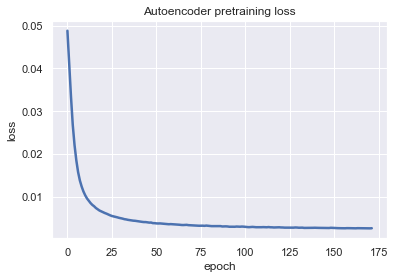

  0%|          | 0/8000 [00:00<?, ?it/s]

Stop traing for tolerance threshold reached
Iter: 173 loss=0.005666234064847231


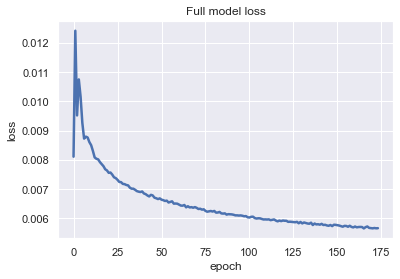

Training Done

F1 by Known Clusters: 0.2351


<Figure size 432x288 with 0 Axes>

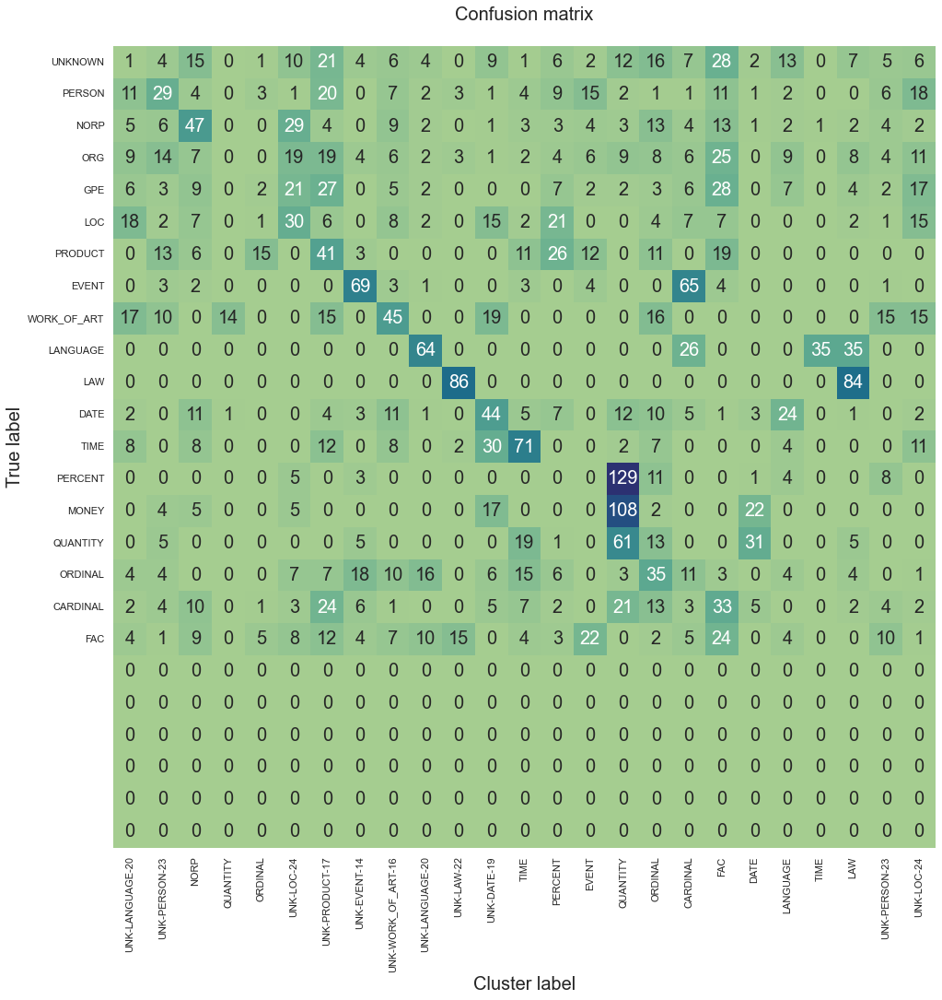

F1 score (macro) = 0.4775
Accuracy = 0.4233
Precision = 0.7944
Recall = 0.4159
New clusters =      4
... wrote results to c:\Users\Will\Projects\MSc\project\src\results\test-train_size=3000-radius=6-latent_weight=1e-05-reconstr_weight=0.5-head=z-cluster=Kmeans-entity_count=15-noise_factor=0.1-\index.html
Finished 'evaluate_model' in 35.553 secs
--------------------------------------------------
33/60: test-train_size=3000-radius=6-latent_weight=1e-05-reconstr_weight=0.75-head=z-cluster=Kmeans-entity_count=15-noise_factor=0.1-
--------------------------------------------------
{'train_size': 3000, 'radius': 6, 'latent_weight': 1e-05, 'reconstr_weight': 0.75, 'head': 'z', 'cluster': 'Kmeans', 'entity_count': 15, 'noise_factor': 0.1}
ERROR: Invalid config key <module 'tensorflow.keras' from 'c:\\Users\\Will\\Anaconda3\\envs\\tf-27\\lib\\site-packages\\keras\\api\\_v2\\keras\\__init__.py'>
Autoencoder
Latent Model
model compiled
Epoch 179: early stopping


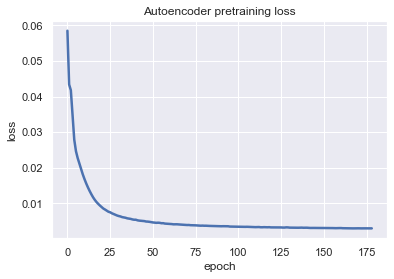

  0%|          | 0/8000 [00:00<?, ?it/s]

Stop traing for tolerance threshold reached
Iter: 1268 loss=0.007675517350435257


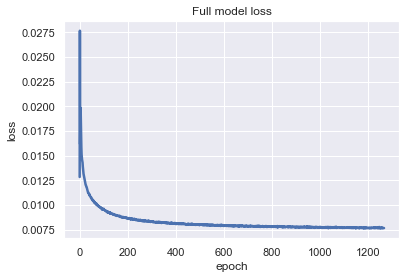

Training Done

F1 by Known Clusters: 0.1954


<Figure size 432x288 with 0 Axes>

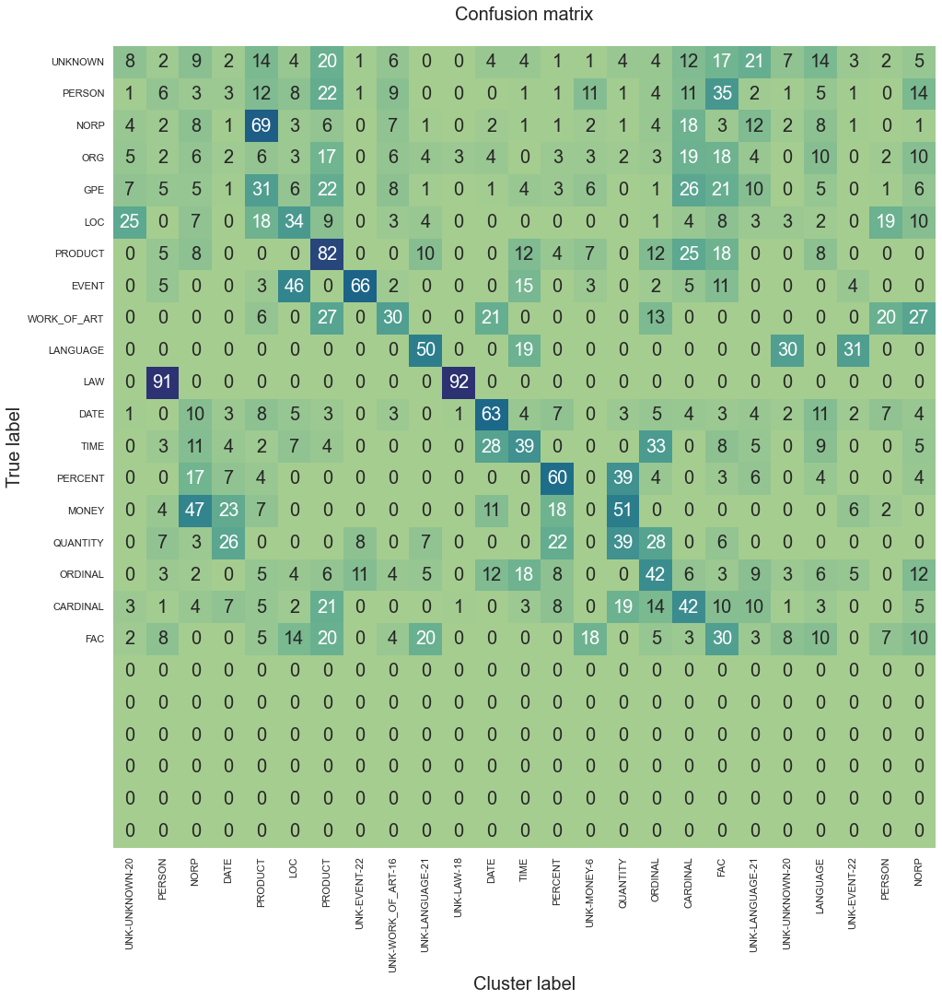

F1 score (macro) = 0.4778
Accuracy = 0.4157
Precision = 0.8466
Recall = 0.4103
New clusters =      4
... wrote results to c:\Users\Will\Projects\MSc\project\src\results\test-train_size=3000-radius=6-latent_weight=1e-05-reconstr_weight=0.75-head=z-cluster=Kmeans-entity_count=15-noise_factor=0.1-\index.html
Finished 'evaluate_model' in 35.928 secs
--------------------------------------------------
34/60: test-train_size=3000-radius=6-latent_weight=1e-05-reconstr_weight=0.9-head=z-cluster=Kmeans-entity_count=15-noise_factor=0.1-
--------------------------------------------------
{'train_size': 3000, 'radius': 6, 'latent_weight': 1e-05, 'reconstr_weight': 0.9, 'head': 'z', 'cluster': 'Kmeans', 'entity_count': 15, 'noise_factor': 0.1}
ERROR: Invalid config key <module 'tensorflow.keras' from 'c:\\Users\\Will\\Anaconda3\\envs\\tf-27\\lib\\site-packages\\keras\\api\\_v2\\keras\\__init__.py'>
Autoencoder
Latent Model
model compiled
Epoch 190: early stopping


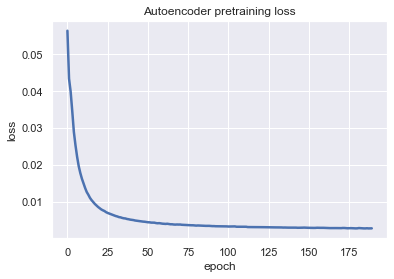

  0%|          | 0/8000 [00:00<?, ?it/s]

Stop traing for tolerance threshold reached
Iter: 215 loss=0.010283447802066803


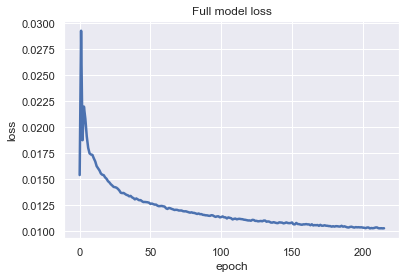

Training Done

F1 by Known Clusters: 0.3029


<Figure size 432x288 with 0 Axes>

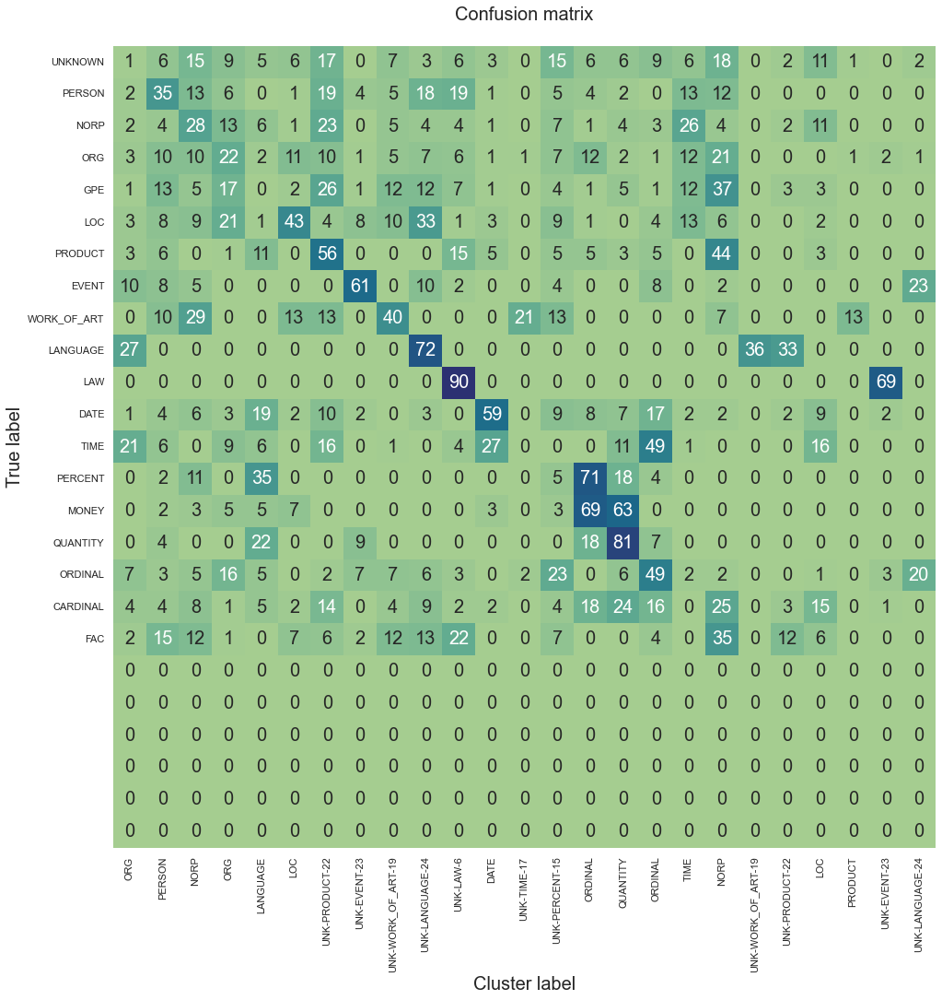

F1 score (macro) = 0.4563
Accuracy = 0.4093
Precision = 0.7411
Recall = 0.4136
New clusters =      5
... wrote results to c:\Users\Will\Projects\MSc\project\src\results\test-train_size=3000-radius=6-latent_weight=1e-05-reconstr_weight=0.9-head=z-cluster=Kmeans-entity_count=15-noise_factor=0.1-\index.html
Finished 'evaluate_model' in 34.866 secs
--------------------------------------------------
35/60: test-train_size=3000-radius=6-latent_weight=0.0001-reconstr_weight=0.1-head=z-cluster=Kmeans-entity_count=15-noise_factor=0.1-
--------------------------------------------------
{'train_size': 3000, 'radius': 6, 'latent_weight': 0.0001, 'reconstr_weight': 0.1, 'head': 'z', 'cluster': 'Kmeans', 'entity_count': 15, 'noise_factor': 0.1}
ERROR: Invalid config key <module 'tensorflow.keras' from 'c:\\Users\\Will\\Anaconda3\\envs\\tf-27\\lib\\site-packages\\keras\\api\\_v2\\keras\\__init__.py'>
Autoencoder
Latent Model
model compiled
Epoch 135: early stopping


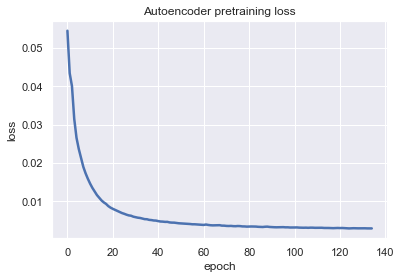

  0%|          | 0/8000 [00:00<?, ?it/s]

Stop traing for tolerance threshold reached
Iter: 74 loss=0.0004380681784823537


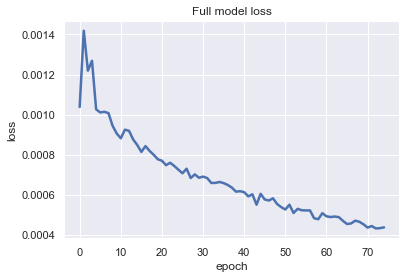

Training Done

F1 by Known Clusters: 0.2311


<Figure size 432x288 with 0 Axes>

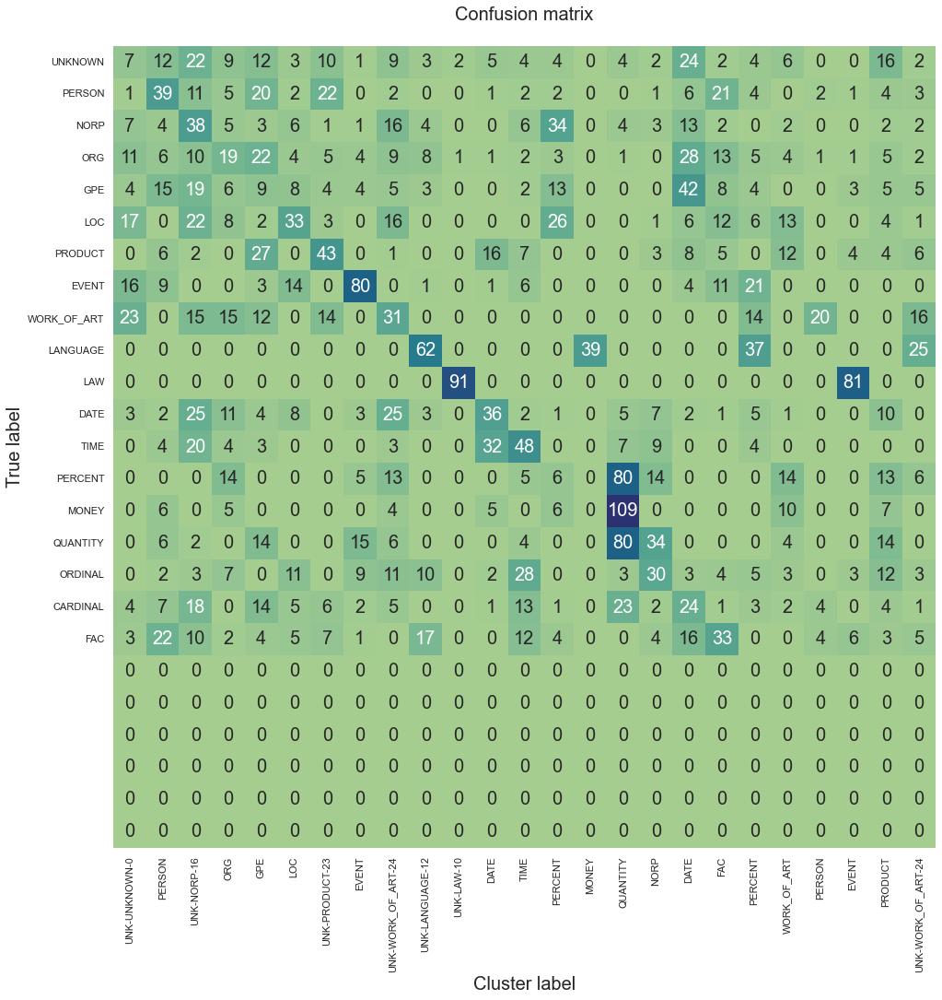

F1 score (macro) = 0.4555
Accuracy = 0.4003
Precision = 0.8465
Recall = 0.3961
New clusters =      4
... wrote results to c:\Users\Will\Projects\MSc\project\src\results\test-train_size=3000-radius=6-latent_weight=0.0001-reconstr_weight=0.1-head=z-cluster=Kmeans-entity_count=15-noise_factor=0.1-\index.html
Finished 'evaluate_model' in 34.699 secs
--------------------------------------------------
36/60: test-train_size=3000-radius=6-latent_weight=0.0001-reconstr_weight=0.25-head=z-cluster=Kmeans-entity_count=15-noise_factor=0.1-
--------------------------------------------------
{'train_size': 3000, 'radius': 6, 'latent_weight': 0.0001, 'reconstr_weight': 0.25, 'head': 'z', 'cluster': 'Kmeans', 'entity_count': 15, 'noise_factor': 0.1}
ERROR: Invalid config key <module 'tensorflow.keras' from 'c:\\Users\\Will\\Anaconda3\\envs\\tf-27\\lib\\site-packages\\keras\\api\\_v2\\keras\\__init__.py'>
Autoencoder
Latent Model
model compiled
Epoch 188: early stopping


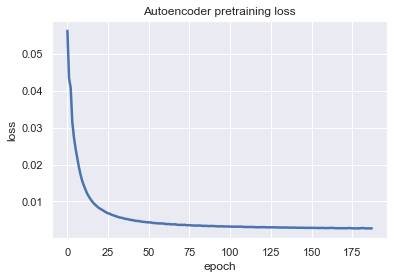

  0%|          | 0/8000 [00:00<?, ?it/s]

Stop traing for tolerance threshold reached
Iter: 84 loss=0.0022147861309349537


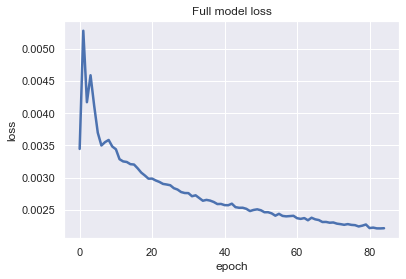

Training Done

F1 by Known Clusters: 0.2324


<Figure size 432x288 with 0 Axes>

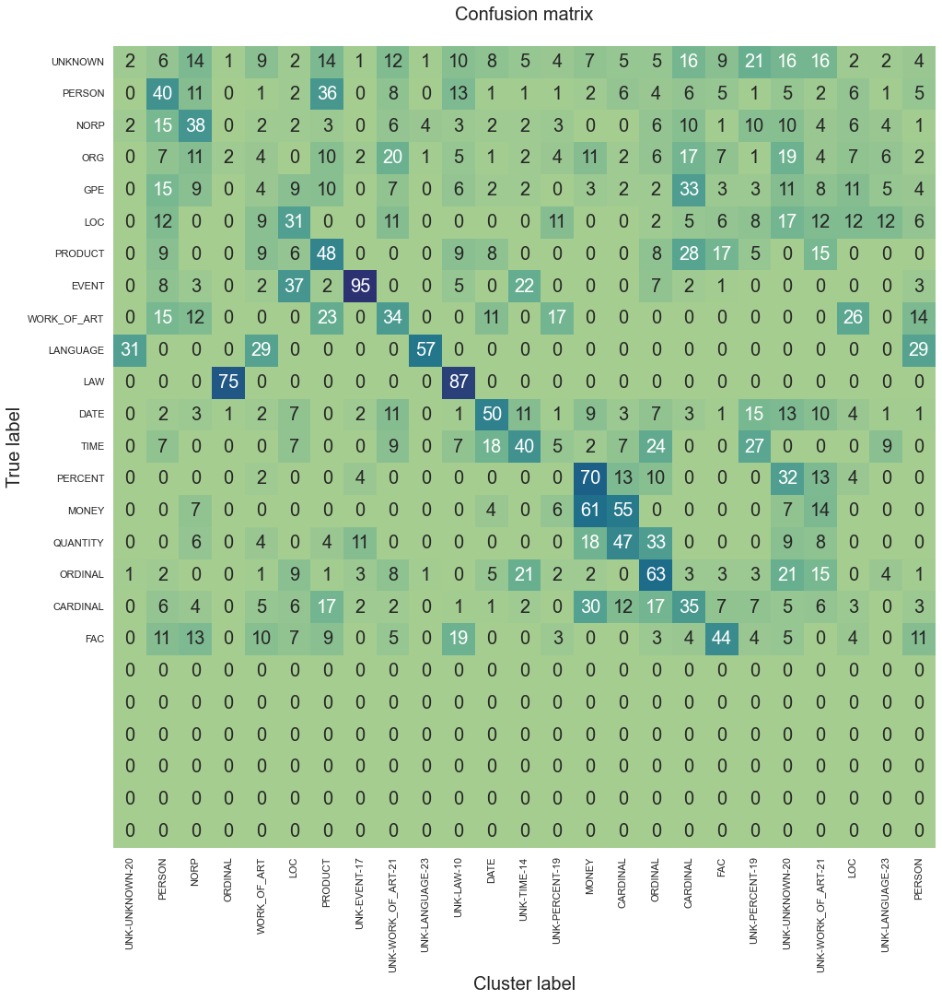

F1 score (macro) = 0.4669
Accuracy = 0.4210
Precision = 0.7947
Recall = 0.4089
New clusters =      5
... wrote results to c:\Users\Will\Projects\MSc\project\src\results\test-train_size=3000-radius=6-latent_weight=0.0001-reconstr_weight=0.25-head=z-cluster=Kmeans-entity_count=15-noise_factor=0.1-\index.html
Finished 'evaluate_model' in 36.127 secs
--------------------------------------------------
37/60: test-train_size=3000-radius=6-latent_weight=0.0001-reconstr_weight=0.5-head=z-cluster=Kmeans-entity_count=15-noise_factor=0.1-
--------------------------------------------------
{'train_size': 3000, 'radius': 6, 'latent_weight': 0.0001, 'reconstr_weight': 0.5, 'head': 'z', 'cluster': 'Kmeans', 'entity_count': 15, 'noise_factor': 0.1}
ERROR: Invalid config key <module 'tensorflow.keras' from 'c:\\Users\\Will\\Anaconda3\\envs\\tf-27\\lib\\site-packages\\keras\\api\\_v2\\keras\\__init__.py'>
Autoencoder
Latent Model
model compiled
Epoch 162: early stopping


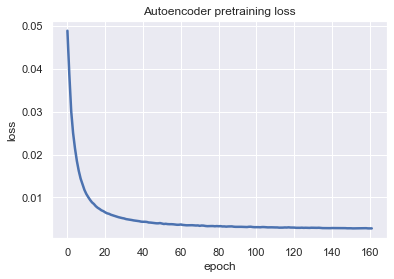

  0%|          | 0/8000 [00:00<?, ?it/s]

Stop traing for tolerance threshold reached
Iter: 175 loss=0.0047513158060610294


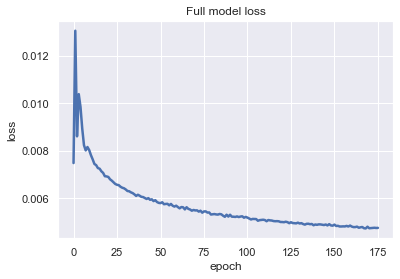

Training Done

F1 by Known Clusters: 0.2543


<Figure size 432x288 with 0 Axes>

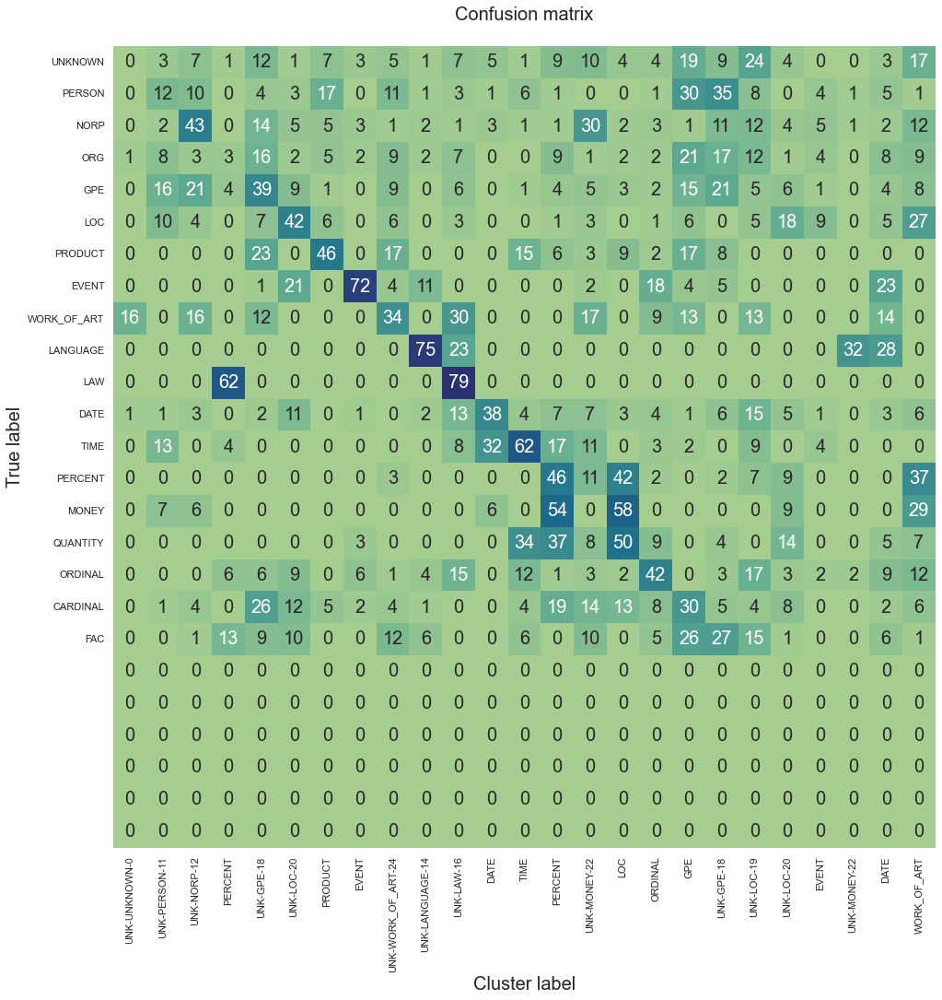

F1 score (macro) = 0.4473
Accuracy = 0.3843
Precision = 0.7409
Recall = 0.3870
New clusters =      4
... wrote results to c:\Users\Will\Projects\MSc\project\src\results\test-train_size=3000-radius=6-latent_weight=0.0001-reconstr_weight=0.5-head=z-cluster=Kmeans-entity_count=15-noise_factor=0.1-\index.html
Finished 'evaluate_model' in 34.651 secs
--------------------------------------------------
38/60: test-train_size=3000-radius=6-latent_weight=0.0001-reconstr_weight=0.75-head=z-cluster=Kmeans-entity_count=15-noise_factor=0.1-
--------------------------------------------------
{'train_size': 3000, 'radius': 6, 'latent_weight': 0.0001, 'reconstr_weight': 0.75, 'head': 'z', 'cluster': 'Kmeans', 'entity_count': 15, 'noise_factor': 0.1}
ERROR: Invalid config key <module 'tensorflow.keras' from 'c:\\Users\\Will\\Anaconda3\\envs\\tf-27\\lib\\site-packages\\keras\\api\\_v2\\keras\\__init__.py'>
Autoencoder
Latent Model
model compiled
Epoch 247: early stopping


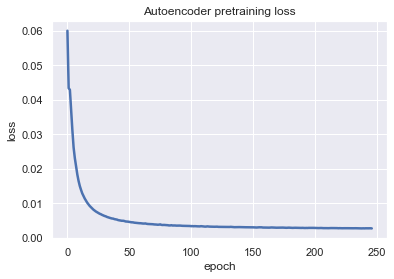

  0%|          | 0/8000 [00:00<?, ?it/s]

Stop traing for tolerance threshold reached
Iter: 373 loss=0.007340442854911089


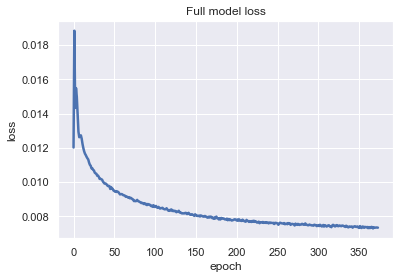

Training Done

F1 by Known Clusters: 0.2750


<Figure size 432x288 with 0 Axes>

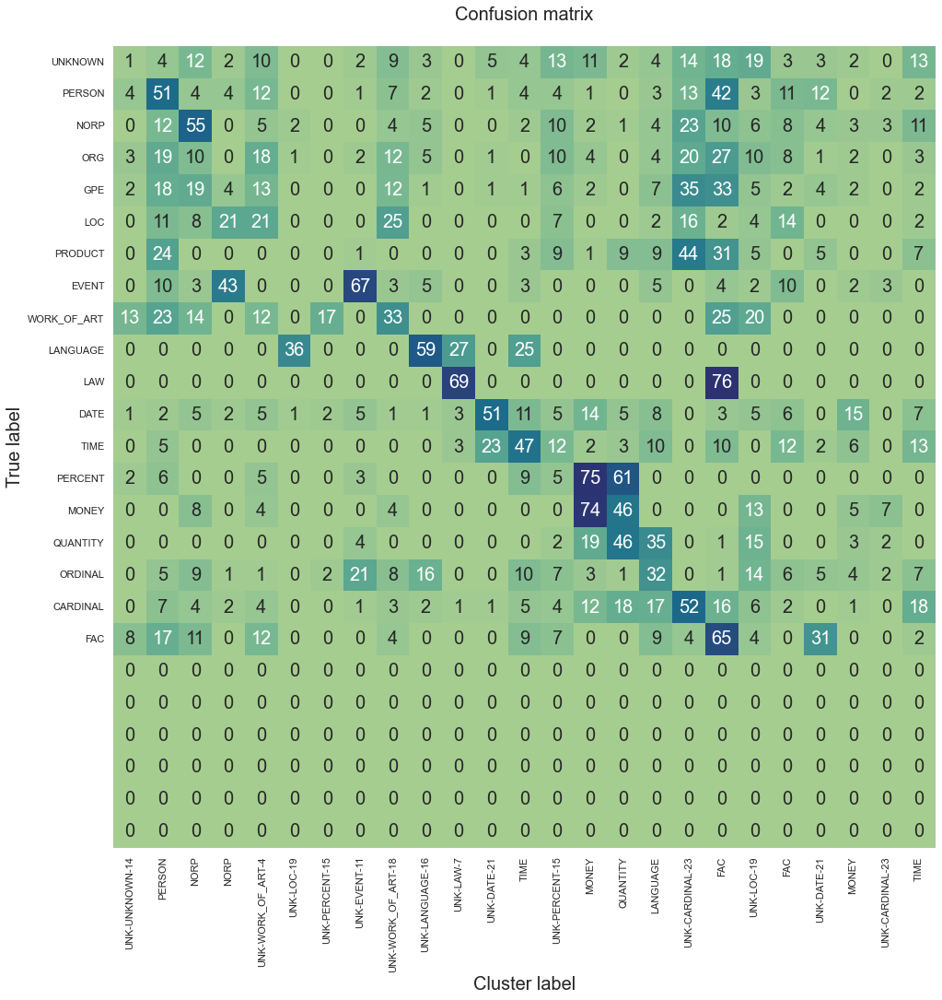

F1 score (macro) = 0.4274
Accuracy = 0.3733
Precision = 0.7408
Recall = 0.3773
New clusters =      3
... wrote results to c:\Users\Will\Projects\MSc\project\src\results\test-train_size=3000-radius=6-latent_weight=0.0001-reconstr_weight=0.75-head=z-cluster=Kmeans-entity_count=15-noise_factor=0.1-\index.html
Finished 'evaluate_model' in 34.662 secs
--------------------------------------------------
39/60: test-train_size=3000-radius=6-latent_weight=0.0001-reconstr_weight=0.9-head=z-cluster=Kmeans-entity_count=15-noise_factor=0.1-
--------------------------------------------------
{'train_size': 3000, 'radius': 6, 'latent_weight': 0.0001, 'reconstr_weight': 0.9, 'head': 'z', 'cluster': 'Kmeans', 'entity_count': 15, 'noise_factor': 0.1}
ERROR: Invalid config key <module 'tensorflow.keras' from 'c:\\Users\\Will\\Anaconda3\\envs\\tf-27\\lib\\site-packages\\keras\\api\\_v2\\keras\\__init__.py'>
Autoencoder
Latent Model
model compiled
Epoch 146: early stopping


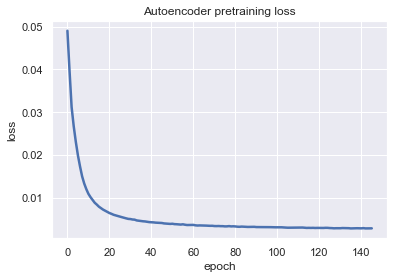

  0%|          | 0/8000 [00:00<?, ?it/s]

Stop traing for tolerance threshold reached
Iter: 363 loss=0.008887097239494324


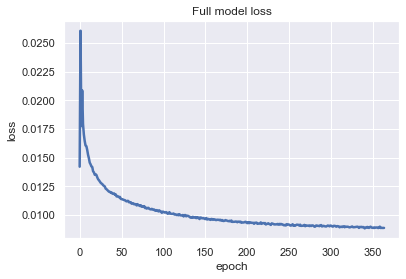

Training Done

F1 by Known Clusters: 0.3046


<Figure size 432x288 with 0 Axes>

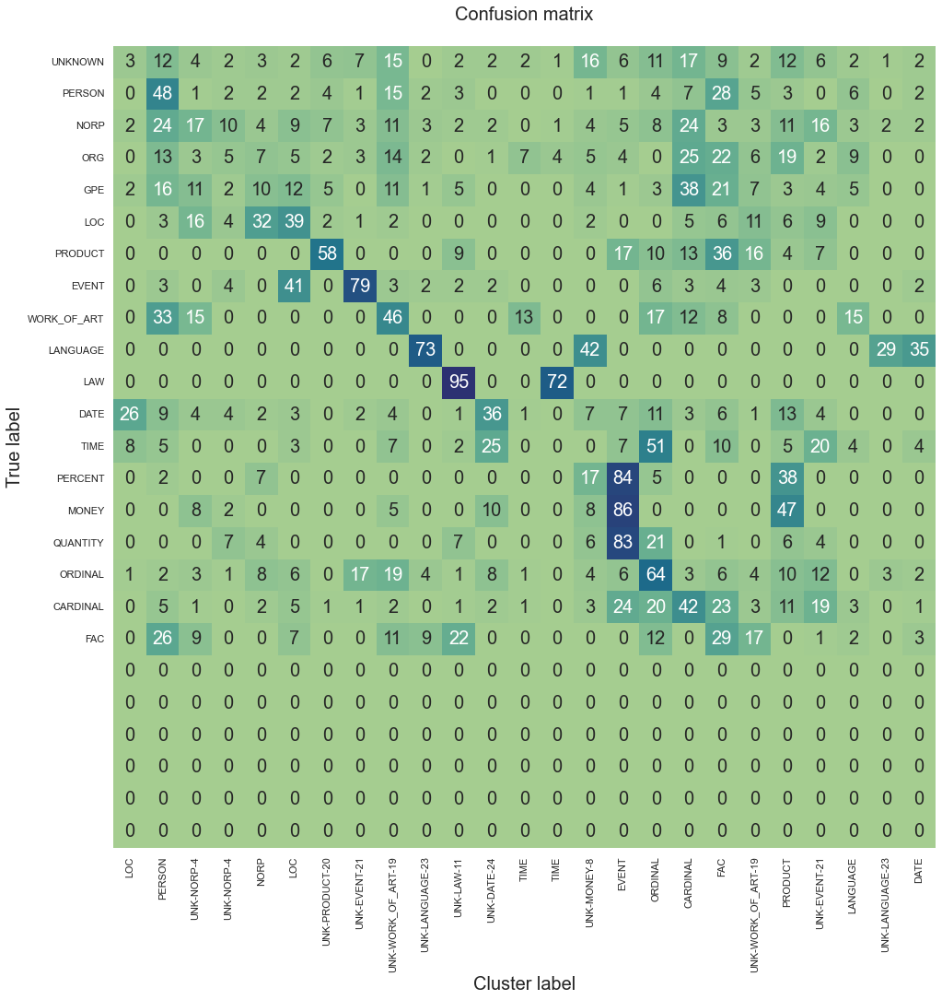

F1 score (macro) = 0.4404
Accuracy = 0.4080
Precision = 0.7408
Recall = 0.4003
New clusters =      3
... wrote results to c:\Users\Will\Projects\MSc\project\src\results\test-train_size=3000-radius=6-latent_weight=0.0001-reconstr_weight=0.9-head=z-cluster=Kmeans-entity_count=15-noise_factor=0.1-\index.html
Finished 'evaluate_model' in 35.03 secs
--------------------------------------------------
40/60: test-train_size=3000-radius=6-latent_weight=0.001-reconstr_weight=0.1-head=z-cluster=Kmeans-entity_count=15-noise_factor=0.1-
--------------------------------------------------
{'train_size': 3000, 'radius': 6, 'latent_weight': 0.001, 'reconstr_weight': 0.1, 'head': 'z', 'cluster': 'Kmeans', 'entity_count': 15, 'noise_factor': 0.1}
ERROR: Invalid config key <module 'tensorflow.keras' from 'c:\\Users\\Will\\Anaconda3\\envs\\tf-27\\lib\\site-packages\\keras\\api\\_v2\\keras\\__init__.py'>
Autoencoder
Latent Model
model compiled
Epoch 199: early stopping


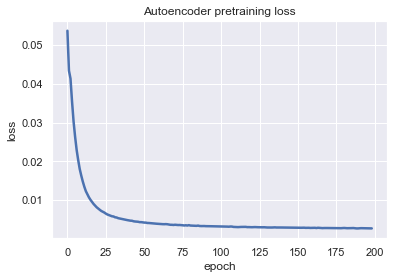

  0%|          | 0/8000 [00:00<?, ?it/s]

Stop traing for tolerance threshold reached
Iter: 2214 loss=-0.005172221455723047


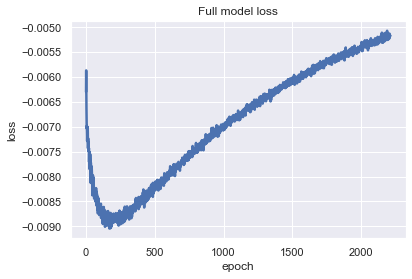

Training Done

F1 by Known Clusters: 0.1932


<Figure size 432x288 with 0 Axes>

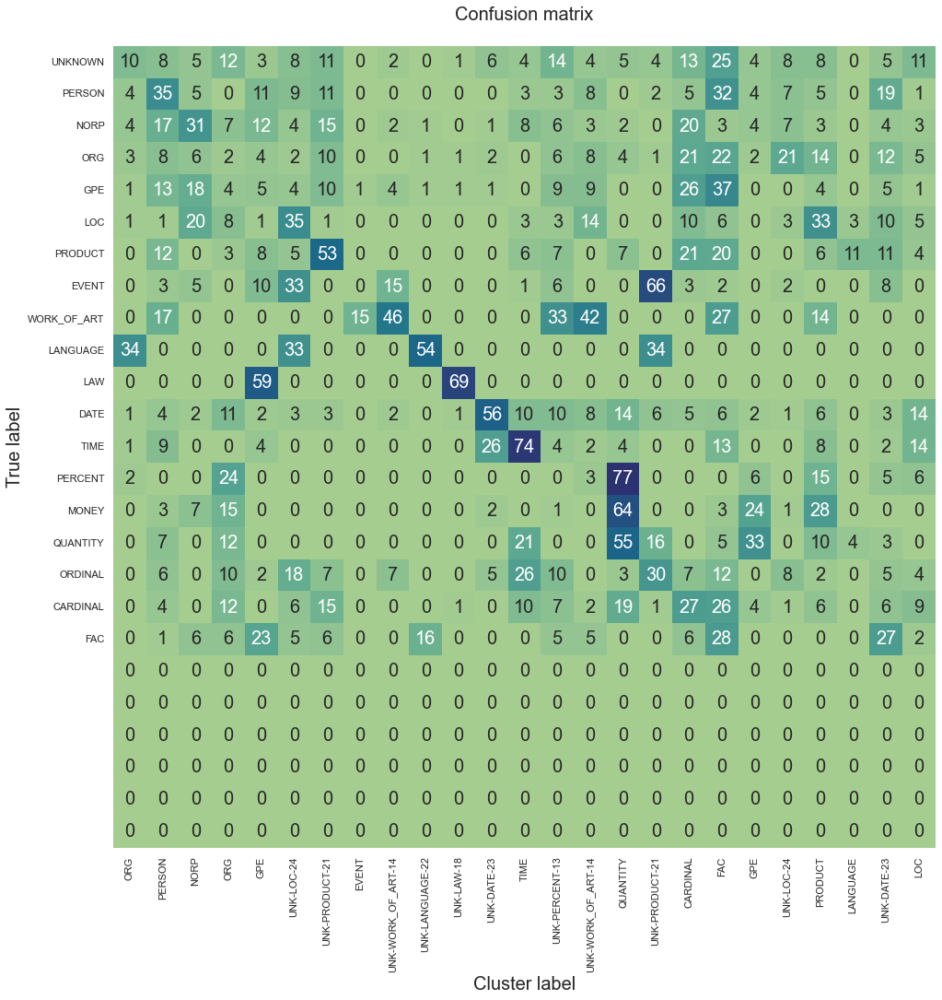

F1 score (macro) = 0.4617
Accuracy = 0.3923
Precision = 0.8466
Recall = 0.3926
New clusters =      4
... wrote results to c:\Users\Will\Projects\MSc\project\src\results\test-train_size=3000-radius=6-latent_weight=0.001-reconstr_weight=0.1-head=z-cluster=Kmeans-entity_count=15-noise_factor=0.1-\index.html
Finished 'evaluate_model' in 35.2 secs
--------------------------------------------------
41/60: test-train_size=3000-radius=6-latent_weight=0.001-reconstr_weight=0.25-head=z-cluster=Kmeans-entity_count=15-noise_factor=0.1-
--------------------------------------------------
{'train_size': 3000, 'radius': 6, 'latent_weight': 0.001, 'reconstr_weight': 0.25, 'head': 'z', 'cluster': 'Kmeans', 'entity_count': 15, 'noise_factor': 0.1}
ERROR: Invalid config key <module 'tensorflow.keras' from 'c:\\Users\\Will\\Anaconda3\\envs\\tf-27\\lib\\site-packages\\keras\\api\\_v2\\keras\\__init__.py'>
Autoencoder
Latent Model
model compiled
Epoch 178: early stopping


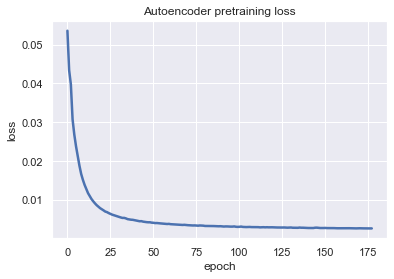

  0%|          | 0/8000 [00:00<?, ?it/s]

Stop traing for tolerance threshold reached
Iter: 1157 loss=-0.004902302287518978


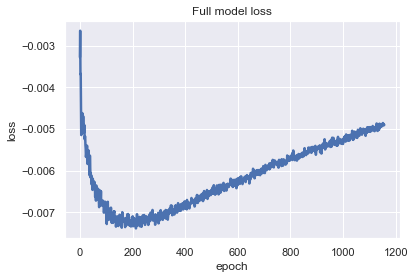

Training Done

F1 by Known Clusters: 0.1806


<Figure size 432x288 with 0 Axes>

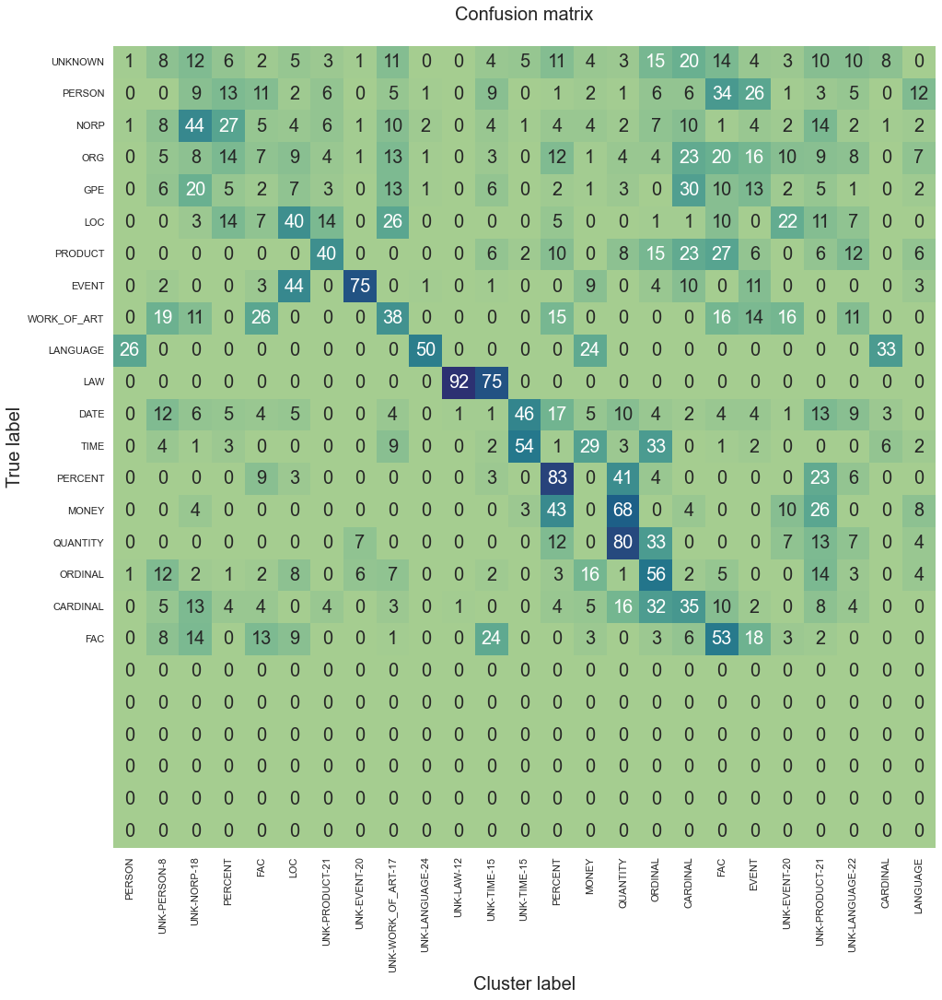

F1 score (macro) = 0.4749
Accuracy = 0.4123
Precision = 0.7939
Recall = 0.4119
New clusters =      4
... wrote results to c:\Users\Will\Projects\MSc\project\src\results\test-train_size=3000-radius=6-latent_weight=0.001-reconstr_weight=0.25-head=z-cluster=Kmeans-entity_count=15-noise_factor=0.1-\index.html
Finished 'evaluate_model' in 34.55 secs
--------------------------------------------------
42/60: test-train_size=3000-radius=6-latent_weight=0.001-reconstr_weight=0.5-head=z-cluster=Kmeans-entity_count=15-noise_factor=0.1-
--------------------------------------------------
{'train_size': 3000, 'radius': 6, 'latent_weight': 0.001, 'reconstr_weight': 0.5, 'head': 'z', 'cluster': 'Kmeans', 'entity_count': 15, 'noise_factor': 0.1}
ERROR: Invalid config key <module 'tensorflow.keras' from 'c:\\Users\\Will\\Anaconda3\\envs\\tf-27\\lib\\site-packages\\keras\\api\\_v2\\keras\\__init__.py'>
Autoencoder
Latent Model
model compiled
Epoch 232: early stopping


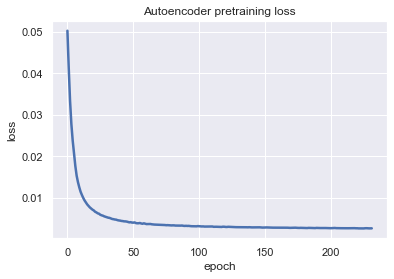

  0%|          | 0/8000 [00:00<?, ?it/s]

Stop traing for tolerance threshold reached
Iter: 1637 loss=-0.00038771284744143486


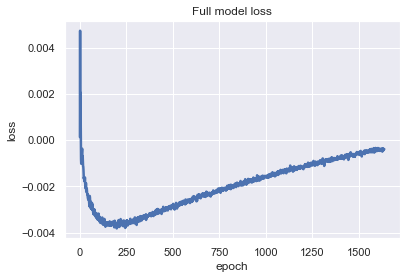

Training Done

F1 by Known Clusters: 0.2409


<Figure size 432x288 with 0 Axes>

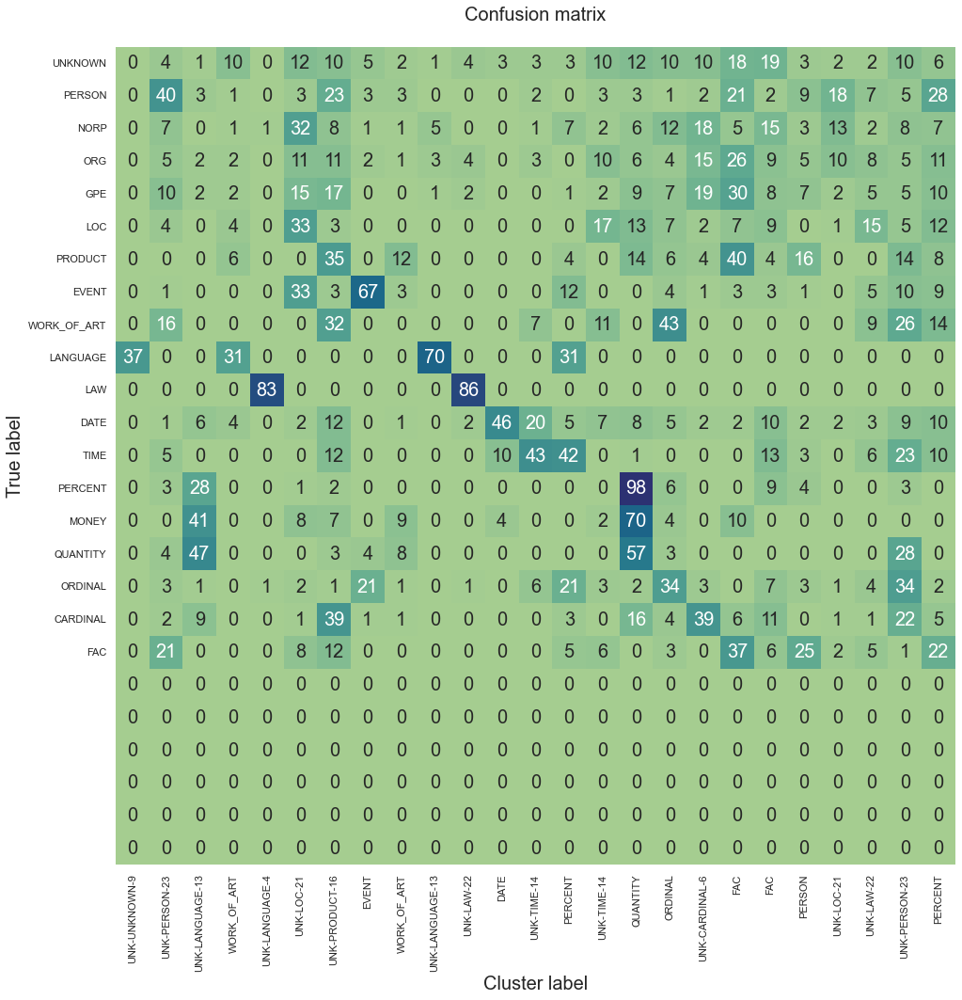

F1 score (macro) = 0.4498
Accuracy = 0.3977
Precision = 0.7411
Recall = 0.3910
New clusters =      4
... wrote results to c:\Users\Will\Projects\MSc\project\src\results\test-train_size=3000-radius=6-latent_weight=0.001-reconstr_weight=0.5-head=z-cluster=Kmeans-entity_count=15-noise_factor=0.1-\index.html
Finished 'evaluate_model' in 35.345 secs
--------------------------------------------------
43/60: test-train_size=3000-radius=6-latent_weight=0.001-reconstr_weight=0.75-head=z-cluster=Kmeans-entity_count=15-noise_factor=0.1-
--------------------------------------------------
{'train_size': 3000, 'radius': 6, 'latent_weight': 0.001, 'reconstr_weight': 0.75, 'head': 'z', 'cluster': 'Kmeans', 'entity_count': 15, 'noise_factor': 0.1}
ERROR: Invalid config key <module 'tensorflow.keras' from 'c:\\Users\\Will\\Anaconda3\\envs\\tf-27\\lib\\site-packages\\keras\\api\\_v2\\keras\\__init__.py'>
Autoencoder
Latent Model
model compiled
Epoch 210: early stopping


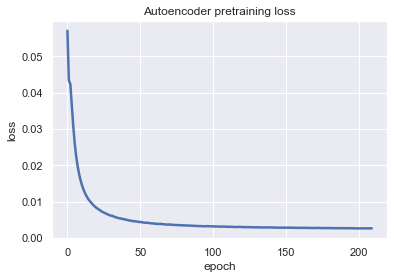

  0%|          | 0/8000 [00:00<?, ?it/s]

Stop traing for tolerance threshold reached
Iter: 2497 loss=0.0032481057569384575


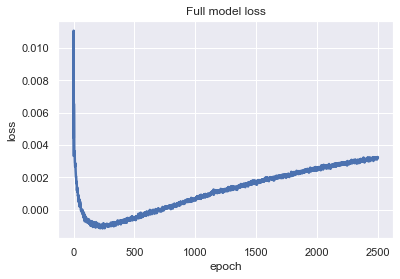

Training Done

F1 by Known Clusters: 0.2830


<Figure size 432x288 with 0 Axes>

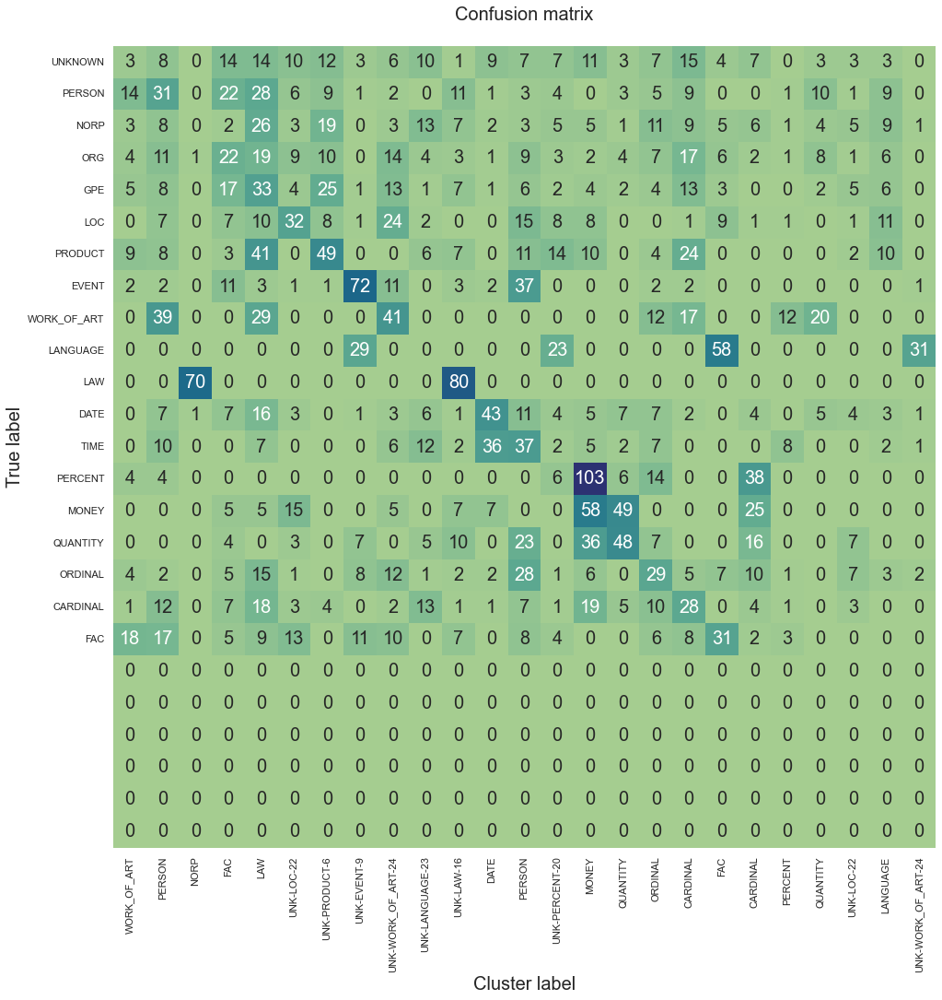

F1 score (macro) = 0.4147
Accuracy = 0.3753
Precision = 0.7936
Recall = 0.3730
New clusters =      3
... wrote results to c:\Users\Will\Projects\MSc\project\src\results\test-train_size=3000-radius=6-latent_weight=0.001-reconstr_weight=0.75-head=z-cluster=Kmeans-entity_count=15-noise_factor=0.1-\index.html
Finished 'evaluate_model' in 36.38 secs
--------------------------------------------------
44/60: test-train_size=3000-radius=6-latent_weight=0.001-reconstr_weight=0.9-head=z-cluster=Kmeans-entity_count=15-noise_factor=0.1-
--------------------------------------------------
{'train_size': 3000, 'radius': 6, 'latent_weight': 0.001, 'reconstr_weight': 0.9, 'head': 'z', 'cluster': 'Kmeans', 'entity_count': 15, 'noise_factor': 0.1}
ERROR: Invalid config key <module 'tensorflow.keras' from 'c:\\Users\\Will\\Anaconda3\\envs\\tf-27\\lib\\site-packages\\keras\\api\\_v2\\keras\\__init__.py'>
Autoencoder
Latent Model
model compiled
Epoch 188: early stopping


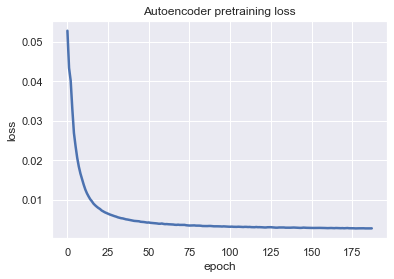

  0%|          | 0/8000 [00:00<?, ?it/s]

Stop traing for tolerance threshold reached
Iter: 5111 loss=0.006054512225091457


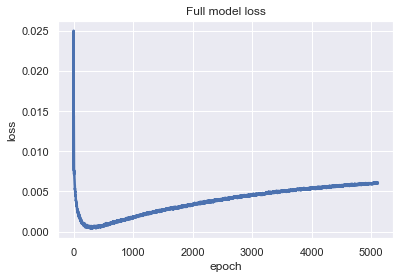

Training Done

F1 by Known Clusters: 0.3016


<Figure size 432x288 with 0 Axes>

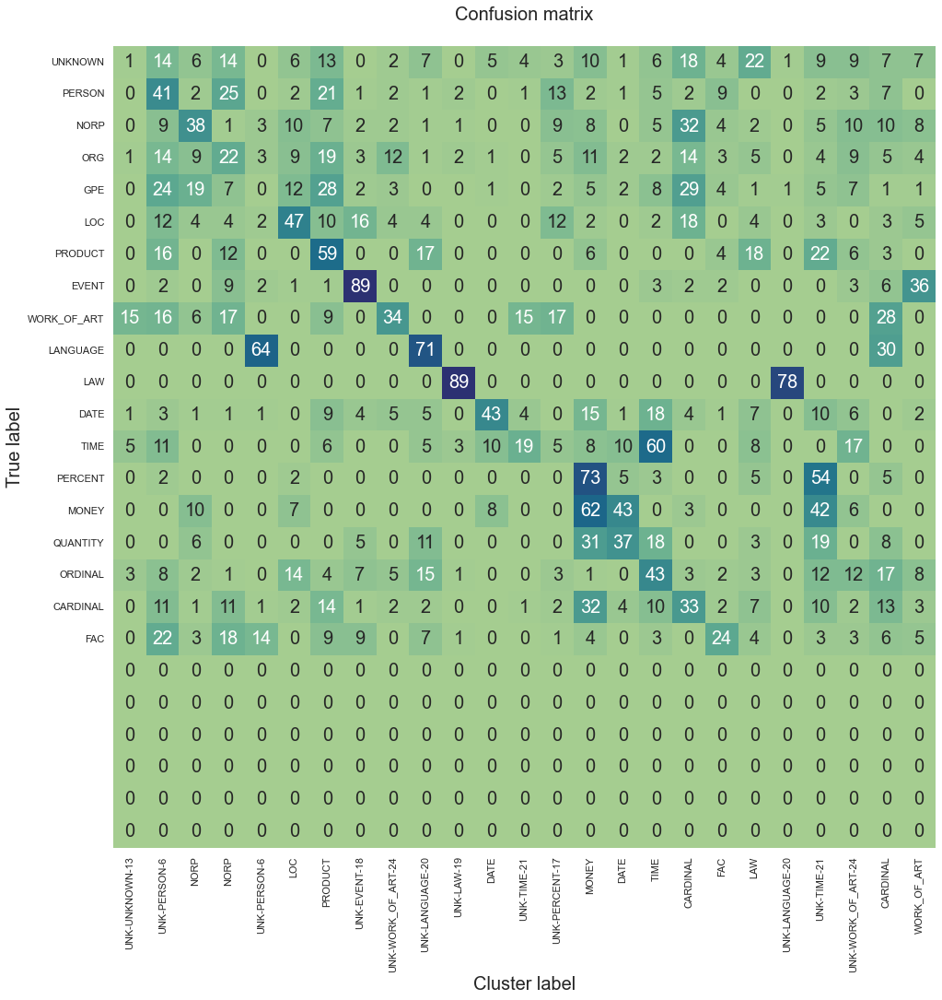

F1 score (macro) = 0.4627
Accuracy = 0.4227
Precision = 0.7415
Recall = 0.4175
New clusters =      4
... wrote results to c:\Users\Will\Projects\MSc\project\src\results\test-train_size=3000-radius=6-latent_weight=0.001-reconstr_weight=0.9-head=z-cluster=Kmeans-entity_count=15-noise_factor=0.1-\index.html
Finished 'evaluate_model' in 34.515 secs
--------------------------------------------------
45/60: test-train_size=3000-radius=6-latent_weight=0.01-reconstr_weight=0.1-head=z-cluster=Kmeans-entity_count=15-noise_factor=0.1-
--------------------------------------------------
{'train_size': 3000, 'radius': 6, 'latent_weight': 0.01, 'reconstr_weight': 0.1, 'head': 'z', 'cluster': 'Kmeans', 'entity_count': 15, 'noise_factor': 0.1}
ERROR: Invalid config key <module 'tensorflow.keras' from 'c:\\Users\\Will\\Anaconda3\\envs\\tf-27\\lib\\site-packages\\keras\\api\\_v2\\keras\\__init__.py'>
Autoencoder
Latent Model
model compiled
Epoch 210: early stopping


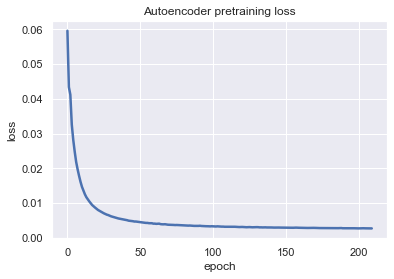

  0%|          | 0/8000 [00:00<?, ?it/s]

Iter: 7999 loss=-0.028126699849963188


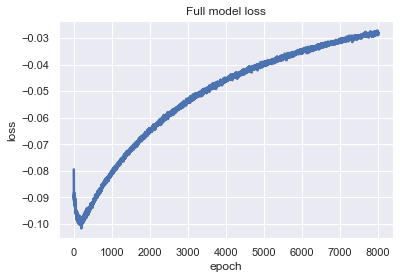

Training Done

F1 by Known Clusters: 0.3205


<Figure size 432x288 with 0 Axes>

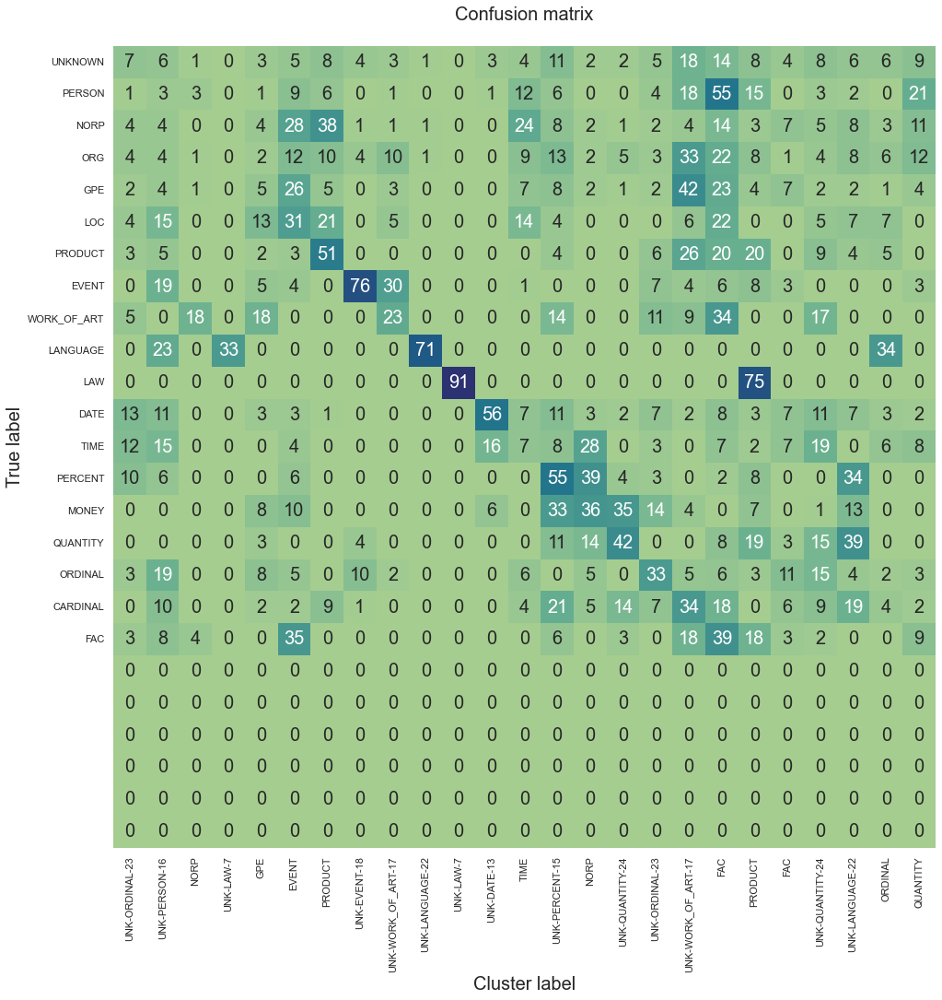

F1 score (macro) = 0.4318
Accuracy = 0.3807
Precision = 0.7405
Recall = 0.3833
New clusters =      6
... wrote results to c:\Users\Will\Projects\MSc\project\src\results\test-train_size=3000-radius=6-latent_weight=0.01-reconstr_weight=0.1-head=z-cluster=Kmeans-entity_count=15-noise_factor=0.1-\index.html
Finished 'evaluate_model' in 33.181 secs
--------------------------------------------------
46/60: test-train_size=3000-radius=6-latent_weight=0.01-reconstr_weight=0.25-head=z-cluster=Kmeans-entity_count=15-noise_factor=0.1-
--------------------------------------------------
{'train_size': 3000, 'radius': 6, 'latent_weight': 0.01, 'reconstr_weight': 0.25, 'head': 'z', 'cluster': 'Kmeans', 'entity_count': 15, 'noise_factor': 0.1}
ERROR: Invalid config key <module 'tensorflow.keras' from 'c:\\Users\\Will\\Anaconda3\\envs\\tf-27\\lib\\site-packages\\keras\\api\\_v2\\keras\\__init__.py'>
Autoencoder
Latent Model
model compiled
Epoch 191: early stopping


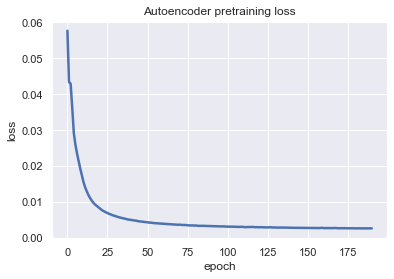

  0%|          | 0/8000 [00:00<?, ?it/s]

Iter: 7999 loss=-0.01595311611890793


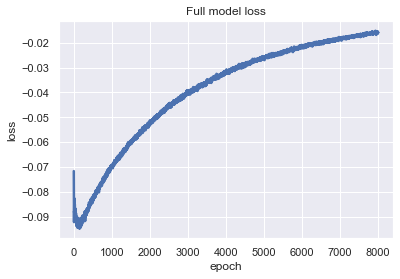

Training Done

F1 by Known Clusters: 0.2886


<Figure size 432x288 with 0 Axes>

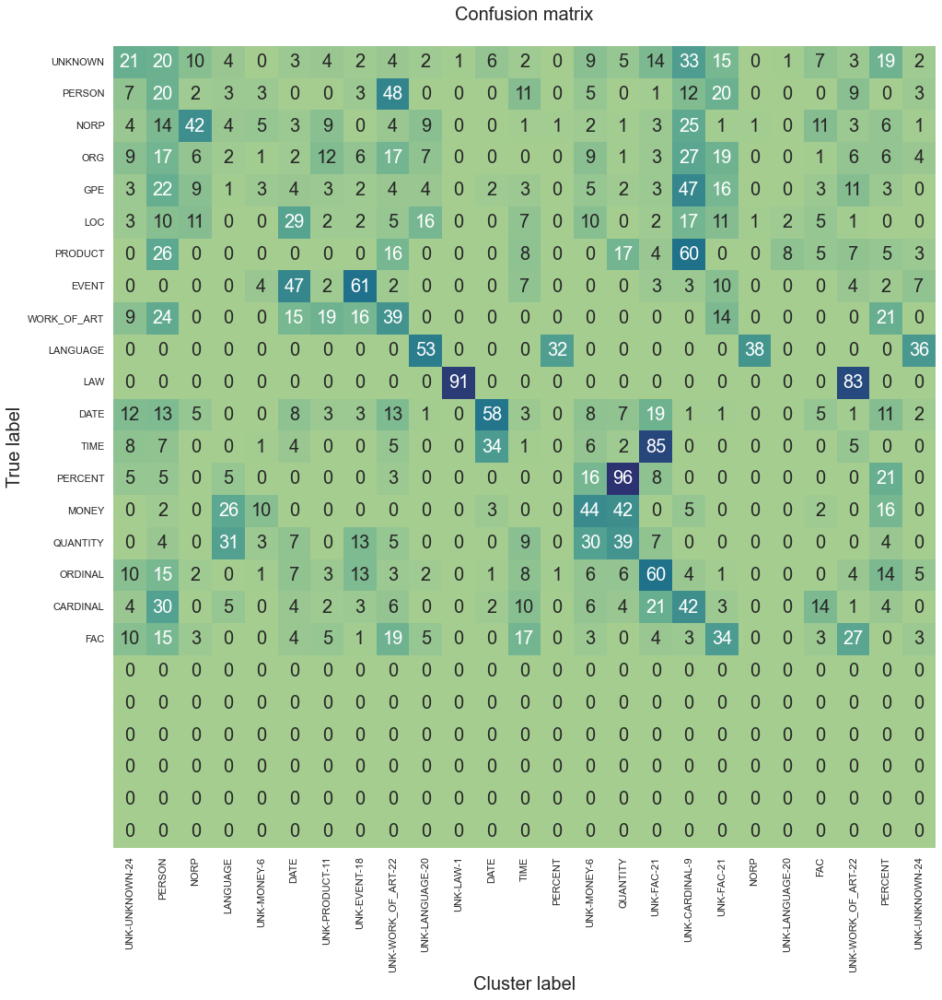

F1 score (macro) = 0.4571
Accuracy = 0.4150
Precision = 0.7419
Recall = 0.4020
New clusters =      6
... wrote results to c:\Users\Will\Projects\MSc\project\src\results\test-train_size=3000-radius=6-latent_weight=0.01-reconstr_weight=0.25-head=z-cluster=Kmeans-entity_count=15-noise_factor=0.1-\index.html
Finished 'evaluate_model' in 33.309 secs
--------------------------------------------------
47/60: test-train_size=3000-radius=6-latent_weight=0.01-reconstr_weight=0.5-head=z-cluster=Kmeans-entity_count=15-noise_factor=0.1-
--------------------------------------------------
{'train_size': 3000, 'radius': 6, 'latent_weight': 0.01, 'reconstr_weight': 0.5, 'head': 'z', 'cluster': 'Kmeans', 'entity_count': 15, 'noise_factor': 0.1}
ERROR: Invalid config key <module 'tensorflow.keras' from 'c:\\Users\\Will\\Anaconda3\\envs\\tf-27\\lib\\site-packages\\keras\\api\\_v2\\keras\\__init__.py'>
Autoencoder
Latent Model
model compiled
Epoch 215: early stopping


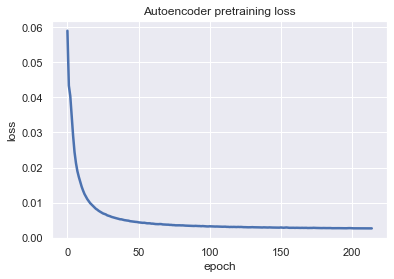

  0%|          | 0/8000 [00:00<?, ?it/s]

Iter: 7999 loss=-0.010438462719321251


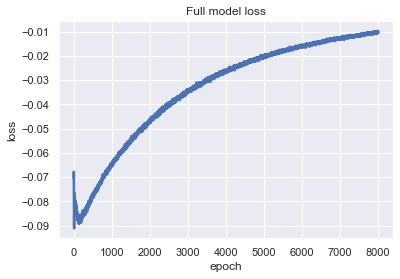

Training Done

F1 by Known Clusters: 0.1794


<Figure size 432x288 with 0 Axes>

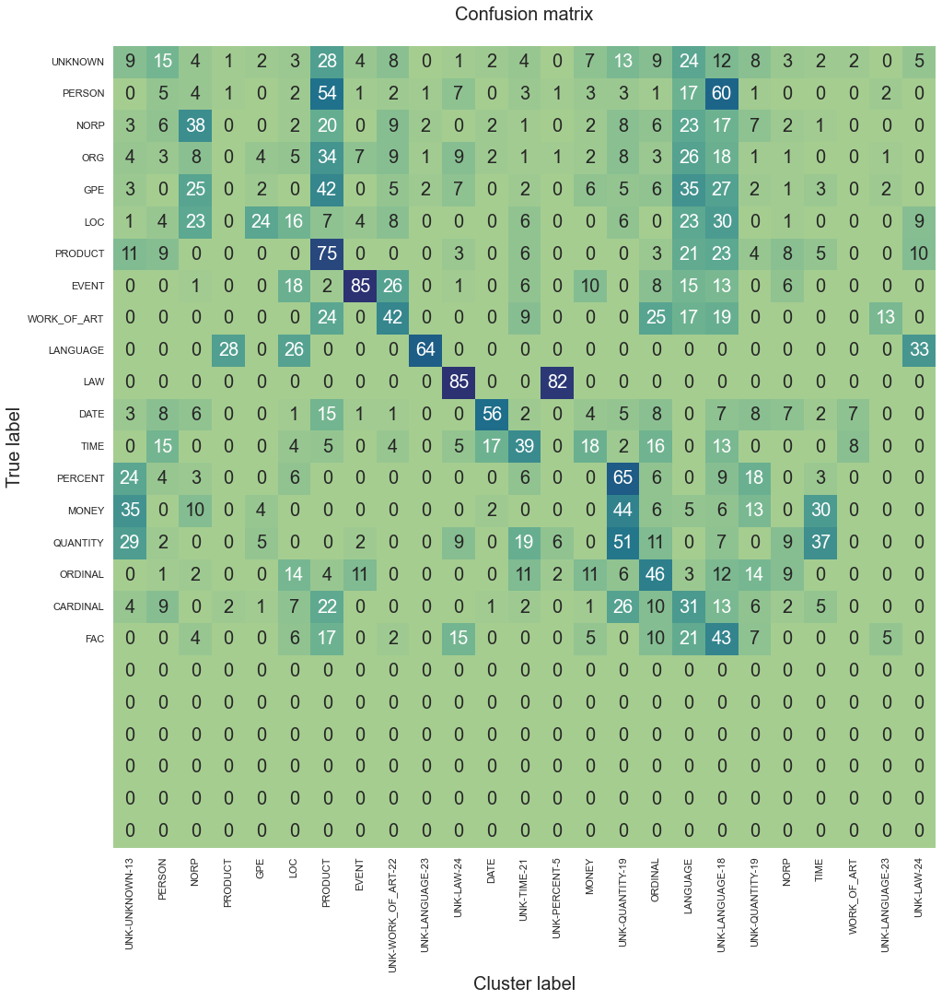

F1 score (macro) = 0.4519
Accuracy = 0.3957
Precision = 0.7939
Recall = 0.3895
New clusters =      2
... wrote results to c:\Users\Will\Projects\MSc\project\src\results\test-train_size=3000-radius=6-latent_weight=0.01-reconstr_weight=0.5-head=z-cluster=Kmeans-entity_count=15-noise_factor=0.1-\index.html
Finished 'evaluate_model' in 35.171 secs
--------------------------------------------------
48/60: test-train_size=3000-radius=6-latent_weight=0.01-reconstr_weight=0.75-head=z-cluster=Kmeans-entity_count=15-noise_factor=0.1-
--------------------------------------------------
{'train_size': 3000, 'radius': 6, 'latent_weight': 0.01, 'reconstr_weight': 0.75, 'head': 'z', 'cluster': 'Kmeans', 'entity_count': 15, 'noise_factor': 0.1}
ERROR: Invalid config key <module 'tensorflow.keras' from 'c:\\Users\\Will\\Anaconda3\\envs\\tf-27\\lib\\site-packages\\keras\\api\\_v2\\keras\\__init__.py'>
Autoencoder
Latent Model
model compiled
Epoch 197: early stopping


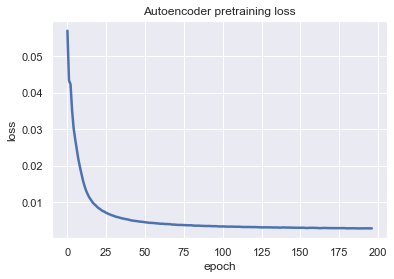

  0%|          | 0/8000 [00:00<?, ?it/s]

Iter: 7999 loss=-0.01133755873888731


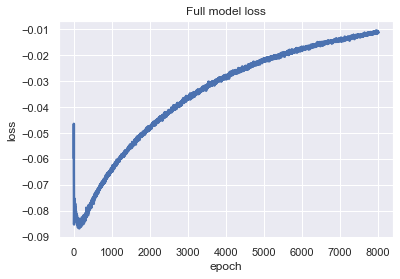

Training Done

F1 by Known Clusters: 0.3231


<Figure size 432x288 with 0 Axes>

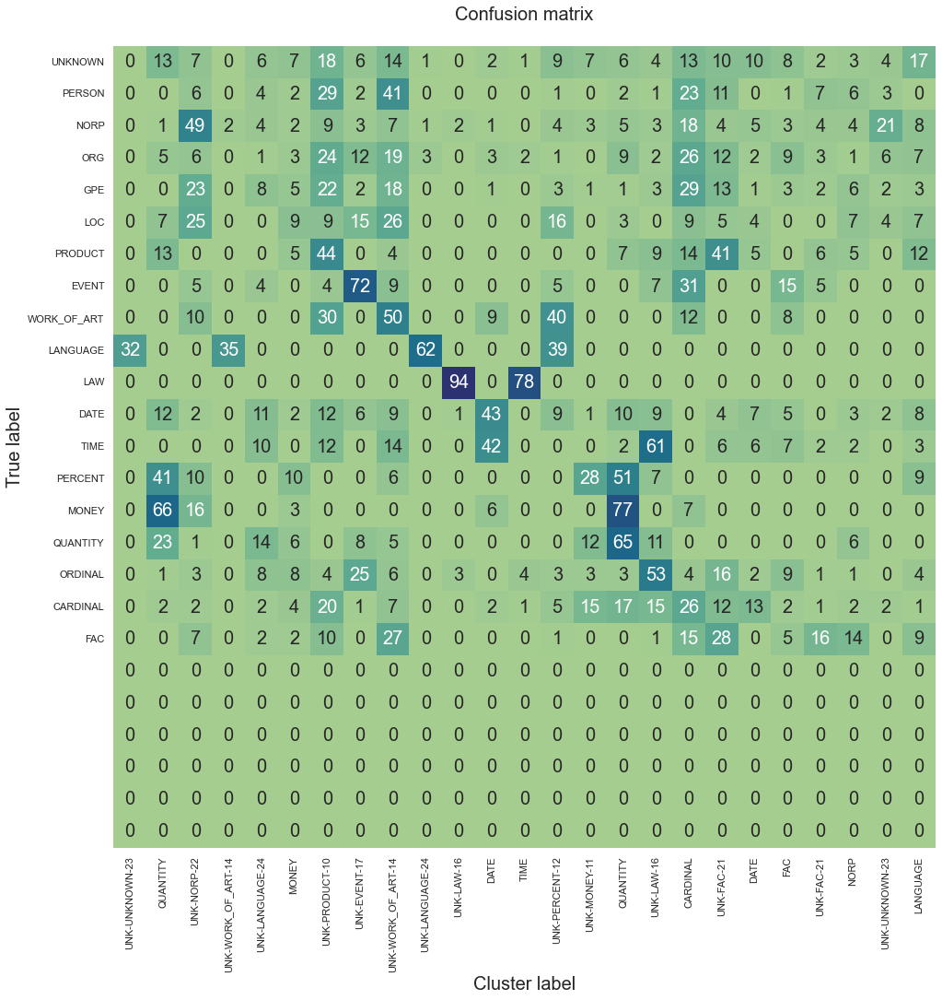

F1 score (macro) = 0.4115
Accuracy = 0.3913
Precision = 0.6886
Recall = 0.3747
New clusters =      2
... wrote results to c:\Users\Will\Projects\MSc\project\src\results\test-train_size=3000-radius=6-latent_weight=0.01-reconstr_weight=0.75-head=z-cluster=Kmeans-entity_count=15-noise_factor=0.1-\index.html
Finished 'evaluate_model' in 35.794 secs
--------------------------------------------------
49/60: test-train_size=3000-radius=6-latent_weight=0.01-reconstr_weight=0.9-head=z-cluster=Kmeans-entity_count=15-noise_factor=0.1-
--------------------------------------------------
{'train_size': 3000, 'radius': 6, 'latent_weight': 0.01, 'reconstr_weight': 0.9, 'head': 'z', 'cluster': 'Kmeans', 'entity_count': 15, 'noise_factor': 0.1}
ERROR: Invalid config key <module 'tensorflow.keras' from 'c:\\Users\\Will\\Anaconda3\\envs\\tf-27\\lib\\site-packages\\keras\\api\\_v2\\keras\\__init__.py'>
Autoencoder
Latent Model
model compiled
Epoch 232: early stopping


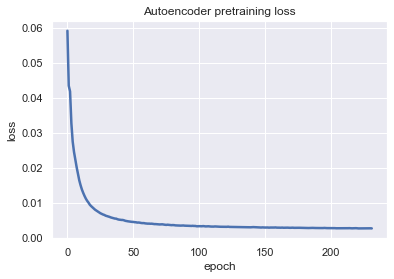

  0%|          | 0/8000 [00:00<?, ?it/s]

Iter: 7999 loss=-0.006423505023121834


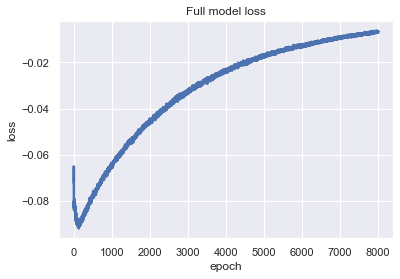

Training Done

F1 by Known Clusters: 0.2467


<Figure size 432x288 with 0 Axes>

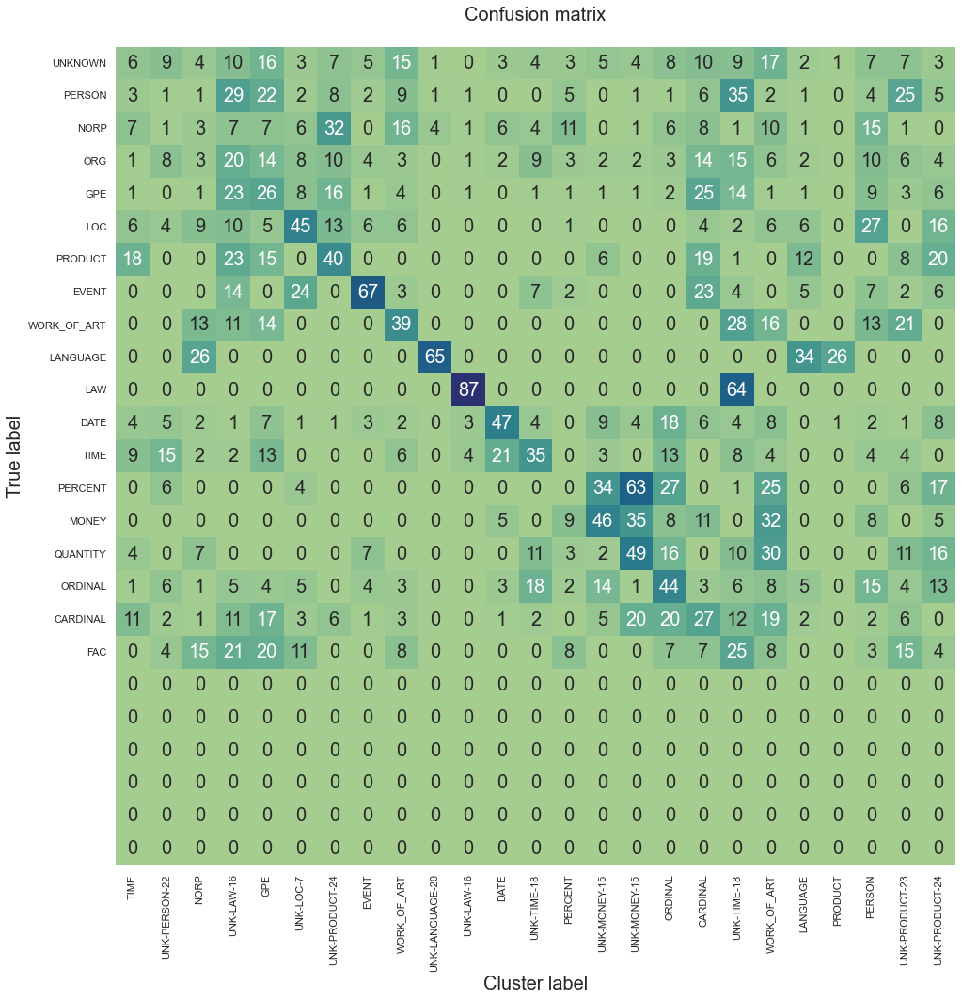

F1 score (macro) = 0.4316
Accuracy = 0.3723
Precision = 0.7936
Recall = 0.3737
New clusters =      4
... wrote results to c:\Users\Will\Projects\MSc\project\src\results\test-train_size=3000-radius=6-latent_weight=0.01-reconstr_weight=0.9-head=z-cluster=Kmeans-entity_count=15-noise_factor=0.1-\index.html
Finished 'evaluate_model' in 35.585 secs
--------------------------------------------------
50/60: test-train_size=3000-radius=6-latent_weight=0.1-reconstr_weight=0.1-head=z-cluster=Kmeans-entity_count=15-noise_factor=0.1-
--------------------------------------------------
{'train_size': 3000, 'radius': 6, 'latent_weight': 0.1, 'reconstr_weight': 0.1, 'head': 'z', 'cluster': 'Kmeans', 'entity_count': 15, 'noise_factor': 0.1}
ERROR: Invalid config key <module 'tensorflow.keras' from 'c:\\Users\\Will\\Anaconda3\\envs\\tf-27\\lib\\site-packages\\keras\\api\\_v2\\keras\\__init__.py'>
Autoencoder
Latent Model
model compiled
Epoch 206: early stopping


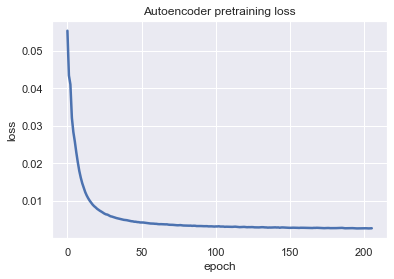

  0%|          | 0/8000 [00:00<?, ?it/s]

Iter: 7999 loss=-0.3205987215042114


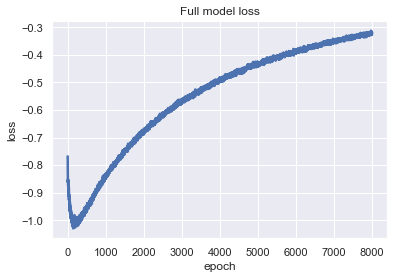

Training Done

F1 by Known Clusters: 0.2431


<Figure size 432x288 with 0 Axes>

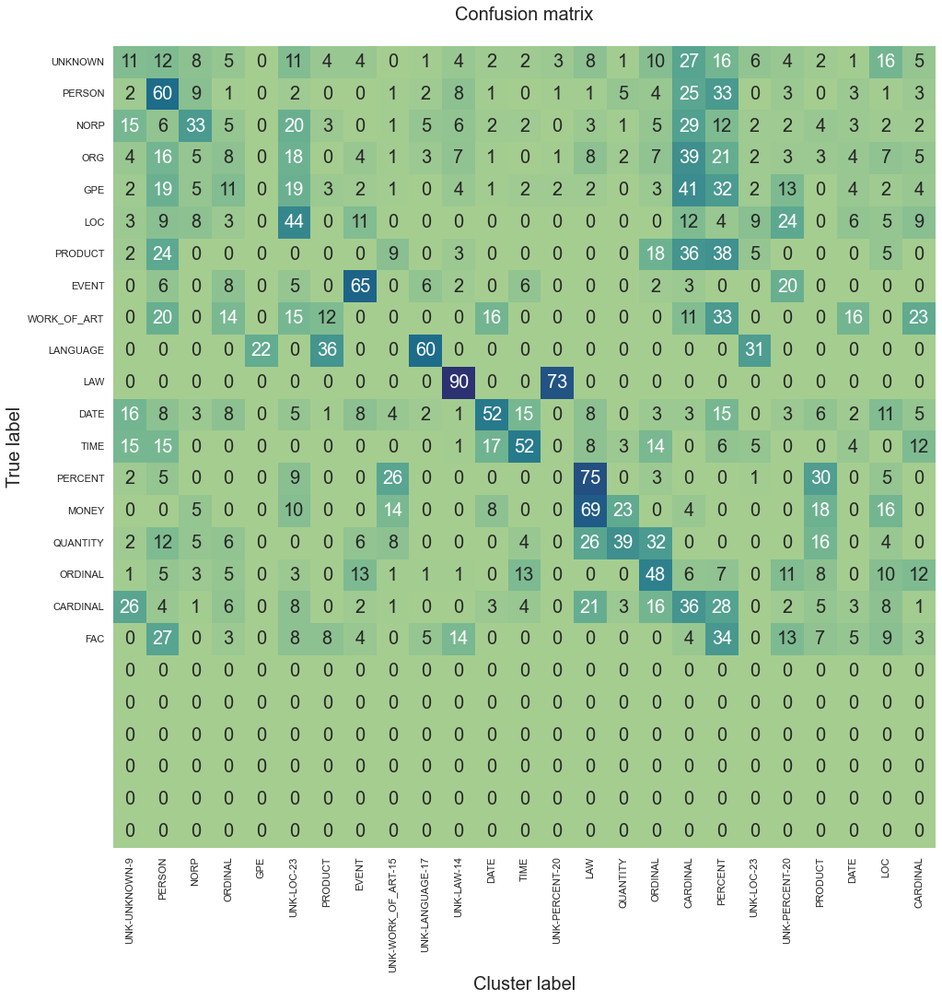

F1 score (macro) = 0.4559
Accuracy = 0.3937
Precision = 0.7938
Recall = 0.3990
New clusters =      6
... wrote results to c:\Users\Will\Projects\MSc\project\src\results\test-train_size=3000-radius=6-latent_weight=0.1-reconstr_weight=0.1-head=z-cluster=Kmeans-entity_count=15-noise_factor=0.1-\index.html
Finished 'evaluate_model' in 35.204 secs
--------------------------------------------------
51/60: test-train_size=3000-radius=6-latent_weight=0.1-reconstr_weight=0.25-head=z-cluster=Kmeans-entity_count=15-noise_factor=0.1-
--------------------------------------------------
{'train_size': 3000, 'radius': 6, 'latent_weight': 0.1, 'reconstr_weight': 0.25, 'head': 'z', 'cluster': 'Kmeans', 'entity_count': 15, 'noise_factor': 0.1}
ERROR: Invalid config key <module 'tensorflow.keras' from 'c:\\Users\\Will\\Anaconda3\\envs\\tf-27\\lib\\site-packages\\keras\\api\\_v2\\keras\\__init__.py'>
Autoencoder
Latent Model
model compiled
Epoch 206: early stopping


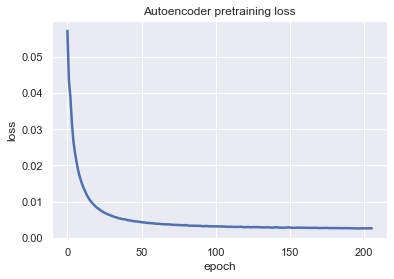

  0%|          | 0/8000 [00:00<?, ?it/s]

Iter: 7999 loss=-0.24309511482715607


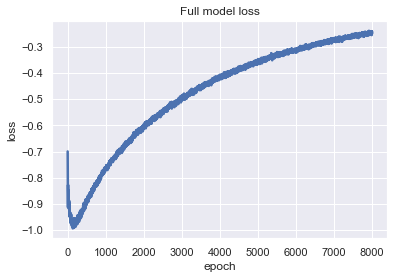

Training Done

F1 by Known Clusters: 0.2489


<Figure size 432x288 with 0 Axes>

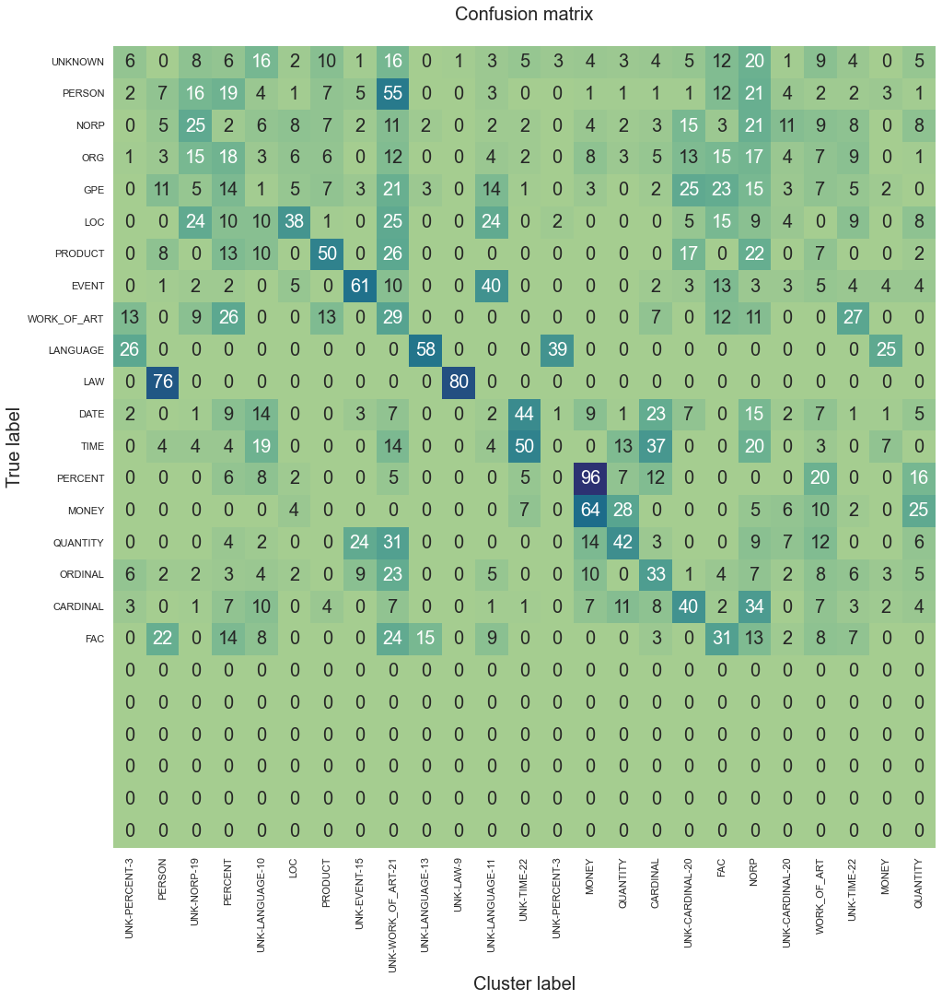

F1 score (macro) = 0.4404
Accuracy = 0.3917
Precision = 0.7407
Recall = 0.3917
New clusters =      5
... wrote results to c:\Users\Will\Projects\MSc\project\src\results\test-train_size=3000-radius=6-latent_weight=0.1-reconstr_weight=0.25-head=z-cluster=Kmeans-entity_count=15-noise_factor=0.1-\index.html
Finished 'evaluate_model' in 35.053 secs
--------------------------------------------------
52/60: test-train_size=3000-radius=6-latent_weight=0.1-reconstr_weight=0.5-head=z-cluster=Kmeans-entity_count=15-noise_factor=0.1-
--------------------------------------------------
{'train_size': 3000, 'radius': 6, 'latent_weight': 0.1, 'reconstr_weight': 0.5, 'head': 'z', 'cluster': 'Kmeans', 'entity_count': 15, 'noise_factor': 0.1}
ERROR: Invalid config key <module 'tensorflow.keras' from 'c:\\Users\\Will\\Anaconda3\\envs\\tf-27\\lib\\site-packages\\keras\\api\\_v2\\keras\\__init__.py'>
Autoencoder
Latent Model
model compiled
Epoch 229: early stopping


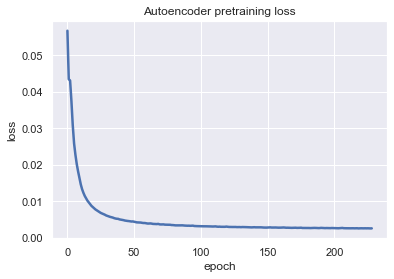

  0%|          | 0/8000 [00:00<?, ?it/s]

Iter: 7999 loss=-0.12671791017055511


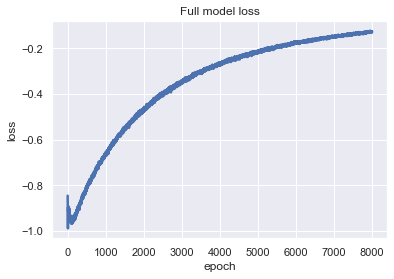

Training Done

F1 by Known Clusters: 0.2141


<Figure size 432x288 with 0 Axes>

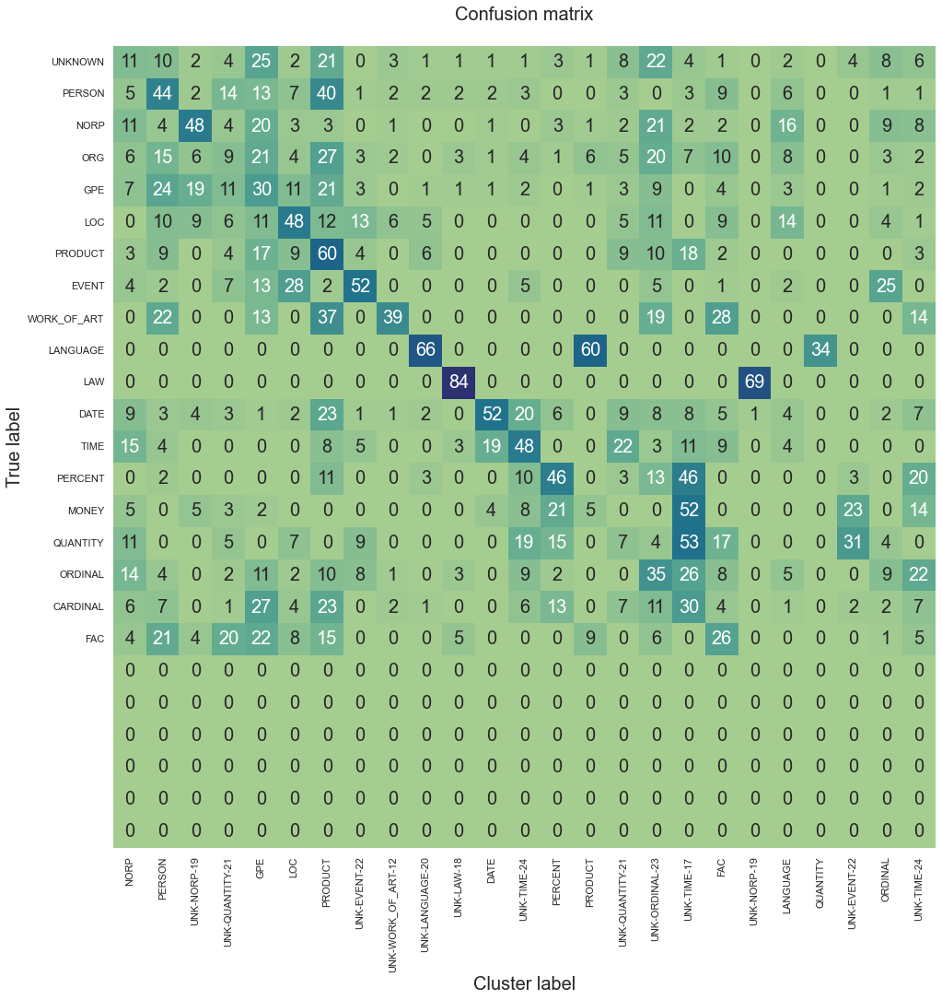

F1 score (macro) = 0.4602
Accuracy = 0.3960
Precision = 0.7933
Recall = 0.3981
New clusters =      2
... wrote results to c:\Users\Will\Projects\MSc\project\src\results\test-train_size=3000-radius=6-latent_weight=0.1-reconstr_weight=0.5-head=z-cluster=Kmeans-entity_count=15-noise_factor=0.1-\index.html
Finished 'evaluate_model' in 35.635 secs
--------------------------------------------------
53/60: test-train_size=3000-radius=6-latent_weight=0.1-reconstr_weight=0.75-head=z-cluster=Kmeans-entity_count=15-noise_factor=0.1-
--------------------------------------------------
{'train_size': 3000, 'radius': 6, 'latent_weight': 0.1, 'reconstr_weight': 0.75, 'head': 'z', 'cluster': 'Kmeans', 'entity_count': 15, 'noise_factor': 0.1}
ERROR: Invalid config key <module 'tensorflow.keras' from 'c:\\Users\\Will\\Anaconda3\\envs\\tf-27\\lib\\site-packages\\keras\\api\\_v2\\keras\\__init__.py'>
Autoencoder
Latent Model
model compiled
Epoch 159: early stopping


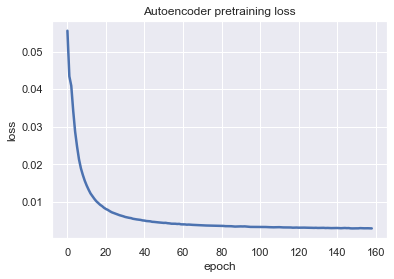

  0%|          | 0/8000 [00:00<?, ?it/s]

Iter: 7999 loss=-0.18349485099315643


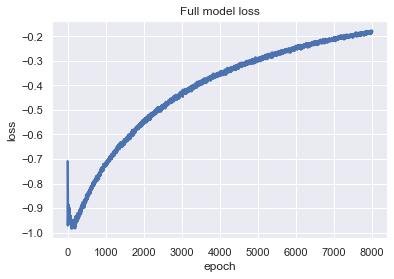

Training Done

F1 by Known Clusters: 0.1691


<Figure size 432x288 with 0 Axes>

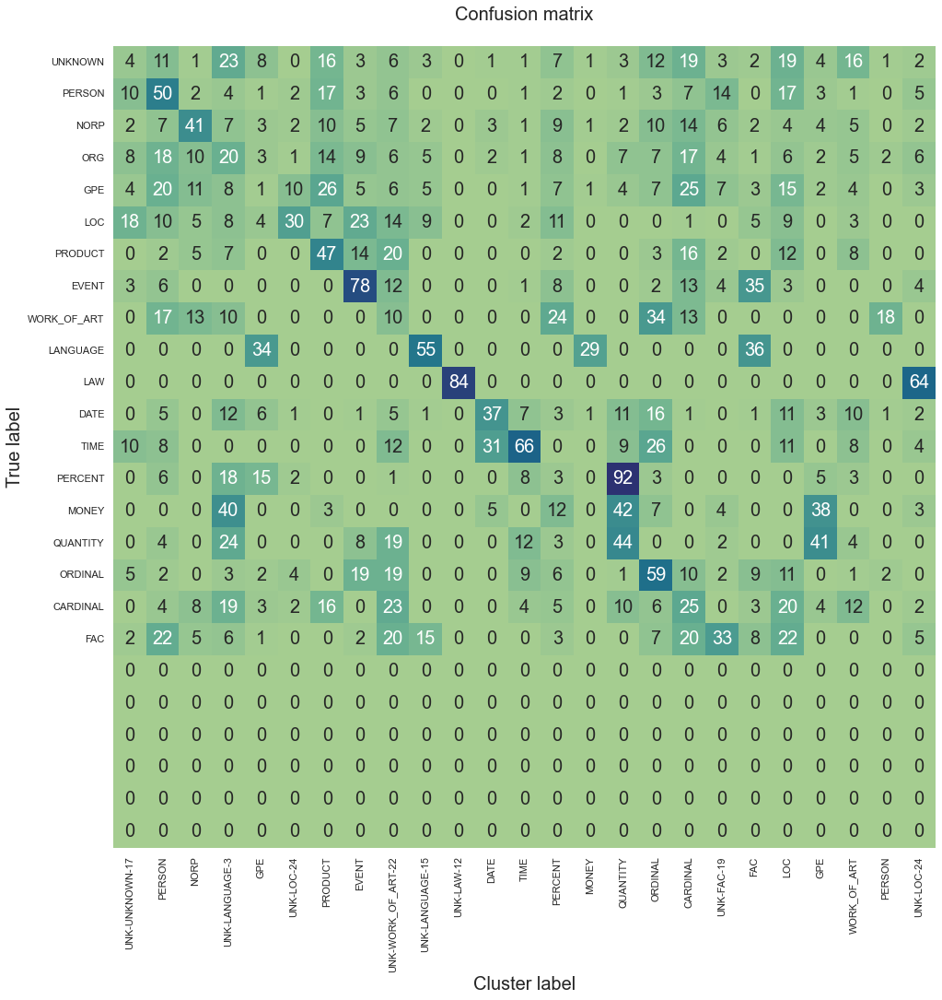

F1 score (macro) = 0.4834
Accuracy = 0.4040
Precision = 0.8992
Recall = 0.4060
New clusters =      3
... wrote results to c:\Users\Will\Projects\MSc\project\src\results\test-train_size=3000-radius=6-latent_weight=0.1-reconstr_weight=0.75-head=z-cluster=Kmeans-entity_count=15-noise_factor=0.1-\index.html
Finished 'evaluate_model' in 35.583 secs
--------------------------------------------------
54/60: test-train_size=3000-radius=6-latent_weight=0.1-reconstr_weight=0.9-head=z-cluster=Kmeans-entity_count=15-noise_factor=0.1-
--------------------------------------------------
{'train_size': 3000, 'radius': 6, 'latent_weight': 0.1, 'reconstr_weight': 0.9, 'head': 'z', 'cluster': 'Kmeans', 'entity_count': 15, 'noise_factor': 0.1}
ERROR: Invalid config key <module 'tensorflow.keras' from 'c:\\Users\\Will\\Anaconda3\\envs\\tf-27\\lib\\site-packages\\keras\\api\\_v2\\keras\\__init__.py'>
Autoencoder
Latent Model
model compiled
Epoch 209: early stopping


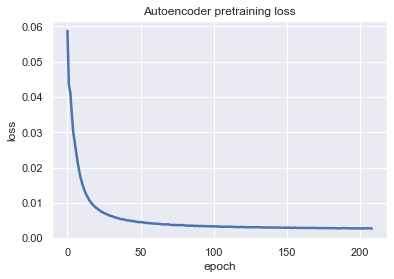

  0%|          | 0/8000 [00:00<?, ?it/s]

Iter: 7999 loss=-0.12806673347949982


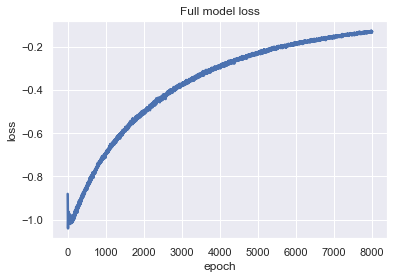

Training Done

F1 by Known Clusters: 0.2152


<Figure size 432x288 with 0 Axes>

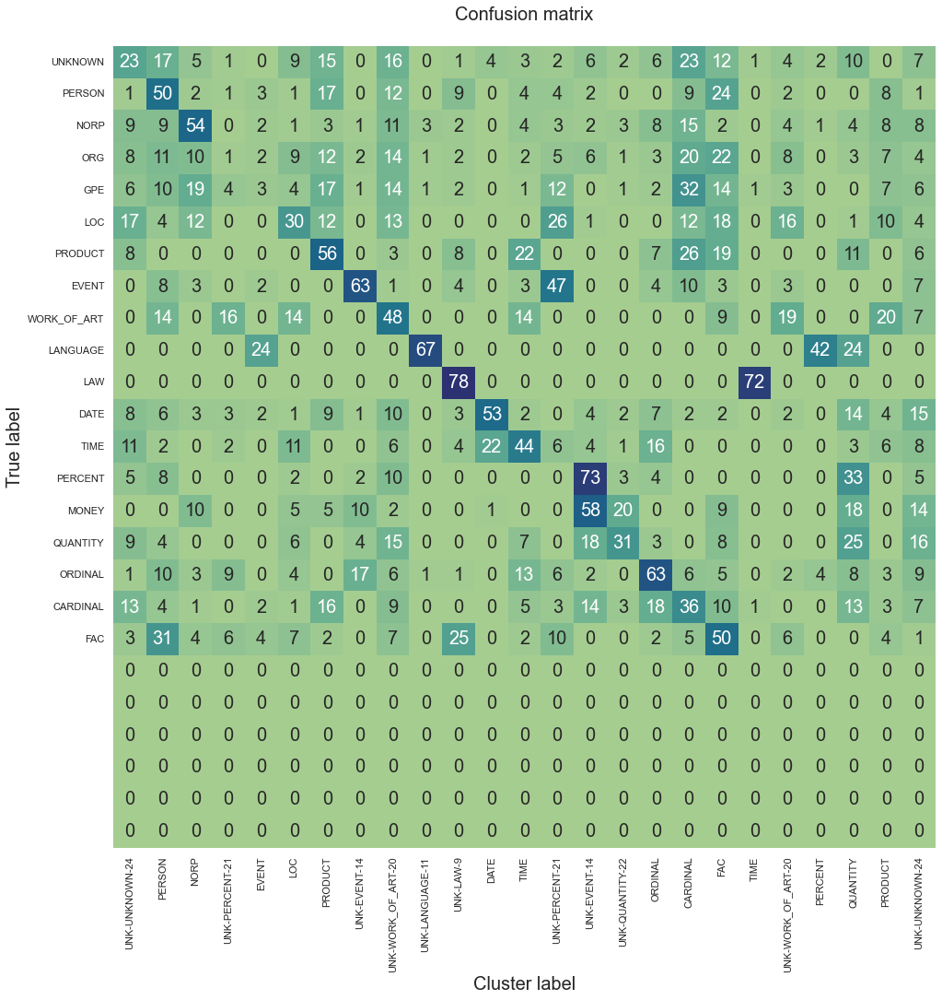

F1 score (macro) = 0.4820
Accuracy = 0.4180
Precision = 0.7941
Recall = 0.4187
New clusters =      5
... wrote results to c:\Users\Will\Projects\MSc\project\src\results\test-train_size=3000-radius=6-latent_weight=0.1-reconstr_weight=0.9-head=z-cluster=Kmeans-entity_count=15-noise_factor=0.1-\index.html
Finished 'evaluate_model' in 35.371 secs
--------------------------------------------------
55/60: test-train_size=3000-radius=6-latent_weight=1.0-reconstr_weight=0.1-head=z-cluster=Kmeans-entity_count=15-noise_factor=0.1-
--------------------------------------------------
{'train_size': 3000, 'radius': 6, 'latent_weight': 1.0, 'reconstr_weight': 0.1, 'head': 'z', 'cluster': 'Kmeans', 'entity_count': 15, 'noise_factor': 0.1}
ERROR: Invalid config key <module 'tensorflow.keras' from 'c:\\Users\\Will\\Anaconda3\\envs\\tf-27\\lib\\site-packages\\keras\\api\\_v2\\keras\\__init__.py'>
Autoencoder
Latent Model
model compiled
Epoch 163: early stopping


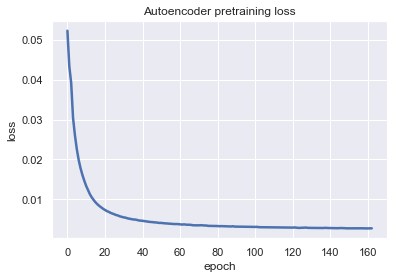

  0%|          | 0/8000 [00:00<?, ?it/s]

Iter: 7999 loss=-3.279355764389038


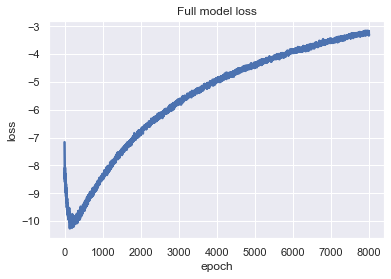

Training Done

F1 by Known Clusters: 0.2052


<Figure size 432x288 with 0 Axes>

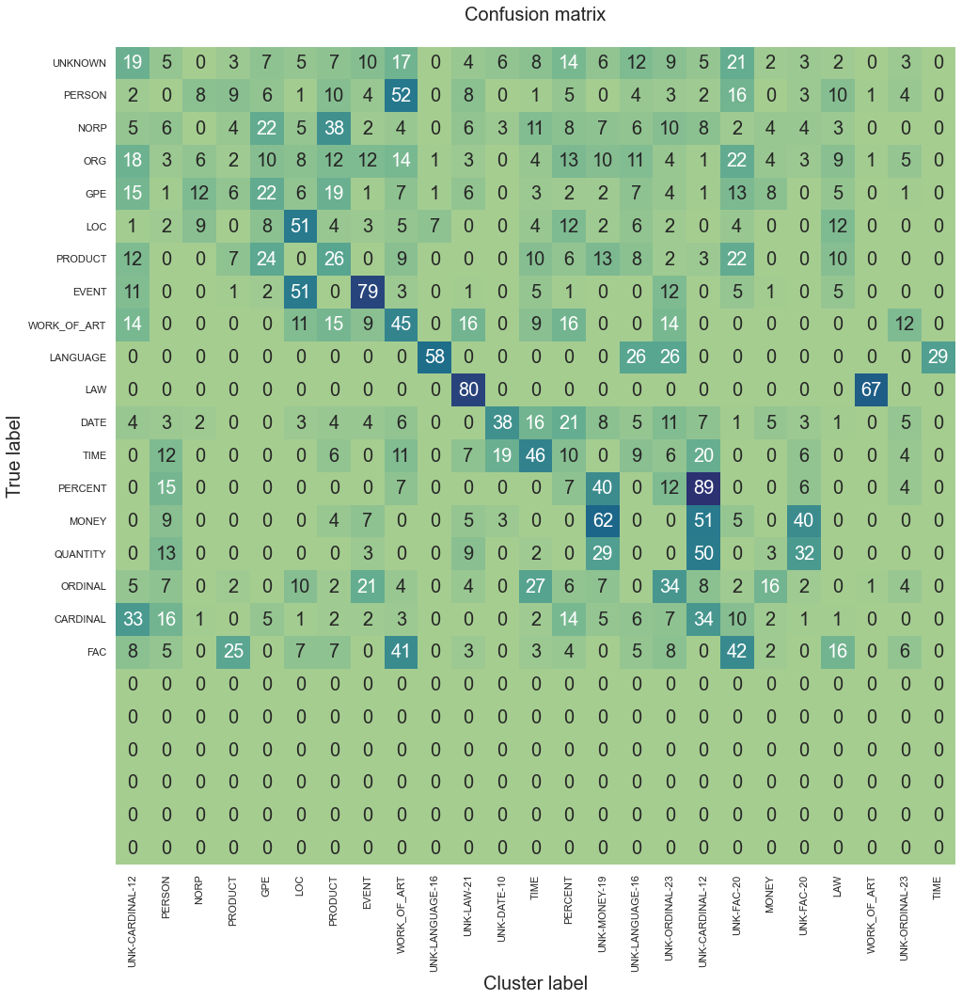

F1 score (macro) = 0.4579
Accuracy = 0.3913
Precision = 0.8465
Recall = 0.3891
New clusters =      3
... wrote results to c:\Users\Will\Projects\MSc\project\src\results\test-train_size=3000-radius=6-latent_weight=1.0-reconstr_weight=0.1-head=z-cluster=Kmeans-entity_count=15-noise_factor=0.1-\index.html
Finished 'evaluate_model' in 36.481 secs
--------------------------------------------------
56/60: test-train_size=3000-radius=6-latent_weight=1.0-reconstr_weight=0.25-head=z-cluster=Kmeans-entity_count=15-noise_factor=0.1-
--------------------------------------------------
{'train_size': 3000, 'radius': 6, 'latent_weight': 1.0, 'reconstr_weight': 0.25, 'head': 'z', 'cluster': 'Kmeans', 'entity_count': 15, 'noise_factor': 0.1}
ERROR: Invalid config key <module 'tensorflow.keras' from 'c:\\Users\\Will\\Anaconda3\\envs\\tf-27\\lib\\site-packages\\keras\\api\\_v2\\keras\\__init__.py'>
Autoencoder
Latent Model
model compiled
Epoch 194: early stopping


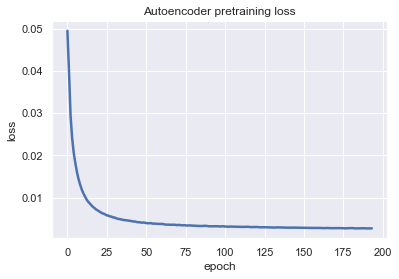

  0%|          | 0/8000 [00:00<?, ?it/s]

Iter: 7999 loss=-2.097404718399048


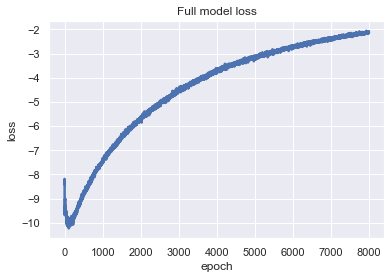

Training Done

F1 by Known Clusters: 0.1722


<Figure size 432x288 with 0 Axes>

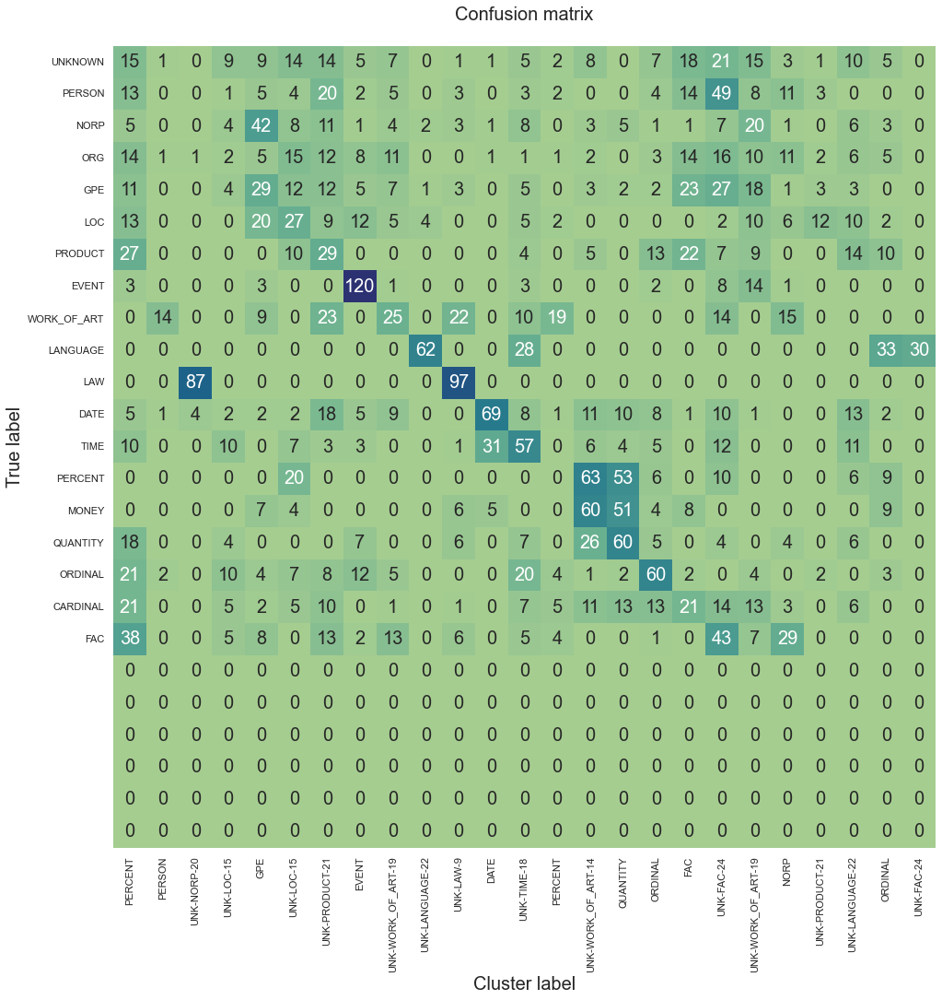

F1 score (macro) = 0.4785
Accuracy = 0.4200
Precision = 0.7942
Recall = 0.4102
New clusters =      6
... wrote results to c:\Users\Will\Projects\MSc\project\src\results\test-train_size=3000-radius=6-latent_weight=1.0-reconstr_weight=0.25-head=z-cluster=Kmeans-entity_count=15-noise_factor=0.1-\index.html
Finished 'evaluate_model' in 34.402 secs
--------------------------------------------------
57/60: test-train_size=3000-radius=6-latent_weight=1.0-reconstr_weight=0.5-head=z-cluster=Kmeans-entity_count=15-noise_factor=0.1-
--------------------------------------------------
{'train_size': 3000, 'radius': 6, 'latent_weight': 1.0, 'reconstr_weight': 0.5, 'head': 'z', 'cluster': 'Kmeans', 'entity_count': 15, 'noise_factor': 0.1}
ERROR: Invalid config key <module 'tensorflow.keras' from 'c:\\Users\\Will\\Anaconda3\\envs\\tf-27\\lib\\site-packages\\keras\\api\\_v2\\keras\\__init__.py'>
Autoencoder
Latent Model
model compiled
Epoch 186: early stopping


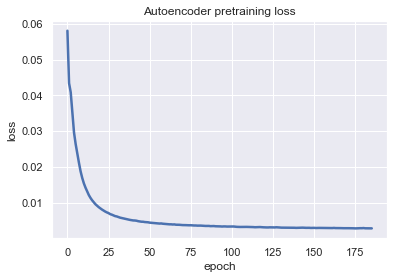

  0%|          | 0/8000 [00:00<?, ?it/s]

Iter: 7999 loss=-1.867978572845459


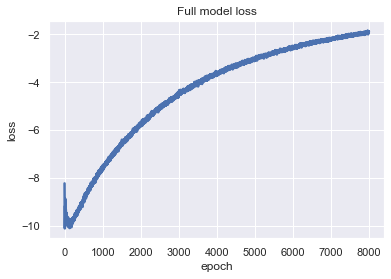

Training Done

F1 by Known Clusters: 0.2144


<Figure size 432x288 with 0 Axes>

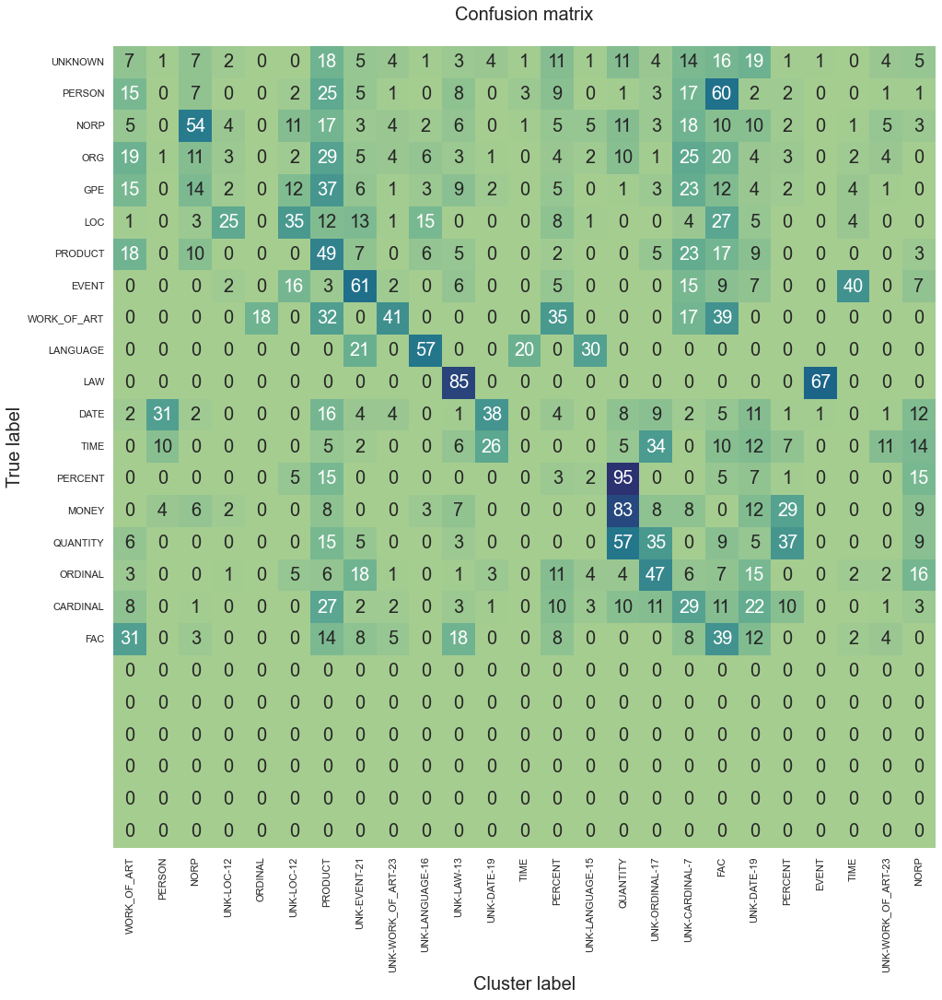

F1 score (macro) = 0.4642
Accuracy = 0.3913
Precision = 0.7932
Recall = 0.4022
New clusters =      2
... wrote results to c:\Users\Will\Projects\MSc\project\src\results\test-train_size=3000-radius=6-latent_weight=1.0-reconstr_weight=0.5-head=z-cluster=Kmeans-entity_count=15-noise_factor=0.1-\index.html
Finished 'evaluate_model' in 34.989 secs
--------------------------------------------------
58/60: test-train_size=3000-radius=6-latent_weight=1.0-reconstr_weight=0.75-head=z-cluster=Kmeans-entity_count=15-noise_factor=0.1-
--------------------------------------------------
{'train_size': 3000, 'radius': 6, 'latent_weight': 1.0, 'reconstr_weight': 0.75, 'head': 'z', 'cluster': 'Kmeans', 'entity_count': 15, 'noise_factor': 0.1}
ERROR: Invalid config key <module 'tensorflow.keras' from 'c:\\Users\\Will\\Anaconda3\\envs\\tf-27\\lib\\site-packages\\keras\\api\\_v2\\keras\\__init__.py'>
Autoencoder
Latent Model
model compiled
Epoch 177: early stopping


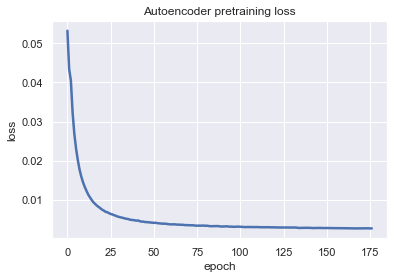

  0%|          | 0/8000 [00:00<?, ?it/s]

Iter: 7999 loss=-1.8535715341567993


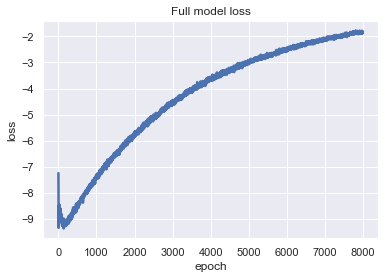

Training Done

F1 by Known Clusters: 0.2556


<Figure size 432x288 with 0 Axes>

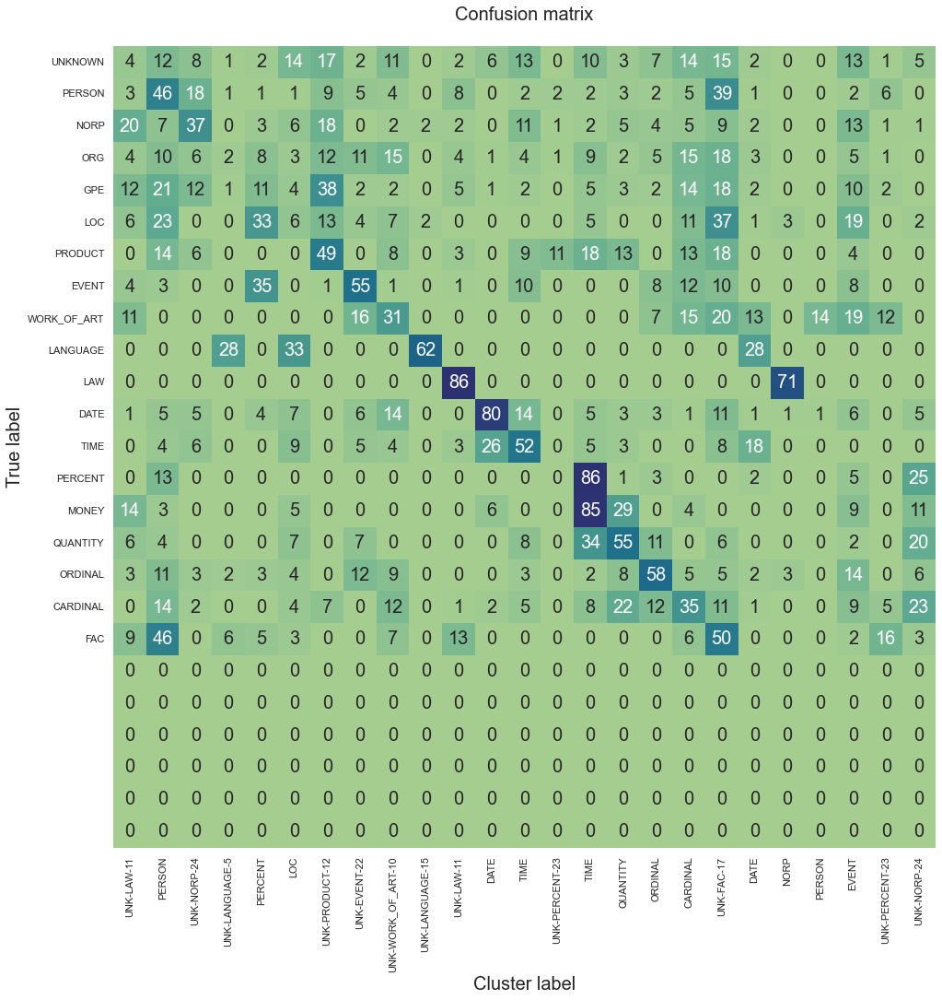

F1 score (macro) = 0.4797
Accuracy = 0.4147
Precision = 0.7939
Recall = 0.4211
New clusters =      6
... wrote results to c:\Users\Will\Projects\MSc\project\src\results\test-train_size=3000-radius=6-latent_weight=1.0-reconstr_weight=0.75-head=z-cluster=Kmeans-entity_count=15-noise_factor=0.1-\index.html
Finished 'evaluate_model' in 35.082 secs
--------------------------------------------------
59/60: test-train_size=3000-radius=6-latent_weight=1.0-reconstr_weight=0.9-head=z-cluster=Kmeans-entity_count=15-noise_factor=0.1-
--------------------------------------------------
{'train_size': 3000, 'radius': 6, 'latent_weight': 1.0, 'reconstr_weight': 0.9, 'head': 'z', 'cluster': 'Kmeans', 'entity_count': 15, 'noise_factor': 0.1}
ERROR: Invalid config key <module 'tensorflow.keras' from 'c:\\Users\\Will\\Anaconda3\\envs\\tf-27\\lib\\site-packages\\keras\\api\\_v2\\keras\\__init__.py'>
Autoencoder
Latent Model
model compiled
Epoch 191: early stopping


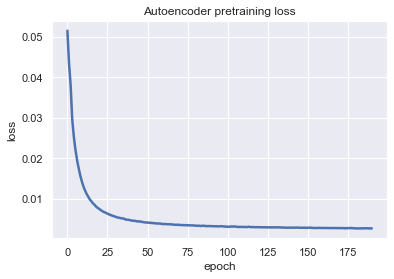

  0%|          | 0/8000 [00:00<?, ?it/s]

Iter: 7999 loss=-1.1893569231033325


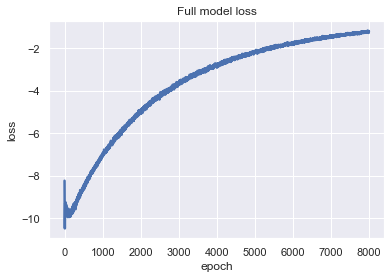

Training Done

F1 by Known Clusters: 0.1732


<Figure size 432x288 with 0 Axes>

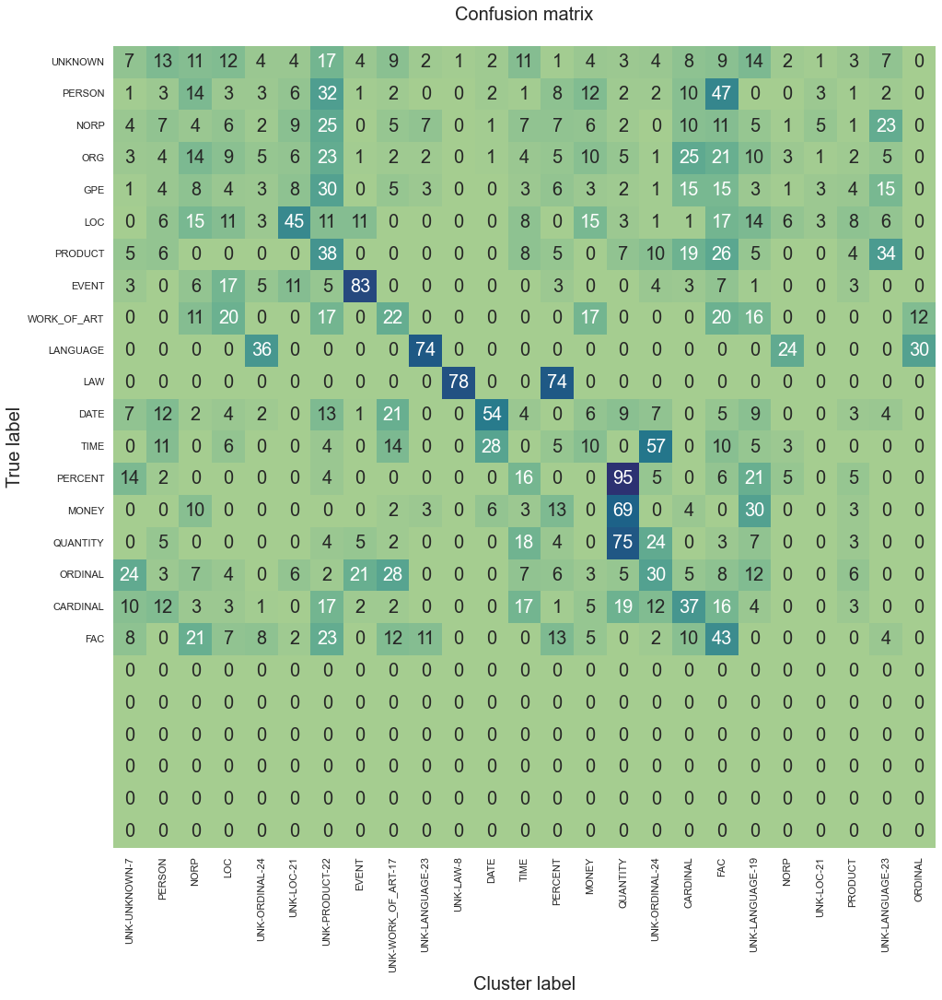

F1 score (macro) = 0.4324
Accuracy = 0.3767
Precision = 0.8461
Recall = 0.3740
New clusters =      2
... wrote results to c:\Users\Will\Projects\MSc\project\src\results\test-train_size=3000-radius=6-latent_weight=1.0-reconstr_weight=0.9-head=z-cluster=Kmeans-entity_count=15-noise_factor=0.1-\index.html
Finished 'evaluate_model' in 35.457 secs


[{'f1': 0.43730650547602323,
  'acc': 0.37333333333333335,
  'precision': 0.7934106920845421,
  'recall': 0.37419964193979244,
  'new_clusters': 1,
  'cluster F1': 0.14170528861085782,
  'run_name': 'test-train_size=3000-radius=0-latent_weight=1e-05-reconstr_weight=0.1-head=z-cluster=Kmeans-entity_count=15-noise_factor=0.1-'},
 {'f1': 0.432261611784046,
  'acc': 0.38133333333333336,
  'precision': 0.6878775887086137,
  'recall': 0.3861824971972584,
  'new_clusters': 4,
  'cluster F1': 0.2828108511719897,
  'run_name': 'test-train_size=3000-radius=0-latent_weight=1e-05-reconstr_weight=0.25-head=z-cluster=Kmeans-entity_count=15-noise_factor=0.1-'},
 {'f1': 0.45589782844549975,
  'acc': 0.4246666666666667,
  'precision': 0.794040657198552,
  'recall': 0.40814215633403317,
  'new_clusters': 5,
  'cluster F1': 0.2303709869152554,
  'run_name': 'test-train_size=3000-radius=0-latent_weight=1e-05-reconstr_weight=0.5-head=z-cluster=Kmeans-entity_count=15-noise_factor=0.1-'},
 {'f1': 0.502272801

In [ ]:
from grid_search import grid_search

scores = []
num_runs = 1
config = {
    'train_size': [3000],
    "radius": [0, 6],
    'latent_weight': [1e-5, 1e-4, 1e-3, 1e-2, 1e-1, 1.0],
    'reconstr_weight': [0.1, 0.25, 0.5, 0.75, 0.9],
    'head': ['z'],
    'cluster': ['Kmeans'],
    'entity_count': [15],
    'noise_factor': [0.1], 
}

scores = grid_search(config, do_run, sample_size=3000)

In [ ]:
scores = [{'f1': 0.43730650547602323,
  'acc': 0.37333333333333335,
  'precision': 0.7934106920845421,
  'recall': 0.37419964193979244,
  'new_clusters': 1,
  'cluster F1': 0.14170528861085782,
  'run_name': 'test-train_size=3000-radius=0-latent_weight=1e-05-reconstr_weight=0.1-head=z-cluster=Kmeans-entity_count=15-noise_factor=0.1-'},
 {'f1': 0.432261611784046,
  'acc': 0.38133333333333336,
  'precision': 0.6878775887086137,
  'recall': 0.3861824971972584,
  'new_clusters': 4,
  'cluster F1': 0.2828108511719897,
  'run_name': 'test-train_size=3000-radius=0-latent_weight=1e-05-reconstr_weight=0.25-head=z-cluster=Kmeans-entity_count=15-noise_factor=0.1-'},
 {'f1': 0.45589782844549975,
  'acc': 0.4246666666666667,
  'precision': 0.794040657198552,
  'recall': 0.40814215633403317,
  'new_clusters': 5,
  'cluster F1': 0.2303709869152554,
  'run_name': 'test-train_size=3000-radius=0-latent_weight=1e-05-reconstr_weight=0.5-head=z-cluster=Kmeans-entity_count=15-noise_factor=0.1-'},
 {'f1': 0.5022728016131466,
  'acc': 0.41933333333333334,
  'precision': 0.8990372610493023,
  'recall': 0.41608696921851807,
  'new_clusters': 4,
  'cluster F1': 0.12564242345978052,
  'run_name': 'test-train_size=3000-radius=0-latent_weight=1e-05-reconstr_weight=0.75-head=z-cluster=Kmeans-entity_count=15-noise_factor=0.1-'},
 {'f1': 0.4499187449452225,
  'acc': 0.4076666666666667,
  'precision': 0.6887318605154862,
  'recall': 0.4085278356537854,
  'new_clusters': 2,
  'cluster F1': 0.28484695556064943,
  'run_name': 'test-train_size=3000-radius=0-latent_weight=1e-05-reconstr_weight=0.9-head=z-cluster=Kmeans-entity_count=15-noise_factor=0.1-'},
 {'f1': 0.5013496058416255,
  'acc': 0.4256666666666667,
  'precision': 0.846526203866924,
  'recall': 0.4318203869372779,
  'new_clusters': 3,
  'cluster F1': 0.1649924206073258,
  'run_name': 'test-train_size=3000-radius=0-latent_weight=0.0001-reconstr_weight=0.1-head=z-cluster=Kmeans-entity_count=15-noise_factor=0.1-'},
 {'f1': 0.46403014394231307,
  'acc': 0.4086666666666667,
  'precision': 0.7939523900002715,
  'recall': 0.4029991237438047,
  'new_clusters': 3,
  'cluster F1': 0.19621000384081305,
  'run_name': 'test-train_size=3000-radius=0-latent_weight=0.0001-reconstr_weight=0.25-head=z-cluster=Kmeans-entity_count=15-noise_factor=0.1-'},
 {'f1': 0.45624342073979846,
  'acc': 0.38966666666666666,
  'precision': 0.7939451326968094,
  'recall': 0.3854932825029324,
  'new_clusters': 2,
  'cluster F1': 0.17193625133897922,
  'run_name': 'test-train_size=3000-radius=0-latent_weight=0.0001-reconstr_weight=0.5-head=z-cluster=Kmeans-entity_count=15-noise_factor=0.1-'},
 {'f1': 0.45837238595175067,
  'acc': 0.395,
  'precision': 0.7935901205527787,
  'recall': 0.4016526528230258,
  'new_clusters': 3,
  'cluster F1': 0.15890740673110526,
  'run_name': 'test-train_size=3000-radius=0-latent_weight=0.0001-reconstr_weight=0.75-head=z-cluster=Kmeans-entity_count=15-noise_factor=0.1-'},
 {'f1': 0.45394341529998633,
  'acc': 0.4063333333333333,
  'precision': 0.7411557243624525,
  'recall': 0.40096654134078885,
  'new_clusters': 3,
  'cluster F1': 0.21440059958468197,
  'run_name': 'test-train_size=3000-radius=0-latent_weight=0.0001-reconstr_weight=0.9-head=z-cluster=Kmeans-entity_count=15-noise_factor=0.1-'},
 {'f1': 0.4901790785881954,
  'acc': 0.41533333333333333,
  'precision': 0.8459699168682403,
  'recall': 0.4181373210227381,
  'new_clusters': 3,
  'cluster F1': 0.13270330344614537,
  'run_name': 'test-train_size=3000-radius=0-latent_weight=0.001-reconstr_weight=0.1-head=z-cluster=Kmeans-entity_count=15-noise_factor=0.1-'},
 {'f1': 0.4341183213477368,
  'acc': 0.3893333333333333,
  'precision': 0.6883649546188245,
  'recall': 0.38343453787872256,
  'new_clusters': 6,
  'cluster F1': 0.24173562443140562,
  'run_name': 'test-train_size=3000-radius=0-latent_weight=0.001-reconstr_weight=0.25-head=z-cluster=Kmeans-entity_count=15-noise_factor=0.1-'},
 {'f1': 0.4259548442628574,
  'acc': 0.368,
  'precision': 0.793545908567038,
  'recall': 0.36548953889604924,
  'new_clusters': 4,
  'cluster F1': 0.1747156385315326,
  'run_name': 'test-train_size=3000-radius=0-latent_weight=0.001-reconstr_weight=0.5-head=z-cluster=Kmeans-entity_count=15-noise_factor=0.1-'},
 {'f1': 0.4546150015553495,
  'acc': 0.39866666666666667,
  'precision': 0.741105182722471,
  'recall': 0.39655227852480557,
  'new_clusters': 4,
  'cluster F1': 0.20668644832412045,
  'run_name': 'test-train_size=3000-radius=0-latent_weight=0.001-reconstr_weight=0.75-head=z-cluster=Kmeans-entity_count=15-noise_factor=0.1-'},
 {'f1': 0.4292558187827633,
  'acc': 0.37333333333333335,
  'precision': 0.7410886629777377,
  'recall': 0.37446072451010476,
  'new_clusters': 3,
  'cluster F1': 0.2189749743811756,
  'run_name': 'test-train_size=3000-radius=0-latent_weight=0.001-reconstr_weight=0.9-head=z-cluster=Kmeans-entity_count=15-noise_factor=0.1-'},
 {'f1': 0.46325369446267556,
  'acc': 0.388,
  'precision': 0.7932520887658986,
  'recall': 0.39387728580297304,
  'new_clusters': 5,
  'cluster F1': 0.18205138508143326,
  'run_name': 'test-train_size=3000-radius=0-latent_weight=0.01-reconstr_weight=0.1-head=z-cluster=Kmeans-entity_count=15-noise_factor=0.1-'},
 {'f1': 0.44299014261736547,
  'acc': 0.3953333333333333,
  'precision': 0.7410344735506955,
  'recall': 0.3887907719074544,
  'new_clusters': 5,
  'cluster F1': 0.22920680417683292,
  'run_name': 'test-train_size=3000-radius=0-latent_weight=0.01-reconstr_weight=0.25-head=z-cluster=Kmeans-entity_count=15-noise_factor=0.1-'},
 {'f1': 0.44210504744328527,
  'acc': 0.397,
  'precision': 0.7411679884643114,
  'recall': 0.39192288377513834,
  'new_clusters': 6,
  'cluster F1': 0.2513235915631248,
  'run_name': 'test-train_size=3000-radius=0-latent_weight=0.01-reconstr_weight=0.5-head=z-cluster=Kmeans-entity_count=15-noise_factor=0.1-'},
 {'f1': 0.49910122637905197,
  'acc': 0.422,
  'precision': 0.8468045112781956,
  'recall': 0.42315931667021056,
  'new_clusters': 4,
  'cluster F1': 0.1922939162907344,
  'run_name': 'test-train_size=3000-radius=0-latent_weight=0.01-reconstr_weight=0.75-head=z-cluster=Kmeans-entity_count=15-noise_factor=0.1-'},
 {'f1': 0.42856560378695036,
  'acc': 0.36933333333333335,
  'precision': 0.7405885848642224,
  'recall': 0.3759541459113332,
  'new_clusters': 3,
  'cluster F1': 0.3066696357268443,
  'run_name': 'test-train_size=3000-radius=0-latent_weight=0.01-reconstr_weight=0.9-head=z-cluster=Kmeans-entity_count=15-noise_factor=0.1-'},
 {'f1': 0.44179782629856557,
  'acc': 0.4,
  'precision': 0.741359493197188,
  'recall': 0.3953363057008904,
  'new_clusters': 5,
  'cluster F1': 0.29880498832344743,
  'run_name': 'test-train_size=3000-radius=0-latent_weight=0.1-reconstr_weight=0.1-head=z-cluster=Kmeans-entity_count=15-noise_factor=0.1-'},
 {'f1': 0.44688185404842673,
  'acc': 0.38066666666666665,
  'precision': 0.84630223403978,
  'recall': 0.3800648024243837,
  'new_clusters': 6,
  'cluster F1': 0.20856830373880264,
  'run_name': 'test-train_size=3000-radius=0-latent_weight=0.1-reconstr_weight=0.25-head=z-cluster=Kmeans-entity_count=15-noise_factor=0.1-'},
 {'f1': 0.45631438742388614,
  'acc': 0.383,
  'precision': 0.8458061275740834,
  'recall': 0.3889638284729305,
  'new_clusters': 4,
  'cluster F1': 0.1998930077827291,
  'run_name': 'test-train_size=3000-radius=0-latent_weight=0.1-reconstr_weight=0.5-head=z-cluster=Kmeans-entity_count=15-noise_factor=0.1-'},
 {'f1': 0.4806391705916705,
  'acc': 0.4073333333333333,
  'precision': 0.8465002712967987,
  'recall': 0.40743763399969246,
  'new_clusters': 3,
  'cluster F1': 0.1499222866359648,
  'run_name': 'test-train_size=3000-radius=0-latent_weight=0.1-reconstr_weight=0.75-head=z-cluster=Kmeans-entity_count=15-noise_factor=0.1-'},
 {'f1': 0.450366699313075,
  'acc': 0.408,
  'precision': 0.7934970030380162,
  'recall': 0.39704054100329345,
  'new_clusters': 5,
  'cluster F1': 0.23503375664961185,
  'run_name': 'test-train_size=3000-radius=0-latent_weight=0.1-reconstr_weight=0.9-head=z-cluster=Kmeans-entity_count=15-noise_factor=0.1-'},
 {'f1': 0.4376346807131586,
  'acc': 0.39866666666666667,
  'precision': 0.6885964912280701,
  'recall': 0.38917030853011525,
  'new_clusters': 4,
  'cluster F1': 0.287191129251313,
  'run_name': 'test-train_size=3000-radius=0-latent_weight=1.0-reconstr_weight=0.1-head=z-cluster=Kmeans-entity_count=15-noise_factor=0.1-'},
 {'f1': 0.4650715634531797,
  'acc': 0.407,
  'precision': 0.7938664280484828,
  'recall': 0.39914348274672146,
  'new_clusters': 2,
  'cluster F1': 0.22481657506309377,
  'run_name': 'test-train_size=3000-radius=0-latent_weight=1.0-reconstr_weight=0.25-head=z-cluster=Kmeans-entity_count=15-noise_factor=0.1-'},
 {'f1': 0.4279873481038767,
  'acc': 0.371,
  'precision': 0.8468507333908541,
  'recall': 0.3668879144313764,
  'new_clusters': 5,
  'cluster F1': 0.1682746054817698,
  'run_name': 'test-train_size=3000-radius=0-latent_weight=1.0-reconstr_weight=0.5-head=z-cluster=Kmeans-entity_count=15-noise_factor=0.1-'},
 {'f1': 0.45606443862645396,
  'acc': 0.38366666666666666,
  'precision': 0.8460058508815855,
  'recall': 0.3835605736742857,
  'new_clusters': 4,
  'cluster F1': 0.22434684098191593,
  'run_name': 'test-train_size=3000-radius=0-latent_weight=1.0-reconstr_weight=0.75-head=z-cluster=Kmeans-entity_count=15-noise_factor=0.1-'},
 {'f1': 0.4430810411952046,
  'acc': 0.38366666666666666,
  'precision': 0.898856063388781,
  'recall': 0.3865578107253569,
  'new_clusters': 4,
  'cluster F1': 0.2462201738291996,
  'run_name': 'test-train_size=3000-radius=0-latent_weight=1.0-reconstr_weight=0.9-head=z-cluster=Kmeans-entity_count=15-noise_factor=0.1-'},
 {'f1': 0.47535604419218724,
  'acc': 0.427,
  'precision': 0.7416798732171157,
  'recall': 0.41932933360715563,
  'new_clusters': 4,
  'cluster F1': 0.23649811447003077,
  'run_name': 'test-train_size=3000-radius=6-latent_weight=1e-05-reconstr_weight=0.1-head=z-cluster=Kmeans-entity_count=15-noise_factor=0.1-'},
 {'f1': 0.42708495651580985,
  'acc': 0.385,
  'precision': 0.6883621935517776,
  'recall': 0.38755096151055163,
  'new_clusters': 2,
  'cluster F1': 0.2466782543920266,
  'run_name': 'test-train_size=3000-radius=6-latent_weight=1e-05-reconstr_weight=0.25-head=z-cluster=Kmeans-entity_count=15-noise_factor=0.1-'},
 {'f1': 0.477497449907876,
  'acc': 0.42333333333333334,
  'precision': 0.7944337282998071,
  'recall': 0.4159023285557173,
  'new_clusters': 4,
  'cluster F1': 0.23505271047610193,
  'run_name': 'test-train_size=3000-radius=6-latent_weight=1e-05-reconstr_weight=0.5-head=z-cluster=Kmeans-entity_count=15-noise_factor=0.1-'},
 {'f1': 0.47780060079026726,
  'acc': 0.4156666666666667,
  'precision': 0.8466330058723452,
  'recall': 0.410298335859453,
  'new_clusters': 4,
  'cluster F1': 0.19536963742192504,
  'run_name': 'test-train_size=3000-radius=6-latent_weight=1e-05-reconstr_weight=0.75-head=z-cluster=Kmeans-entity_count=15-noise_factor=0.1-'},
 {'f1': 0.45626941757943046,
  'acc': 0.4093333333333333,
  'precision': 0.7410504454282123,
  'recall': 0.413645332100076,
  'new_clusters': 5,
  'cluster F1': 0.3028705623498342,
  'run_name': 'test-train_size=3000-radius=6-latent_weight=1e-05-reconstr_weight=0.9-head=z-cluster=Kmeans-entity_count=15-noise_factor=0.1-'},
 {'f1': 0.4554522568916886,
  'acc': 0.4003333333333333,
  'precision': 0.8464778153334406,
  'recall': 0.3961331797997097,
  'new_clusters': 4,
  'cluster F1': 0.23113577892825155,
  'run_name': 'test-train_size=3000-radius=6-latent_weight=0.0001-reconstr_weight=0.1-head=z-cluster=Kmeans-entity_count=15-noise_factor=0.1-'},
 {'f1': 0.46689061558204553,
  'acc': 0.421,
  'precision': 0.7947122861586313,
  'recall': 0.4088599966033919,
  'new_clusters': 5,
  'cluster F1': 0.23237078690631502,
  'run_name': 'test-train_size=3000-radius=6-latent_weight=0.0001-reconstr_weight=0.25-head=z-cluster=Kmeans-entity_count=15-noise_factor=0.1-'},
 {'f1': 0.4472735678338789,
  'acc': 0.38433333333333336,
  'precision': 0.7409412197493234,
  'recall': 0.3870278783127736,
  'new_clusters': 4,
  'cluster F1': 0.2543199324457601,
  'run_name': 'test-train_size=3000-radius=6-latent_weight=0.0001-reconstr_weight=0.5-head=z-cluster=Kmeans-entity_count=15-noise_factor=0.1-'},
 {'f1': 0.42737278570300374,
  'acc': 0.37333333333333335,
  'precision': 0.7408269937380324,
  'recall': 0.3772925232497709,
  'new_clusters': 3,
  'cluster F1': 0.274963832673038,
  'run_name': 'test-train_size=3000-radius=6-latent_weight=0.0001-reconstr_weight=0.75-head=z-cluster=Kmeans-entity_count=15-noise_factor=0.1-'},
 {'f1': 0.4403594317476022,
  'acc': 0.408,
  'precision': 0.7408148168442971,
  'recall': 0.4002794322844886,
  'new_clusters': 3,
  'cluster F1': 0.3045966510810539,
  'run_name': 'test-train_size=3000-radius=6-latent_weight=0.0001-reconstr_weight=0.9-head=z-cluster=Kmeans-entity_count=15-noise_factor=0.1-'},
 {'f1': 0.4617212578058269,
  'acc': 0.3923333333333333,
  'precision': 0.8466188037797603,
  'recall': 0.39255628874927767,
  'new_clusters': 4,
  'cluster F1': 0.19318442379751136,
  'run_name': 'test-train_size=3000-radius=6-latent_weight=0.001-reconstr_weight=0.1-head=z-cluster=Kmeans-entity_count=15-noise_factor=0.1-'},
 {'f1': 0.47494219871377846,
  'acc': 0.41233333333333333,
  'precision': 0.7938528067438487,
  'recall': 0.4118815673755618,
  'new_clusters': 4,
  'cluster F1': 0.1806448354703442,
  'run_name': 'test-train_size=3000-radius=6-latent_weight=0.001-reconstr_weight=0.25-head=z-cluster=Kmeans-entity_count=15-noise_factor=0.1-'},
 {'f1': 0.4497835983142792,
  'acc': 0.39766666666666667,
  'precision': 0.7411232708104781,
  'recall': 0.3909553509557762,
  'new_clusters': 4,
  'cluster F1': 0.24087343678233972,
  'run_name': 'test-train_size=3000-radius=6-latent_weight=0.001-reconstr_weight=0.5-head=z-cluster=Kmeans-entity_count=15-noise_factor=0.1-'},
 {'f1': 0.41466208676888927,
  'acc': 0.37533333333333335,
  'precision': 0.7936138280805258,
  'recall': 0.3729535548807793,
  'new_clusters': 3,
  'cluster F1': 0.28302260681197794,
  'run_name': 'test-train_size=3000-radius=6-latent_weight=0.001-reconstr_weight=0.75-head=z-cluster=Kmeans-entity_count=15-noise_factor=0.1-'},
 {'f1': 0.46267402934003066,
  'acc': 0.4226666666666667,
  'precision': 0.7415210830864641,
  'recall': 0.4175049773085142,
  'new_clusters': 4,
  'cluster F1': 0.30164244569505355,
  'run_name': 'test-train_size=3000-radius=6-latent_weight=0.001-reconstr_weight=0.9-head=z-cluster=Kmeans-entity_count=15-noise_factor=0.1-'},
 {'f1': 0.43177696064703414,
  'acc': 0.38066666666666665,
  'precision': 0.7404809619238477,
  'recall': 0.38332794583012925,
  'new_clusters': 6,
  'cluster F1': 0.3205035679994407,
  'run_name': 'test-train_size=3000-radius=6-latent_weight=0.01-reconstr_weight=0.1-head=z-cluster=Kmeans-entity_count=15-noise_factor=0.1-'},
 {'f1': 0.45706409017428645,
  'acc': 0.415,
  'precision': 0.7419101306303865,
  'recall': 0.4020395224561144,
  'new_clusters': 6,
  'cluster F1': 0.2886318896990734,
  'run_name': 'test-train_size=3000-radius=6-latent_weight=0.01-reconstr_weight=0.25-head=z-cluster=Kmeans-entity_count=15-noise_factor=0.1-'},
 {'f1': 0.4518583735458595,
  'acc': 0.39566666666666667,
  'precision': 0.7938884604132869,
  'recall': 0.3895499110641296,
  'new_clusters': 2,
  'cluster F1': 0.1794197221086479,
  'run_name': 'test-train_size=3000-radius=6-latent_weight=0.01-reconstr_weight=0.5-head=z-cluster=Kmeans-entity_count=15-noise_factor=0.1-'},
 {'f1': 0.4115370544739927,
  'acc': 0.3913333333333333,
  'precision': 0.6886448820144645,
  'recall': 0.3747330262194725,
  'new_clusters': 2,
  'cluster F1': 0.32311496687971586,
  'run_name': 'test-train_size=3000-radius=6-latent_weight=0.01-reconstr_weight=0.75-head=z-cluster=Kmeans-entity_count=15-noise_factor=0.1-'},
 {'f1': 0.431584791009031,
  'acc': 0.37233333333333335,
  'precision': 0.7935718335996701,
  'recall': 0.3736533756805538,
  'new_clusters': 4,
  'cluster F1': 0.24671093083467674,
  'run_name': 'test-train_size=3000-radius=6-latent_weight=0.01-reconstr_weight=0.9-head=z-cluster=Kmeans-entity_count=15-noise_factor=0.1-'},
 {'f1': 0.4558779547134392,
  'acc': 0.39366666666666666,
  'precision': 0.7938021137606883,
  'recall': 0.3990492006064068,
  'new_clusters': 6,
  'cluster F1': 0.24310036190172057,
  'run_name': 'test-train_size=3000-radius=6-latent_weight=0.1-reconstr_weight=0.1-head=z-cluster=Kmeans-entity_count=15-noise_factor=0.1-'},
 {'f1': 0.44039629576736583,
  'acc': 0.39166666666666666,
  'precision': 0.740691240544225,
  'recall': 0.391718411497697,
  'new_clusters': 5,
  'cluster F1': 0.2489421976225151,
  'run_name': 'test-train_size=3000-radius=6-latent_weight=0.1-reconstr_weight=0.25-head=z-cluster=Kmeans-entity_count=15-noise_factor=0.1-'},
 {'f1': 0.460179092698165,
  'acc': 0.396,
  'precision': 0.7932735063465115,
  'recall': 0.3980739778874385,
  'new_clusters': 2,
  'cluster F1': 0.21408575417443027,
  'run_name': 'test-train_size=3000-radius=6-latent_weight=0.1-reconstr_weight=0.5-head=z-cluster=Kmeans-entity_count=15-noise_factor=0.1-'},
 {'f1': 0.4833618382407897,
  'acc': 0.404,
  'precision': 0.8992081021386629,
  'recall': 0.4060357601128996,
  'new_clusters': 3,
  'cluster F1': 0.16907894284150443,
  'run_name': 'test-train_size=3000-radius=6-latent_weight=0.1-reconstr_weight=0.75-head=z-cluster=Kmeans-entity_count=15-noise_factor=0.1-'},
 {'f1': 0.4819674863132536,
  'acc': 0.418,
  'precision': 0.7941184554074482,
  'recall': 0.4187019199122403,
  'new_clusters': 5,
  'cluster F1': 0.21516964516957046,
  'run_name': 'test-train_size=3000-radius=6-latent_weight=0.1-reconstr_weight=0.9-head=z-cluster=Kmeans-entity_count=15-noise_factor=0.1-'},
 {'f1': 0.45793903617265713,
  'acc': 0.3913333333333333,
  'precision': 0.8465396188565698,
  'recall': 0.3891451244579757,
  'new_clusters': 3,
  'cluster F1': 0.20517502254690834,
  'run_name': 'test-train_size=3000-radius=6-latent_weight=1.0-reconstr_weight=0.1-head=z-cluster=Kmeans-entity_count=15-noise_factor=0.1-'},
 {'f1': 0.4784614415430158,
  'acc': 0.42,
  'precision': 0.7941832603486739,
  'recall': 0.4102038079468194,
  'new_clusters': 6,
  'cluster F1': 0.17218102191116075,
  'run_name': 'test-train_size=3000-radius=6-latent_weight=1.0-reconstr_weight=0.25-head=z-cluster=Kmeans-entity_count=15-noise_factor=0.1-'},
 {'f1': 0.4641860965157755,
  'acc': 0.3913333333333333,
  'precision': 0.7932216094661882,
  'recall': 0.40219539188928105,
  'new_clusters': 2,
  'cluster F1': 0.21437862952418563,
  'run_name': 'test-train_size=3000-radius=6-latent_weight=1.0-reconstr_weight=0.5-head=z-cluster=Kmeans-entity_count=15-noise_factor=0.1-'},
 {'f1': 0.47974237079234155,
  'acc': 0.4146666666666667,
  'precision': 0.7939191043301685,
  'recall': 0.4210966514120152,
  'new_clusters': 6,
  'cluster F1': 0.2556329805212054,
  'run_name': 'test-train_size=3000-radius=6-latent_weight=1.0-reconstr_weight=0.75-head=z-cluster=Kmeans-entity_count=15-noise_factor=0.1-'},
 {'f1': 0.4323530617640801,
  'acc': 0.37666666666666665,
  'precision': 0.8460858027421495,
  'recall': 0.3740184044256973,
  'new_clusters': 2,
  'cluster F1': 0.1731584248664277,
  'run_name': 'test-train_size=3000-radius=6-latent_weight=1.0-reconstr_weight=0.9-head=z-cluster=Kmeans-entity_count=15-noise_factor=0.1-'}]
summarise_scores(scores)

Run Name                                 Runs       F1 avg       F1 Cluster   F1 Global    Precision    Recall      
test-train_size=3000-radius=0-latent_weight=1e-05-reconstr_weight=0.1-head=z-cluster=Kmeans-entity_count=15-noise_factor=0.1- 1           0.2895       0.1417       0.4373      0.7934       0.3742      
test-train_size=3000-radius=0-latent_weight=1e-05-reconstr_weight=0.25-head=z-cluster=Kmeans-entity_count=15-noise_factor=0.1- 1           0.3575       0.2828       0.4323      0.6879       0.3862      
test-train_size=3000-radius=0-latent_weight=1e-05-reconstr_weight=0.5-head=z-cluster=Kmeans-entity_count=15-noise_factor=0.1- 1           0.3431       0.2304       0.4559      0.7940       0.4081      
test-train_size=3000-radius=0-latent_weight=1e-05-reconstr_weight=0.75-head=z-cluster=Kmeans-entity_count=15-noise_factor=0.1- 1           0.3140       0.1256       0.5023      0.8990       0.4161      
test-train_size=3000-radius=0-latent_weight=1e-05-reconstr_weight=0.9-hea

--------------------------------------------------
0/12: test-train_size=0-radius=0-latent_weight=0.0005-reconstr_weight=0.1-head=z-cluster=Kmeans-entity_count=15-noise_factor=0.1-
--------------------------------------------------
{'train_size': 0, 'radius': 0, 'latent_weight': 0.0005, 'reconstr_weight': 0.1, 'head': 'z', 'cluster': 'Kmeans', 'entity_count': 15, 'noise_factor': 0.1}
ERROR: Invalid config key <module 'tensorflow.keras' from 'c:\\Users\\Will\\Anaconda3\\envs\\tf-27\\lib\\site-packages\\keras\\api\\_v2\\keras\\__init__.py'>
Autoencoder
Latent Model
model compiled
Creating data


  0%|          | 0/3 [00:00<?, ?it/s]

Reading lines


100%|██████████| 14041/14041 [00:00<00:00, 146259.03it/s]


pre-embedding all
Finished 'get_pipe' in 0.0 secs


100%|██████████| 14041/14041 [30:08<00:00,  7.76it/s]


Emedded 14041 sentences
Saved to ./data\conll_n0_train
Embedding sentences radius 0


14041it [00:54, 259.19it/s]


Finished 'get_training_data_spacy' in 1869.055 secs
SAVED ./data/conll_spacy_n0_r0.pkl
Epoch 230: early stopping


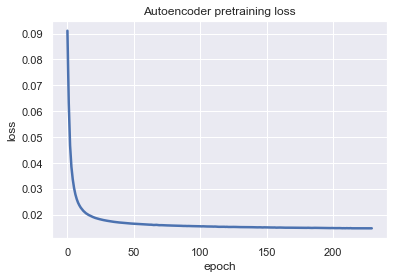

  0%|          | 0/8000 [00:00<?, ?it/s]

Stop traing for tolerance threshold reached
Iter: 682 loss=-0.002046347362920642


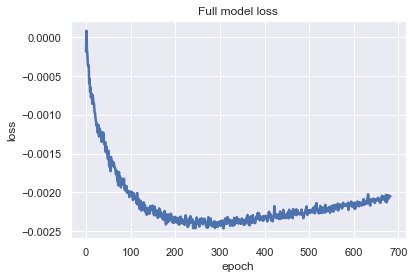

Training Done

F1 by Known Clusters: 0.1951


<Figure size 432x288 with 0 Axes>

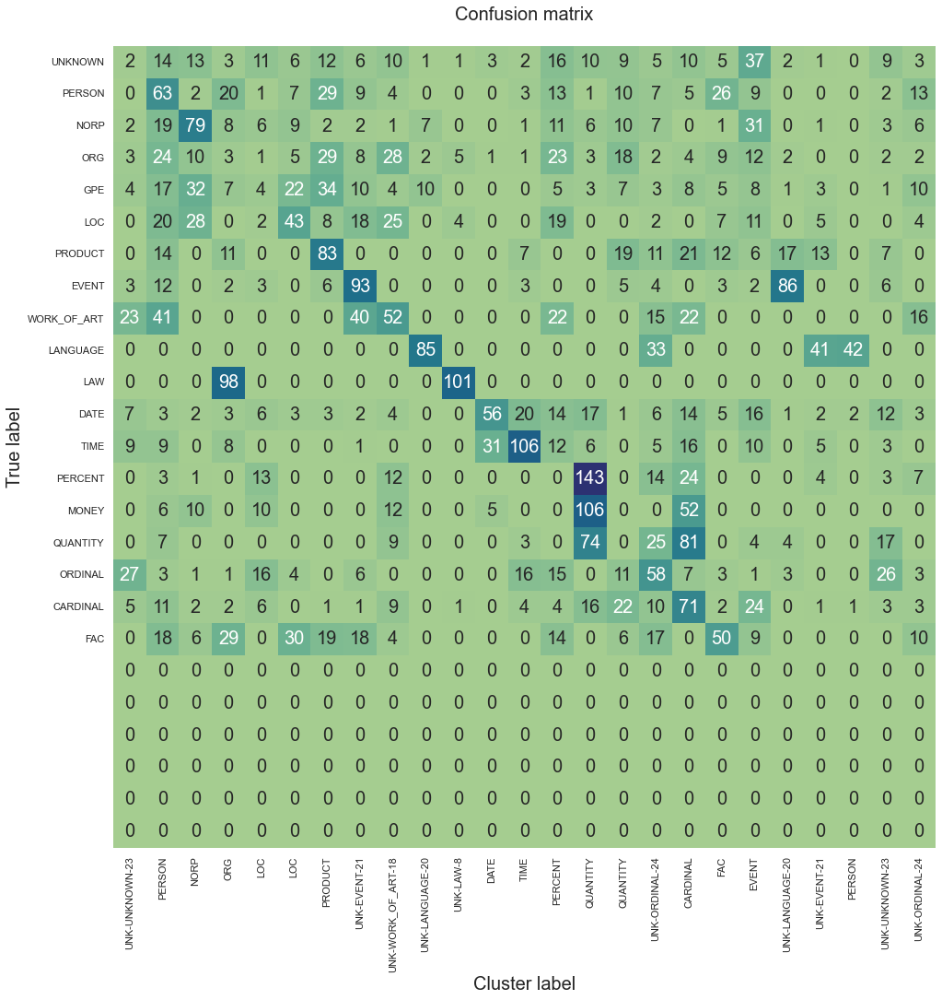

F1 score (macro) = 0.4846
Accuracy = 0.4203
Precision = 0.8461
Recall = 0.4209
New clusters =      5
... wrote results to c:\Users\Will\Projects\MSc\project\src\results\test-train_size=0-radius=0-latent_weight=0.0005-reconstr_weight=0.1-head=z-cluster=Kmeans-entity_count=15-noise_factor=0.1-\index.html
Finished 'evaluate_model' in 39.701 secs
--------------------------------------------------
1/12: test-train_size=0-radius=0-latent_weight=0.0005-reconstr_weight=0.2-head=z-cluster=Kmeans-entity_count=15-noise_factor=0.1-
--------------------------------------------------
{'train_size': 0, 'radius': 0, 'latent_weight': 0.0005, 'reconstr_weight': 0.2, 'head': 'z', 'cluster': 'Kmeans', 'entity_count': 15, 'noise_factor': 0.1}
ERROR: Invalid config key <module 'tensorflow.keras' from 'c:\\Users\\Will\\Anaconda3\\envs\\tf-27\\lib\\site-packages\\keras\\api\\_v2\\keras\\__init__.py'>
Autoencoder
Latent Model
model compiled
Epoch 270: early stopping


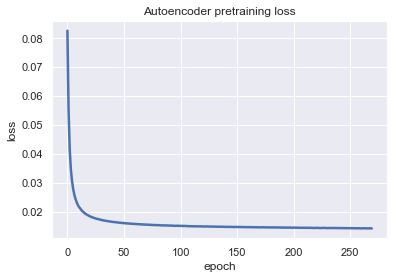

  0%|          | 0/8000 [00:00<?, ?it/s]

Stop traing for tolerance threshold reached
Iter: 553 loss=-0.0005689591635018587


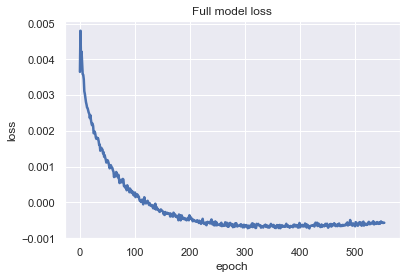

Training Done

F1 by Known Clusters: 0.2365


<Figure size 432x288 with 0 Axes>

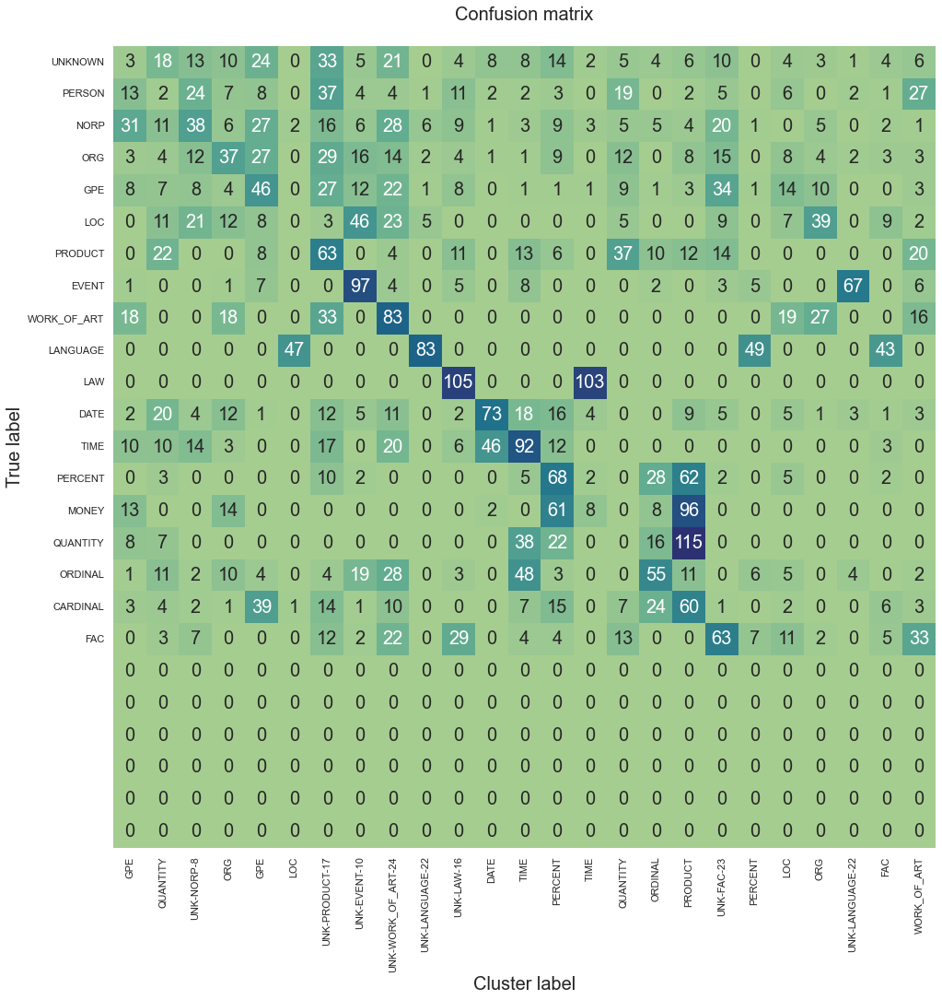

F1 score (macro) = 0.4823
Accuracy = 0.4285
Precision = 0.7938
Recall = 0.4239
New clusters =      4
... wrote results to c:\Users\Will\Projects\MSc\project\src\results\test-train_size=0-radius=0-latent_weight=0.0005-reconstr_weight=0.2-head=z-cluster=Kmeans-entity_count=15-noise_factor=0.1-\index.html
Finished 'evaluate_model' in 39.729 secs
--------------------------------------------------
2/12: test-train_size=0-radius=0-latent_weight=0.001-reconstr_weight=0.1-head=z-cluster=Kmeans-entity_count=15-noise_factor=0.1-
--------------------------------------------------
{'train_size': 0, 'radius': 0, 'latent_weight': 0.001, 'reconstr_weight': 0.1, 'head': 'z', 'cluster': 'Kmeans', 'entity_count': 15, 'noise_factor': 0.1}
ERROR: Invalid config key <module 'tensorflow.keras' from 'c:\\Users\\Will\\Anaconda3\\envs\\tf-27\\lib\\site-packages\\keras\\api\\_v2\\keras\\__init__.py'>
Autoencoder
Latent Model
model compiled
Epoch 209: early stopping


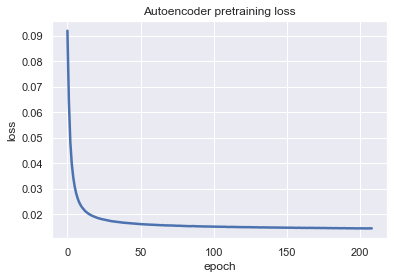

  0%|          | 0/8000 [00:00<?, ?it/s]

Stop traing for tolerance threshold reached
Iter: 1675 loss=-0.0036337771452963352


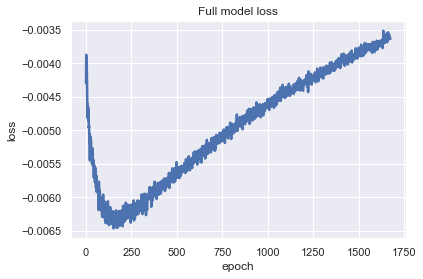

Training Done

F1 by Known Clusters: 0.2160


<Figure size 432x288 with 0 Axes>

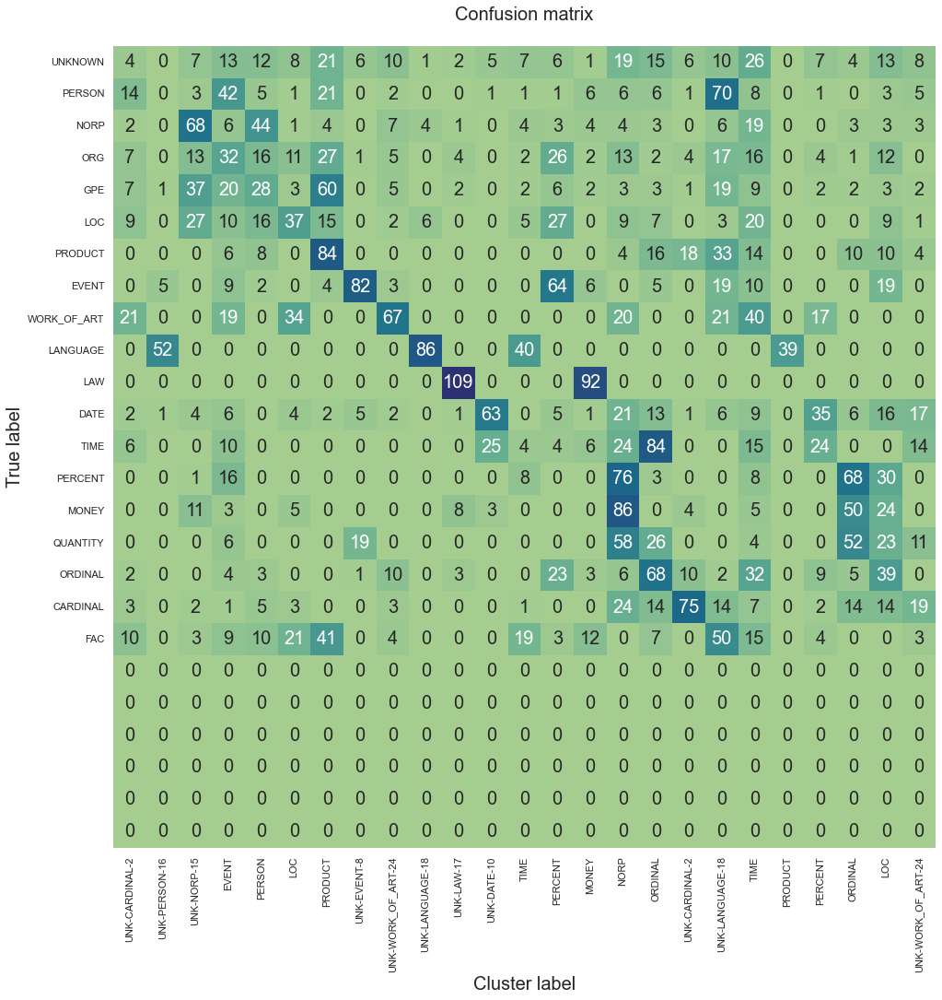

F1 score (macro) = 0.4840
Accuracy = 0.4293
Precision = 0.7413
Recall = 0.4295
New clusters =      5
... wrote results to c:\Users\Will\Projects\MSc\project\src\results\test-train_size=0-radius=0-latent_weight=0.001-reconstr_weight=0.1-head=z-cluster=Kmeans-entity_count=15-noise_factor=0.1-\index.html
Finished 'evaluate_model' in 41.72 secs
--------------------------------------------------
3/12: test-train_size=0-radius=0-latent_weight=0.001-reconstr_weight=0.2-head=z-cluster=Kmeans-entity_count=15-noise_factor=0.1-
--------------------------------------------------
{'train_size': 0, 'radius': 0, 'latent_weight': 0.001, 'reconstr_weight': 0.2, 'head': 'z', 'cluster': 'Kmeans', 'entity_count': 15, 'noise_factor': 0.1}
ERROR: Invalid config key <module 'tensorflow.keras' from 'c:\\Users\\Will\\Anaconda3\\envs\\tf-27\\lib\\site-packages\\keras\\api\\_v2\\keras\\__init__.py'>
Autoencoder
Latent Model
model compiled
Epoch 209: early stopping


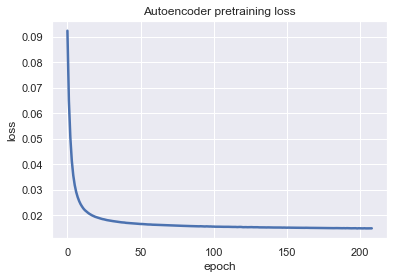

  0%|          | 0/8000 [00:00<?, ?it/s]

Stop traing for tolerance threshold reached
Iter: 1395 loss=-0.00268005789257586


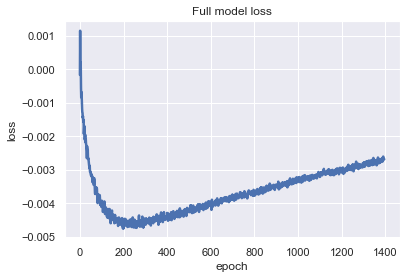

Training Done

F1 by Known Clusters: 0.2662


<Figure size 432x288 with 0 Axes>

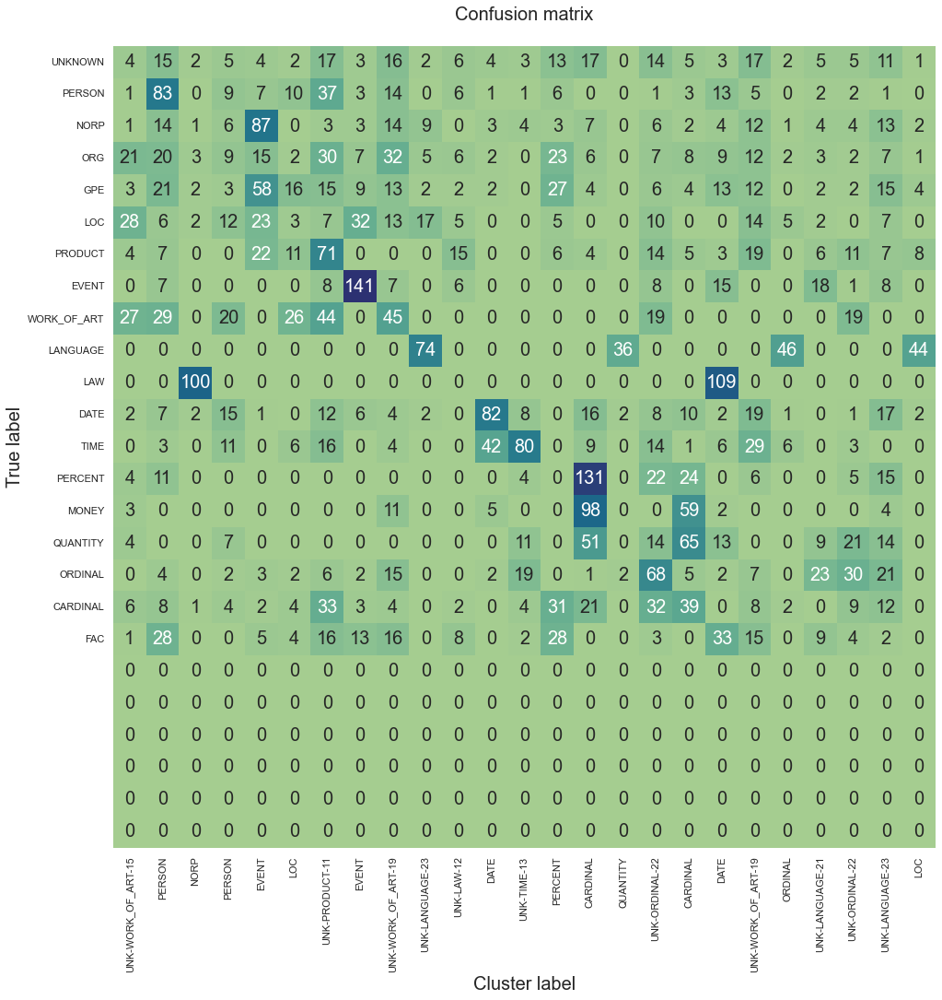

F1 score (macro) = 0.4703
Accuracy = 0.4153
Precision = 0.7405
Recall = 0.4198
New clusters =      4
... wrote results to c:\Users\Will\Projects\MSc\project\src\results\test-train_size=0-radius=0-latent_weight=0.001-reconstr_weight=0.2-head=z-cluster=Kmeans-entity_count=15-noise_factor=0.1-\index.html
Finished 'evaluate_model' in 44.481 secs
--------------------------------------------------
4/12: test-train_size=0-radius=0-latent_weight=0.002-reconstr_weight=0.1-head=z-cluster=Kmeans-entity_count=15-noise_factor=0.1-
--------------------------------------------------
{'train_size': 0, 'radius': 0, 'latent_weight': 0.002, 'reconstr_weight': 0.1, 'head': 'z', 'cluster': 'Kmeans', 'entity_count': 15, 'noise_factor': 0.1}
ERROR: Invalid config key <module 'tensorflow.keras' from 'c:\\Users\\Will\\Anaconda3\\envs\\tf-27\\lib\\site-packages\\keras\\api\\_v2\\keras\\__init__.py'>
Autoencoder
Latent Model
model compiled
Epoch 255: early stopping


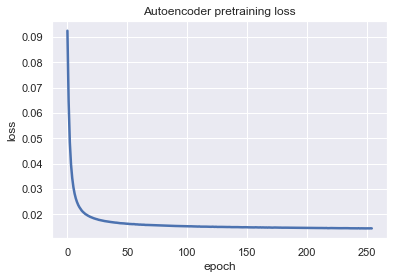

  0%|          | 0/8000 [00:00<?, ?it/s]

Stop traing for tolerance threshold reached
Iter: 5782 loss=-0.0021155409049242735


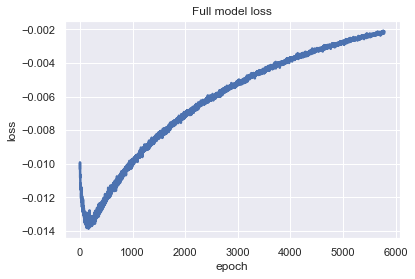

Training Done

F1 by Known Clusters: 0.1619


<Figure size 432x288 with 0 Axes>

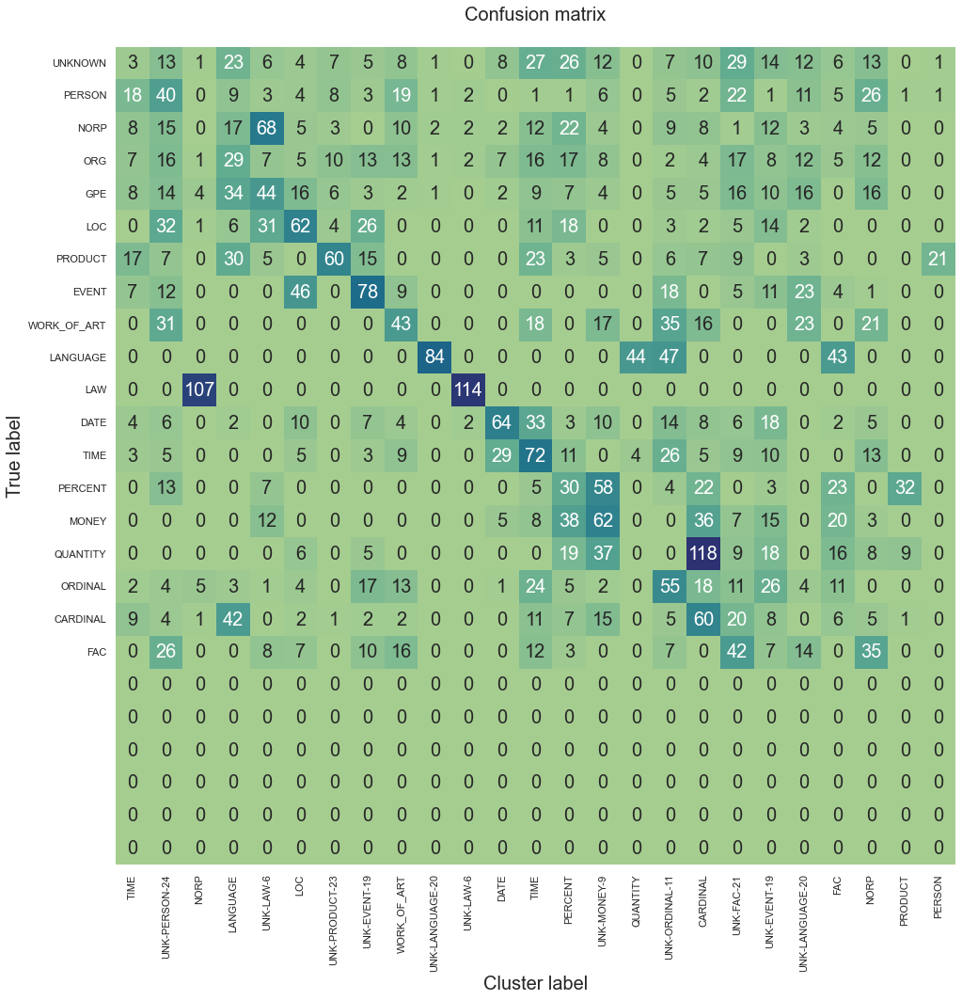

F1 score (macro) = 0.4777
Accuracy = 0.4068
Precision = 0.8469
Recall = 0.3992
New clusters =      4
... wrote results to c:\Users\Will\Projects\MSc\project\src\results\test-train_size=0-radius=0-latent_weight=0.002-reconstr_weight=0.1-head=z-cluster=Kmeans-entity_count=15-noise_factor=0.1-\index.html
Finished 'evaluate_model' in 40.707 secs
--------------------------------------------------
5/12: test-train_size=0-radius=0-latent_weight=0.002-reconstr_weight=0.2-head=z-cluster=Kmeans-entity_count=15-noise_factor=0.1-
--------------------------------------------------
{'train_size': 0, 'radius': 0, 'latent_weight': 0.002, 'reconstr_weight': 0.2, 'head': 'z', 'cluster': 'Kmeans', 'entity_count': 15, 'noise_factor': 0.1}
ERROR: Invalid config key <module 'tensorflow.keras' from 'c:\\Users\\Will\\Anaconda3\\envs\\tf-27\\lib\\site-packages\\keras\\api\\_v2\\keras\\__init__.py'>
Autoencoder
Latent Model
model compiled
Epoch 268: early stopping


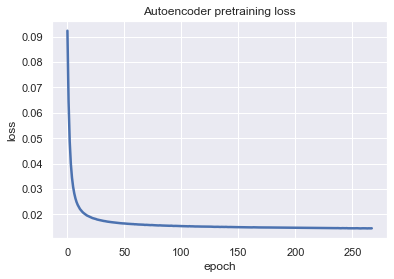

  0%|          | 0/8000 [00:00<?, ?it/s]

Stop traing for tolerance threshold reached
Iter: 4009 loss=-0.002389373490586877


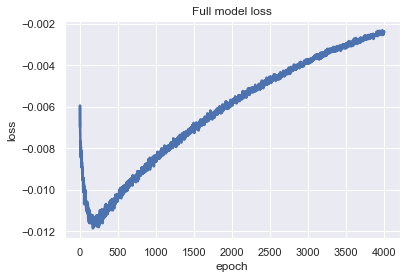

Training Done

F1 by Known Clusters: 0.2004


<Figure size 432x288 with 0 Axes>

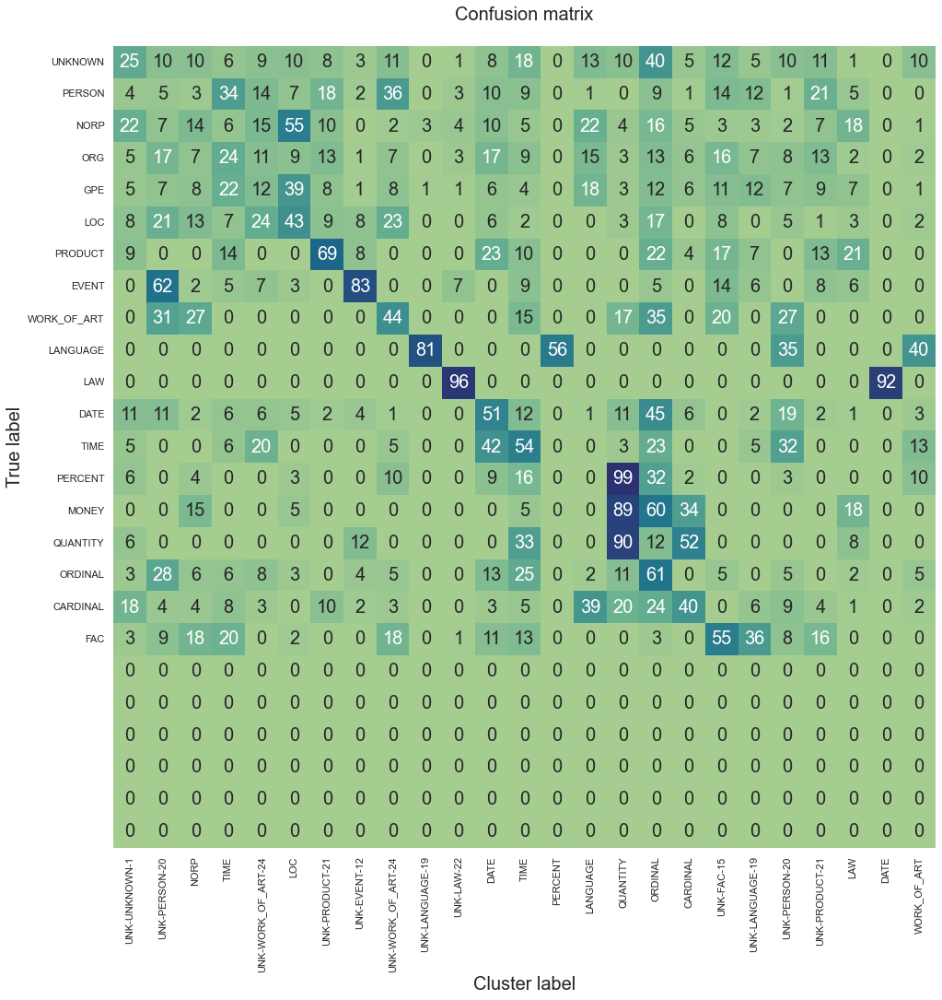

F1 score (macro) = 0.4388
Accuracy = 0.3807
Precision = 0.7941
Recall = 0.3806
New clusters =      3
... wrote results to c:\Users\Will\Projects\MSc\project\src\results\test-train_size=0-radius=0-latent_weight=0.002-reconstr_weight=0.2-head=z-cluster=Kmeans-entity_count=15-noise_factor=0.1-\index.html
Finished 'evaluate_model' in 42.258 secs
--------------------------------------------------
6/12: test-train_size=0-radius=6-latent_weight=0.0005-reconstr_weight=0.1-head=z-cluster=Kmeans-entity_count=15-noise_factor=0.1-
--------------------------------------------------
{'train_size': 0, 'radius': 6, 'latent_weight': 0.0005, 'reconstr_weight': 0.1, 'head': 'z', 'cluster': 'Kmeans', 'entity_count': 15, 'noise_factor': 0.1}
ERROR: Invalid config key <module 'tensorflow.keras' from 'c:\\Users\\Will\\Anaconda3\\envs\\tf-27\\lib\\site-packages\\keras\\api\\_v2\\keras\\__init__.py'>
Autoencoder
Latent Model
model compiled
Creating data


  0%|          | 0/3 [00:00<?, ?it/s]

Reading lines


100%|██████████| 14041/14041 [00:00<00:00, 78442.43it/s]


Loading ./data\conll_n0_train
Embedding sentences radius 6


14041it [00:58, 241.90it/s]


Finished 'get_training_data_spacy' in 64.842 secs
SAVED ./data/conll_spacy_n0_r6.pkl
Epoch 171: early stopping


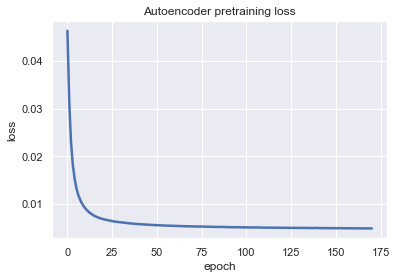

  0%|          | 0/8000 [00:00<?, ?it/s]

Stop traing for tolerance threshold reached
Iter: 587 loss=-0.0010843222262337804


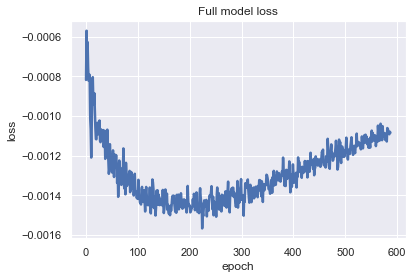

Training Done

F1 by Known Clusters: 0.2484


<Figure size 432x288 with 0 Axes>

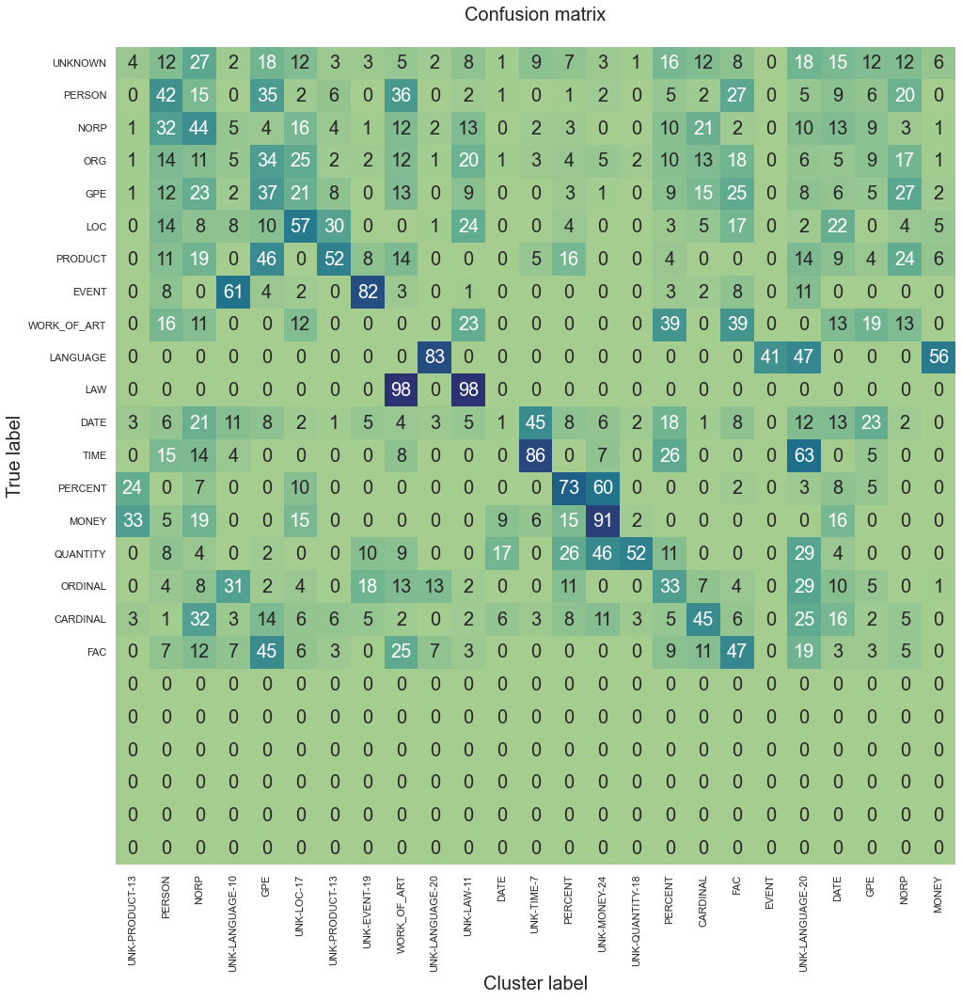

F1 score (macro) = 0.4609
Accuracy = 0.3985
Precision = 0.8464
Recall = 0.3989
New clusters =      5
... wrote results to c:\Users\Will\Projects\MSc\project\src\results\test-train_size=0-radius=6-latent_weight=0.0005-reconstr_weight=0.1-head=z-cluster=Kmeans-entity_count=15-noise_factor=0.1-\index.html
Finished 'evaluate_model' in 40.469 secs
--------------------------------------------------
7/12: test-train_size=0-radius=6-latent_weight=0.0005-reconstr_weight=0.2-head=z-cluster=Kmeans-entity_count=15-noise_factor=0.1-
--------------------------------------------------
{'train_size': 0, 'radius': 6, 'latent_weight': 0.0005, 'reconstr_weight': 0.2, 'head': 'z', 'cluster': 'Kmeans', 'entity_count': 15, 'noise_factor': 0.1}
ERROR: Invalid config key <module 'tensorflow.keras' from 'c:\\Users\\Will\\Anaconda3\\envs\\tf-27\\lib\\site-packages\\keras\\api\\_v2\\keras\\__init__.py'>
Autoencoder
Latent Model
model compiled
Epoch 168: early stopping


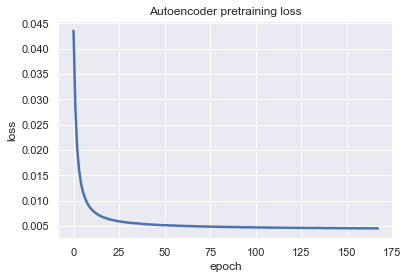

  0%|          | 0/8000 [00:00<?, ?it/s]

Stop traing for tolerance threshold reached
Iter: 80 loss=0.00016747601330280304


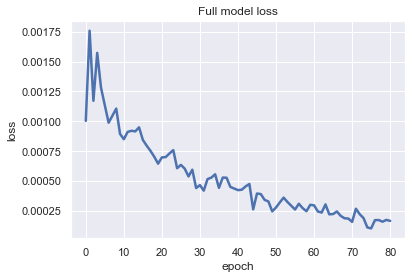

Training Done

F1 by Known Clusters: 0.2324


<Figure size 432x288 with 0 Axes>

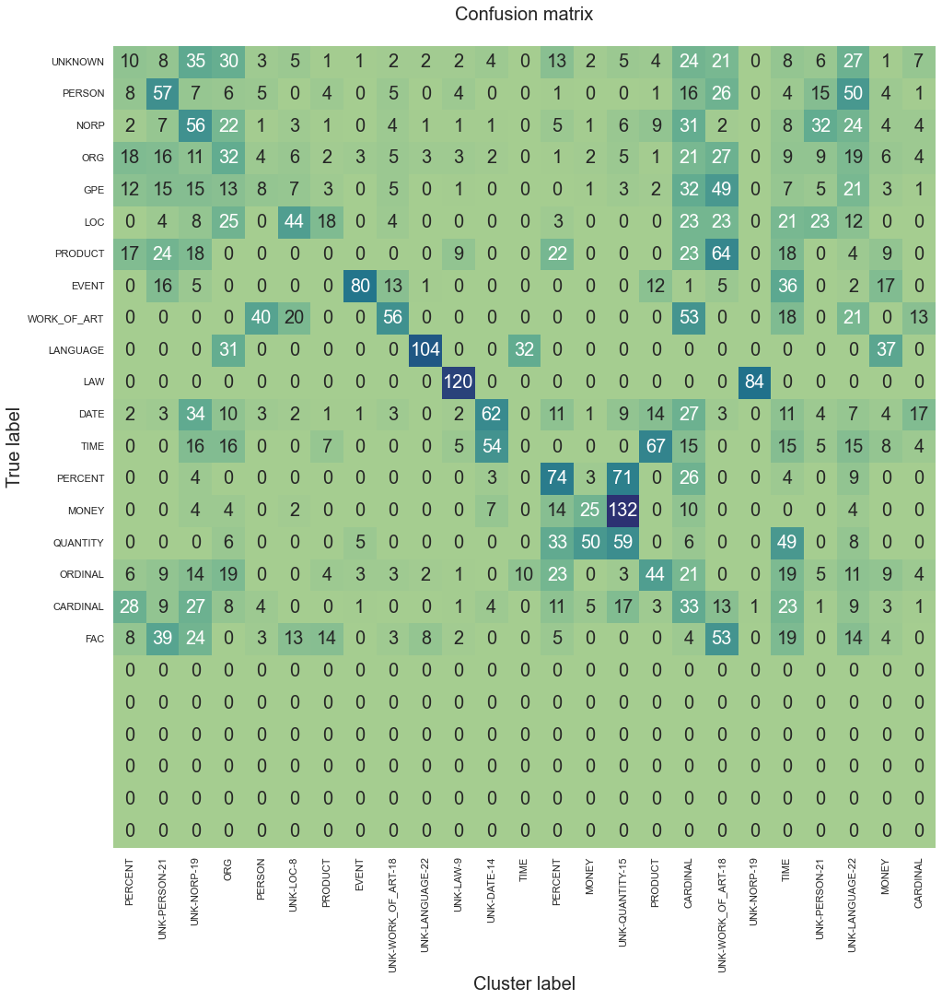

F1 score (macro) = 0.4781
Accuracy = 0.4148
Precision = 0.7940
Recall = 0.4140
New clusters =      6
... wrote results to c:\Users\Will\Projects\MSc\project\src\results\test-train_size=0-radius=6-latent_weight=0.0005-reconstr_weight=0.2-head=z-cluster=Kmeans-entity_count=15-noise_factor=0.1-\index.html
Finished 'evaluate_model' in 39.336 secs
--------------------------------------------------
8/12: test-train_size=0-radius=6-latent_weight=0.001-reconstr_weight=0.1-head=z-cluster=Kmeans-entity_count=15-noise_factor=0.1-
--------------------------------------------------
{'train_size': 0, 'radius': 6, 'latent_weight': 0.001, 'reconstr_weight': 0.1, 'head': 'z', 'cluster': 'Kmeans', 'entity_count': 15, 'noise_factor': 0.1}
ERROR: Invalid config key <module 'tensorflow.keras' from 'c:\\Users\\Will\\Anaconda3\\envs\\tf-27\\lib\\site-packages\\keras\\api\\_v2\\keras\\__init__.py'>
Autoencoder
Latent Model
model compiled
Epoch 133: early stopping


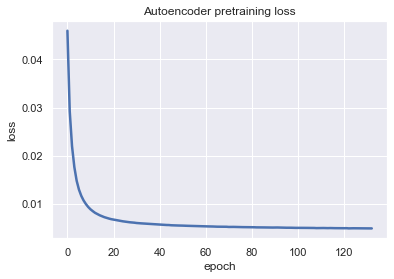

  0%|          | 0/8000 [00:00<?, ?it/s]

Stop traing for tolerance threshold reached
Iter: 1685 loss=-0.0020756819285452366


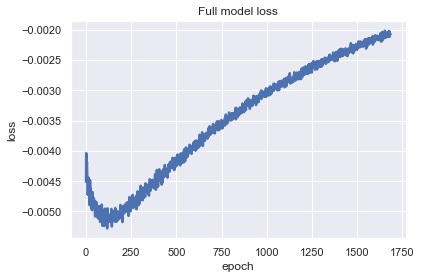

Training Done

F1 by Known Clusters: 0.2818


<Figure size 432x288 with 0 Axes>

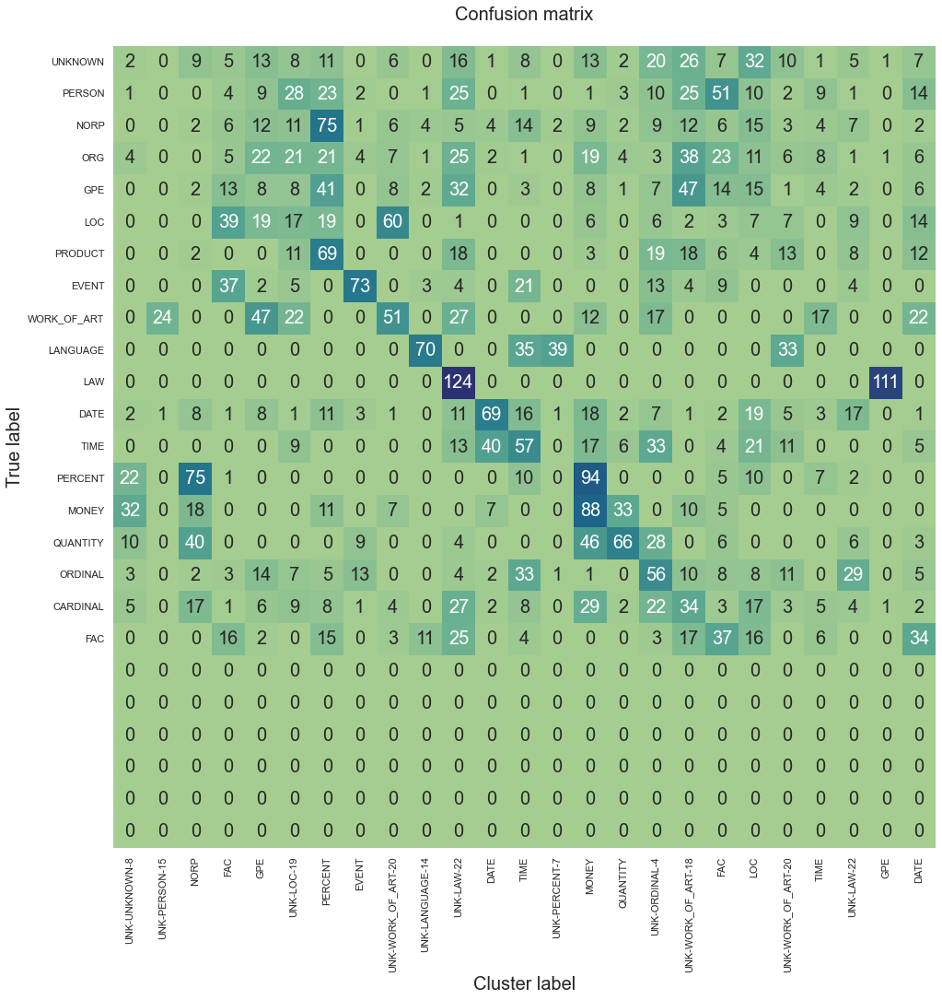

F1 score (macro) = 0.4514
Accuracy = 0.3882
Precision = 0.7935
Recall = 0.3874
New clusters =      5
... wrote results to c:\Users\Will\Projects\MSc\project\src\results\test-train_size=0-radius=6-latent_weight=0.001-reconstr_weight=0.1-head=z-cluster=Kmeans-entity_count=15-noise_factor=0.1-\index.html
Finished 'evaluate_model' in 43.206 secs
--------------------------------------------------
9/12: test-train_size=0-radius=6-latent_weight=0.001-reconstr_weight=0.2-head=z-cluster=Kmeans-entity_count=15-noise_factor=0.1-
--------------------------------------------------
{'train_size': 0, 'radius': 6, 'latent_weight': 0.001, 'reconstr_weight': 0.2, 'head': 'z', 'cluster': 'Kmeans', 'entity_count': 15, 'noise_factor': 0.1}
ERROR: Invalid config key <module 'tensorflow.keras' from 'c:\\Users\\Will\\Anaconda3\\envs\\tf-27\\lib\\site-packages\\keras\\api\\_v2\\keras\\__init__.py'>
Autoencoder
Latent Model
model compiled
Epoch 176: early stopping


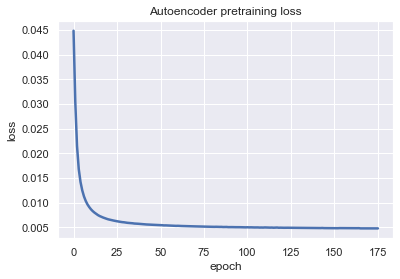

  0%|          | 0/8000 [00:00<?, ?it/s]

Stop traing for tolerance threshold reached
Iter: 1162 loss=-0.0005361007060855627


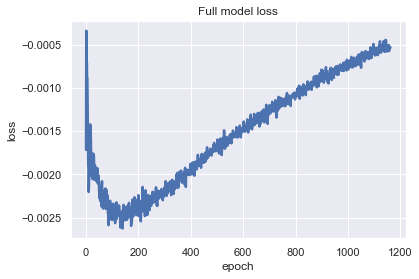

Training Done

F1 by Known Clusters: 0.1935


<Figure size 432x288 with 0 Axes>

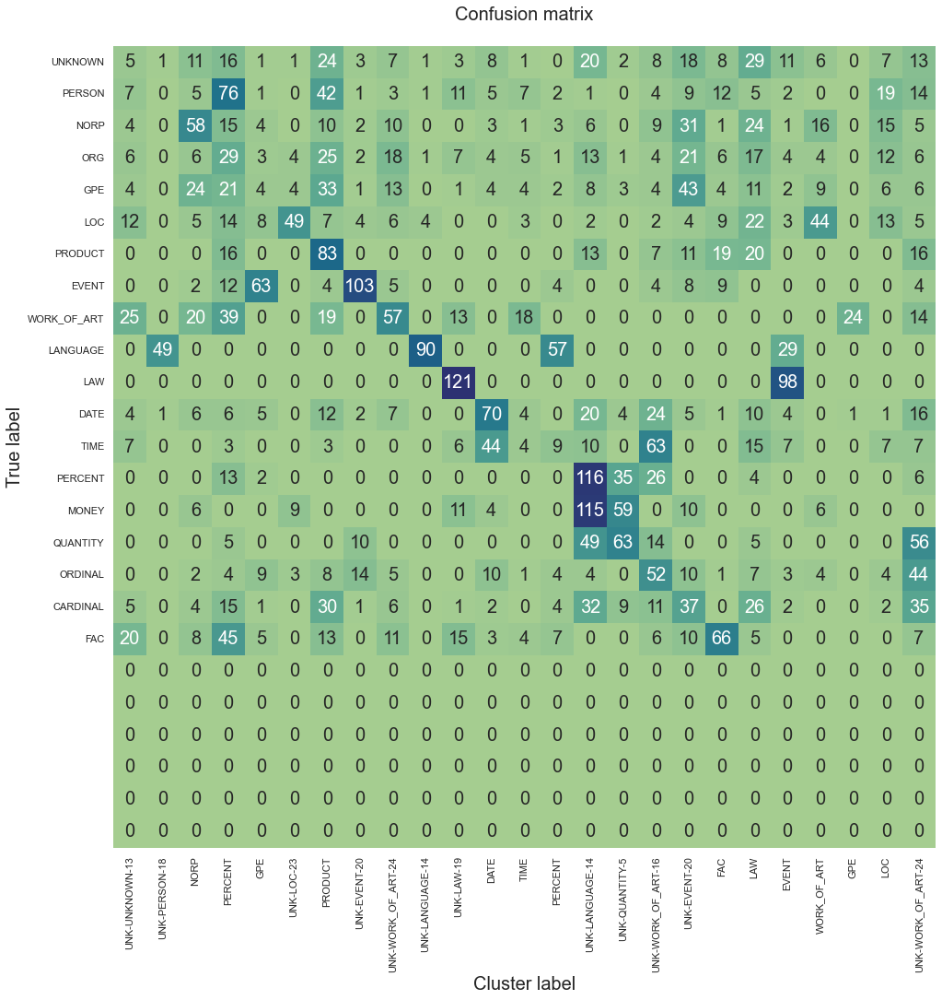

F1 score (macro) = 0.4824
Accuracy = 0.4288
Precision = 0.7412
Recall = 0.4255
New clusters =      3
... wrote results to c:\Users\Will\Projects\MSc\project\src\results\test-train_size=0-radius=6-latent_weight=0.001-reconstr_weight=0.2-head=z-cluster=Kmeans-entity_count=15-noise_factor=0.1-\index.html
Finished 'evaluate_model' in 37.521 secs
--------------------------------------------------
10/12: test-train_size=0-radius=6-latent_weight=0.002-reconstr_weight=0.1-head=z-cluster=Kmeans-entity_count=15-noise_factor=0.1-
--------------------------------------------------
{'train_size': 0, 'radius': 6, 'latent_weight': 0.002, 'reconstr_weight': 0.1, 'head': 'z', 'cluster': 'Kmeans', 'entity_count': 15, 'noise_factor': 0.1}
ERROR: Invalid config key <module 'tensorflow.keras' from 'c:\\Users\\Will\\Anaconda3\\envs\\tf-27\\lib\\site-packages\\keras\\api\\_v2\\keras\\__init__.py'>
Autoencoder
Latent Model
model compiled
Epoch 170: early stopping


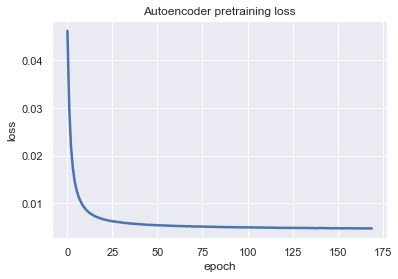

  0%|          | 0/8000 [00:00<?, ?it/s]

Stop traing for tolerance threshold reached
Iter: 3036 loss=-0.0025051406119018793


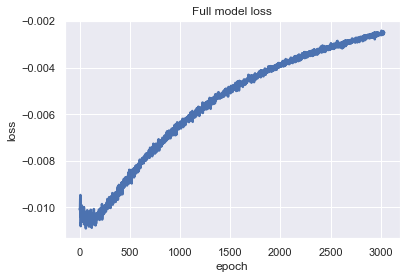

Training Done

F1 by Known Clusters: 0.2326


<Figure size 432x288 with 0 Axes>

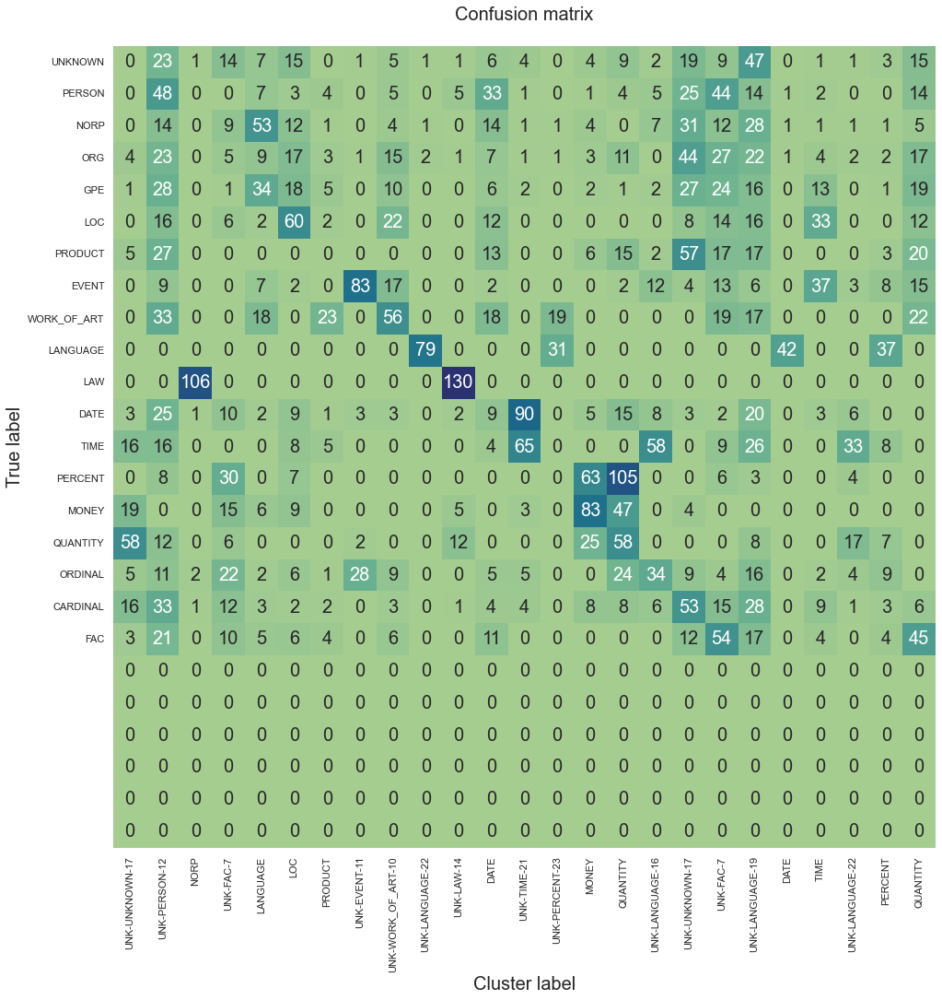

F1 score (macro) = 0.4646
Accuracy = 0.4047
Precision = 0.7407
Recall = 0.4066
New clusters =      3
... wrote results to c:\Users\Will\Projects\MSc\project\src\results\test-train_size=0-radius=6-latent_weight=0.002-reconstr_weight=0.1-head=z-cluster=Kmeans-entity_count=15-noise_factor=0.1-\index.html
Finished 'evaluate_model' in 39.408 secs
--------------------------------------------------
11/12: test-train_size=0-radius=6-latent_weight=0.002-reconstr_weight=0.2-head=z-cluster=Kmeans-entity_count=15-noise_factor=0.1-
--------------------------------------------------
{'train_size': 0, 'radius': 6, 'latent_weight': 0.002, 'reconstr_weight': 0.2, 'head': 'z', 'cluster': 'Kmeans', 'entity_count': 15, 'noise_factor': 0.1}
ERROR: Invalid config key <module 'tensorflow.keras' from 'c:\\Users\\Will\\Anaconda3\\envs\\tf-27\\lib\\site-packages\\keras\\api\\_v2\\keras\\__init__.py'>
Autoencoder
Latent Model
model compiled
Epoch 179: early stopping


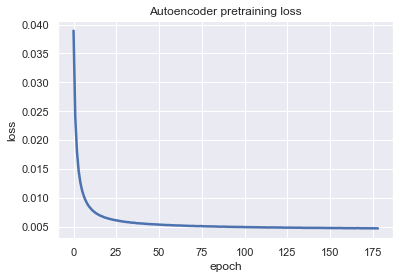

  0%|          | 0/8000 [00:00<?, ?it/s]

Stop traing for tolerance threshold reached
Iter: 3263 loss=-3.888062201440334e-05


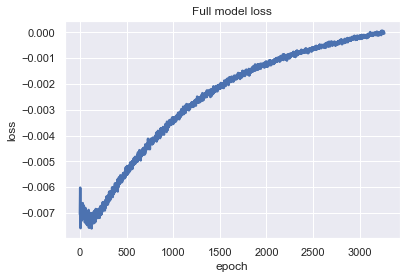

Training Done

F1 by Known Clusters: 0.2433


<Figure size 432x288 with 0 Axes>

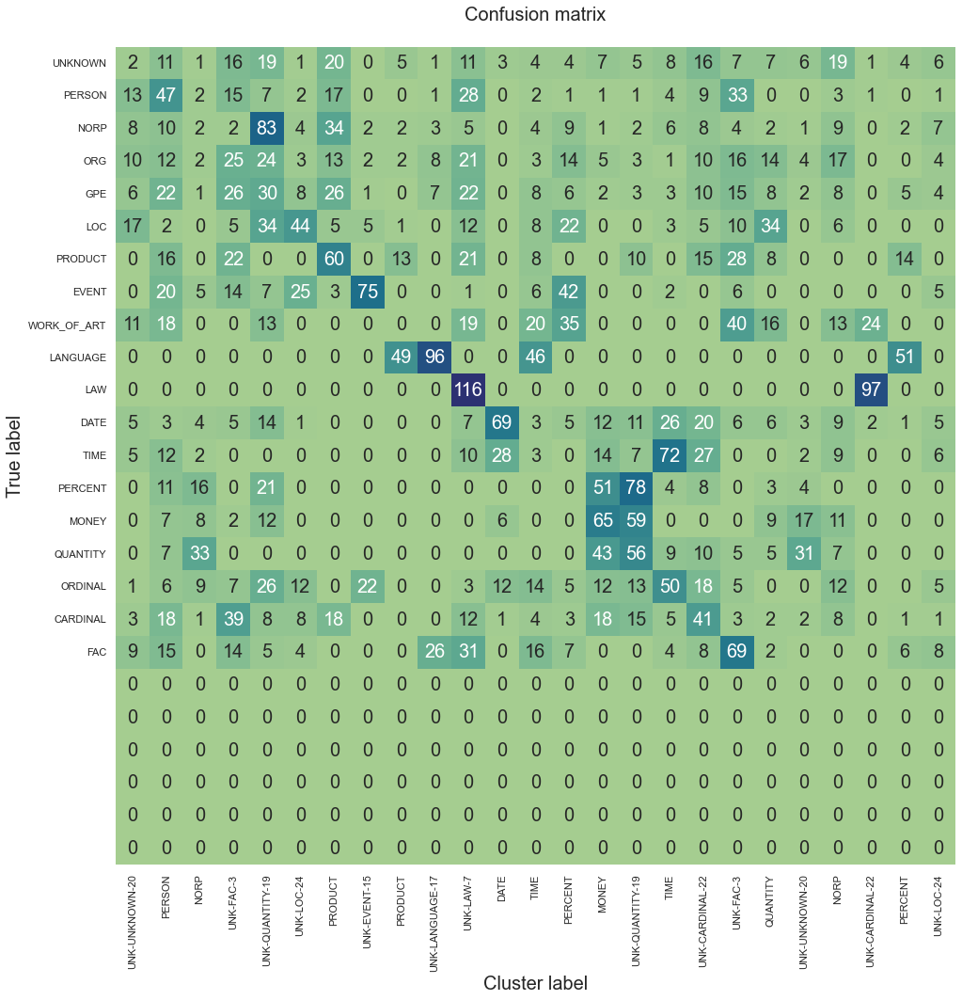

F1 score (macro) = 0.4465
Accuracy = 0.3865
Precision = 0.7405
Recall = 0.3880
New clusters =      4
... wrote results to c:\Users\Will\Projects\MSc\project\src\results\test-train_size=0-radius=6-latent_weight=0.002-reconstr_weight=0.2-head=z-cluster=Kmeans-entity_count=15-noise_factor=0.1-\index.html
Finished 'evaluate_model' in 39.088 secs


In [ ]:
from grid_search import grid_search

scores = []
num_runs = 1
config = {
    'train_size': [0],
    "radius": [0, 6],
    'latent_weight': [0.0005,0.001, 0.002],
    'reconstr_weight': [0.1, 0.2],
    'head': ['z'],
    'cluster': ['Kmeans'],
    'entity_count': [15],
    'noise_factor': [0.1], 
}

scores = grid_search(config, do_run, sample_size=4000)

In [ ]:
summarise_scores(scores)

Run Name                                 Runs       F1 avg       F1 Cluster   F1 Global    Precision    Recall      
test-train_size=0-radius=0-latent_weight=0.0005-reconstr_weight=0.1-head=z-cluster=Kmeans-entity_count=15-noise_factor=0.1- 1           0.3398       0.1951       0.4846      0.8461       0.4209      
test-train_size=0-radius=0-latent_weight=0.0005-reconstr_weight=0.2-head=z-cluster=Kmeans-entity_count=15-noise_factor=0.1- 1           0.3594       0.2365       0.4823      0.7938       0.4239      
test-train_size=0-radius=0-latent_weight=0.001-reconstr_weight=0.1-head=z-cluster=Kmeans-entity_count=15-noise_factor=0.1- 1           0.3500       0.2160       0.4840      0.7413       0.4295      
test-train_size=0-radius=0-latent_weight=0.001-reconstr_weight=0.2-head=z-cluster=Kmeans-entity_count=15-noise_factor=0.1- 1           0.3682       0.2662       0.4703      0.7405       0.4198      
test-train_size=0-radius=0-latent_weight=0.002-reconstr_weight=0.1-head=z-cluster=Kme

--------------------------------------------------
0/6: test-train_size=3000-radius=6-latent_weight=0.4-reconstr_weight=0.9-head=z-epochs=1-cluster=Kmeans-latent_loss=cross_entropy-entity_count=15-noise_factor=0.1-
--------------------------------------------------
{'train_size': 3000, 'radius': 6, 'latent_weight': 0.4, 'reconstr_weight': 0.9, 'head': 'z', 'epochs': 1, 'cluster': 'Kmeans', 'latent_loss': 'cross_entropy', 'entity_count': 15, 'noise_factor': 0.1}
ERROR: Invalid config key <module 'tensorflow.keras' from 'c:\\Users\\Will\\Anaconda3\\envs\\tf-27\\lib\\site-packages\\keras\\api\\_v2\\keras\\__init__.py'>
Autoencoder
Latent Model
model compiled
Epoch 183: early stopping


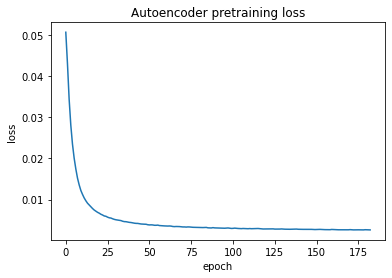

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/8000 [00:00<?, ?it/s]

epoch: 0 loss=567.9691772460938


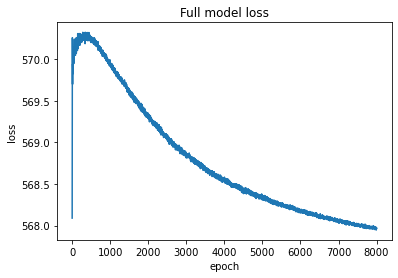

Training Done

F1 by Known Clusters: 0.2513


<Figure size 432x288 with 0 Axes>

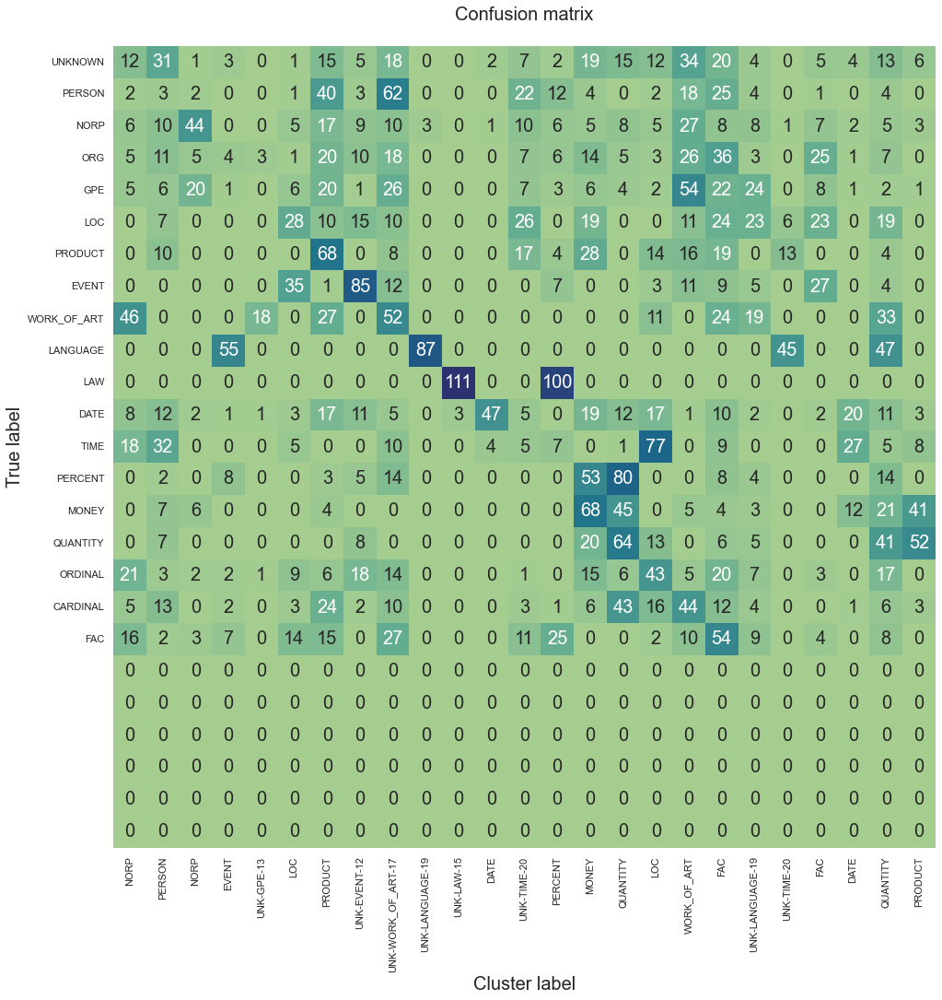

F1 score (macro) = 0.4493
Accuracy = 0.4000
Precision = 0.7941
Recall = 0.3928
New clusters =      4
... wrote results to c:\Users\Will\Projects\MSc\project\src\results\test-train_size=3000-radius=6-latent_weight=0.4-reconstr_weight=0.9-head=z-epochs=1-cluster=Kmeans-latent_loss=cross_entropy-entity_count=15-noise_factor=0.1-\index.html
Finished 'evaluate_model' in 41.631 secs
--------------------------------------------------
1/6: test-train_size=3000-radius=6-latent_weight=0.4-reconstr_weight=1.0-head=z-epochs=1-cluster=Kmeans-latent_loss=cross_entropy-entity_count=15-noise_factor=0.1-
--------------------------------------------------
{'train_size': 3000, 'radius': 6, 'latent_weight': 0.4, 'reconstr_weight': 1.0, 'head': 'z', 'epochs': 1, 'cluster': 'Kmeans', 'latent_loss': 'cross_entropy', 'entity_count': 15, 'noise_factor': 0.1}
ERROR: Invalid config key <module 'tensorflow.keras' from 'c:\\Users\\Will\\Anaconda3\\envs\\tf-27\\lib\\site-packages\\keras\\api\\_v2\\keras\\__init__.p

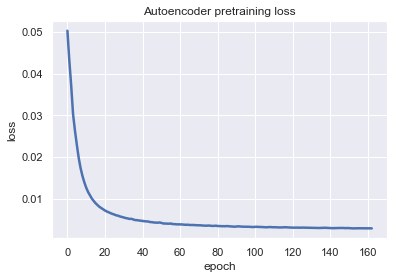

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/8000 [00:00<?, ?it/s]

epoch: 0 loss=568.1481323242188


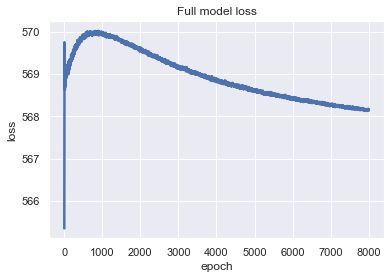

Training Done

F1 by Known Clusters: 0.1541


<Figure size 432x288 with 0 Axes>

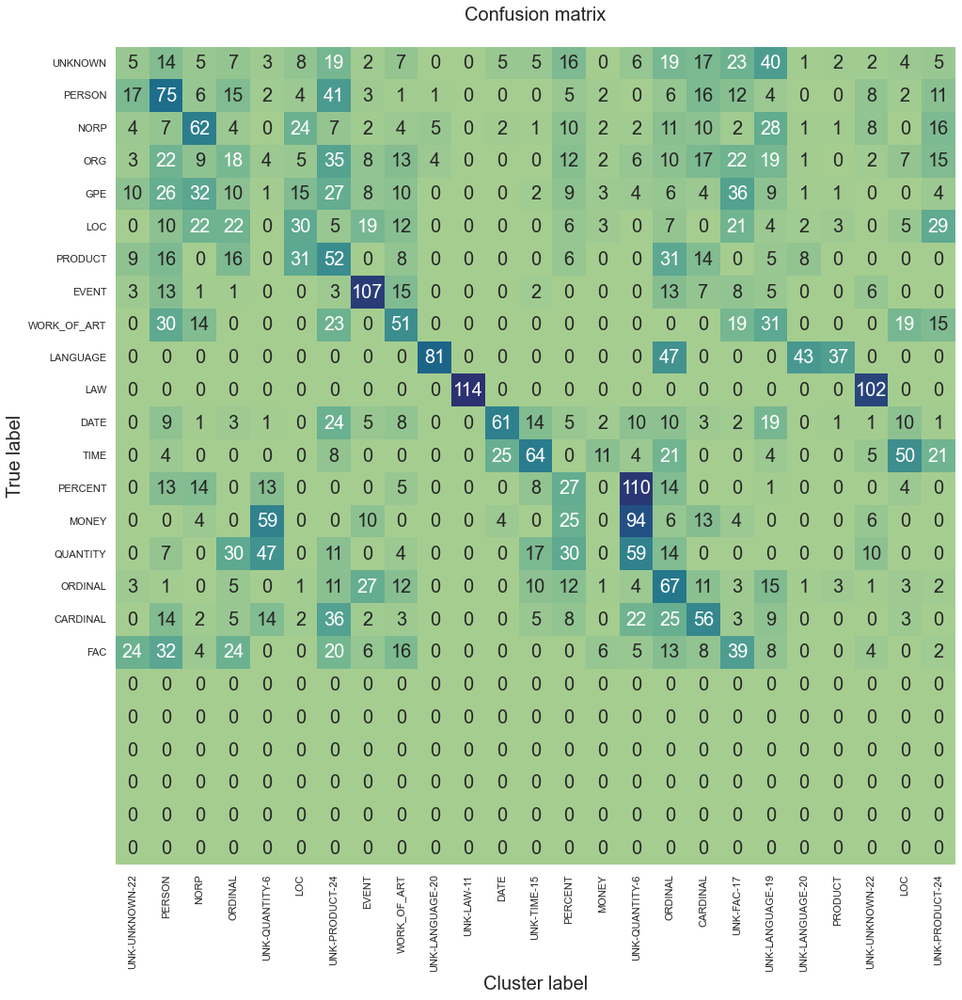

F1 score (macro) = 0.4783
Accuracy = 0.4000
Precision = 0.8464
Recall = 0.4028
New clusters =      4
... wrote results to c:\Users\Will\Projects\MSc\project\src\results\test-train_size=3000-radius=6-latent_weight=0.4-reconstr_weight=1.0-head=z-epochs=1-cluster=Kmeans-latent_loss=cross_entropy-entity_count=15-noise_factor=0.1-\index.html
Finished 'evaluate_model' in 38.024 secs
--------------------------------------------------
2/6: test-train_size=3000-radius=6-latent_weight=0.5-reconstr_weight=0.9-head=z-epochs=1-cluster=Kmeans-latent_loss=cross_entropy-entity_count=15-noise_factor=0.1-
--------------------------------------------------
{'train_size': 3000, 'radius': 6, 'latent_weight': 0.5, 'reconstr_weight': 0.9, 'head': 'z', 'epochs': 1, 'cluster': 'Kmeans', 'latent_loss': 'cross_entropy', 'entity_count': 15, 'noise_factor': 0.1}
ERROR: Invalid config key <module 'tensorflow.keras' from 'c:\\Users\\Will\\Anaconda3\\envs\\tf-27\\lib\\site-packages\\keras\\api\\_v2\\keras\\__init__.p

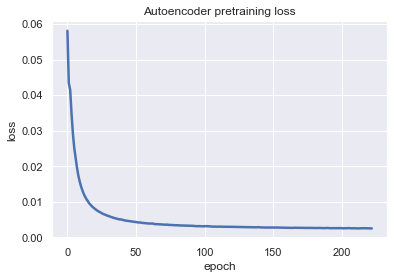

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/8000 [00:00<?, ?it/s]

epoch: 0 loss=709.8636474609375


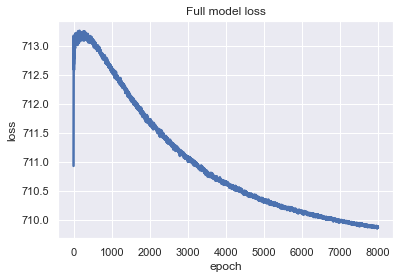

Training Done

F1 by Known Clusters: 0.1879


<Figure size 432x288 with 0 Axes>

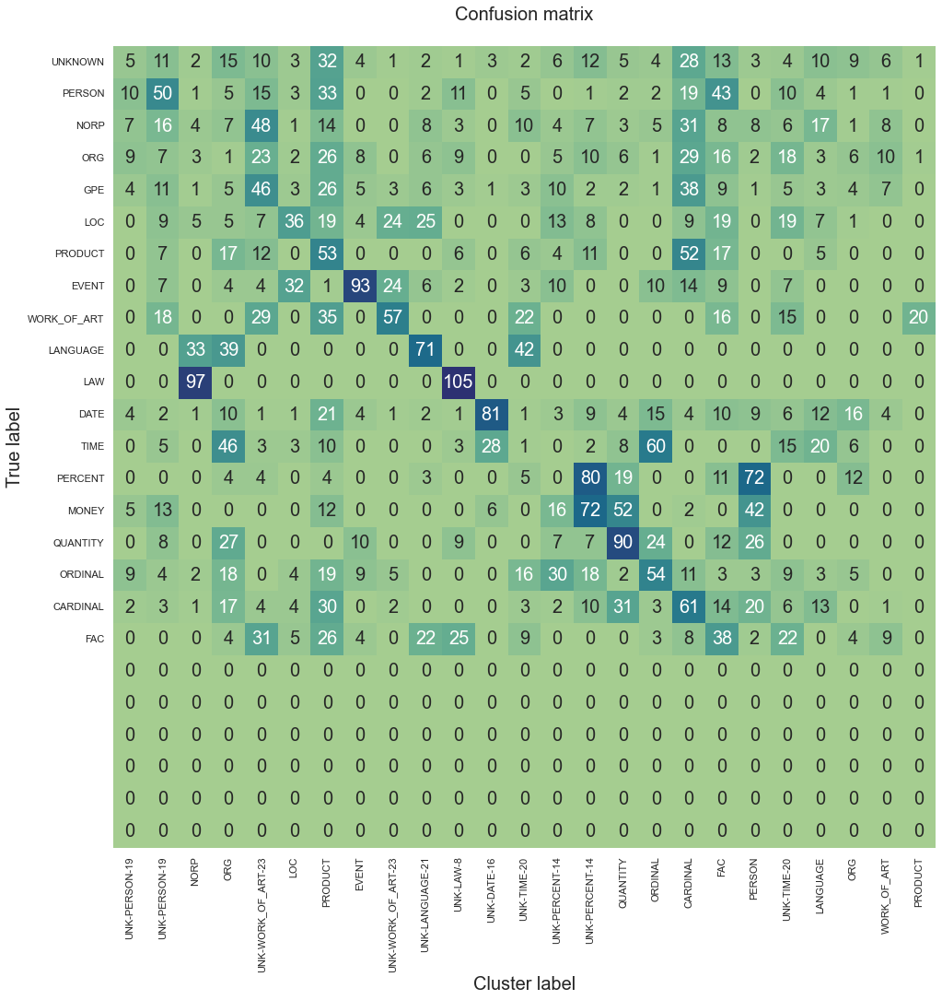

F1 score (macro) = 0.4449
Accuracy = 0.3762
Precision = 0.8459
Recall = 0.3812
New clusters =      3
... wrote results to c:\Users\Will\Projects\MSc\project\src\results\test-train_size=3000-radius=6-latent_weight=0.5-reconstr_weight=0.9-head=z-epochs=1-cluster=Kmeans-latent_loss=cross_entropy-entity_count=15-noise_factor=0.1-\index.html
Finished 'evaluate_model' in 39.837 secs
--------------------------------------------------
3/6: test-train_size=3000-radius=6-latent_weight=0.5-reconstr_weight=1.0-head=z-epochs=1-cluster=Kmeans-latent_loss=cross_entropy-entity_count=15-noise_factor=0.1-
--------------------------------------------------
{'train_size': 3000, 'radius': 6, 'latent_weight': 0.5, 'reconstr_weight': 1.0, 'head': 'z', 'epochs': 1, 'cluster': 'Kmeans', 'latent_loss': 'cross_entropy', 'entity_count': 15, 'noise_factor': 0.1}
ERROR: Invalid config key <module 'tensorflow.keras' from 'c:\\Users\\Will\\Anaconda3\\envs\\tf-27\\lib\\site-packages\\keras\\api\\_v2\\keras\\__init__.p

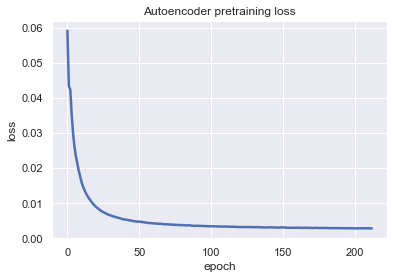

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/8000 [00:00<?, ?it/s]

epoch: 0 loss=710.2918701171875


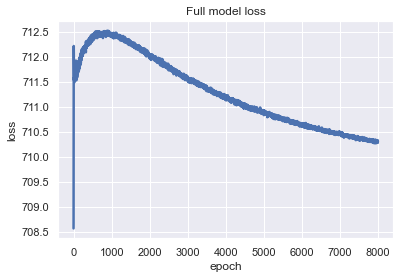

Training Done

F1 by Known Clusters: 0.2026


<Figure size 432x288 with 0 Axes>

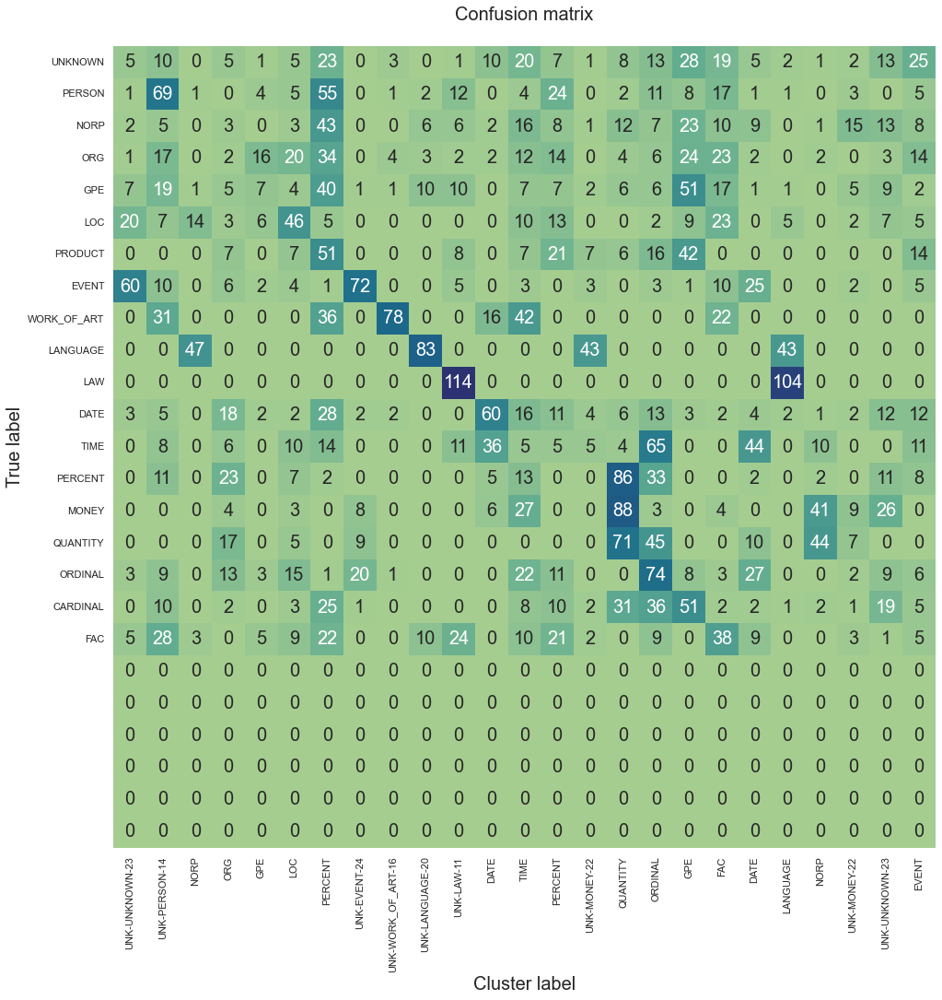

F1 score (macro) = 0.4300
Accuracy = 0.3807
Precision = 0.8462
Recall = 0.3732
New clusters =      5
... wrote results to c:\Users\Will\Projects\MSc\project\src\results\test-train_size=3000-radius=6-latent_weight=0.5-reconstr_weight=1.0-head=z-epochs=1-cluster=Kmeans-latent_loss=cross_entropy-entity_count=15-noise_factor=0.1-\index.html
Finished 'evaluate_model' in 37.847 secs
--------------------------------------------------
4/6: test-train_size=3000-radius=6-latent_weight=0.6-reconstr_weight=0.9-head=z-epochs=1-cluster=Kmeans-latent_loss=cross_entropy-entity_count=15-noise_factor=0.1-
--------------------------------------------------
{'train_size': 3000, 'radius': 6, 'latent_weight': 0.6, 'reconstr_weight': 0.9, 'head': 'z', 'epochs': 1, 'cluster': 'Kmeans', 'latent_loss': 'cross_entropy', 'entity_count': 15, 'noise_factor': 0.1}
ERROR: Invalid config key <module 'tensorflow.keras' from 'c:\\Users\\Will\\Anaconda3\\envs\\tf-27\\lib\\site-packages\\keras\\api\\_v2\\keras\\__init__.p

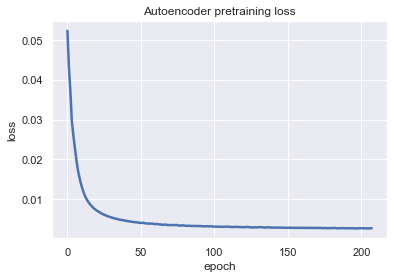

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/8000 [00:00<?, ?it/s]

epoch: 0 loss=851.9502563476562


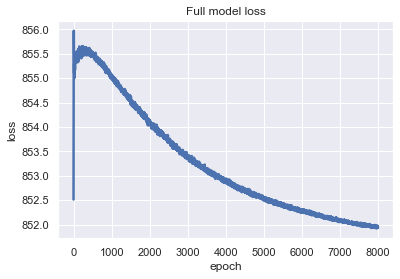

Training Done

F1 by Known Clusters: 0.1869


<Figure size 432x288 with 0 Axes>

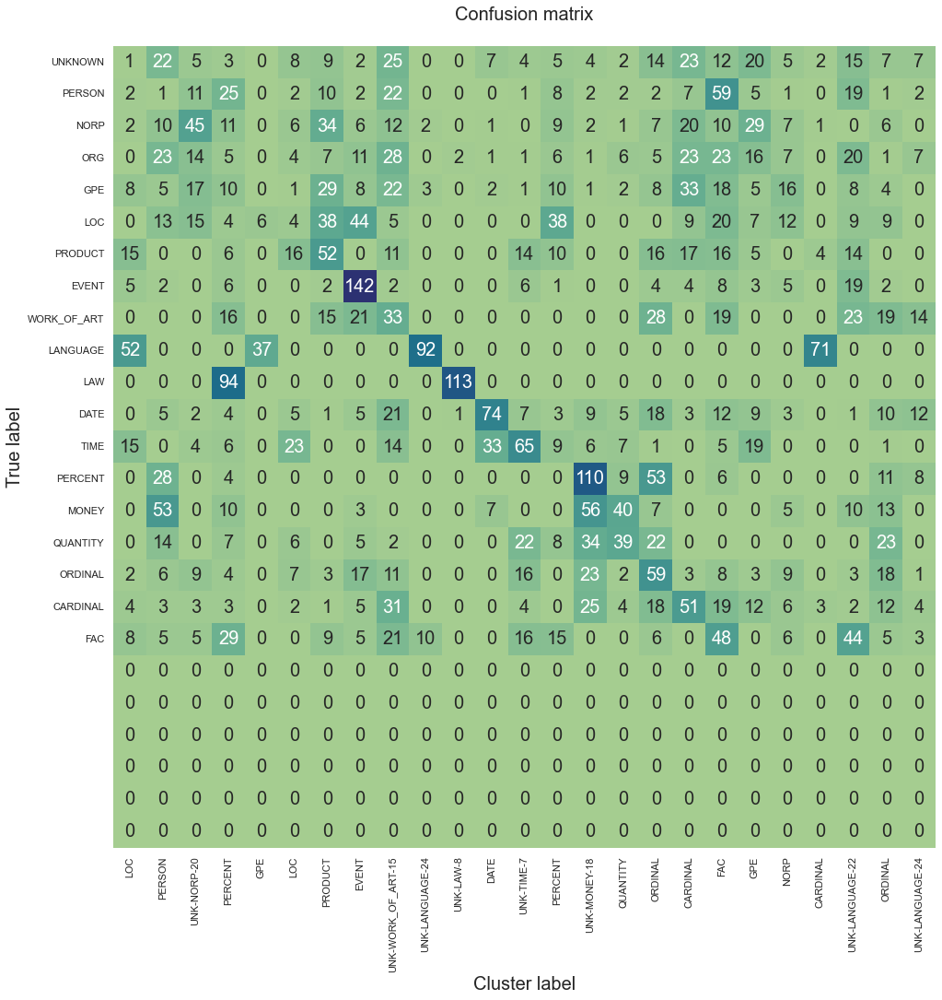

F1 score (macro) = 0.4708
Accuracy = 0.4078
Precision = 0.8989
Recall = 0.4020
New clusters =      5
... wrote results to c:\Users\Will\Projects\MSc\project\src\results\test-train_size=3000-radius=6-latent_weight=0.6-reconstr_weight=0.9-head=z-epochs=1-cluster=Kmeans-latent_loss=cross_entropy-entity_count=15-noise_factor=0.1-\index.html
Finished 'evaluate_model' in 37.424 secs
--------------------------------------------------
5/6: test-train_size=3000-radius=6-latent_weight=0.6-reconstr_weight=1.0-head=z-epochs=1-cluster=Kmeans-latent_loss=cross_entropy-entity_count=15-noise_factor=0.1-
--------------------------------------------------
{'train_size': 3000, 'radius': 6, 'latent_weight': 0.6, 'reconstr_weight': 1.0, 'head': 'z', 'epochs': 1, 'cluster': 'Kmeans', 'latent_loss': 'cross_entropy', 'entity_count': 15, 'noise_factor': 0.1}
ERROR: Invalid config key <module 'tensorflow.keras' from 'c:\\Users\\Will\\Anaconda3\\envs\\tf-27\\lib\\site-packages\\keras\\api\\_v2\\keras\\__init__.p

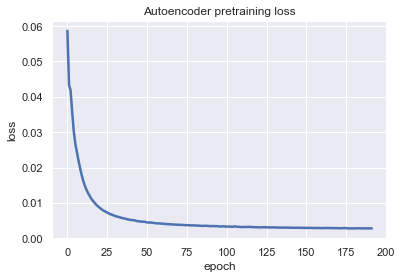

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/8000 [00:00<?, ?it/s]

epoch: 0 loss=851.9972534179688


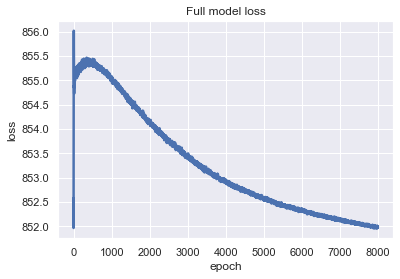

Training Done

F1 by Known Clusters: 0.2081


<Figure size 432x288 with 0 Axes>

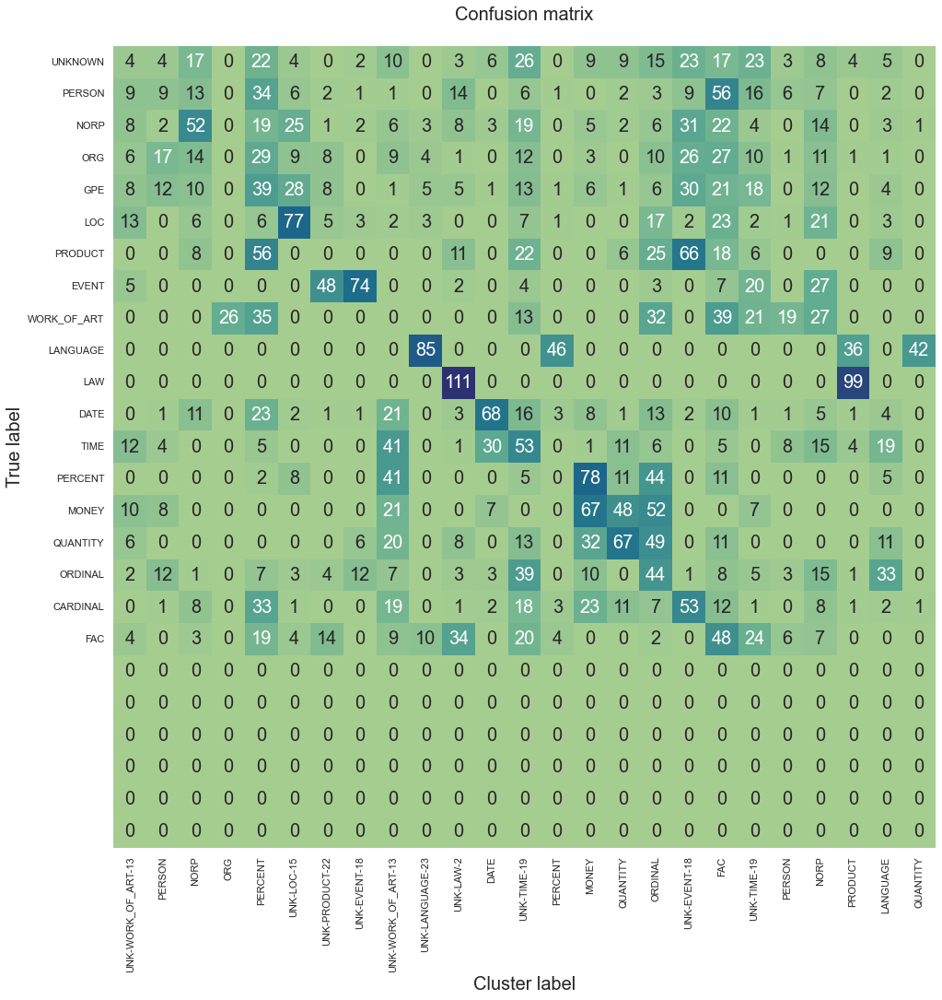

F1 score (macro) = 0.4514
Accuracy = 0.3860
Precision = 0.8463
Recall = 0.3891
New clusters =      5
... wrote results to c:\Users\Will\Projects\MSc\project\src\results\test-train_size=3000-radius=6-latent_weight=0.6-reconstr_weight=1.0-head=z-epochs=1-cluster=Kmeans-latent_loss=cross_entropy-entity_count=15-noise_factor=0.1-\index.html
Finished 'evaluate_model' in 36.705 secs


In [ ]:
from grid_search import grid_search

scores = []
num_runs = 1
config = {
    'train_size': [0],
    "radius": [6],
    'latent_weight': [0.4, 0.5, 0.6],
    'reconstr_weight': [0.9, 0.2],
    'head': ['z'],
    'epochs': [1],
    'cluster': ['Kmeans'],
    'latent_loss': ['cross_entropy'],
    'entity_count': [15],
    'noise_factor': [0.1], 
}

scores = grid_search(config, do_run, sample_size=4000)

In [ ]:
summarise_scores(scores)

Run Name                                 Runs       F1 avg       F1 Cluster   F1 Global    Precision    Recall      
test-train_size=3000-radius=6-latent_weight=0.4-reconstr_weight=0.9-head=z-epochs=1-cluster=Kmeans-latent_loss=cross_entropy-entity_count=15-noise_factor=0.1- 1           0.3503       0.2513       0.4493      0.7941       0.3928      
test-train_size=3000-radius=6-latent_weight=0.4-reconstr_weight=1.0-head=z-epochs=1-cluster=Kmeans-latent_loss=cross_entropy-entity_count=15-noise_factor=0.1- 1           0.3162       0.1541       0.4783      0.8464       0.4028      
test-train_size=3000-radius=6-latent_weight=0.5-reconstr_weight=0.9-head=z-epochs=1-cluster=Kmeans-latent_loss=cross_entropy-entity_count=15-noise_factor=0.1- 1           0.3164       0.1879       0.4449      0.8459       0.3812      
test-train_size=3000-radius=6-latent_weight=0.5-reconstr_weight=1.0-head=z-epochs=1-cluster=Kmeans-latent_loss=cross_entropy-entity_count=15-noise_factor=0.1- 1           0.3163 

--------------------------------------------------
0/2: test-train_size=3000-radius=6-latent_weight=0.001-reconstr_weight=1.0-head=z-epochs=10-cluster=Kmeans-latent_loss=cross_entropy-entity_count=15-noise_factor=0.0-
--------------------------------------------------
{'train_size': 3000, 'radius': 6, 'latent_weight': 0.001, 'reconstr_weight': 1.0, 'head': 'z', 'epochs': 10, 'cluster': 'Kmeans', 'latent_loss': 'cross_entropy', 'entity_count': 15, 'noise_factor': 0.0}
ERROR: Invalid config key <module 'tensorflow.keras' from 'c:\\Users\\Will\\Anaconda3\\envs\\tf-27\\lib\\site-packages\\keras\\api\\_v2\\keras\\__init__.py'>
Autoencoder
Latent Model
model compiled
Epoch 206: early stopping


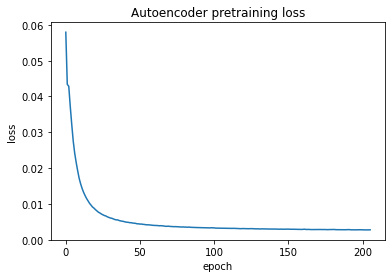

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/8000 [00:00<?, ?it/s]

Stop traing for tolerance threshold reached
epoch: 0 loss=1.4238802194595337


  0%|          | 0/8000 [00:00<?, ?it/s]

Stop traing for tolerance threshold reached
epoch: 1 loss=1.4238853454589844


  0%|          | 0/8000 [00:00<?, ?it/s]

Stop traing for tolerance threshold reached
epoch: 2 loss=1.4238849878311157


  0%|          | 0/8000 [00:00<?, ?it/s]

Stop traing for tolerance threshold reached
epoch: 3 loss=1.4239189624786377


  0%|          | 0/8000 [00:00<?, ?it/s]

Stop traing for tolerance threshold reached
epoch: 4 loss=1.4239201545715332


  0%|          | 0/8000 [00:00<?, ?it/s]

Stop traing for tolerance threshold reached
epoch: 5 loss=1.4239176511764526


  0%|          | 0/8000 [00:00<?, ?it/s]

Stop traing for tolerance threshold reached
epoch: 6 loss=1.42391836643219


  0%|          | 0/8000 [00:00<?, ?it/s]

Stop traing for tolerance threshold reached
epoch: 7 loss=1.423917531967163


  0%|          | 0/8000 [00:00<?, ?it/s]

Stop traing for tolerance threshold reached
epoch: 8 loss=1.4239171743392944


  0%|          | 0/8000 [00:00<?, ?it/s]

Stop traing for tolerance threshold reached
epoch: 9 loss=1.423916220664978


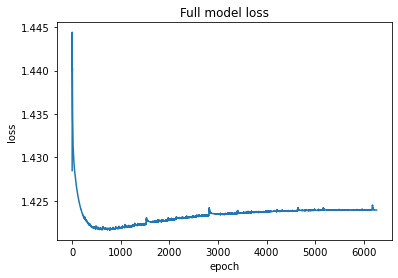

Training Done

F1 by Known Clusters: 0.2516


<Figure size 432x288 with 0 Axes>

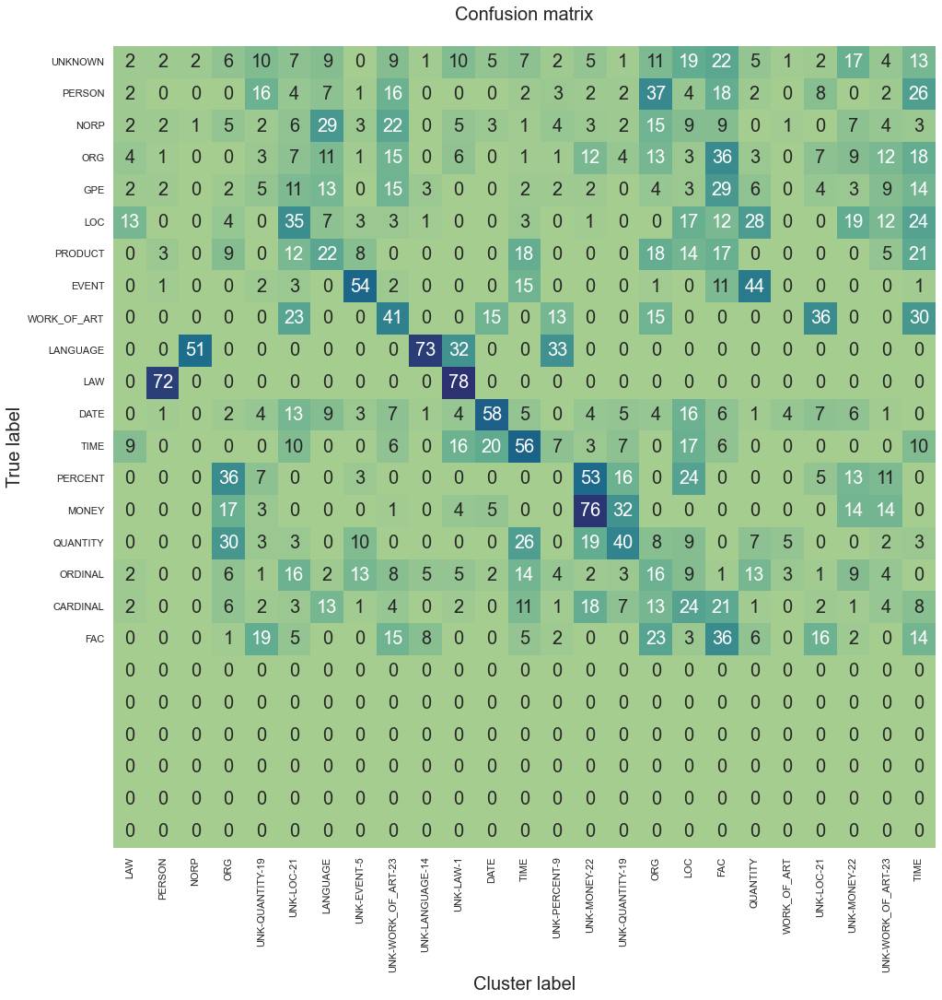

F1 score (macro) = 0.4324
Accuracy = 0.3937
Precision = 0.7414
Recall = 0.3794
New clusters =      5
... wrote results to c:\Users\Will\Projects\MSc\project\src\results\test-train_size=3000-radius=6-latent_weight=0.001-reconstr_weight=1.0-head=z-epochs=10-cluster=Kmeans-latent_loss=cross_entropy-entity_count=15-noise_factor=0.0-\index.html
Finished 'evaluate_model' in 32.941 secs
--------------------------------------------------
1/2: test-train_size=3000-radius=6-latent_weight=0.001-reconstr_weight=1.0-head=z-epochs=10-cluster=Kmeans-latent_loss=cross_entropy-entity_count=15-noise_factor=0.1-
--------------------------------------------------
{'train_size': 3000, 'radius': 6, 'latent_weight': 0.001, 'reconstr_weight': 1.0, 'head': 'z', 'epochs': 10, 'cluster': 'Kmeans', 'latent_loss': 'cross_entropy', 'entity_count': 15, 'noise_factor': 0.1}
ERROR: Invalid config key <module 'tensorflow.keras' from 'c:\\Users\\Will\\Anaconda3\\envs\\tf-27\\lib\\site-packages\\keras\\api\\_v2\\keras\\_

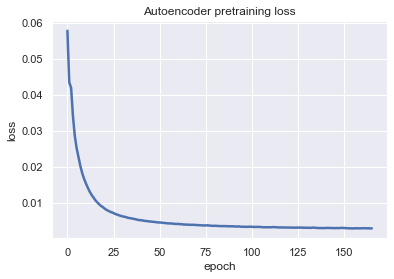

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/8000 [00:00<?, ?it/s]

epoch: 0 loss=1.4305596351623535


  0%|          | 0/8000 [00:00<?, ?it/s]

epoch: 1 loss=1.4291690587997437


  0%|          | 0/8000 [00:00<?, ?it/s]

epoch: 2 loss=1.4287166595458984


  0%|          | 0/8000 [00:00<?, ?it/s]

epoch: 3 loss=1.428480863571167


  0%|          | 0/8000 [00:00<?, ?it/s]

epoch: 4 loss=1.428445816040039


  0%|          | 0/8000 [00:00<?, ?it/s]

epoch: 5 loss=1.4283089637756348


  0%|          | 0/8000 [00:00<?, ?it/s]

epoch: 6 loss=1.4282886981964111


  0%|          | 0/8000 [00:00<?, ?it/s]

epoch: 7 loss=1.4282728433609009


  0%|          | 0/8000 [00:00<?, ?it/s]

epoch: 8 loss=1.4284648895263672


  0%|          | 0/8000 [00:00<?, ?it/s]

epoch: 9 loss=1.4283638000488281


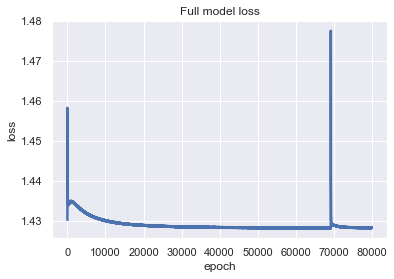

Training Done

F1 by Known Clusters: 0.2294


<Figure size 432x288 with 0 Axes>

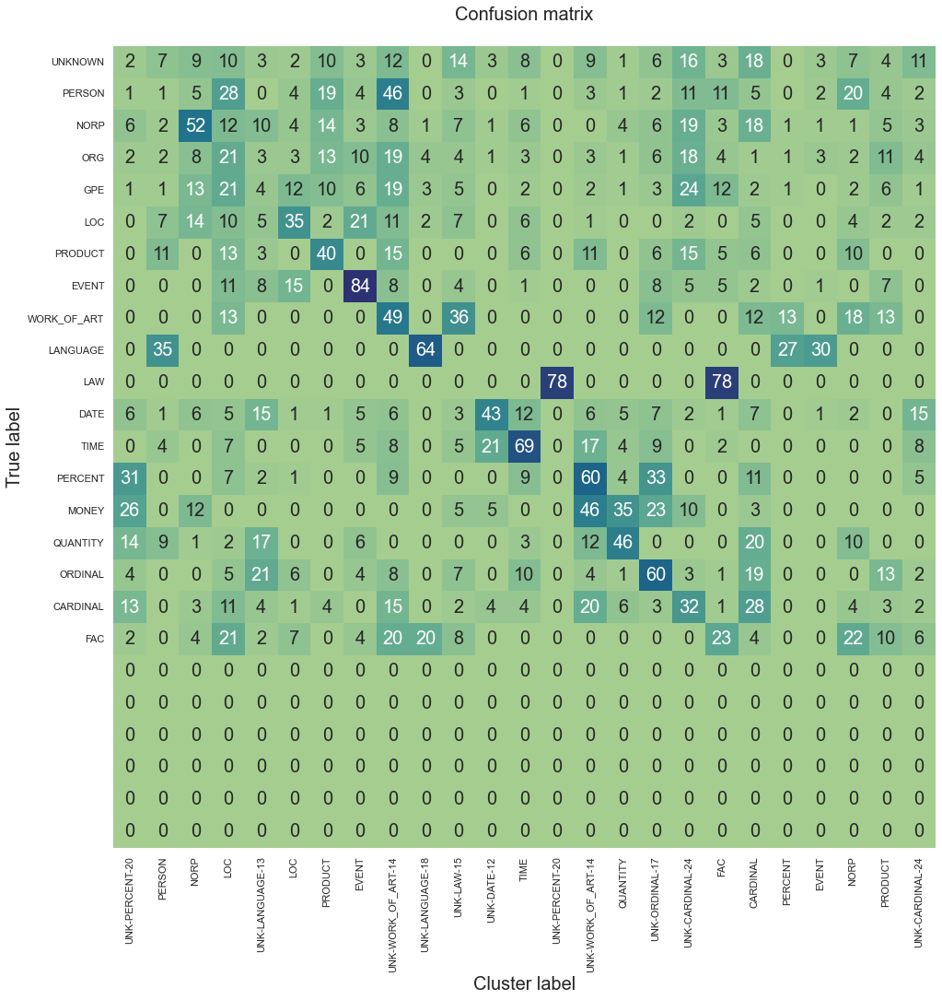

F1 score (macro) = 0.4711
Accuracy = 0.4123
Precision = 0.7939
Recall = 0.4094
New clusters =      6
... wrote results to c:\Users\Will\Projects\MSc\project\src\results\test-train_size=3000-radius=6-latent_weight=0.001-reconstr_weight=1.0-head=z-epochs=10-cluster=Kmeans-latent_loss=cross_entropy-entity_count=15-noise_factor=0.1-\index.html
Finished 'evaluate_model' in 30.719 secs
Run Name                                 Runs       F1 avg       F1 Cluster   F1 Global    Precision    Recall      
test-train_size=3000-radius=6-latent_weight=0.001-reconstr_weight=1.0-head=z-epochs=10-cluster=Kmeans-latent_loss=cross_entropy-entity_count=15-noise_factor=0.0- 1           0.3420       0.2516       0.4324      0.7414       0.3794      
test-train_size=3000-radius=6-latent_weight=0.001-reconstr_weight=1.0-head=z-epochs=10-cluster=Kmeans-latent_loss=cross_entropy-entity_count=15-noise_factor=0.1- 1           0.3502       0.2294       0.4711      0.7939       0.4094      


In [7]:
from grid_search import grid_search

scores = []
num_runs = 1
config = {
    'train_size': [3000],
    "radius": [6],
    'latent_weight': [0.001],
    'reconstr_weight': [1.0],
    'head': ['z'],
    'epochs': [10],
    'cluster': ['Kmeans'],
    'latent_loss': ['cross_entropy'],
    'entity_count': [15],
    'noise_factor': [0.0, 0.1], 
}

scores = grid_search(config, do_run, sample_size=3000)

summarise_scores(scores)